# LASAgent_Actor_Critic interacts with small LAS 
This file is to test learning results with small size Living Architecture System.

**Observation**: 
*  proximity sensor: 9 * 1, range: 0 or 1
* light color: 9 * 3, range: (0,1)

**Action**: 
* sma: 9 * 1, range: (0,1)
* light color: 9 * 3, range: (0,1)

**Epsilon-greedy**
* no
## Exploration method

In [1]:
import sys
import os
sys.path.append(os.path.abspath('../'))

In [ ]:
import tensorflow as tf
import numpy as np
import gym
from gym import wrappers
import tflearn
import argparse
import pprint as pp
from collections import deque
import time

from IPython.core.debugger import Tracer

from Environment.LASEnv import LASEnv
from LASAgent.LASAgent_Actor_Critic import LASAgent_Actor_Critic


import matplotlib.pyplot as plt
def plot_cumulative_reward(cumulativeReward):
    line, = plt.plot(cumulativeReward)
    plt.ion()
    plt.show()
    plt.pause(0.0001)
    


C:\ProgramData\Anaconda3\lib\site-packages\h5py\__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


curses is not supported on this machine (please install/reinstall curses for an optimal experience)


Initialize LASEnv ...
LASEnv connected to remote V-REP API server
Get objects' names and handles ...
Get Prox Sensor Success!!!!!
Proximity Sensor: ir_3_node#0, and handle: 16
Proximity Sensor: ir_2_node#0, and handle: 17
Proximity Sensor: ir_1_node#0, and handle: 18
Proximity Sensor: ir_3_node#1, and handle: 30
Proximity Sensor: ir_2_node#1, and handle: 31
Proximity Sensor: ir_1_node#1, and handle: 32
Proximity Sensor: ir_3_node#3, and handle: 105
Proximity Sensor: ir_2_node#3, and handle: 106
Proximity Sensor: ir_1_node#3, and handle: 107
Get Lihgt Success!!!!!
Light: omnidirect_light3_node#0, and handle: 26
Light: omnidirect_light2_node#0, and handle: 27
Light: omnidirect_light1_node#0, and handle: 28
Light: omnidirect_light3_node#1, and handle: 40
Light: omnidirect_light2_node#1, and handle: 41
Light: omnidirect_light1_node#1, and handle: 42
Light: omnidirect_light3_node#3, and handle: 114
Light: omnidirect_light2_node#3, and handle: 115
Light: omnidirect_light1_node#3, and handle:

C:\Users\lingheng\Documents\LAS_Gym\Environment\LASEnv.py:454: UserWarning: Remote function call: getLightStateAndColor fail in Class AnyLight.
  warnings.warn("Remote function call: getLightStateAndColor fail in Class AnyLight.")


| Reward: 38 | Episode: 0 


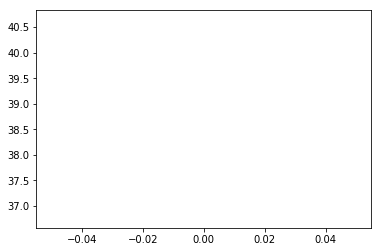

Time elapsed:23.986955165863037
| Reward: 92 | Episode: 1 


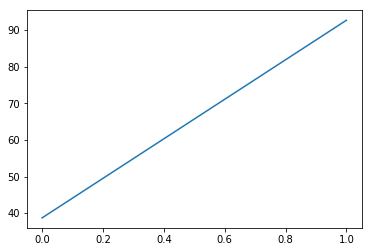

Time elapsed:48.356950521469116
| Reward: 99 | Episode: 2 


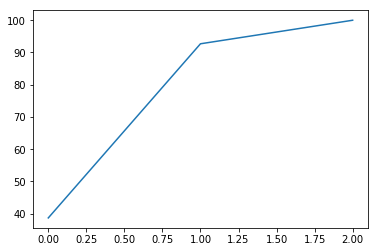

Time elapsed:72.650062084198
| Reward: 99 | Episode: 3 


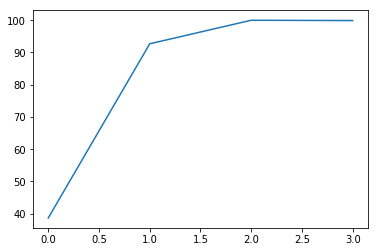

Time elapsed:96.9133505821228
| Reward: 99 | Episode: 4 


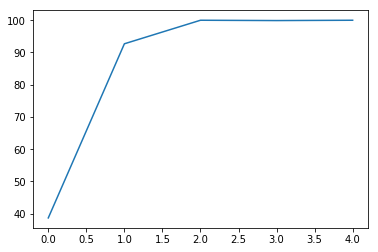

Time elapsed:121.44667863845825
| Reward: 48 | Episode: 5 


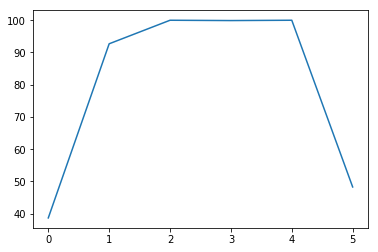

Time elapsed:145.71018624305725
| Reward: 86 | Episode: 6 


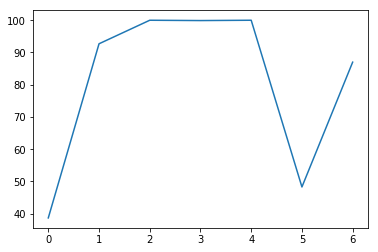

Time elapsed:169.7958619594574
| Reward: 99 | Episode: 7 


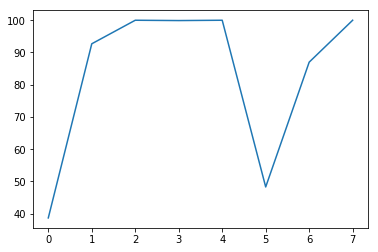

Time elapsed:193.58855056762695
| Reward: 62 | Episode: 8 


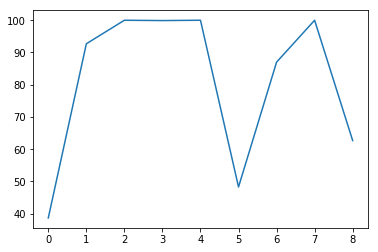

Time elapsed:217.57018637657166
| Reward: 84 | Episode: 9 


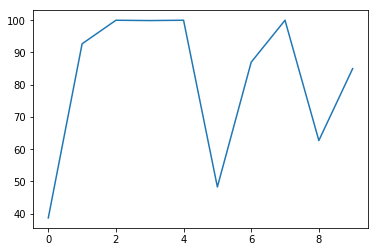

Time elapsed:241.71024870872498
| Reward: 99 | Episode: 10 


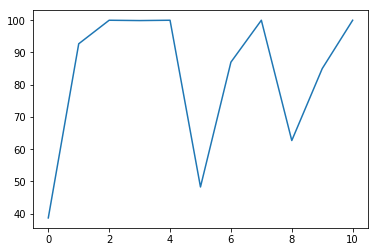

Time elapsed:265.76637148857117
| Reward: 98 | Episode: 11 


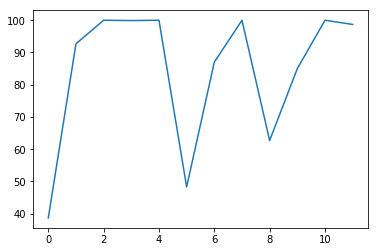

Time elapsed:289.80708622932434
| Reward: 99 | Episode: 12 


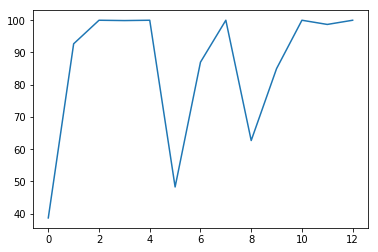

Time elapsed:314.0127875804901
| Reward: 79 | Episode: 13 


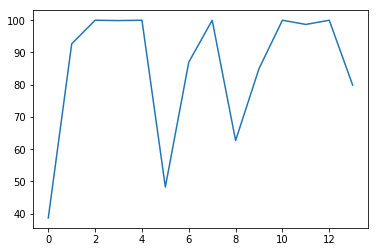

Time elapsed:338.5786232948303
| Reward: 53 | Episode: 14 


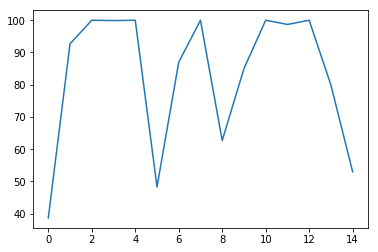

Time elapsed:362.8708829879761
| Reward: 96 | Episode: 15 


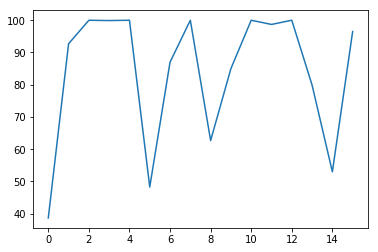

Time elapsed:387.1276593208313
| Reward: 97 | Episode: 16 


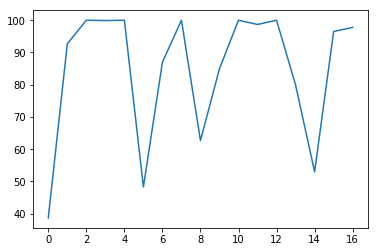

Time elapsed:411.4567105770111
| Reward: 95 | Episode: 17 


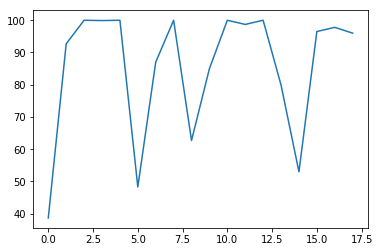

Time elapsed:435.75188159942627
| Reward: 99 | Episode: 18 


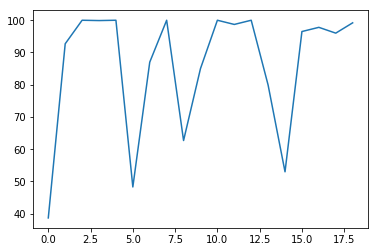

Time elapsed:460.21947717666626
| Reward: 99 | Episode: 19 


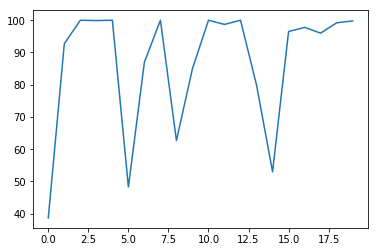

Time elapsed:484.6004922389984
| Reward: 88 | Episode: 20 


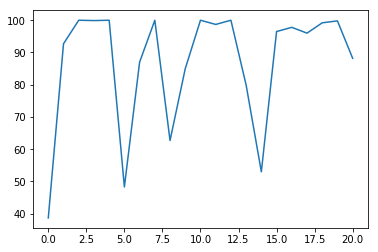

Time elapsed:509.1775357723236
| Reward: 55 | Episode: 21 


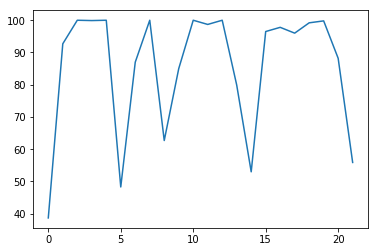

Time elapsed:533.3157162666321
| Reward: 96 | Episode: 22 


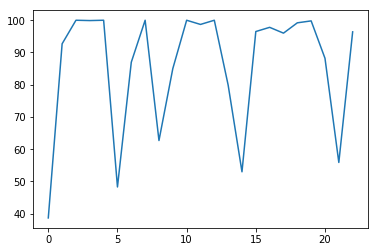

Time elapsed:557.5596590042114
| Reward: 99 | Episode: 23 


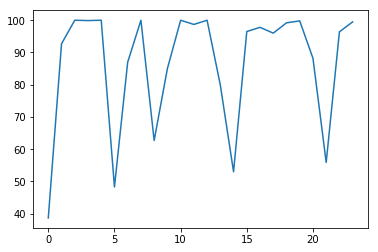

Time elapsed:581.5541427135468
| Reward: 95 | Episode: 24 


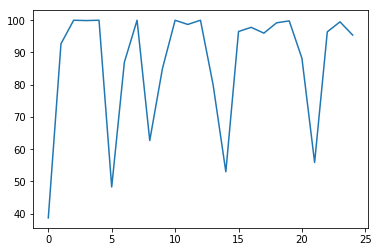

Time elapsed:605.9571883678436
| Reward: 78 | Episode: 25 


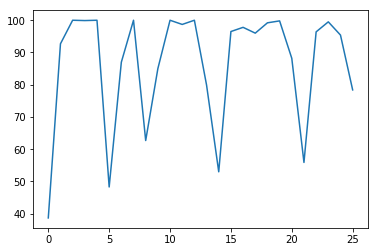

Time elapsed:630.3490750789642
| Reward: 99 | Episode: 26 


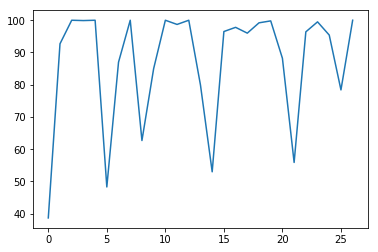

Time elapsed:654.7923421859741
| Reward: 99 | Episode: 27 


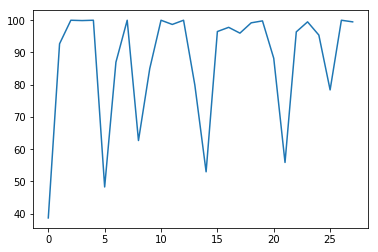

Time elapsed:679.1863119602203
| Reward: 91 | Episode: 28 


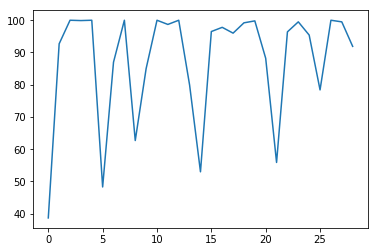

Time elapsed:703.5539789199829
| Reward: 97 | Episode: 29 


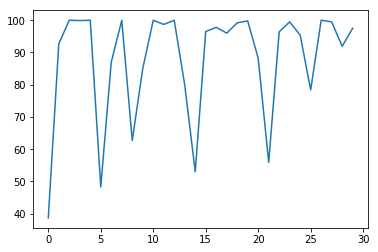

Time elapsed:727.9123315811157
| Reward: 99 | Episode: 30 


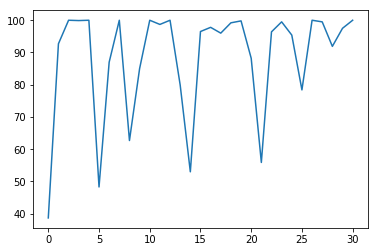

Time elapsed:752.1145391464233
| Reward: 99 | Episode: 31 


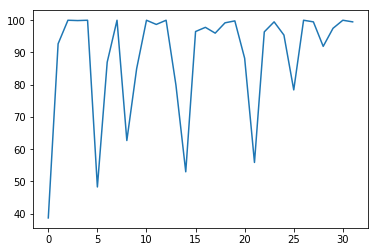

Time elapsed:776.3015067577362
| Reward: 99 | Episode: 32 


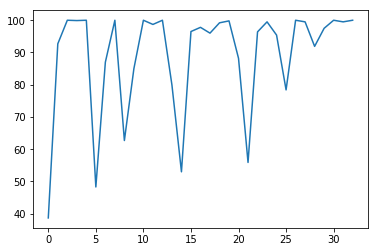

Time elapsed:800.4748451709747
| Reward: 99 | Episode: 33 


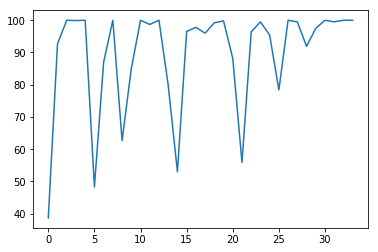

Time elapsed:824.9648303985596
| Reward: 84 | Episode: 34 


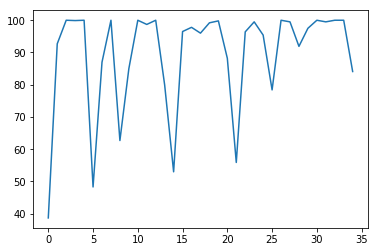

Time elapsed:849.3736929893494
| Reward: 97 | Episode: 35 


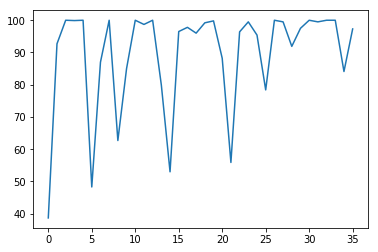

Time elapsed:874.0204544067383
| Reward: 99 | Episode: 36 


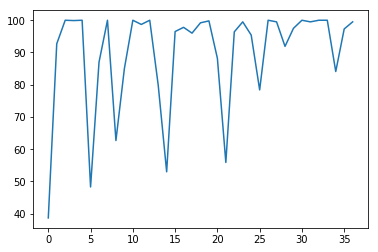

Time elapsed:898.3718247413635
| Reward: 74 | Episode: 37 


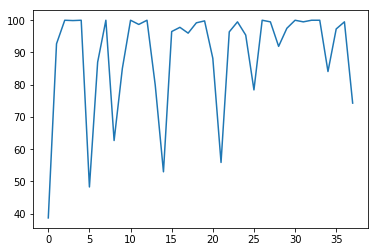

Time elapsed:922.6065647602081
| Reward: 93 | Episode: 38 


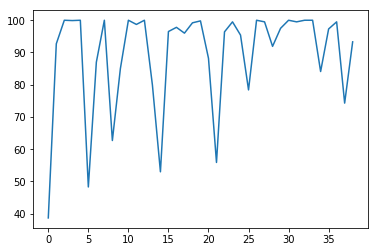

Time elapsed:946.8394391536713
| Reward: 73 | Episode: 39 


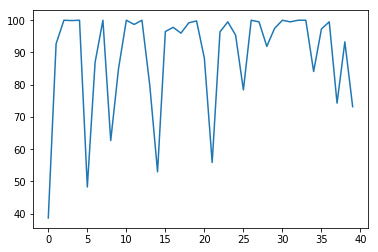

Time elapsed:971.0480229854584
| Reward: 99 | Episode: 40 


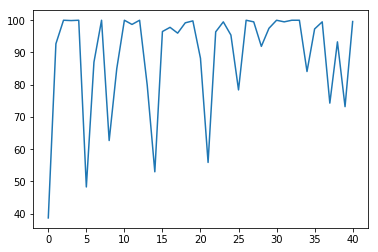

Time elapsed:995.5240988731384
| Reward: 99 | Episode: 41 


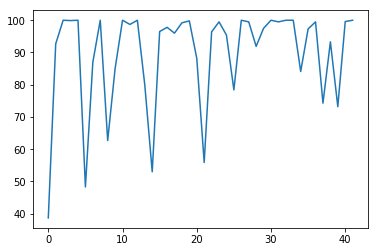

Time elapsed:1019.824324131012
| Reward: 99 | Episode: 42 


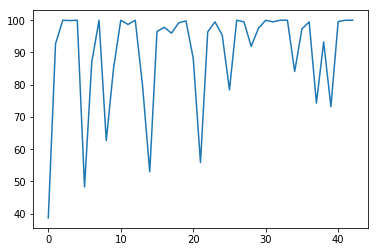

Time elapsed:1044.0418915748596
| Reward: 99 | Episode: 43 


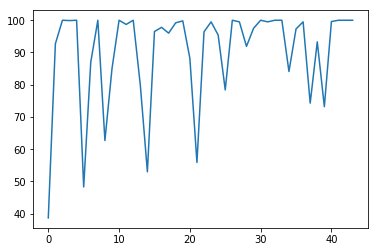

Time elapsed:1068.2878940105438
| Reward: 99 | Episode: 44 


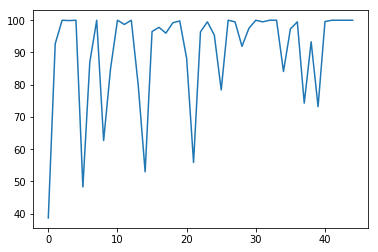

Time elapsed:1092.5391294956207
| Reward: 99 | Episode: 45 


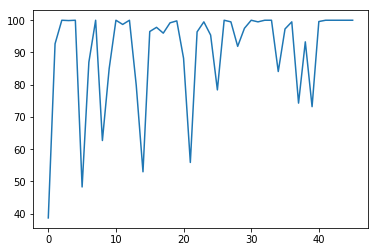

Time elapsed:1116.8540315628052
| Reward: 99 | Episode: 46 


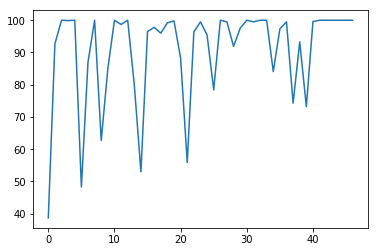

Time elapsed:1140.938229084015
| Reward: 92 | Episode: 47 


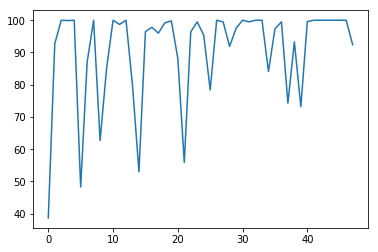

Time elapsed:1165.6478004455566
| Reward: 99 | Episode: 48 


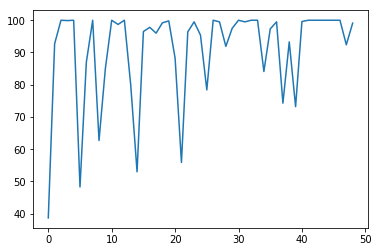

Time elapsed:1190.5140943527222
| Reward: 82 | Episode: 49 


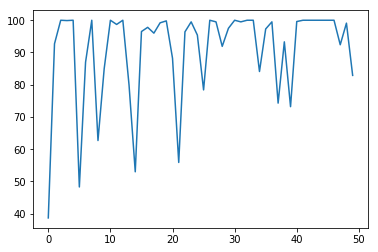

Time elapsed:1215.2785151004791
| Reward: 94 | Episode: 50 


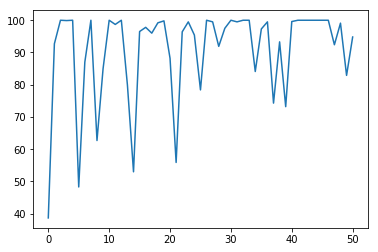

Time elapsed:1239.6134812831879
| Reward: 97 | Episode: 51 


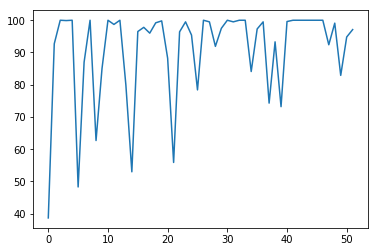

Time elapsed:1263.8360769748688
| Reward: 99 | Episode: 52 


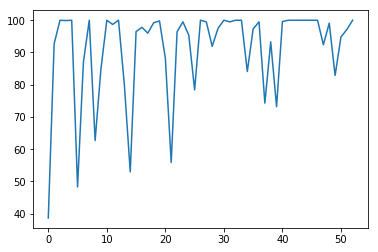

Time elapsed:1288.1156902313232
| Reward: 97 | Episode: 53 


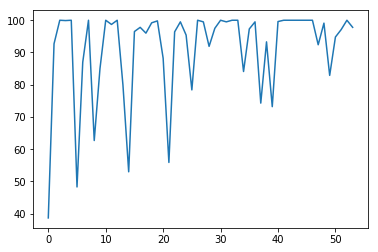

Time elapsed:1312.4879341125488
| Reward: 90 | Episode: 54 


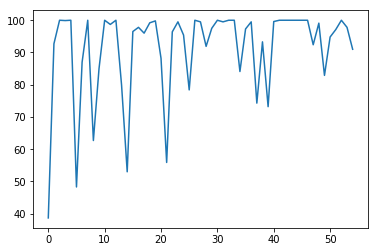

Time elapsed:1337.1523683071136
| Reward: 71 | Episode: 55 


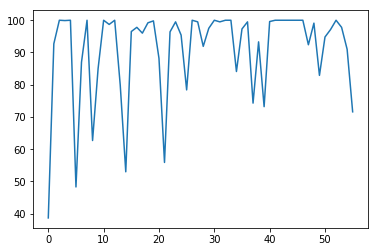

Time elapsed:1361.717966079712
| Reward: 69 | Episode: 56 


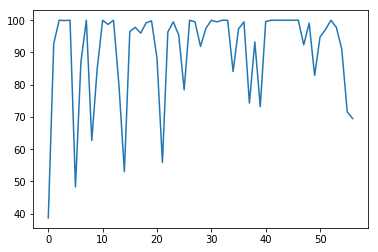

Time elapsed:1386.125111579895
| Reward: 90 | Episode: 57 


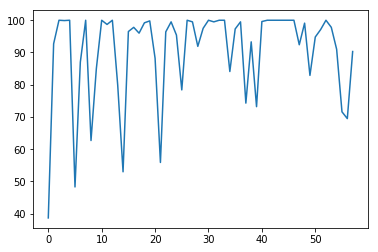

Time elapsed:1410.3036546707153
| Reward: 99 | Episode: 58 


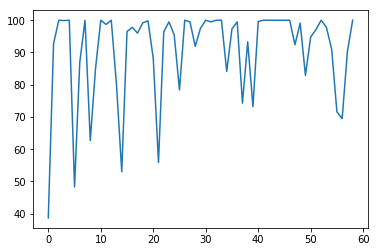

Time elapsed:1434.6806552410126
| Reward: 94 | Episode: 59 


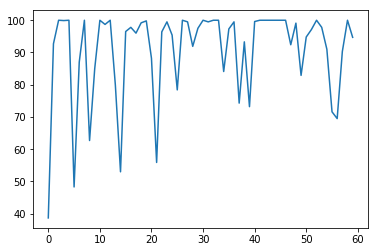

Time elapsed:1458.8946976661682
| Reward: 65 | Episode: 60 


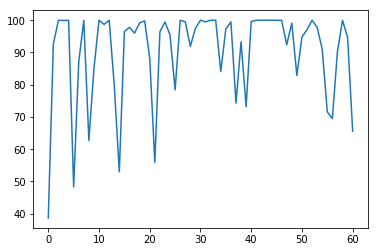

Time elapsed:1483.7709341049194
| Reward: 74 | Episode: 61 


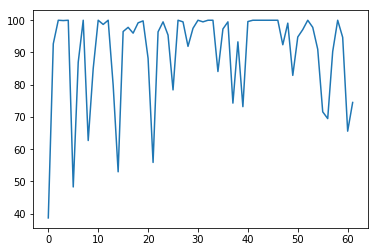

Time elapsed:1508.514615058899
| Reward: 80 | Episode: 62 


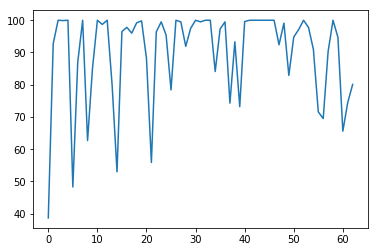

Time elapsed:1533.0030748844147
| Reward: 97 | Episode: 63 


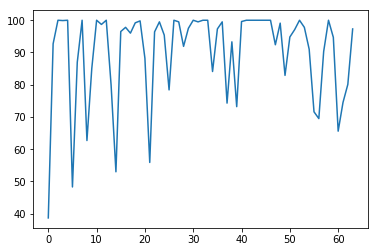

Time elapsed:1557.7204775810242
| Reward: 90 | Episode: 64 


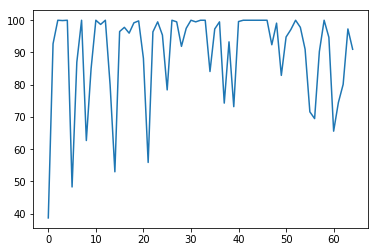

Time elapsed:1582.207641839981
| Reward: 63 | Episode: 65 


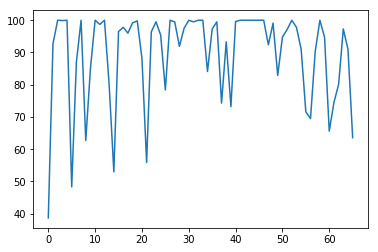

Time elapsed:1606.7764403820038
| Reward: 97 | Episode: 66 


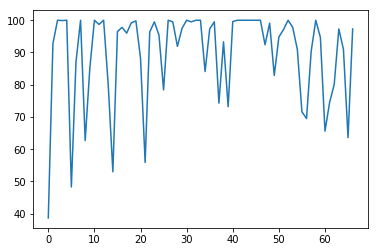

Time elapsed:1631.0211346149445
| Reward: 99 | Episode: 67 


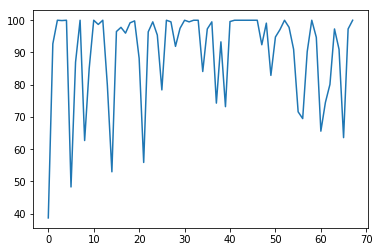

Time elapsed:1655.4257316589355
| Reward: 99 | Episode: 68 


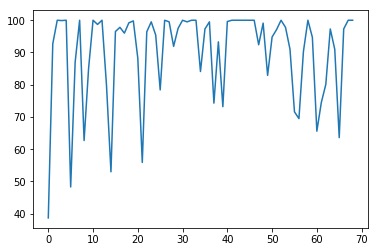

Time elapsed:1679.6310079097748
| Reward: 99 | Episode: 69 


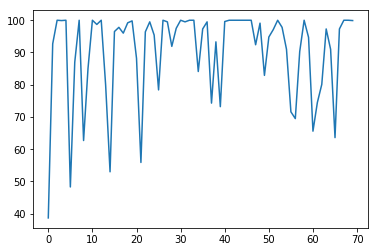

Time elapsed:1703.9927349090576
| Reward: 99 | Episode: 70 


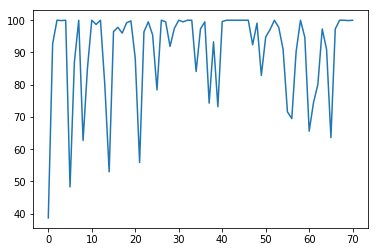

Time elapsed:1728.2185990810394
| Reward: 88 | Episode: 71 


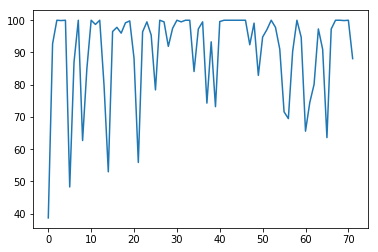

Time elapsed:1752.9117527008057
| Reward: 99 | Episode: 72 


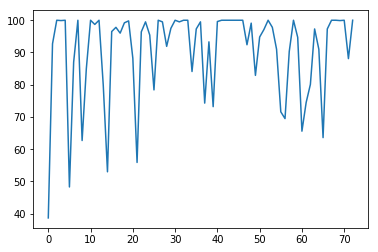

Time elapsed:1777.4482064247131
| Reward: 99 | Episode: 73 


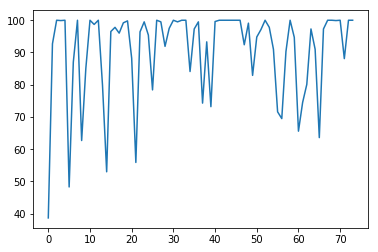

Time elapsed:1802.2512736320496
| Reward: 99 | Episode: 74 


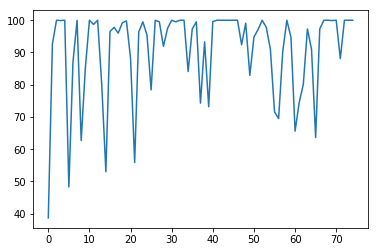

Time elapsed:1826.8263757228851
| Reward: 85 | Episode: 75 


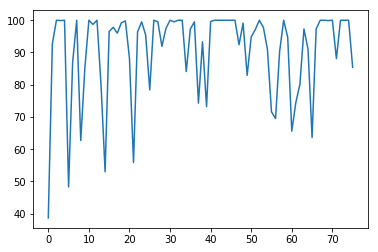

Time elapsed:1851.2629194259644
| Reward: 57 | Episode: 76 


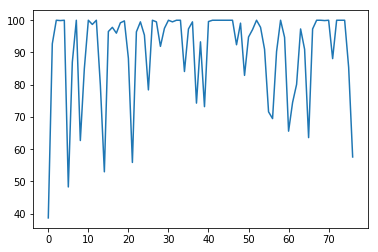

Time elapsed:1875.7329967021942
| Reward: 98 | Episode: 77 


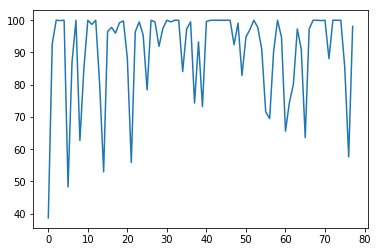

Time elapsed:1900.4514462947845
| Reward: 99 | Episode: 78 


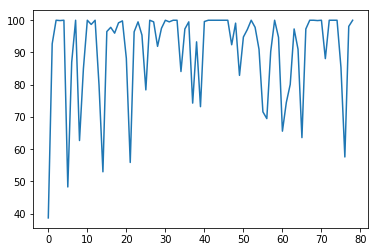

Time elapsed:1925.1448168754578
| Reward: 99 | Episode: 79 


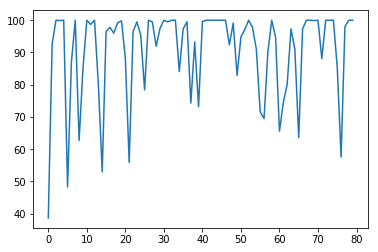

Time elapsed:1949.6359057426453
| Reward: 93 | Episode: 80 


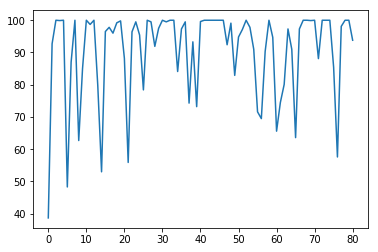

Time elapsed:1974.1834671497345
| Reward: 99 | Episode: 81 


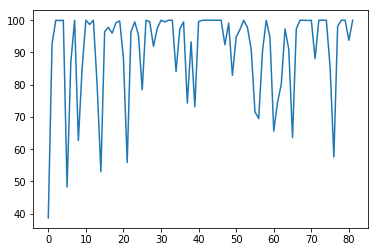

Time elapsed:1998.729826927185
| Reward: 99 | Episode: 82 


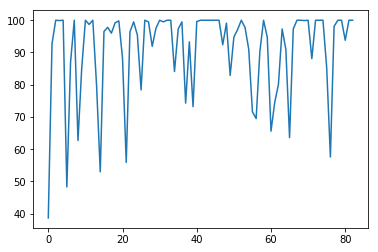

Time elapsed:2023.7750751972198
| Reward: 99 | Episode: 83 


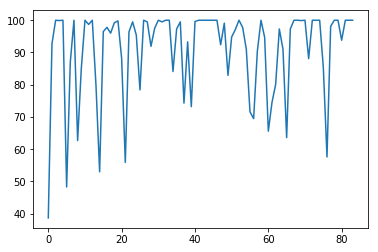

Time elapsed:2048.5369040966034
| Reward: 99 | Episode: 84 


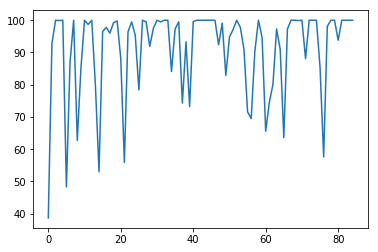

Time elapsed:2073.0387856960297
| Reward: 99 | Episode: 85 


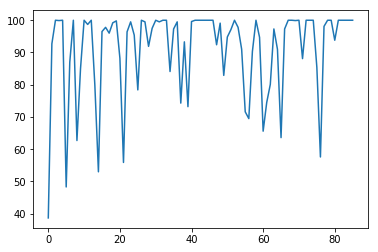

Time elapsed:2097.517506122589
| Reward: 95 | Episode: 86 


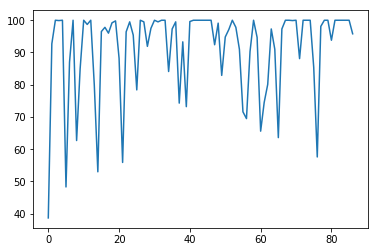

Time elapsed:2121.874435186386
| Reward: 99 | Episode: 87 


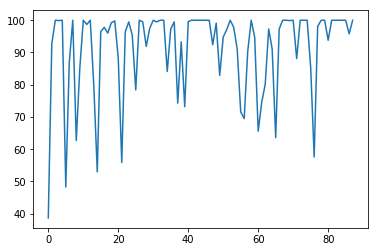

Time elapsed:2146.5715658664703
| Reward: 99 | Episode: 88 


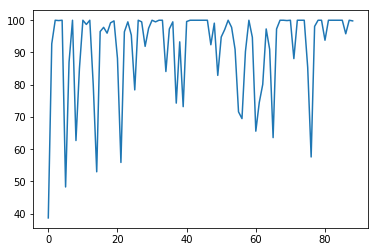

Time elapsed:2171.231328010559
| Reward: 90 | Episode: 89 


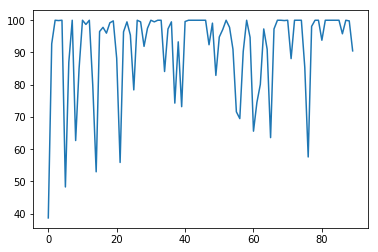

Time elapsed:2195.9905564785004
| Reward: 96 | Episode: 90 


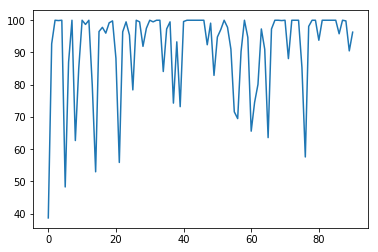

Time elapsed:2220.677925348282
| Reward: 80 | Episode: 91 


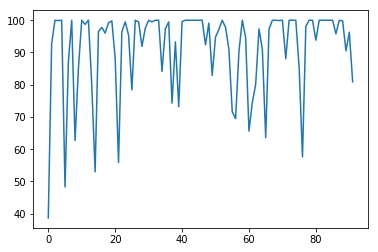

Time elapsed:2245.2380876541138
| Reward: 85 | Episode: 92 


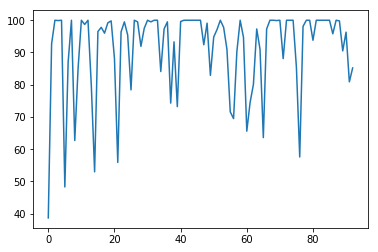

Time elapsed:2269.9705119132996
| Reward: 62 | Episode: 93 


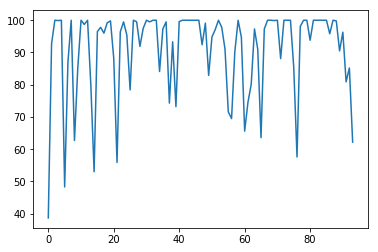

Time elapsed:2294.630646467209
| Reward: 77 | Episode: 94 


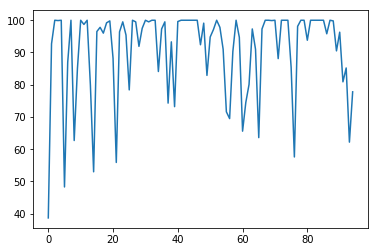

Time elapsed:2319.413352251053
| Reward: 99 | Episode: 95 


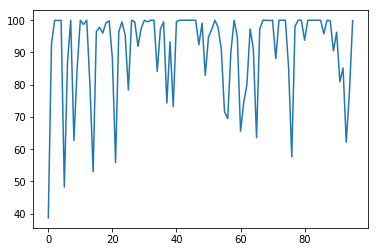

Time elapsed:2344.417992591858
| Reward: 51 | Episode: 96 


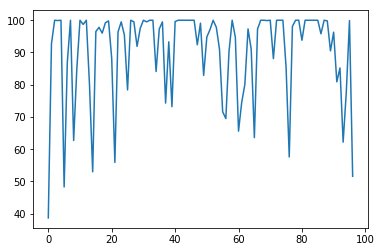

Time elapsed:2368.9086401462555
| Reward: 70 | Episode: 97 


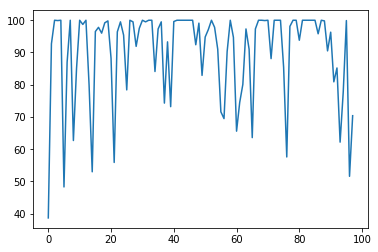

Time elapsed:2393.5356373786926
| Reward: 62 | Episode: 98 


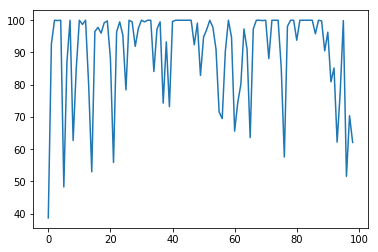

Time elapsed:2418.045365333557
| Reward: 78 | Episode: 99 


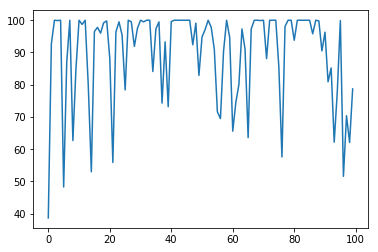

Time elapsed:2442.61470246315
| Reward: 22 | Episode: 100 


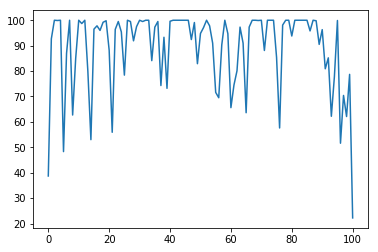

Time elapsed:2467.2381184101105
| Reward: 95 | Episode: 101 


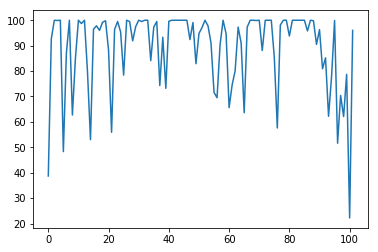

Time elapsed:2492.1978907585144
| Reward: 97 | Episode: 102 


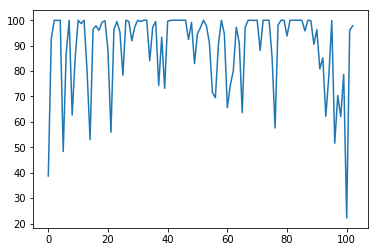

Time elapsed:2517.2711765766144
| Reward: 94 | Episode: 103 


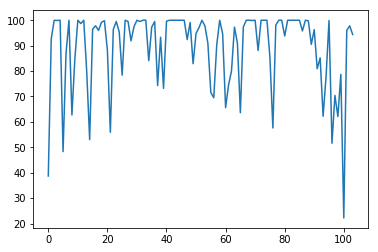

Time elapsed:2542.033436536789
| Reward: 99 | Episode: 104 


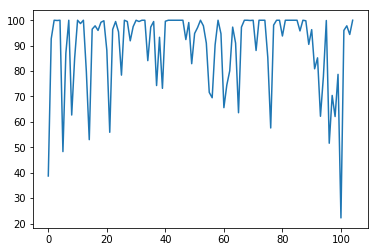

Time elapsed:2566.9857172966003
| Reward: 62 | Episode: 105 


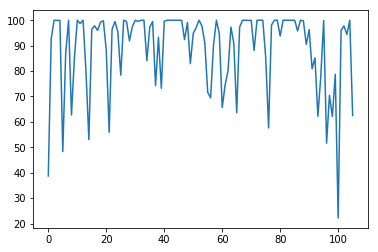

Time elapsed:2591.8570473194122
| Reward: 66 | Episode: 106 


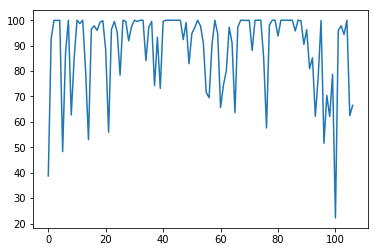

Time elapsed:2616.594383239746
| Reward: 90 | Episode: 107 


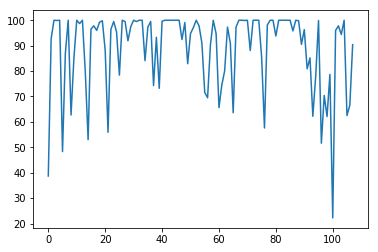

Time elapsed:2641.370193004608
| Reward: 93 | Episode: 108 


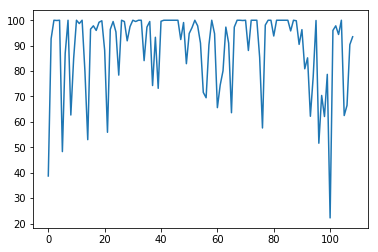

Time elapsed:2665.743263244629
| Reward: 99 | Episode: 109 


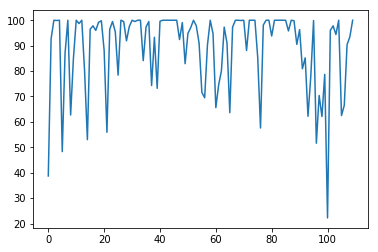

Time elapsed:2690.428004026413
| Reward: 99 | Episode: 110 


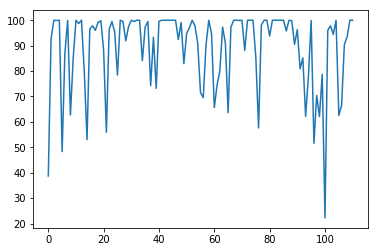

Time elapsed:2715.3094527721405
| Reward: 95 | Episode: 111 


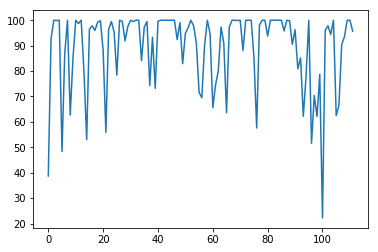

Time elapsed:2740.3257060050964
| Reward: 99 | Episode: 112 


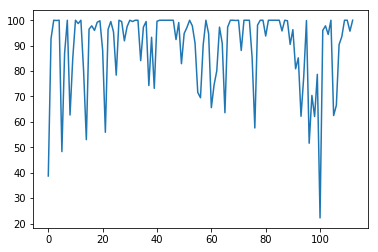

Time elapsed:2764.966804742813
| Reward: 99 | Episode: 113 


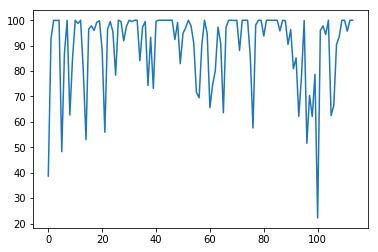

Time elapsed:2789.498497724533
| Reward: 99 | Episode: 114 


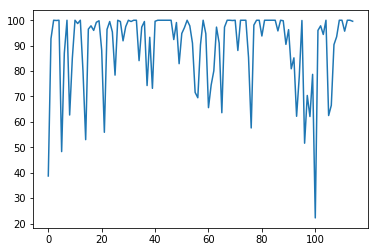

Time elapsed:2814.2165002822876
| Reward: 97 | Episode: 115 


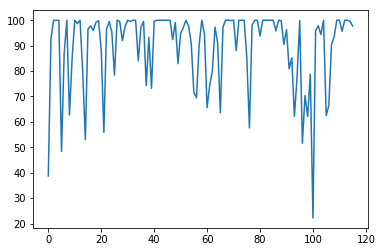

Time elapsed:2838.796832561493
| Reward: 99 | Episode: 116 


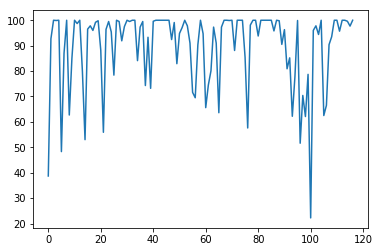

Time elapsed:2863.3914742469788
| Reward: 99 | Episode: 117 


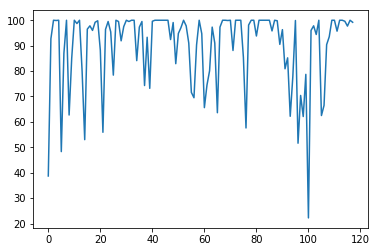

Time elapsed:2888.43026804924
| Reward: 99 | Episode: 118 


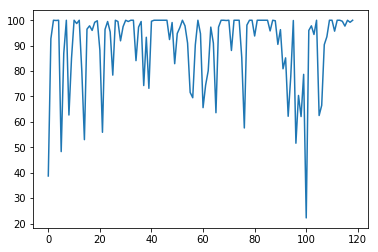

Time elapsed:2913.4829885959625
| Reward: 99 | Episode: 119 


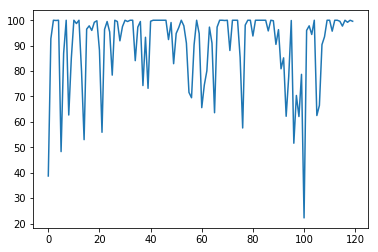

Time elapsed:2938.415267467499
| Reward: 99 | Episode: 120 


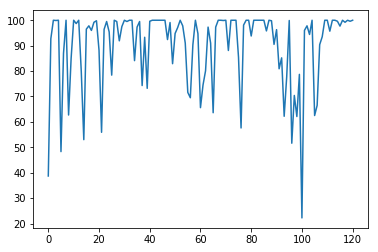

Time elapsed:2963.504908323288
| Reward: 82 | Episode: 121 


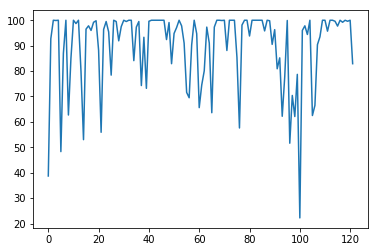

Time elapsed:2988.1671097278595
| Reward: 79 | Episode: 122 


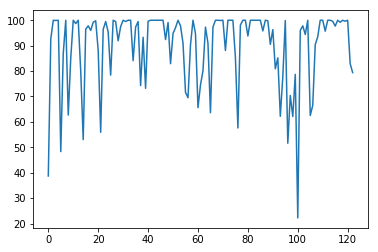

Time elapsed:3012.3266813755035
| Reward: 99 | Episode: 123 


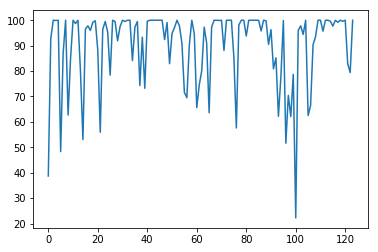

Time elapsed:3036.6793563365936
| Reward: 99 | Episode: 124 


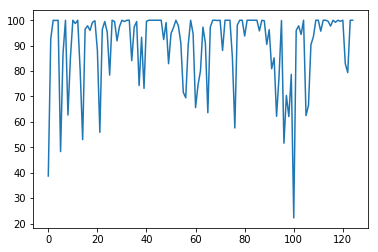

Time elapsed:3060.9131841659546
| Reward: 99 | Episode: 125 


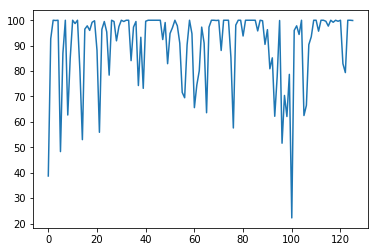

Time elapsed:3085.2848019599915
| Reward: 94 | Episode: 126 


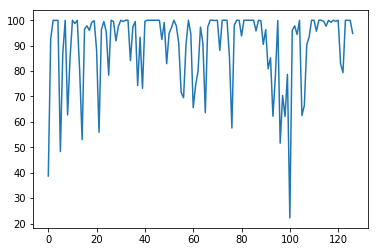

Time elapsed:3109.82910490036
| Reward: 62 | Episode: 127 


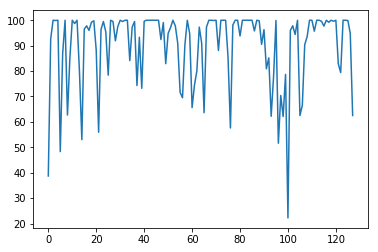

Time elapsed:3134.3275907039642
| Reward: 49 | Episode: 128 


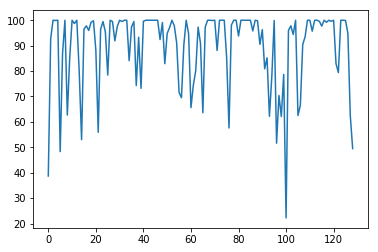

Time elapsed:3158.8515615463257
| Reward: 99 | Episode: 129 


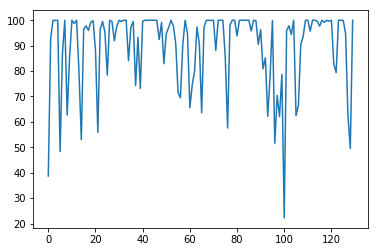

Time elapsed:3183.273402452469
| Reward: 99 | Episode: 130 


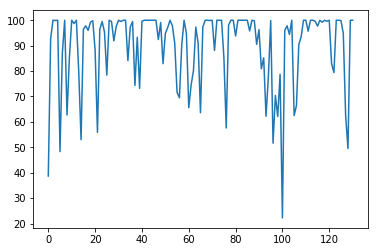

Time elapsed:3207.642512321472
| Reward: 99 | Episode: 131 


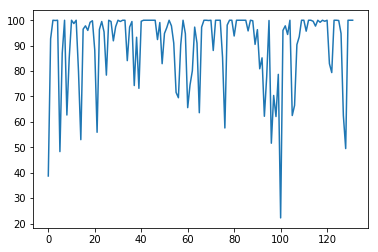

Time elapsed:3232.032649040222
| Reward: 98 | Episode: 132 


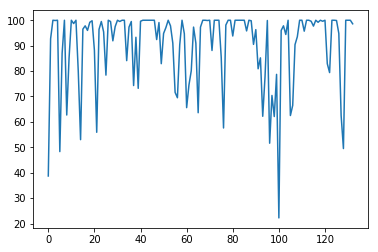

Time elapsed:3256.4015436172485
| Reward: 99 | Episode: 133 


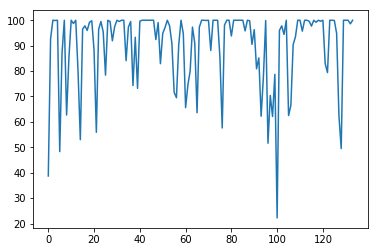

Time elapsed:3280.706869363785
| Reward: 76 | Episode: 134 


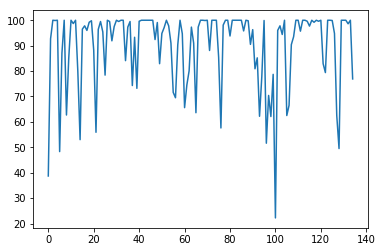

Time elapsed:3304.969873189926
| Reward: 96 | Episode: 135 


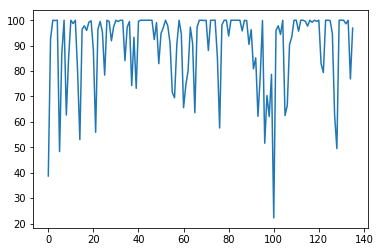

Time elapsed:3329.3095173835754
| Reward: 97 | Episode: 136 


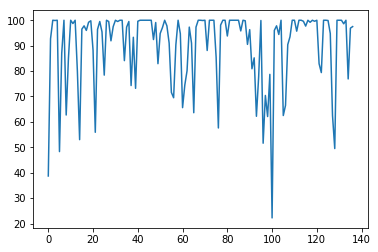

Time elapsed:3353.9636430740356
| Reward: 97 | Episode: 137 


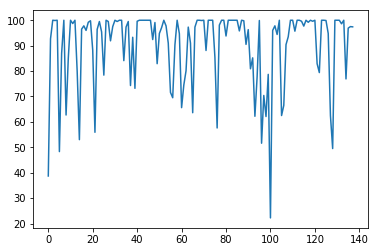

Time elapsed:3378.229471206665
| Reward: 97 | Episode: 138 


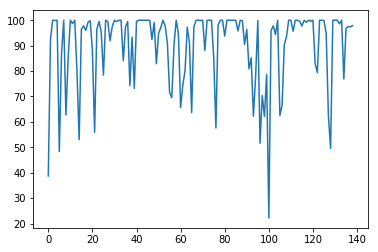

Time elapsed:3402.8808948993683
| Reward: 81 | Episode: 139 


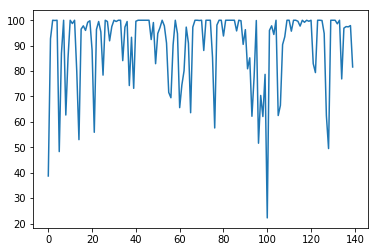

Time elapsed:3427.160943508148
| Reward: 91 | Episode: 140 


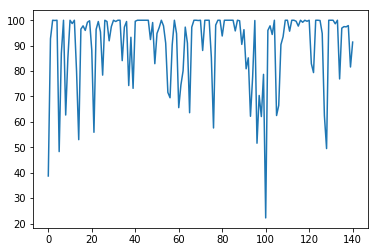

Time elapsed:3451.646812915802
| Reward: 79 | Episode: 141 


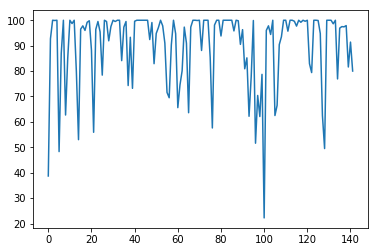

Time elapsed:3476.1498255729675
| Reward: 77 | Episode: 142 


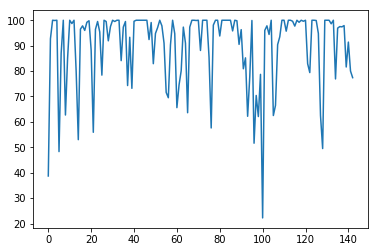

Time elapsed:3500.524053812027
| Reward: 74 | Episode: 143 


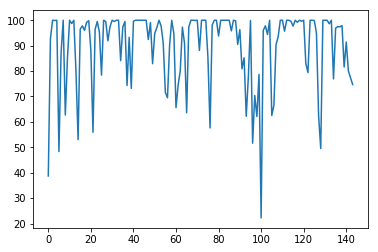

Time elapsed:3524.99481344223
| Reward: 89 | Episode: 144 


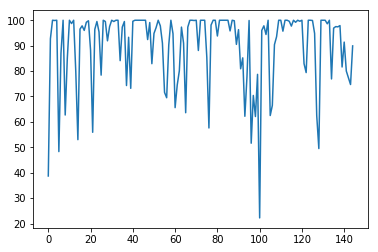

Time elapsed:3549.4241831302643
| Reward: 99 | Episode: 145 


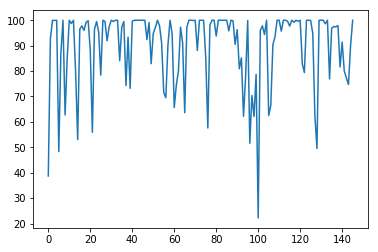

Time elapsed:3573.8340497016907
| Reward: 37 | Episode: 146 


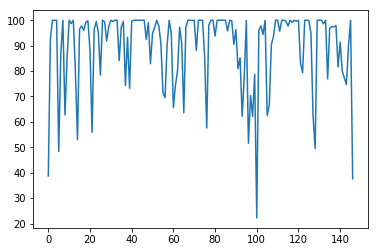

Time elapsed:3598.2434067726135
| Reward: 47 | Episode: 147 


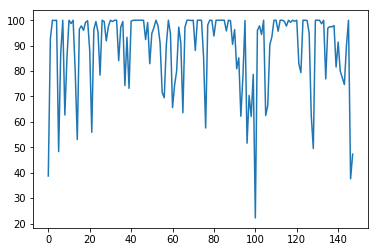

Time elapsed:3622.608205795288
| Reward: 79 | Episode: 148 


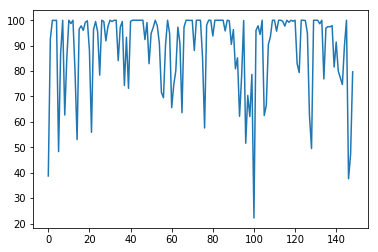

Time elapsed:3647.0569310188293
| Reward: 63 | Episode: 149 


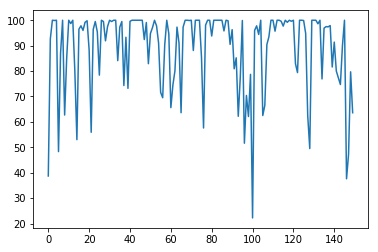

Time elapsed:3671.5030620098114
| Reward: 63 | Episode: 150 


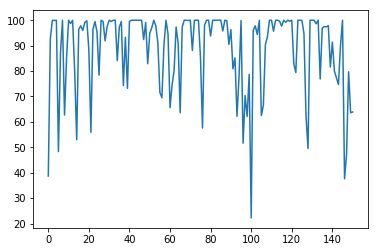

Time elapsed:3695.9223301410675
| Reward: 99 | Episode: 151 


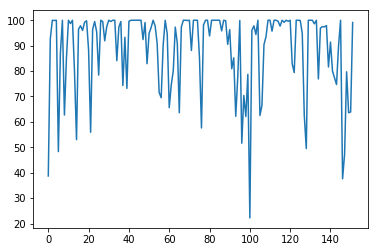

Time elapsed:3720.5141417980194
| Reward: 83 | Episode: 152 


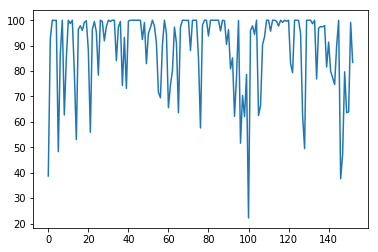

Time elapsed:3744.893000125885
| Reward: 69 | Episode: 153 


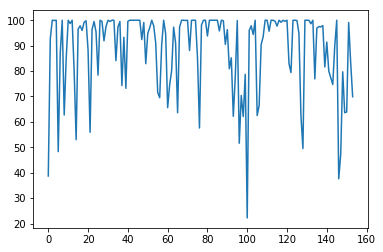

Time elapsed:3769.532909154892
| Reward: 93 | Episode: 154 


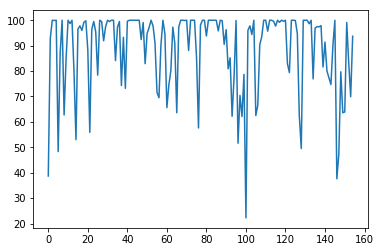

Time elapsed:3793.8837683200836
| Reward: 62 | Episode: 155 


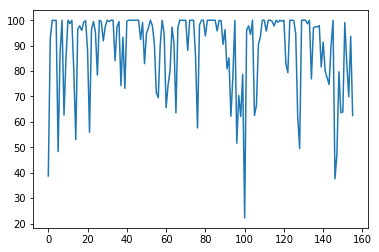

Time elapsed:3818.351425409317
| Reward: 95 | Episode: 156 


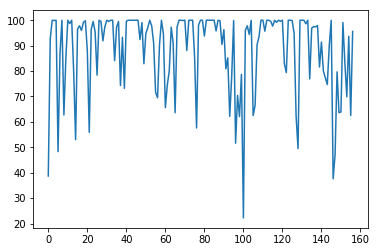

Time elapsed:3842.7795164585114
| Reward: 96 | Episode: 157 


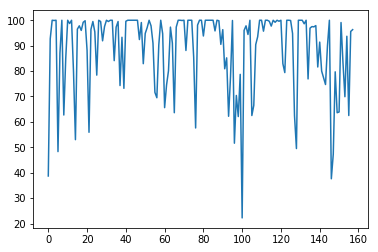

Time elapsed:3867.1999850273132
| Reward: 81 | Episode: 158 


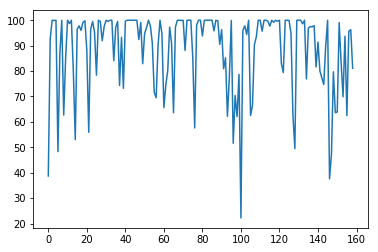

Time elapsed:3891.632306575775
| Reward: 99 | Episode: 159 


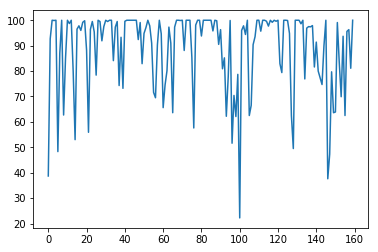

Time elapsed:3916.0880687236786
| Reward: 65 | Episode: 160 


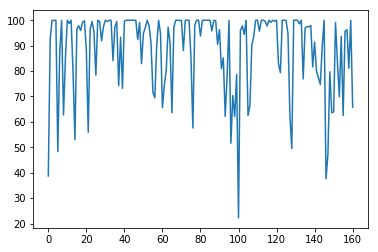

Time elapsed:3940.86988902092
| Reward: 87 | Episode: 161 


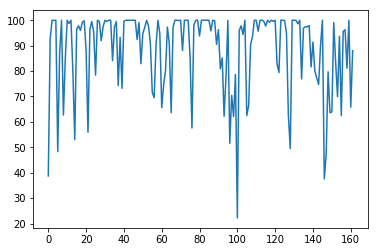

Time elapsed:3965.3308703899384
| Reward: 99 | Episode: 162 


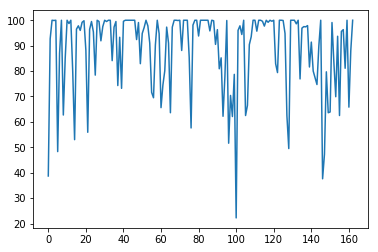

Time elapsed:3989.95933842659
| Reward: 83 | Episode: 163 


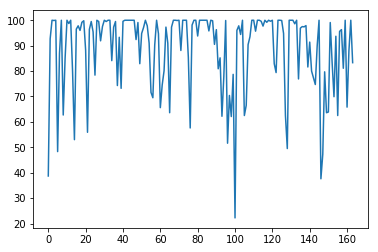

Time elapsed:4014.508894920349
| Reward: 78 | Episode: 164 


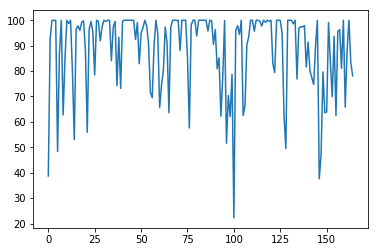

Time elapsed:4039.020030736923
| Reward: 95 | Episode: 165 


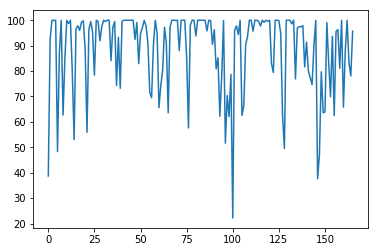

Time elapsed:4063.5576198101044
| Reward: 98 | Episode: 166 


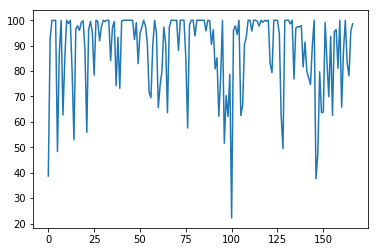

Time elapsed:4088.1685338020325
| Reward: 99 | Episode: 167 


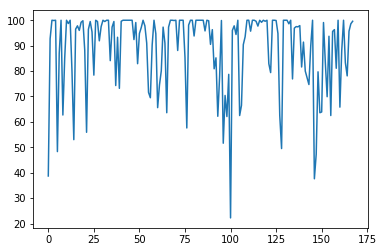

Time elapsed:4112.6799302101135
| Reward: 99 | Episode: 168 


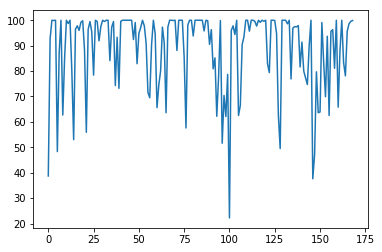

Time elapsed:4137.259466648102
| Reward: 92 | Episode: 169 


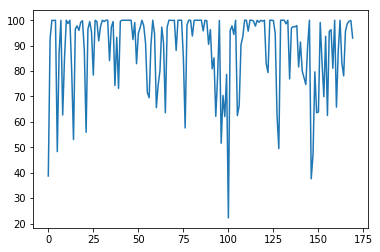

Time elapsed:4161.812235116959
| Reward: 86 | Episode: 170 


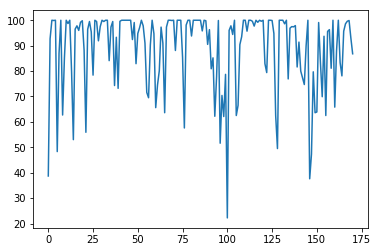

Time elapsed:4186.620343923569
| Reward: 99 | Episode: 171 


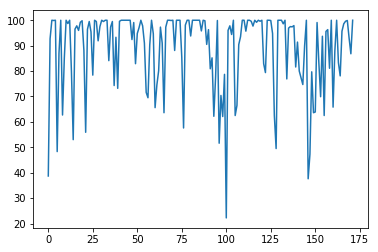

Time elapsed:4211.221378087997
| Reward: 99 | Episode: 172 


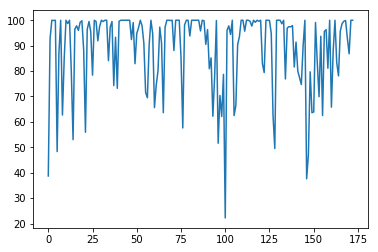

Time elapsed:4235.950852632523
| Reward: 95 | Episode: 173 


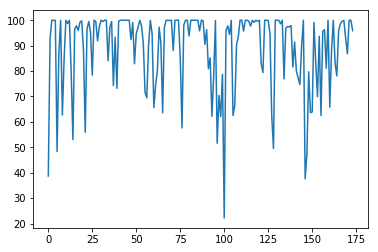

Time elapsed:4260.600491523743
| Reward: 83 | Episode: 174 


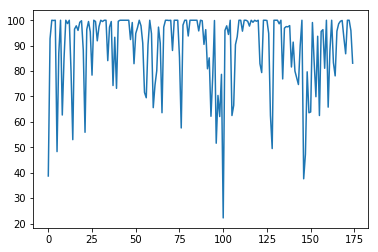

Time elapsed:4285.151629924774
| Reward: 88 | Episode: 175 


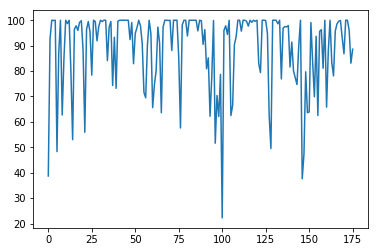

Time elapsed:4310.088878393173
| Reward: 99 | Episode: 176 


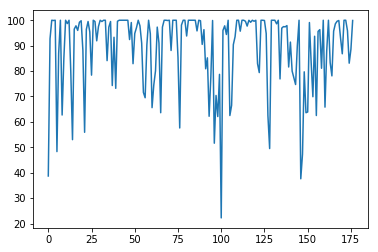

Time elapsed:4334.874330282211
| Reward: 83 | Episode: 177 


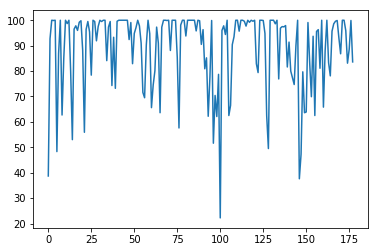

Time elapsed:4359.814054727554
| Reward: 59 | Episode: 178 


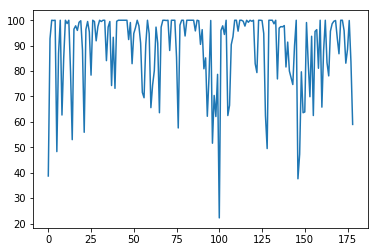

Time elapsed:4384.365500688553
| Reward: 70 | Episode: 179 


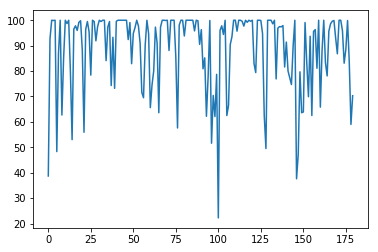

Time elapsed:4408.991261005402
| Reward: 83 | Episode: 180 


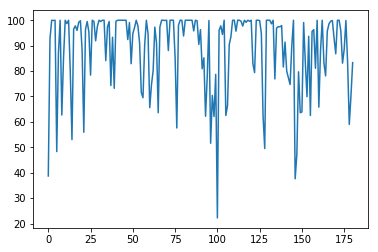

Time elapsed:4433.711063623428
| Reward: 76 | Episode: 181 


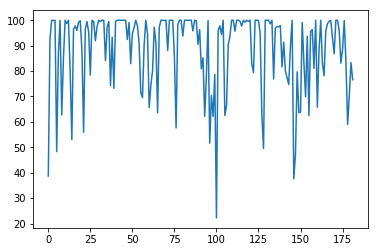

Time elapsed:4458.301518440247
| Reward: 87 | Episode: 182 


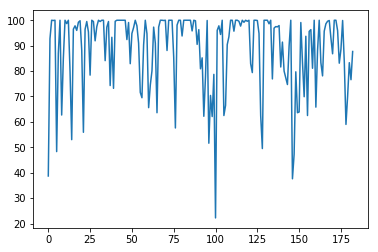

Time elapsed:4482.910501003265
| Reward: 99 | Episode: 183 


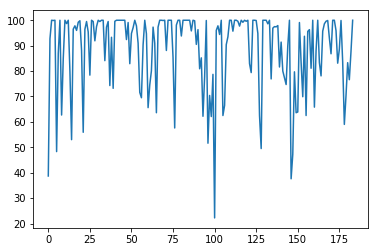

Time elapsed:4507.5268387794495
| Reward: 90 | Episode: 184 


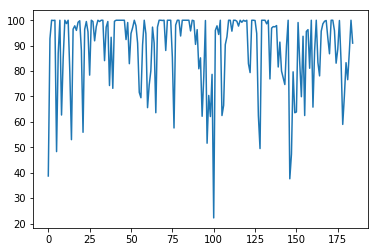

Time elapsed:4532.282003879547
| Reward: 83 | Episode: 185 


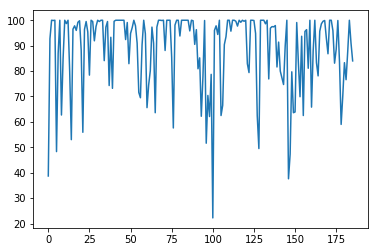

Time elapsed:4557.061450481415
| Reward: 99 | Episode: 186 


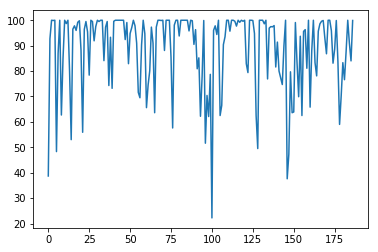

Time elapsed:4581.744857549667
| Reward: 99 | Episode: 187 


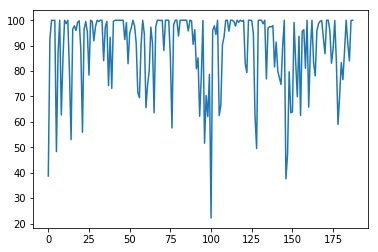

Time elapsed:4606.351891279221
| Reward: 99 | Episode: 188 


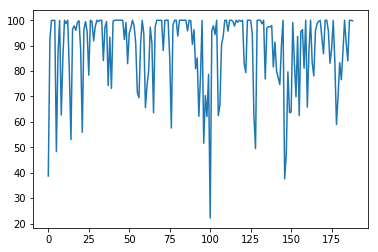

Time elapsed:4630.999782085419
| Reward: 99 | Episode: 189 


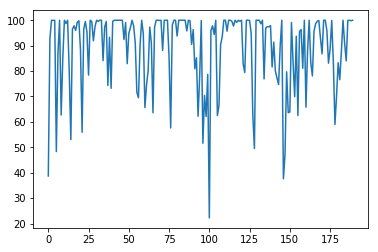

Time elapsed:4655.614371061325
| Reward: 90 | Episode: 190 


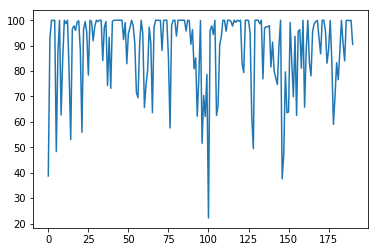

Time elapsed:4680.373010158539
| Reward: 44 | Episode: 191 


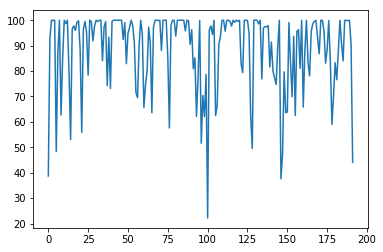

Time elapsed:4705.017099142075
| Reward: 67 | Episode: 192 


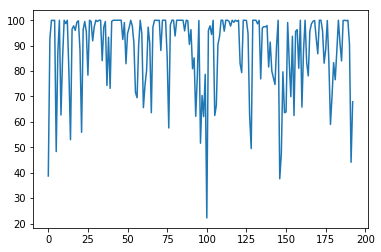

Time elapsed:4729.770801067352
| Reward: 92 | Episode: 193 


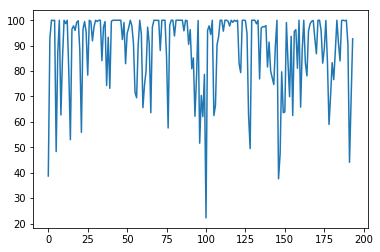

Time elapsed:4754.384184360504
| Reward: 98 | Episode: 194 


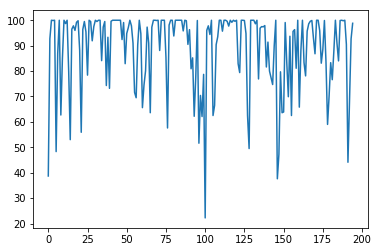

Time elapsed:4779.06063246727
| Reward: 95 | Episode: 195 


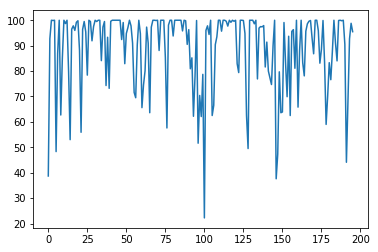

Time elapsed:4803.752178430557
| Reward: 98 | Episode: 196 


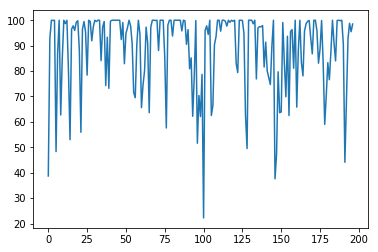

Time elapsed:4828.397882699966
| Reward: 93 | Episode: 197 


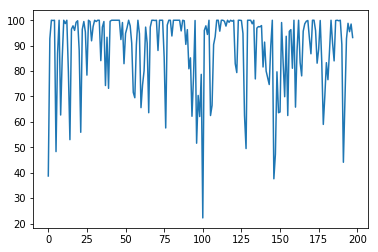

Time elapsed:4853.1316821575165
| Reward: 99 | Episode: 198 


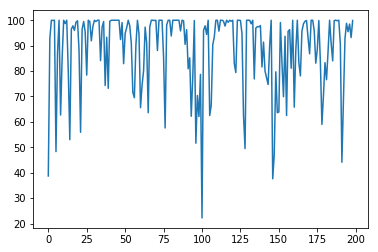

Time elapsed:4877.836178779602
| Reward: 62 | Episode: 199 


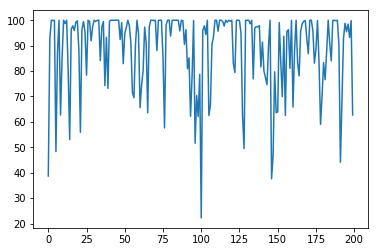

Time elapsed:4902.778552770615
| Reward: 78 | Episode: 200 


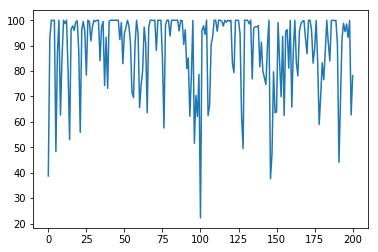

Time elapsed:4927.452617406845
| Reward: 99 | Episode: 201 


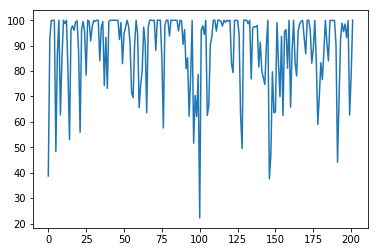

Time elapsed:4952.282082080841
| Reward: 92 | Episode: 202 


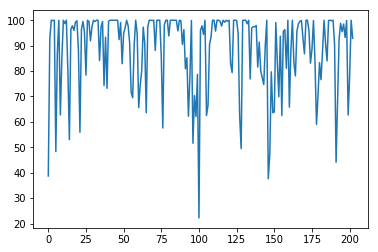

Time elapsed:4976.935763835907
| Reward: 76 | Episode: 203 


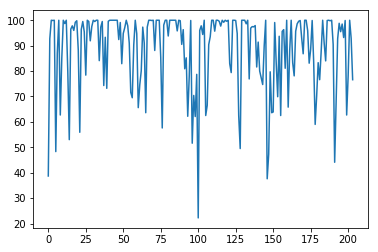

Time elapsed:5001.681983947754
| Reward: 44 | Episode: 204 


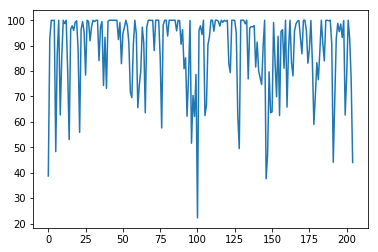

Time elapsed:5026.641294717789
| Reward: 95 | Episode: 205 


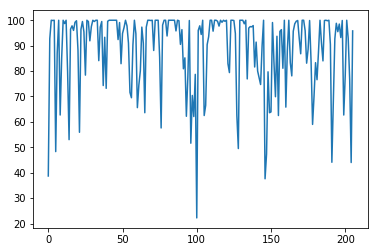

Time elapsed:5051.565858602524
| Reward: 99 | Episode: 206 


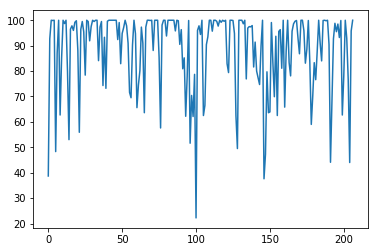

Time elapsed:5076.320078611374
| Reward: 86 | Episode: 207 


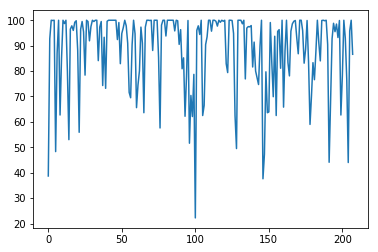

Time elapsed:5101.078307390213
| Reward: 52 | Episode: 208 


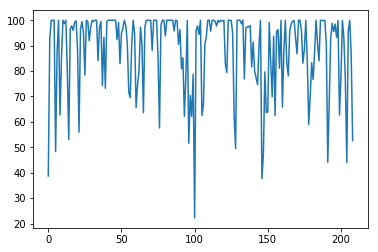

Time elapsed:5126.121220111847
| Reward: 84 | Episode: 209 


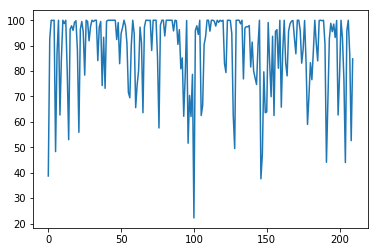

Time elapsed:5150.997646331787
| Reward: 99 | Episode: 210 


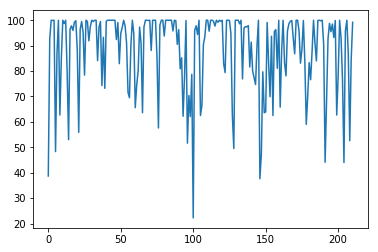

Time elapsed:5175.775568246841
| Reward: 99 | Episode: 211 


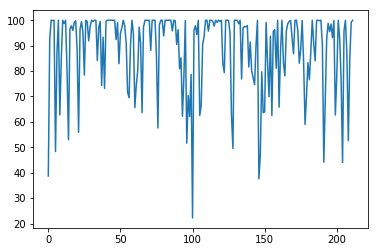

Time elapsed:5200.939494132996
| Reward: 17 | Episode: 212 


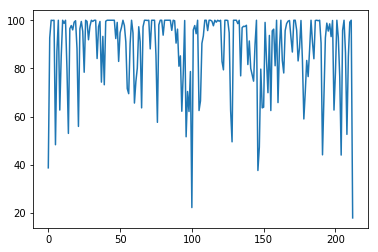

Time elapsed:5225.861202716827
| Reward: 75 | Episode: 213 


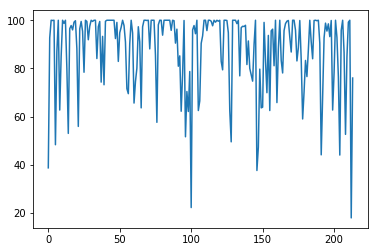

Time elapsed:5250.642887592316
| Reward: 83 | Episode: 214 


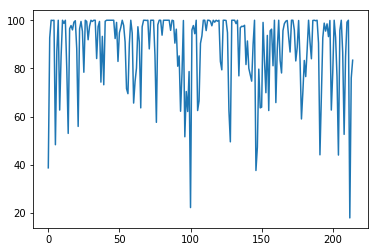

Time elapsed:5275.730508565903
| Reward: 90 | Episode: 215 


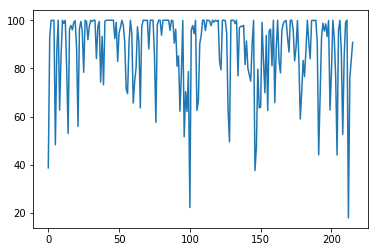

Time elapsed:5300.728674411774
| Reward: 81 | Episode: 216 


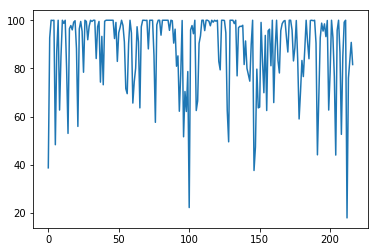

Time elapsed:5325.5994737148285
| Reward: 99 | Episode: 217 


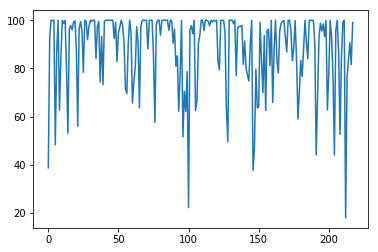

Time elapsed:5350.370947360992
| Reward: 75 | Episode: 218 


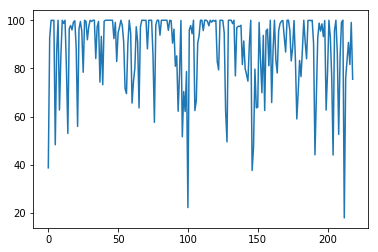

Time elapsed:5375.15296125412
| Reward: 98 | Episode: 219 


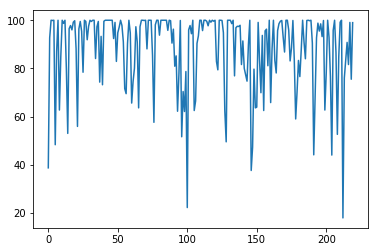

Time elapsed:5400.067045211792
| Reward: 94 | Episode: 220 


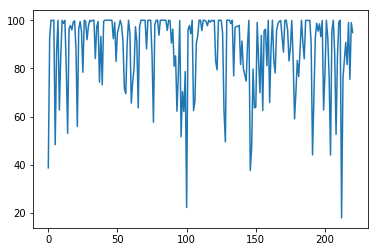

Time elapsed:5424.833631277084
| Reward: 92 | Episode: 221 


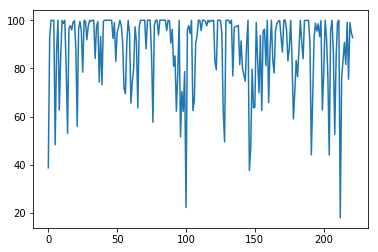

Time elapsed:5449.756467342377
| Reward: 91 | Episode: 222 


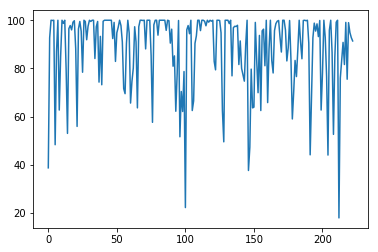

Time elapsed:5474.463254928589
| Reward: 97 | Episode: 223 


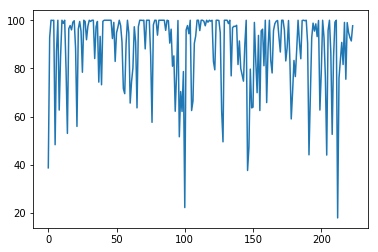

Time elapsed:5499.397160053253
| Reward: 99 | Episode: 224 


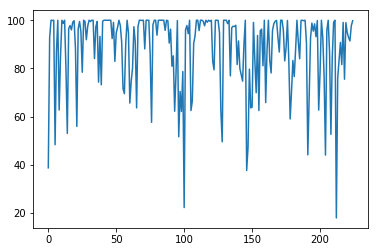

Time elapsed:5524.409391641617
| Reward: 99 | Episode: 225 


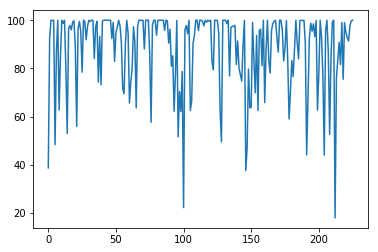

Time elapsed:5549.143015861511
| Reward: 99 | Episode: 226 


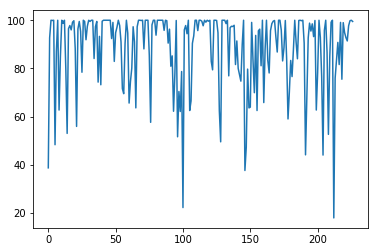

Time elapsed:5574.161274433136
| Reward: 99 | Episode: 227 


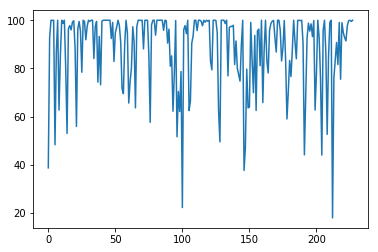

Time elapsed:5598.929002523422
| Reward: 99 | Episode: 228 


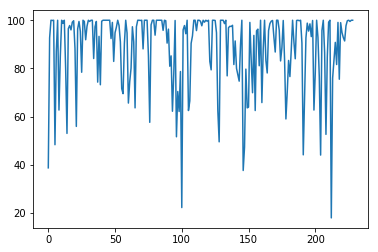

Time elapsed:5623.994974851608
| Reward: 99 | Episode: 229 


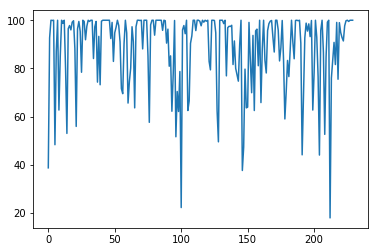

Time elapsed:5648.853129863739
| Reward: 85 | Episode: 230 


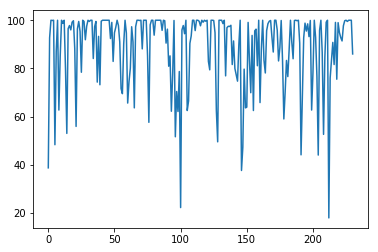

Time elapsed:5673.8700914382935
| Reward: 96 | Episode: 231 


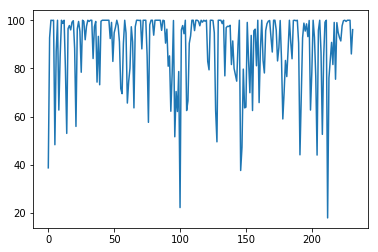

Time elapsed:5698.670861005783
| Reward: 98 | Episode: 232 


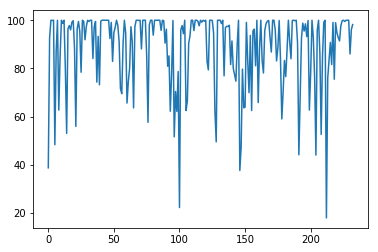

Time elapsed:5723.560176610947
| Reward: 91 | Episode: 233 


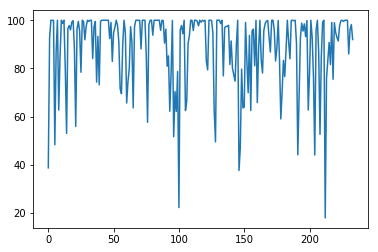

Time elapsed:5748.436148405075
| Reward: 79 | Episode: 234 


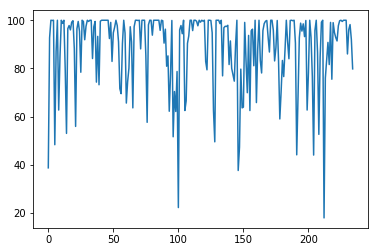

Time elapsed:5773.272016763687
| Reward: 91 | Episode: 235 


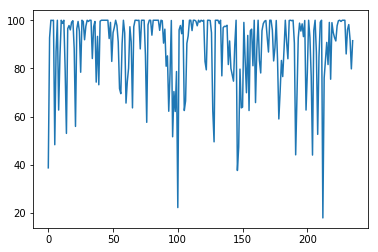

Time elapsed:5798.20046710968
| Reward: 89 | Episode: 236 


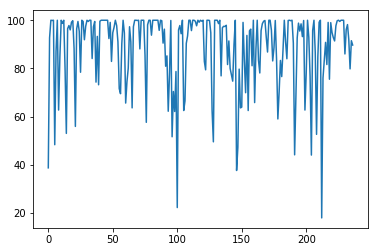

Time elapsed:5823.067181825638
| Reward: 89 | Episode: 237 


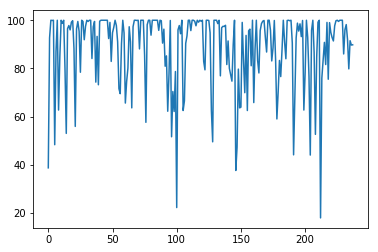

Time elapsed:5848.065980434418
| Reward: 95 | Episode: 238 


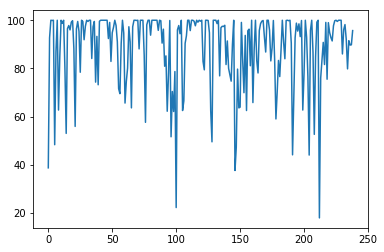

Time elapsed:5873.156332731247
| Reward: 93 | Episode: 239 


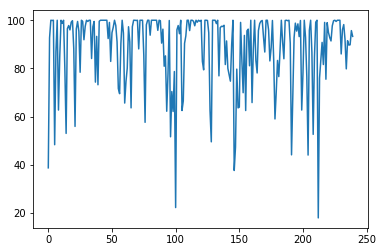

Time elapsed:5898.09154009819
| Reward: 67 | Episode: 240 


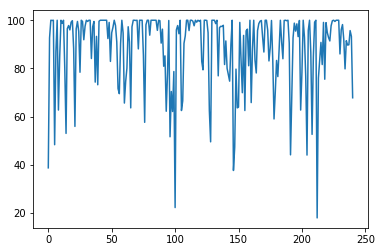

Time elapsed:5923.0376234054565
| Reward: 82 | Episode: 241 


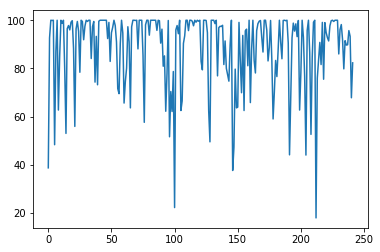

Time elapsed:5948.015258312225
| Reward: 95 | Episode: 242 


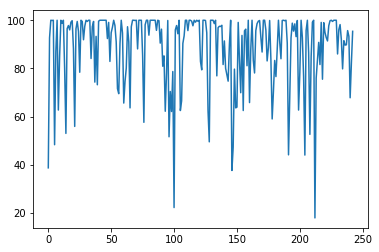

Time elapsed:5973.088146448135
| Reward: 86 | Episode: 243 


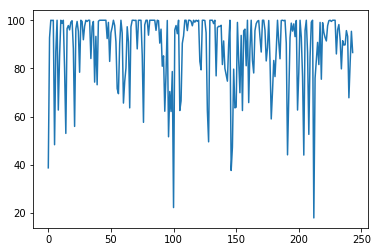

Time elapsed:5998.062445163727
| Reward: 81 | Episode: 244 


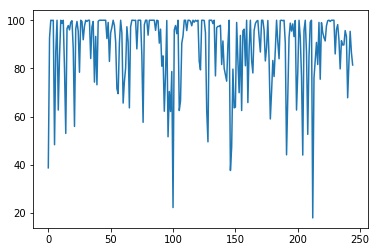

Time elapsed:6023.358679056168
| Reward: 98 | Episode: 245 


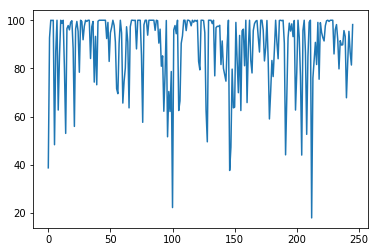

Time elapsed:6048.371026277542
| Reward: 89 | Episode: 246 


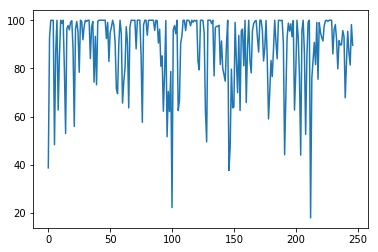

Time elapsed:6073.395177602768
| Reward: 98 | Episode: 247 


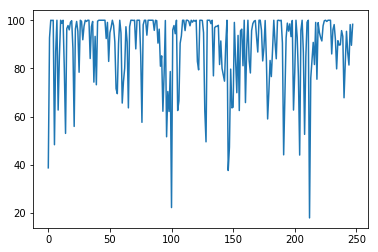

Time elapsed:6098.508449316025
| Reward: 99 | Episode: 248 


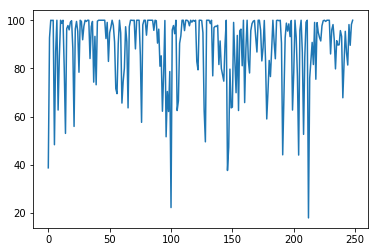

Time elapsed:6123.625006437302
| Reward: 99 | Episode: 249 


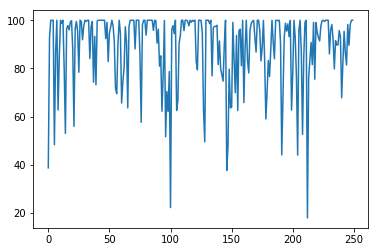

Time elapsed:6148.799037694931
| Reward: 98 | Episode: 250 


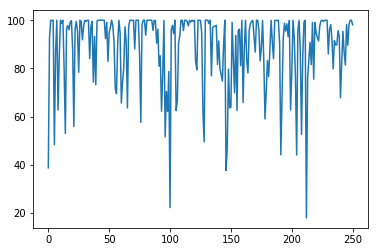

Time elapsed:6173.856404304504
| Reward: 99 | Episode: 251 


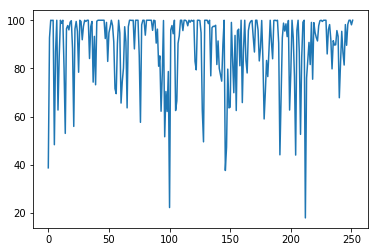

Time elapsed:6199.010999202728
| Reward: 94 | Episode: 252 


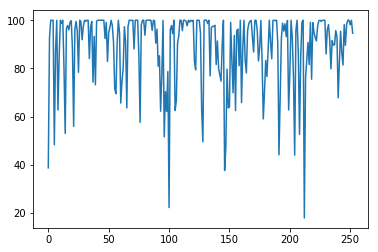

Time elapsed:6224.154019117355
| Reward: 82 | Episode: 253 


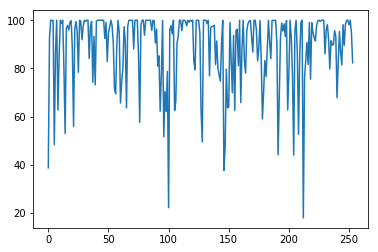

Time elapsed:6249.253709316254
| Reward: 71 | Episode: 254 


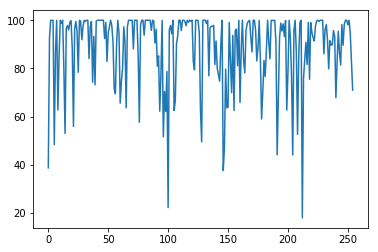

Time elapsed:6274.488857507706
| Reward: 81 | Episode: 255 


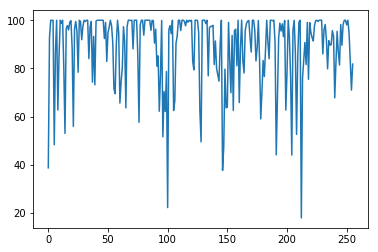

Time elapsed:6299.630975008011
| Reward: 64 | Episode: 256 


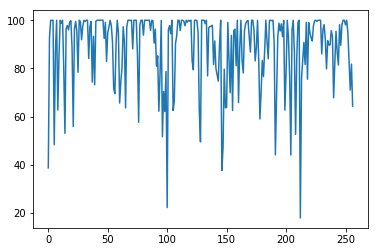

Time elapsed:6324.87383389473
| Reward: 57 | Episode: 257 


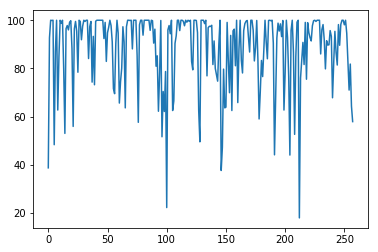

Time elapsed:6349.997779130936
| Reward: 81 | Episode: 258 


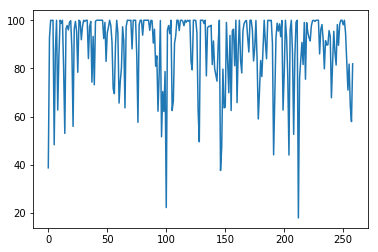

Time elapsed:6375.153882265091
| Reward: 47 | Episode: 259 


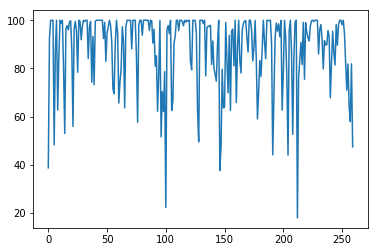

Time elapsed:6400.279172897339
| Reward: 95 | Episode: 260 


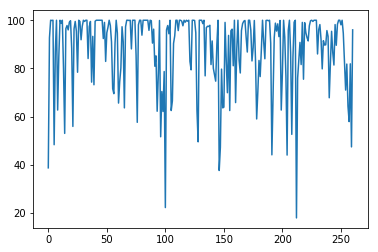

Time elapsed:6425.453986883163
| Reward: 97 | Episode: 261 


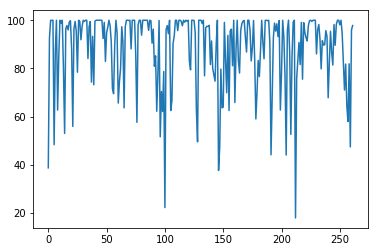

Time elapsed:6450.570936203003
| Reward: 78 | Episode: 262 


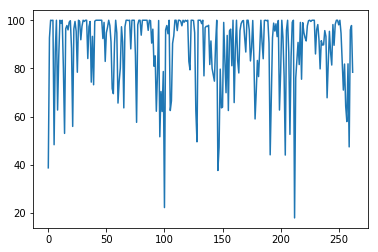

Time elapsed:6475.972833871841
| Reward: 80 | Episode: 263 


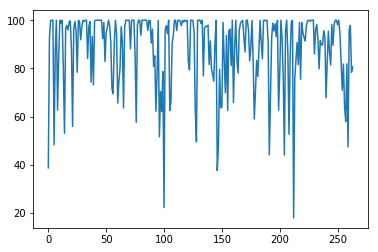

Time elapsed:6501.154872894287
| Reward: 88 | Episode: 264 


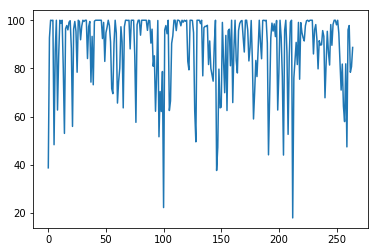

Time elapsed:6526.326645851135
| Reward: 96 | Episode: 265 


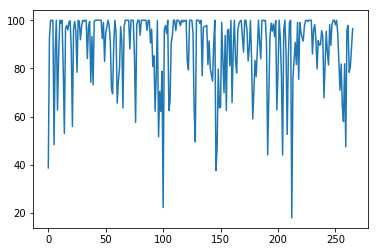

Time elapsed:6551.54435300827
| Reward: 87 | Episode: 266 


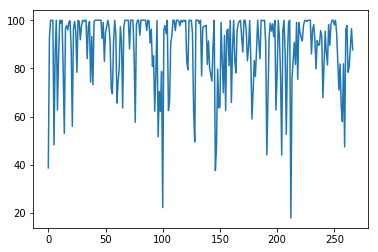

Time elapsed:6576.71940279007
| Reward: 91 | Episode: 267 


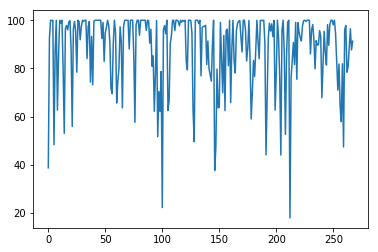

Time elapsed:6602.124844789505
| Reward: 91 | Episode: 268 


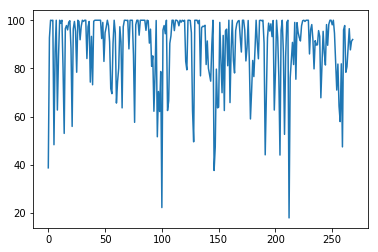

Time elapsed:6627.471000671387
| Reward: 95 | Episode: 269 


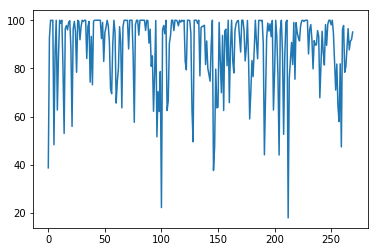

Time elapsed:6652.689161300659
| Reward: 18 | Episode: 270 


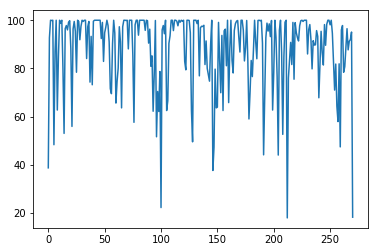

Time elapsed:6678.166876554489
| Reward: 71 | Episode: 271 


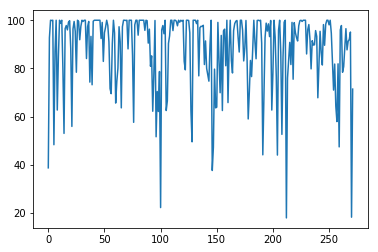

Time elapsed:6703.385079860687
| Reward: 99 | Episode: 272 


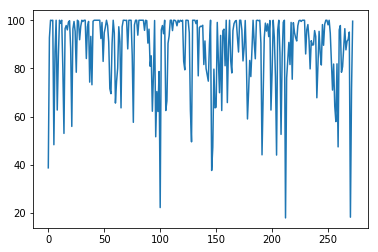

Time elapsed:6728.836940050125
| Reward: 94 | Episode: 273 


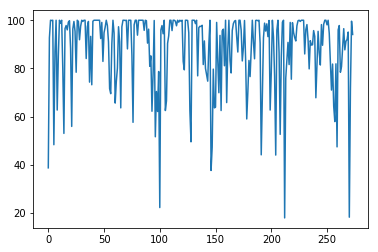

Time elapsed:6754.099947214127
| Reward: 99 | Episode: 274 


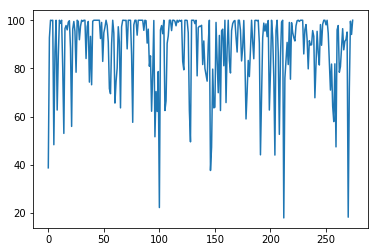

Time elapsed:6779.32425069809
| Reward: 99 | Episode: 275 


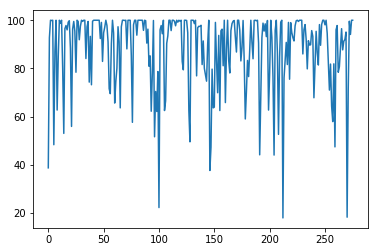

Time elapsed:6804.743730068207
| Reward: 95 | Episode: 276 


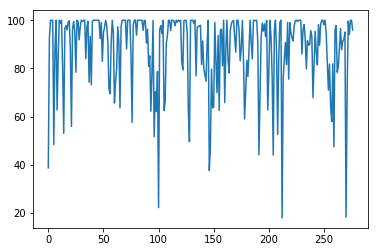

Time elapsed:6830.118320941925
| Reward: 99 | Episode: 277 


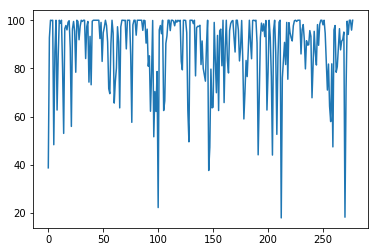

Time elapsed:6855.478293895721
| Reward: 99 | Episode: 278 


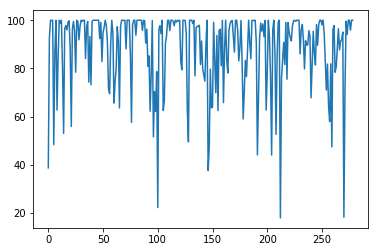

Time elapsed:6880.812496185303
| Reward: 95 | Episode: 279 


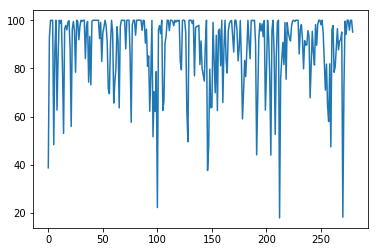

Time elapsed:6906.267941474915
| Reward: 91 | Episode: 280 


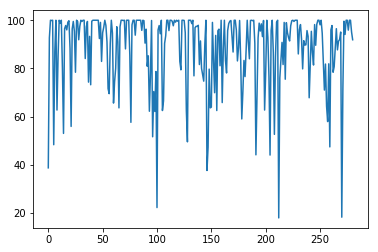

Time elapsed:6931.721320867538
| Reward: 87 | Episode: 281 


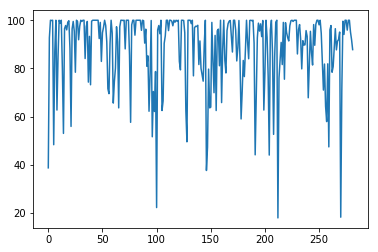

Time elapsed:6957.27185177803
| Reward: 99 | Episode: 282 


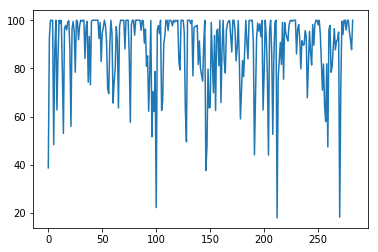

Time elapsed:6982.663962125778
| Reward: 99 | Episode: 283 


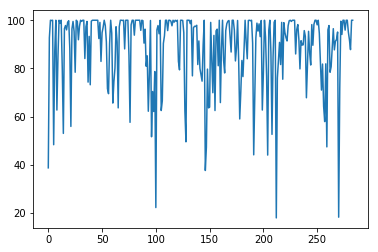

Time elapsed:7008.516464948654
| Reward: 68 | Episode: 284 


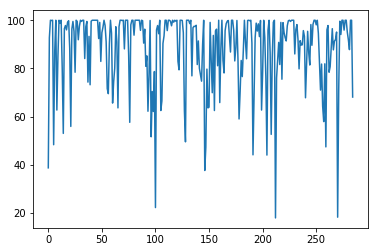

Time elapsed:7033.973779439926
| Reward: 89 | Episode: 285 


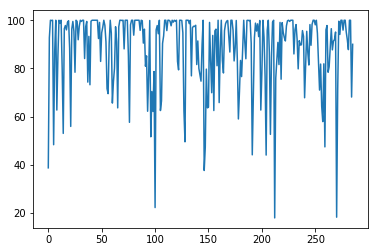

Time elapsed:7059.403278827667
| Reward: 89 | Episode: 286 


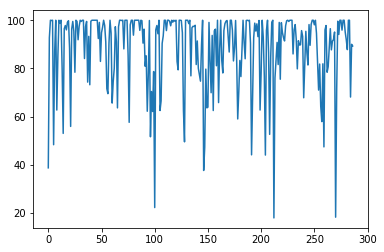

Time elapsed:7084.923699140549
| Reward: 11 | Episode: 287 


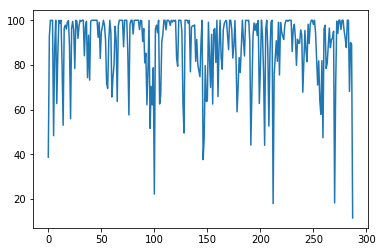

Time elapsed:7110.388367652893
| Reward: 49 | Episode: 288 


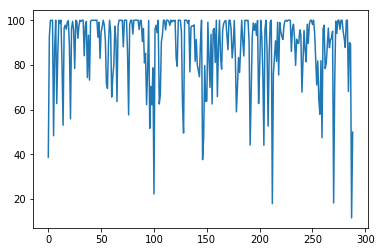

Time elapsed:7135.868952989578
| Reward: 78 | Episode: 289 


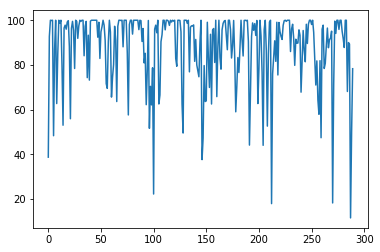

Time elapsed:7161.321394205093
| Reward: 88 | Episode: 290 


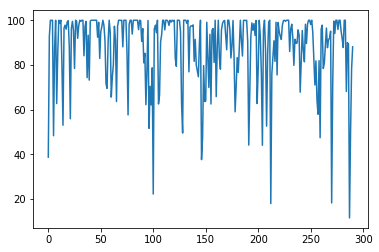

Time elapsed:7186.7511529922485
| Reward: 63 | Episode: 291 


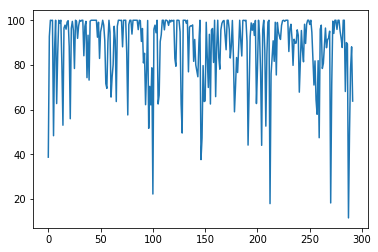

Time elapsed:7212.09757566452
| Reward: 66 | Episode: 292 


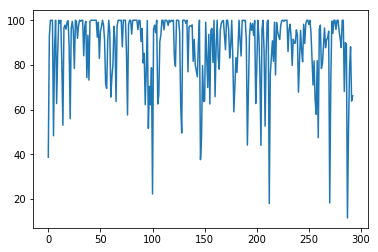

Time elapsed:7237.47624540329
| Reward: 72 | Episode: 293 


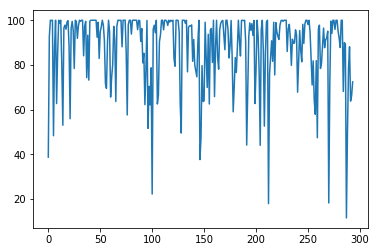

Time elapsed:7263.040236949921
| Reward: 92 | Episode: 294 


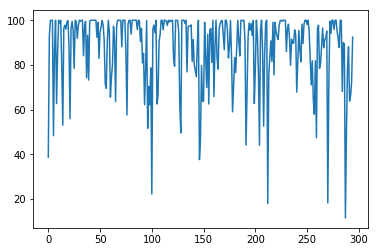

Time elapsed:7288.502217769623
| Reward: 99 | Episode: 295 


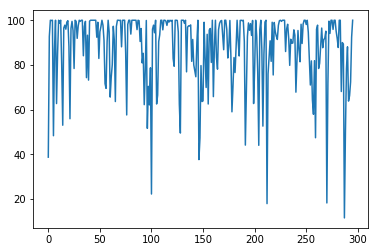

Time elapsed:7314.435962677002
| Reward: 82 | Episode: 296 


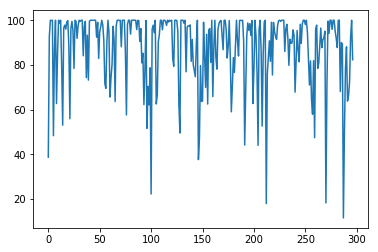

Time elapsed:7339.989189863205
| Reward: 69 | Episode: 297 


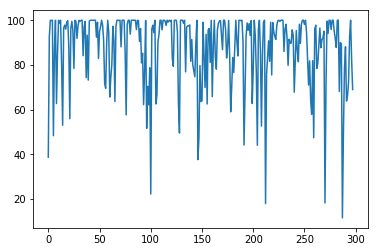

Time elapsed:7365.513506650925
| Reward: 99 | Episode: 298 


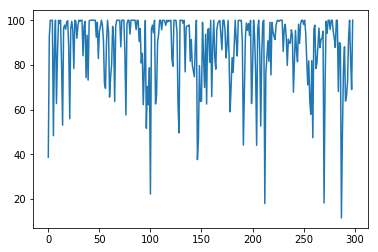

Time elapsed:7391.235287189484
| Reward: 99 | Episode: 299 


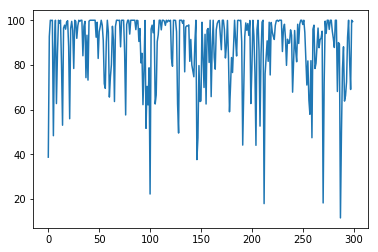

Time elapsed:7416.744071960449
| Reward: 99 | Episode: 300 


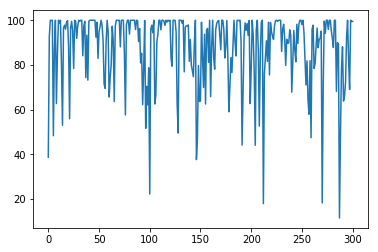

Time elapsed:7442.6802361011505
| Reward: 98 | Episode: 301 


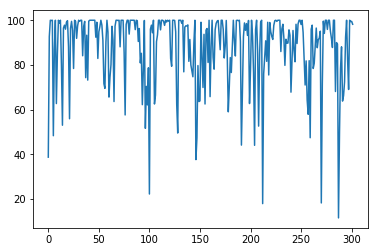

Time elapsed:7468.258444786072
| Reward: 99 | Episode: 302 


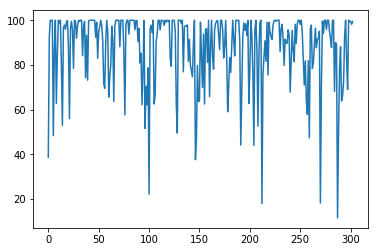

Time elapsed:7493.818599939346
| Reward: 85 | Episode: 303 


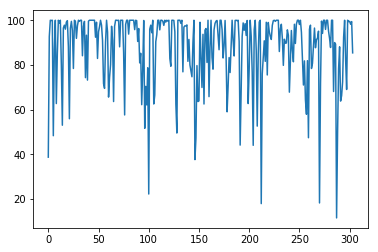

Time elapsed:7519.341929912567
| Reward: 61 | Episode: 304 


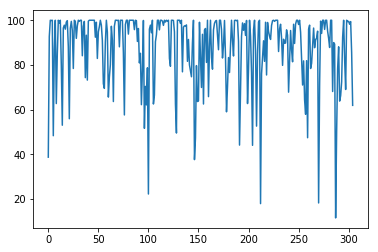

Time elapsed:7544.901792764664
| Reward: 93 | Episode: 305 


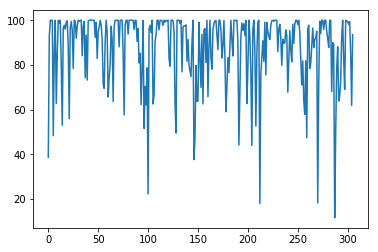

Time elapsed:7570.574729919434
| Reward: 97 | Episode: 306 


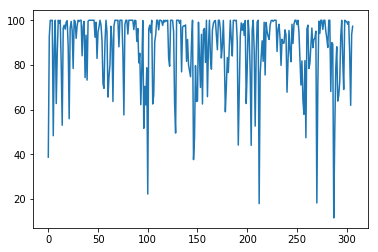

Time elapsed:7596.146807909012
| Reward: 92 | Episode: 307 


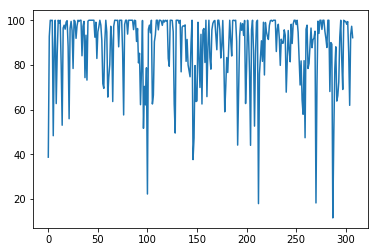

Time elapsed:7621.797119855881
| Reward: 99 | Episode: 308 


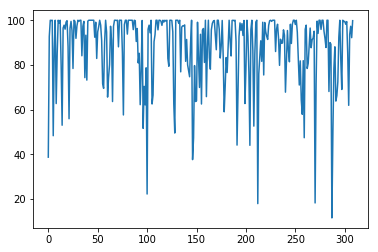

Time elapsed:7647.415218830109
| Reward: 94 | Episode: 309 


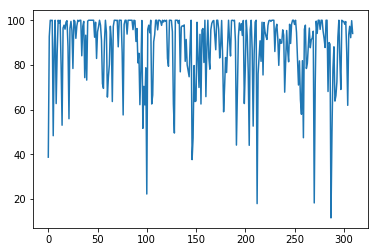

Time elapsed:7673.170778989792
| Reward: 99 | Episode: 310 


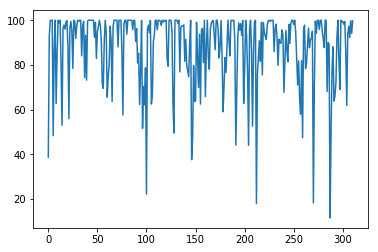

Time elapsed:7698.77060341835
| Reward: 100 | Episode: 311 


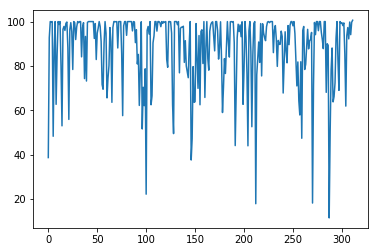

Time elapsed:7724.407731771469
| Reward: 99 | Episode: 312 


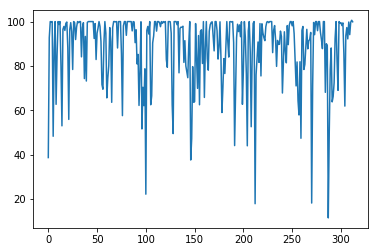

Time elapsed:7750.179684638977
| Reward: 79 | Episode: 313 


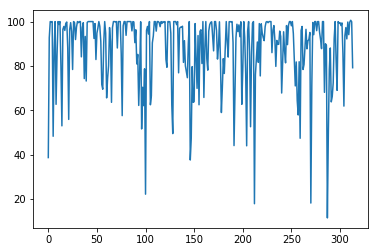

Time elapsed:7775.860237360001
| Reward: 99 | Episode: 314 


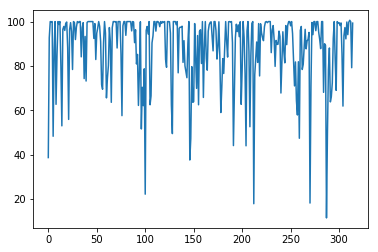

Time elapsed:7801.798201799393
| Reward: 96 | Episode: 315 


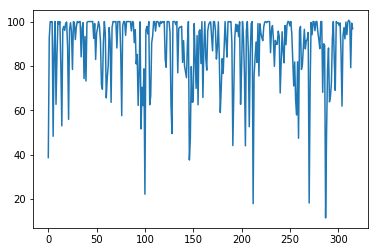

Time elapsed:7827.46600651741
| Reward: 116 | Episode: 316 


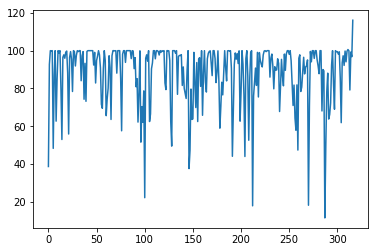

Time elapsed:7853.322359800339
| Reward: 99 | Episode: 317 


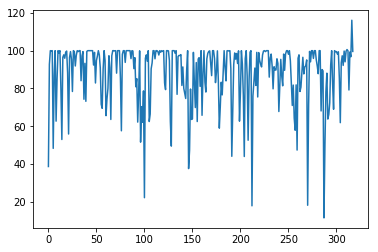

Time elapsed:7879.028438091278
| Reward: 89 | Episode: 318 


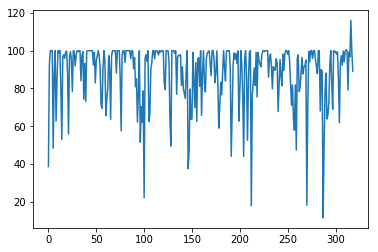

Time elapsed:7904.9504017829895
| Reward: 93 | Episode: 319 


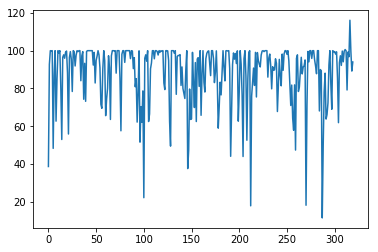

Time elapsed:7931.061074018478
| Reward: 99 | Episode: 320 


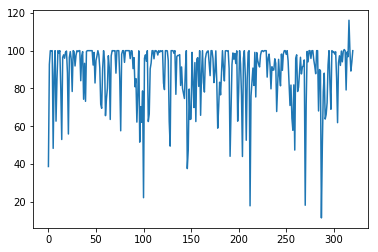

Time elapsed:7957.257935762405
| Reward: 91 | Episode: 321 


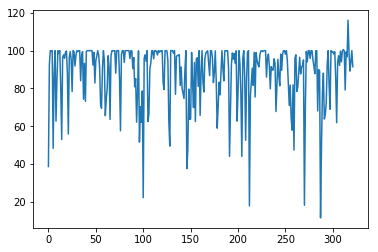

Time elapsed:7983.002933502197
| Reward: 93 | Episode: 322 


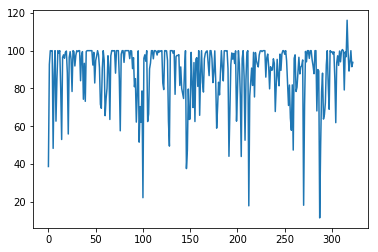

Time elapsed:8008.7367532253265
| Reward: 99 | Episode: 323 


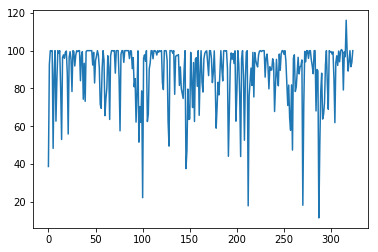

Time elapsed:8034.835540294647
| Reward: 99 | Episode: 324 


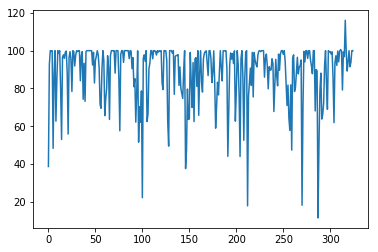

Time elapsed:8060.543531417847
| Reward: 94 | Episode: 325 


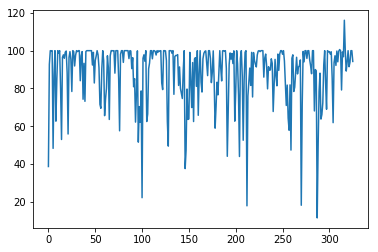

Time elapsed:8086.589898109436
| Reward: 90 | Episode: 326 


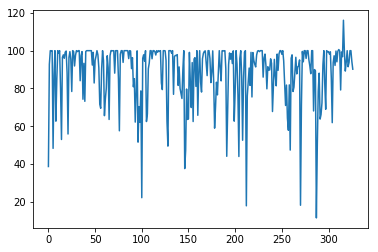

Time elapsed:8112.337605237961
| Reward: 67 | Episode: 327 


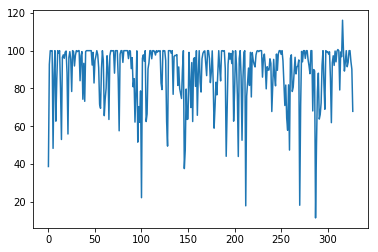

Time elapsed:8138.220363140106
| Reward: 79 | Episode: 328 


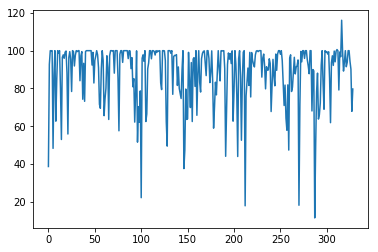

Time elapsed:8164.219995975494
| Reward: 80 | Episode: 329 


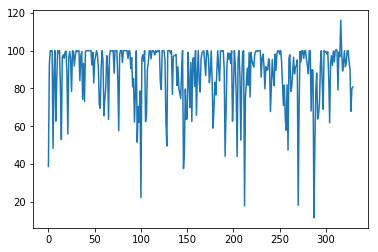

Time elapsed:8190.0942986011505
| Reward: 74 | Episode: 330 


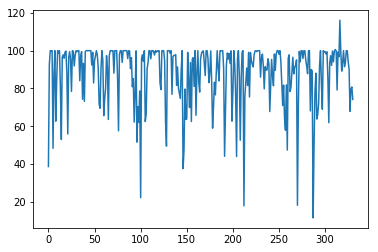

Time elapsed:8215.879632472992
| Reward: 99 | Episode: 331 


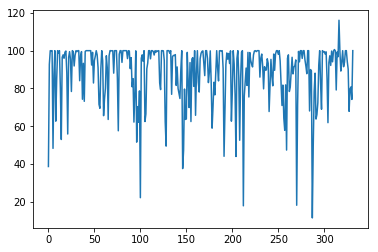

Time elapsed:8241.602818250656
| Reward: 99 | Episode: 332 


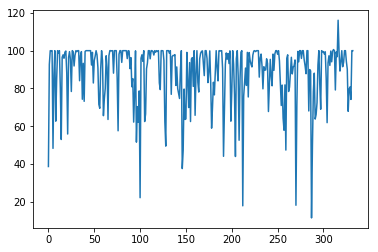

Time elapsed:8267.471524477005
| Reward: 77 | Episode: 333 


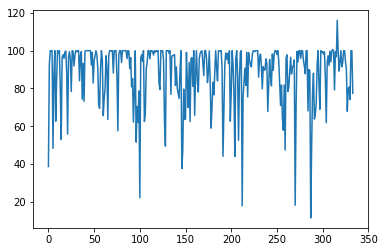

Time elapsed:8293.261328220367
| Reward: 66 | Episode: 334 


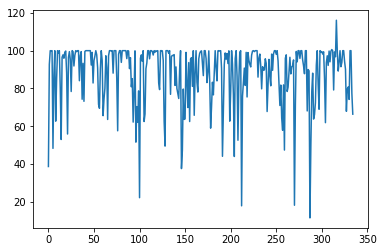

Time elapsed:8319.079549074173
| Reward: 73 | Episode: 335 


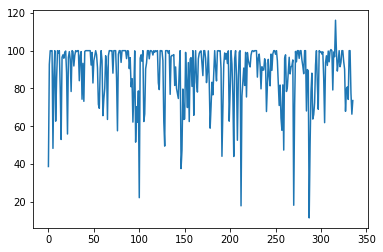

Time elapsed:8345.019874095917
| Reward: 86 | Episode: 336 


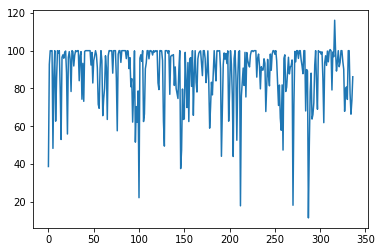

Time elapsed:8370.863903045654
| Reward: 99 | Episode: 337 


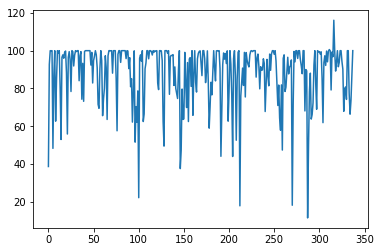

Time elapsed:8396.819278717041
| Reward: 97 | Episode: 338 


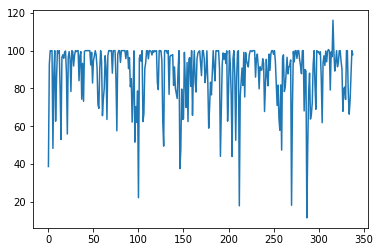

Time elapsed:8422.75037264824
| Reward: 98 | Episode: 339 


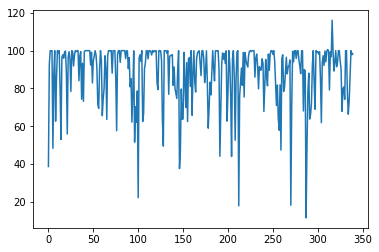

Time elapsed:8448.63202047348
| Reward: 86 | Episode: 340 


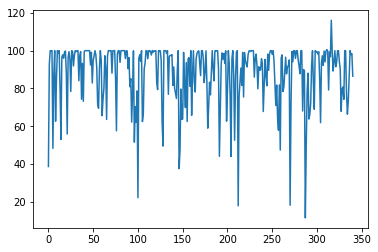

Time elapsed:8474.658360481262
| Reward: 84 | Episode: 341 


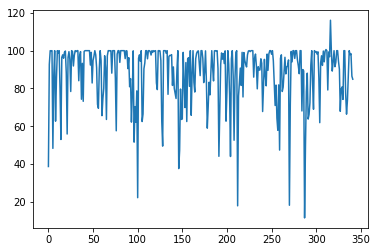

Time elapsed:8500.704826831818
| Reward: 89 | Episode: 342 


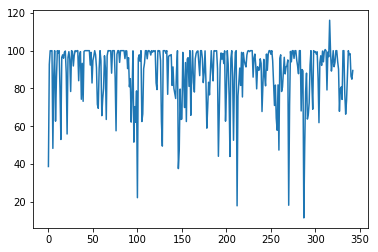

Time elapsed:8527.05298614502
| Reward: 92 | Episode: 343 


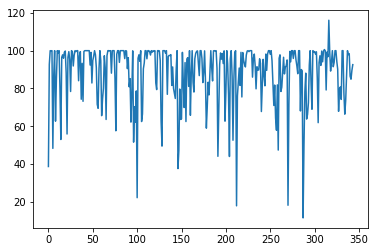

Time elapsed:8553.258714437485
| Reward: 97 | Episode: 344 


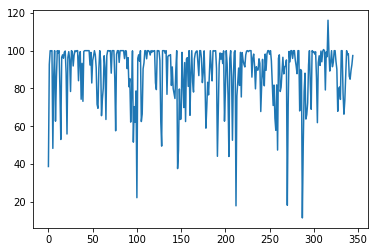

Time elapsed:8579.264067173004
| Reward: 96 | Episode: 345 


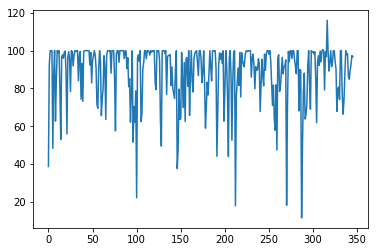

Time elapsed:8605.395986795425
| Reward: 93 | Episode: 346 


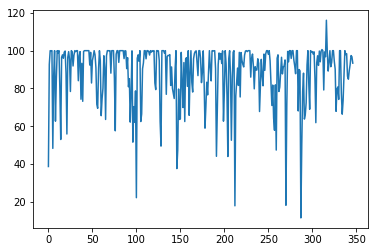

Time elapsed:8631.716114282608
| Reward: 61 | Episode: 347 


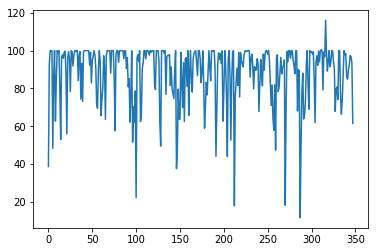

Time elapsed:8657.772614479065
| Reward: 99 | Episode: 348 


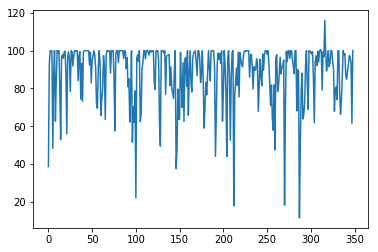

Time elapsed:8683.863624095917
| Reward: 67 | Episode: 349 


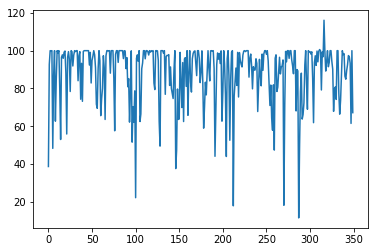

Time elapsed:8710.226383447647
| Reward: 99 | Episode: 350 


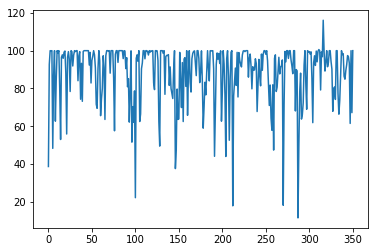

Time elapsed:8736.33206653595
| Reward: 89 | Episode: 351 


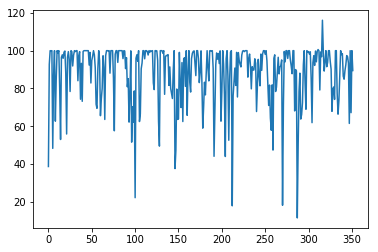

Time elapsed:8762.454206228256
| Reward: 94 | Episode: 352 


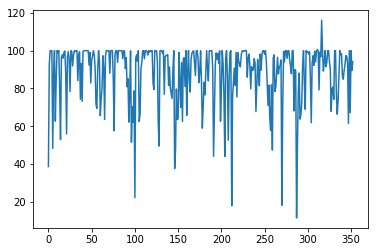

Time elapsed:8788.753346920013
| Reward: 56 | Episode: 353 


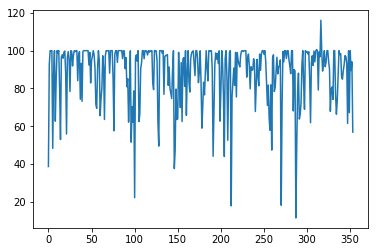

Time elapsed:8815.205119371414
| Reward: 99 | Episode: 354 


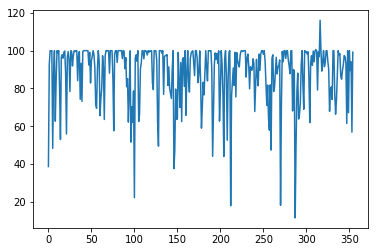

Time elapsed:8841.776166200638
| Reward: 94 | Episode: 355 


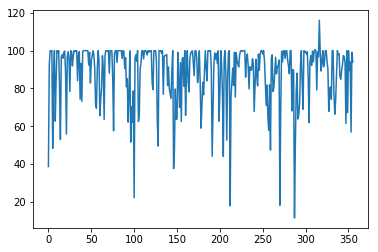

Time elapsed:8868.34402179718
| Reward: 99 | Episode: 356 


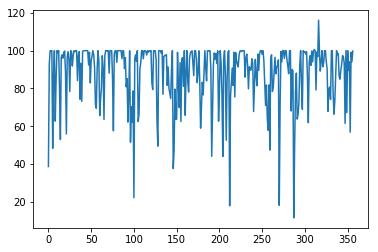

Time elapsed:8894.98020863533
| Reward: 97 | Episode: 357 


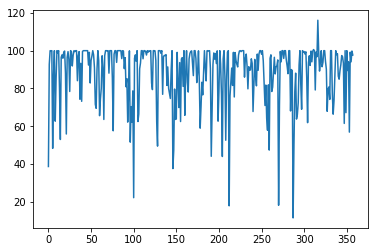

Time elapsed:8921.347479820251
| Reward: 75 | Episode: 358 


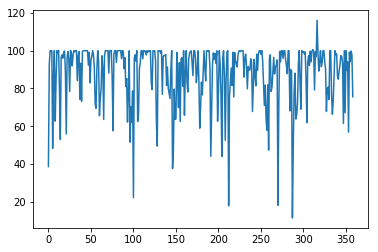

Time elapsed:8947.514687299728
| Reward: 59 | Episode: 359 


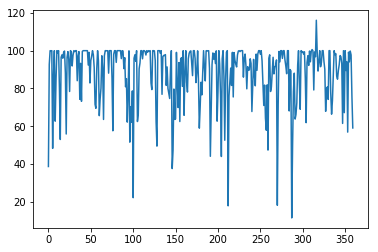

Time elapsed:8973.607151985168
| Reward: 99 | Episode: 360 


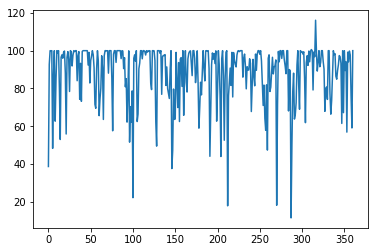

Time elapsed:9000.045456409454
| Reward: 99 | Episode: 361 


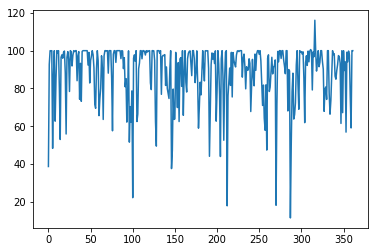

Time elapsed:9026.43482542038
| Reward: 99 | Episode: 362 


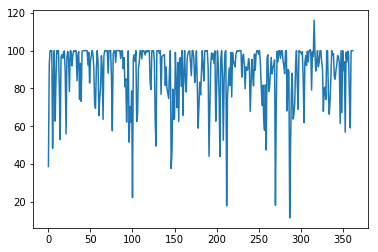

Time elapsed:9053.171552181244
| Reward: 95 | Episode: 363 


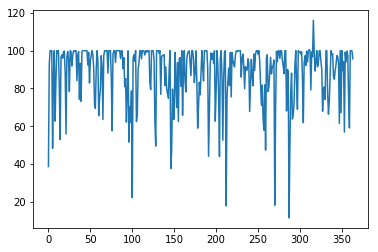

Time elapsed:9079.816288948059
| Reward: 86 | Episode: 364 


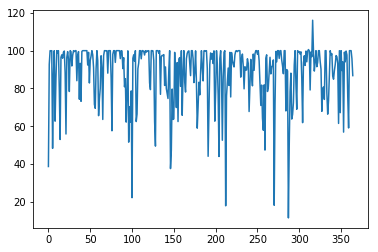

Time elapsed:9106.116010904312
| Reward: 99 | Episode: 365 


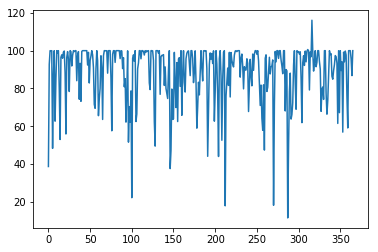

Time elapsed:9133.064747571945
| Reward: 99 | Episode: 366 


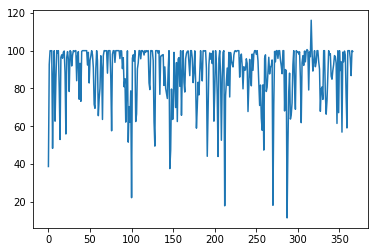

Time elapsed:9159.340861558914
| Reward: 78 | Episode: 367 


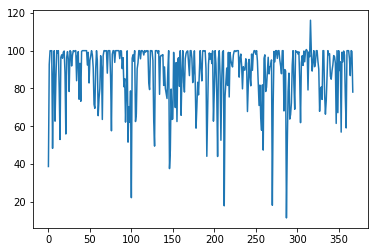

Time elapsed:9185.964064836502
| Reward: 73 | Episode: 368 


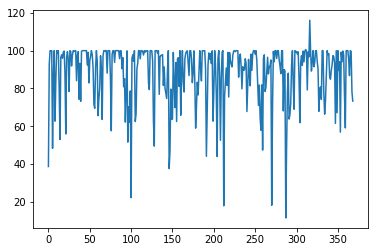

Time elapsed:9212.422770500183
| Reward: 97 | Episode: 369 


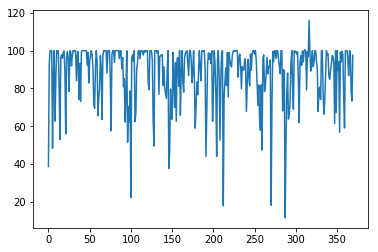

Time elapsed:9238.781198501587
| Reward: 97 | Episode: 370 


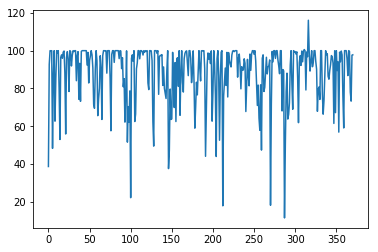

Time elapsed:9264.953381538391
| Reward: 99 | Episode: 371 


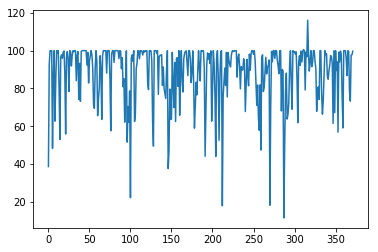

Time elapsed:9291.272170305252
| Reward: 99 | Episode: 372 


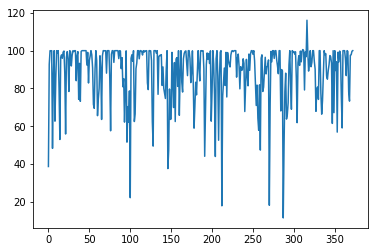

Time elapsed:9317.715822696686
| Reward: 99 | Episode: 373 


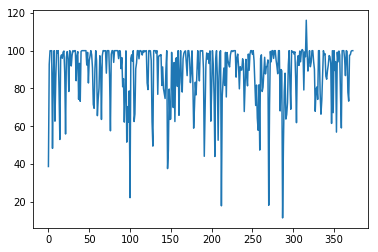

Time elapsed:9344.085072755814
| Reward: 99 | Episode: 374 


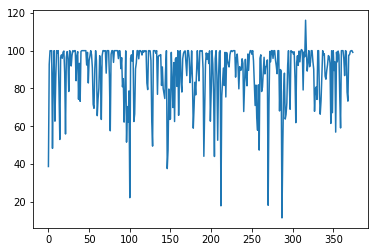

Time elapsed:9370.334255695343
| Reward: 82 | Episode: 375 


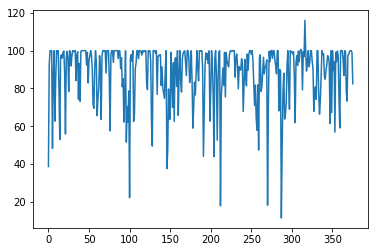

Time elapsed:9397.030674219131
| Reward: 85 | Episode: 376 


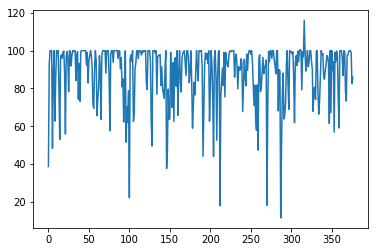

Time elapsed:9423.79422044754
| Reward: 99 | Episode: 377 


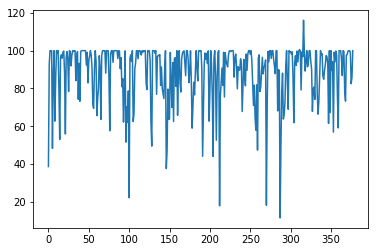

Time elapsed:9450.54378080368
| Reward: 99 | Episode: 378 


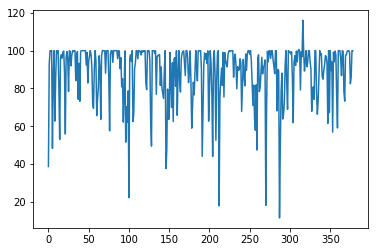

Time elapsed:9477.439722537994
| Reward: 99 | Episode: 379 


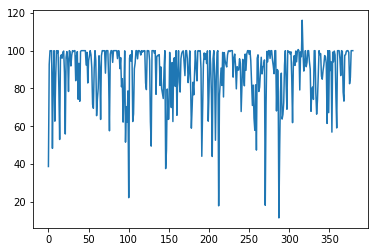

Time elapsed:9503.919956684113
| Reward: 80 | Episode: 380 


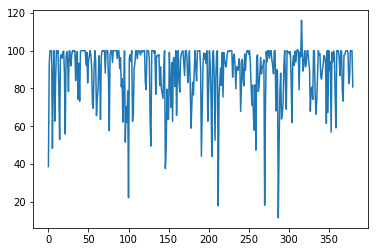

Time elapsed:9530.587760448456
| Reward: 99 | Episode: 381 


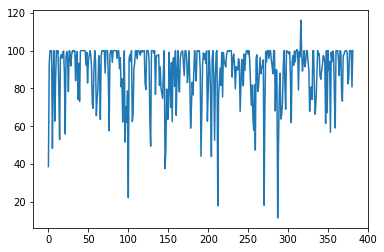

Time elapsed:9557.156198501587
| Reward: 98 | Episode: 382 


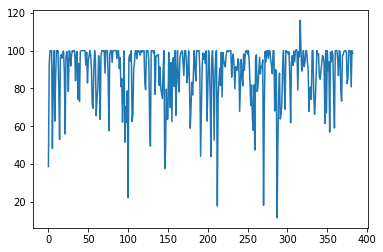

Time elapsed:9584.01346707344
| Reward: 96 | Episode: 383 


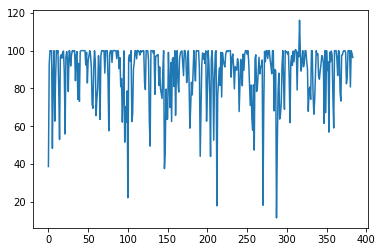

Time elapsed:9611.028777360916
| Reward: 87 | Episode: 384 


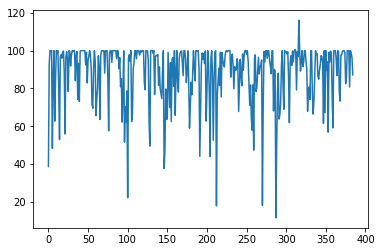

Time elapsed:9637.670700788498
| Reward: 28 | Episode: 385 


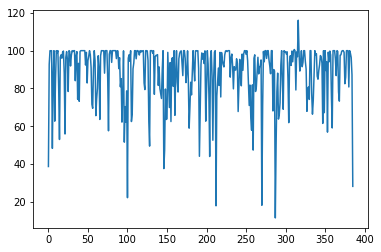

Time elapsed:9664.121249198914
| Reward: 86 | Episode: 386 


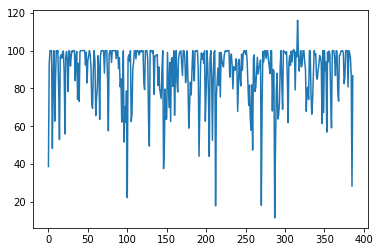

Time elapsed:9690.523297786713
| Reward: 79 | Episode: 387 


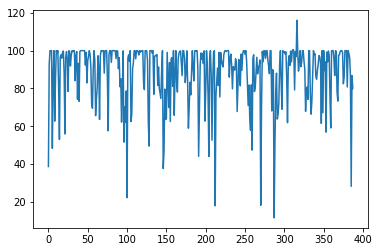

Time elapsed:9717.34590268135
| Reward: 79 | Episode: 388 


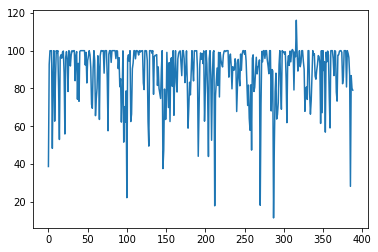

Time elapsed:9744.04073214531
| Reward: 74 | Episode: 389 


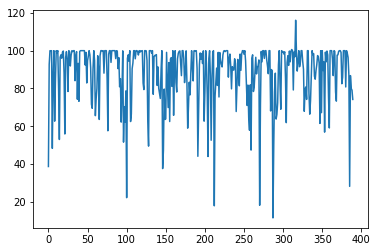

Time elapsed:9771.389037370682
| Reward: 86 | Episode: 390 


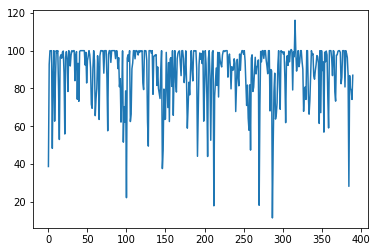

Time elapsed:9798.538821458817
| Reward: 79 | Episode: 391 


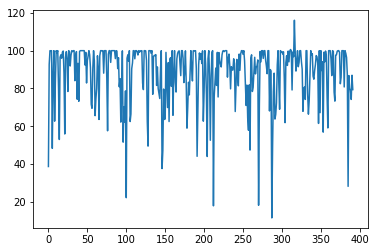

Time elapsed:9825.292798519135
| Reward: 91 | Episode: 392 


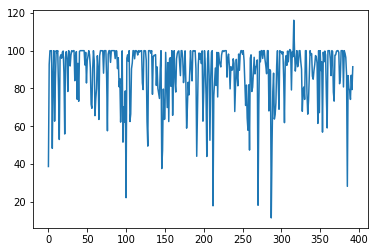

Time elapsed:9852.206682443619
| Reward: 53 | Episode: 393 


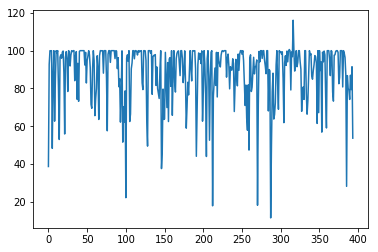

Time elapsed:9878.992187976837
| Reward: 62 | Episode: 394 


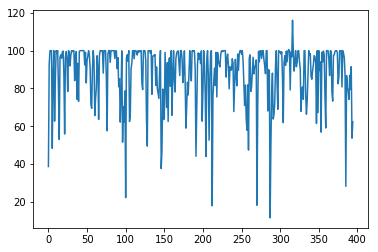

Time elapsed:9905.524143218994
| Reward: 81 | Episode: 395 


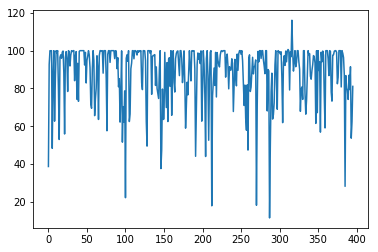

Time elapsed:9931.934293270111
| Reward: 84 | Episode: 396 


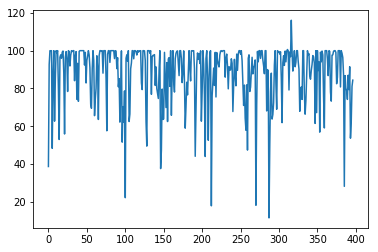

Time elapsed:9958.728586912155
| Reward: 99 | Episode: 397 


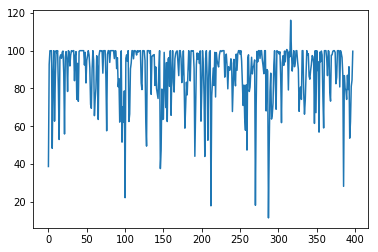

Time elapsed:9985.279078960419
| Reward: 97 | Episode: 398 


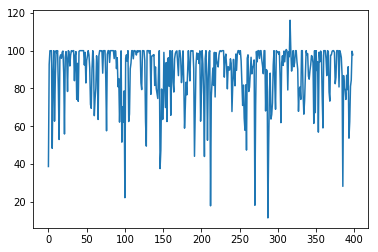

Time elapsed:10012.338720560074
| Reward: 91 | Episode: 399 


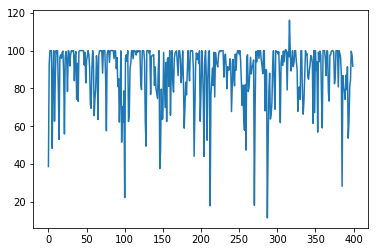

Time elapsed:10039.165045261383
| Reward: 99 | Episode: 400 


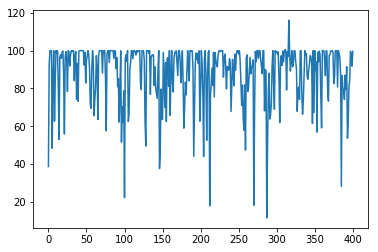

Time elapsed:10066.249343633652
| Reward: 83 | Episode: 401 


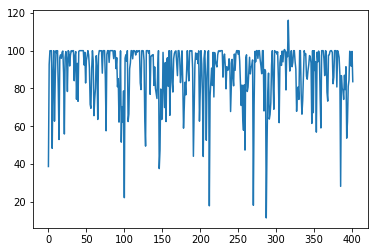

Time elapsed:10093.228322982788
| Reward: 98 | Episode: 402 


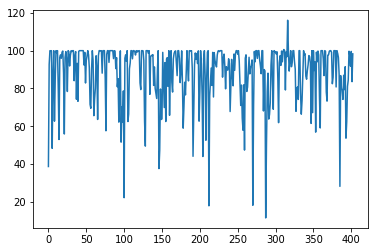

Time elapsed:10119.935913562775
| Reward: 97 | Episode: 403 


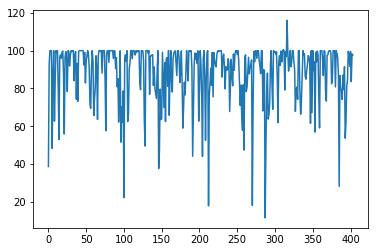

Time elapsed:10146.551887273788
| Reward: 99 | Episode: 404 


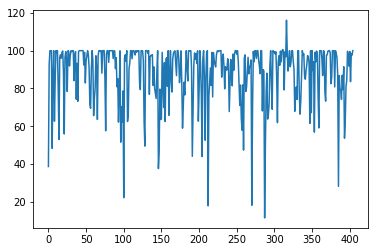

Time elapsed:10173.199315786362
| Reward: 99 | Episode: 405 


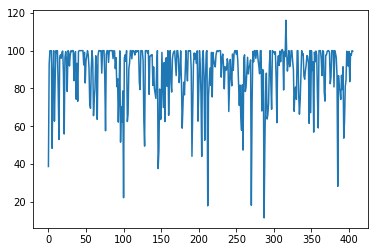

Time elapsed:10199.969186067581
| Reward: 42 | Episode: 406 


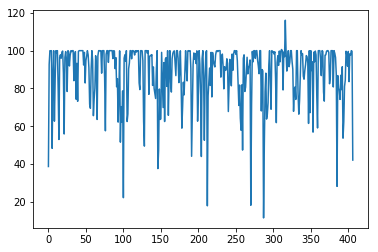

Time elapsed:10226.544452428818
| Reward: 65 | Episode: 407 


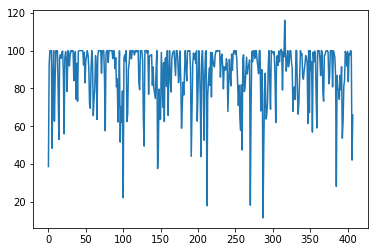

Time elapsed:10253.26085805893
| Reward: 82 | Episode: 408 


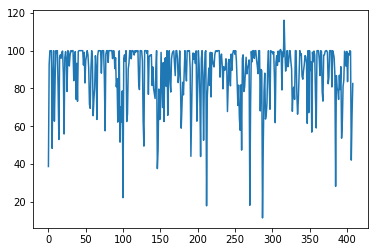

Time elapsed:10280.052311182022
| Reward: 68 | Episode: 409 


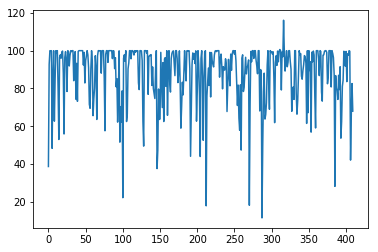

Time elapsed:10307.238785743713
| Reward: 97 | Episode: 410 


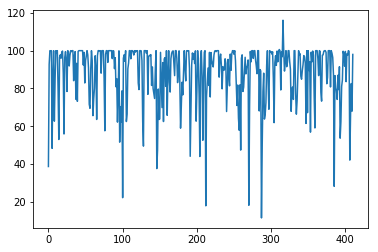

Time elapsed:10334.158735275269
| Reward: 99 | Episode: 411 


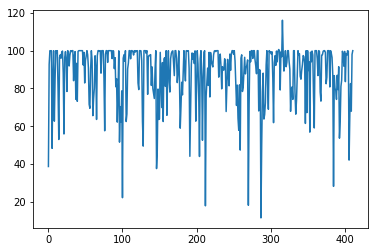

Time elapsed:10361.207133054733
| Reward: 99 | Episode: 412 


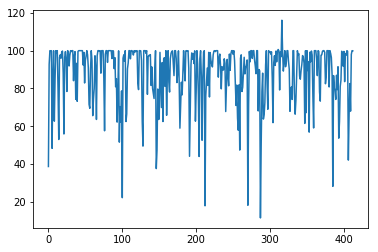

Time elapsed:10388.094422101974
| Reward: 98 | Episode: 413 


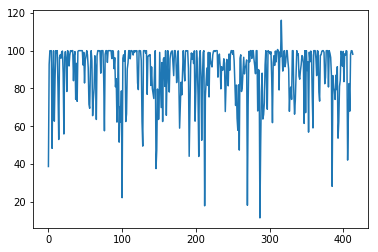

Time elapsed:10414.85673046112
| Reward: 99 | Episode: 414 


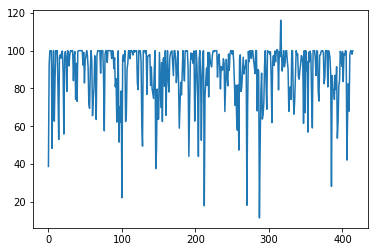

Time elapsed:10441.804914474487
| Reward: 99 | Episode: 415 


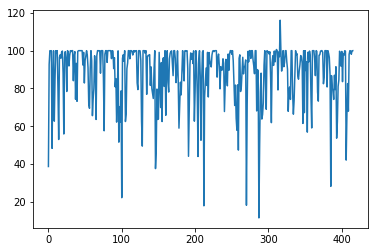

Time elapsed:10468.474817991257
| Reward: 99 | Episode: 416 


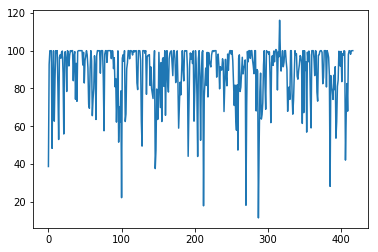

Time elapsed:10495.392369747162
| Reward: 99 | Episode: 417 


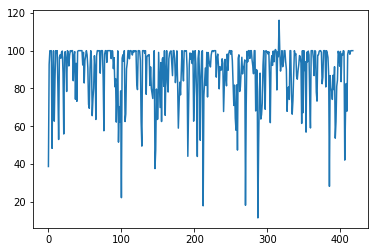

Time elapsed:10522.188952445984
| Reward: 94 | Episode: 418 


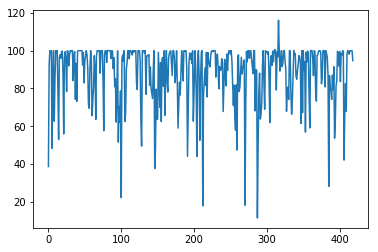

Time elapsed:10549.018751859665
| Reward: 99 | Episode: 419 


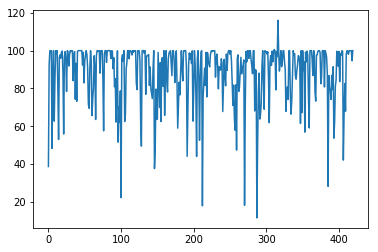

Time elapsed:10575.856964349747
| Reward: 98 | Episode: 420 


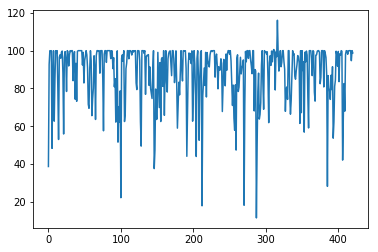

Time elapsed:10603.118159532547
| Reward: 99 | Episode: 421 


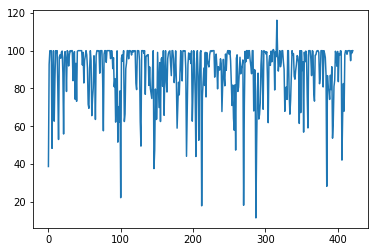

Time elapsed:10630.02933382988
| Reward: 89 | Episode: 422 


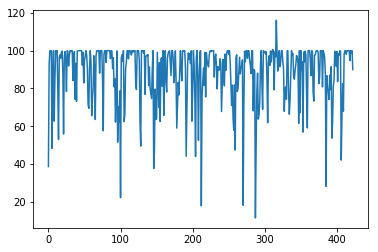

Time elapsed:10656.889186382294
| Reward: 99 | Episode: 423 


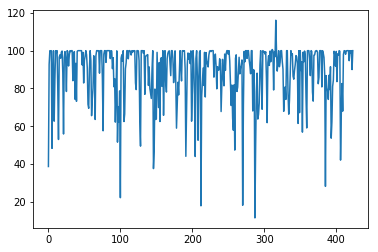

Time elapsed:10683.973523378372
| Reward: 98 | Episode: 424 


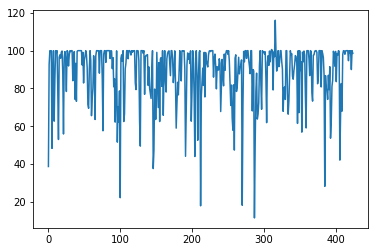

Time elapsed:10710.904453754425
| Reward: 65 | Episode: 425 


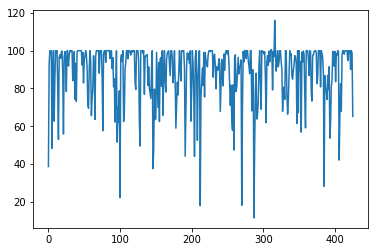

Time elapsed:10737.636205911636
| Reward: 93 | Episode: 426 


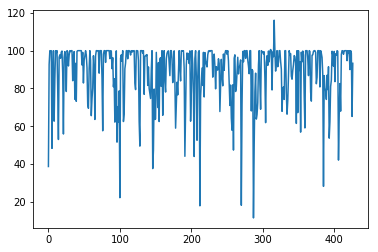

Time elapsed:10764.390335083008
| Reward: 92 | Episode: 427 


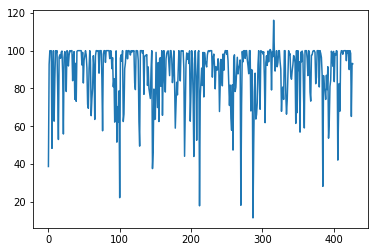

Time elapsed:10791.285163879395
| Reward: 92 | Episode: 428 


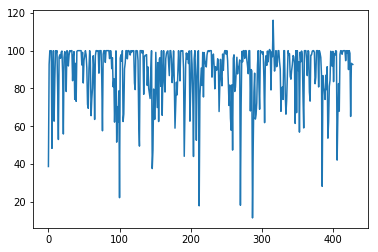

Time elapsed:10818.024631500244
| Reward: 86 | Episode: 429 


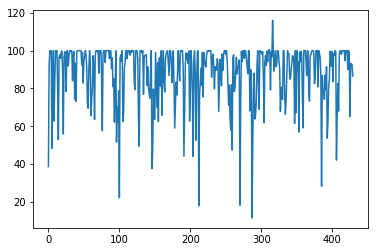

Time elapsed:10844.648334741592
| Reward: 97 | Episode: 430 


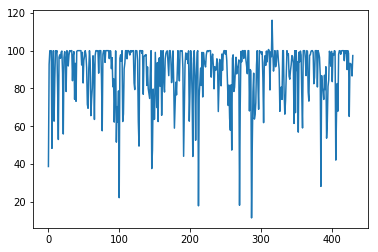

Time elapsed:10871.3047747612
| Reward: 92 | Episode: 431 


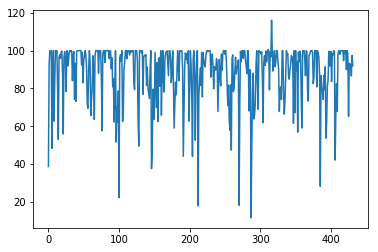

Time elapsed:10898.00645685196
| Reward: 86 | Episode: 432 


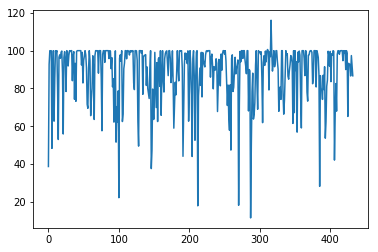

Time elapsed:10924.753079414368
| Reward: 85 | Episode: 433 


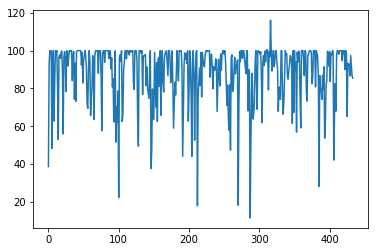

Time elapsed:10951.38701748848
| Reward: 94 | Episode: 434 


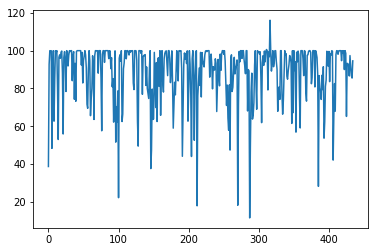

Time elapsed:10978.06792974472
| Reward: 97 | Episode: 435 


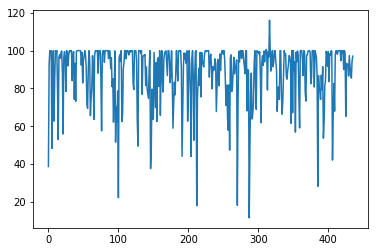

Time elapsed:11004.720210552216
| Reward: 91 | Episode: 436 


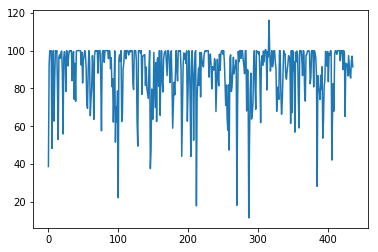

Time elapsed:11031.357070684433
| Reward: 87 | Episode: 437 


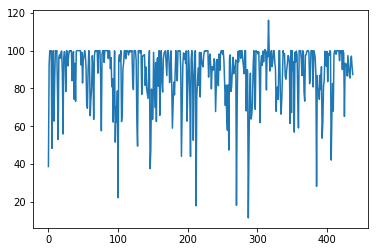

Time elapsed:11058.47644686699
| Reward: 99 | Episode: 438 


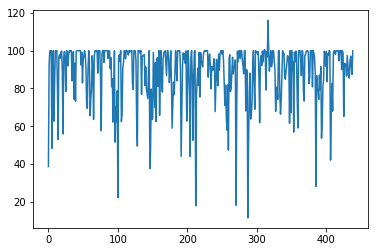

Time elapsed:11085.093962669373
| Reward: 97 | Episode: 439 


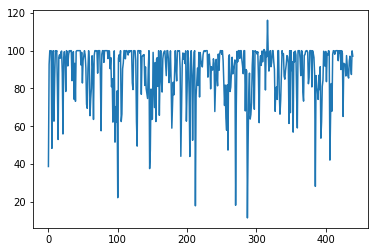

Time elapsed:11111.858526706696
| Reward: 99 | Episode: 440 


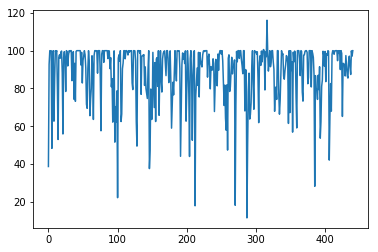

Time elapsed:11138.466816425323
| Reward: 81 | Episode: 441 


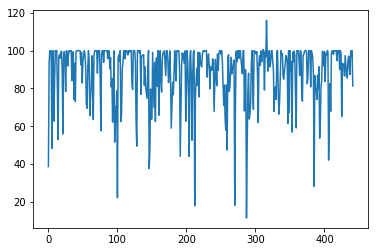

Time elapsed:11165.33818078041
| Reward: 99 | Episode: 442 


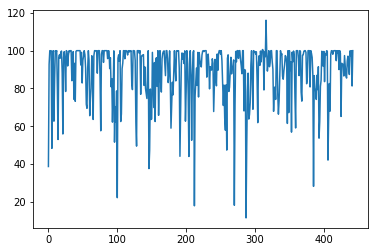

Time elapsed:11192.275694847107
| Reward: 13 | Episode: 443 


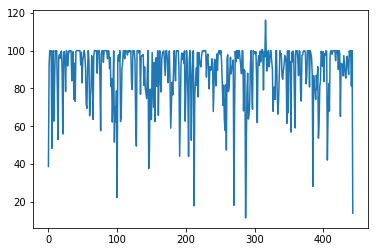

Time elapsed:11218.934005498886
| Reward: 94 | Episode: 444 


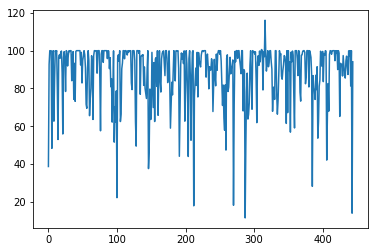

Time elapsed:11245.744688749313
| Reward: 96 | Episode: 445 


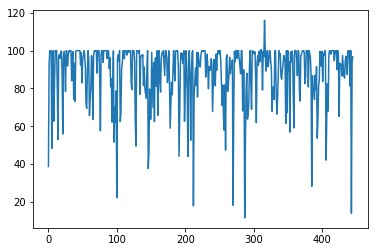

Time elapsed:11272.584243535995
| Reward: 95 | Episode: 446 


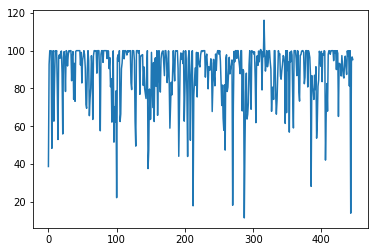

Time elapsed:11299.393716573715
| Reward: 96 | Episode: 447 


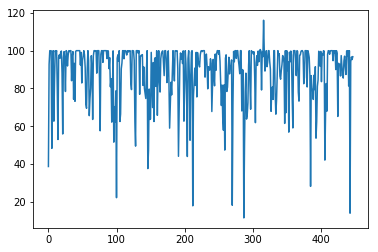

Time elapsed:11326.488919496536
| Reward: 100 | Episode: 448 


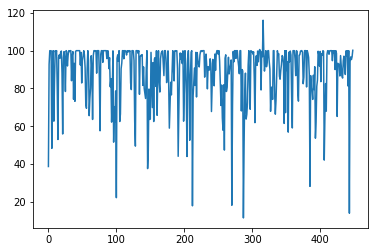

Time elapsed:11353.450425386429
| Reward: 96 | Episode: 449 


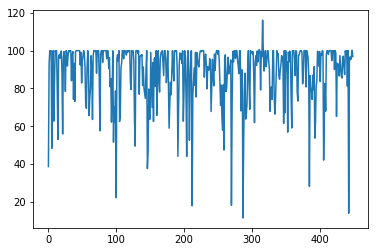

Time elapsed:11380.429156780243
| Reward: 100 | Episode: 450 


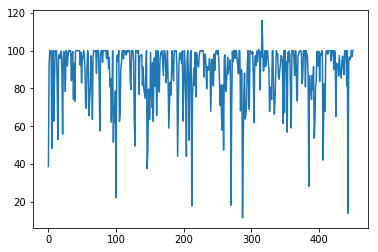

Time elapsed:11407.342903137207
| Reward: 83 | Episode: 451 


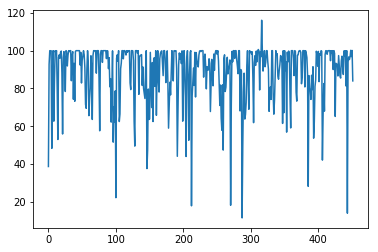

Time elapsed:11434.251532793045
| Reward: 90 | Episode: 452 


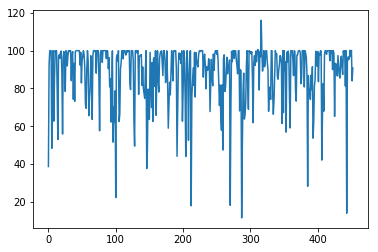

Time elapsed:11461.223700284958
| Reward: 99 | Episode: 453 


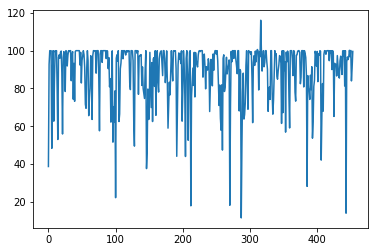

Time elapsed:11488.149625062943
| Reward: 99 | Episode: 454 


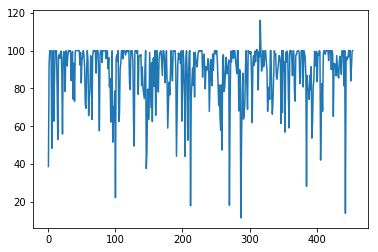

Time elapsed:11515.34848332405
| Reward: 99 | Episode: 455 


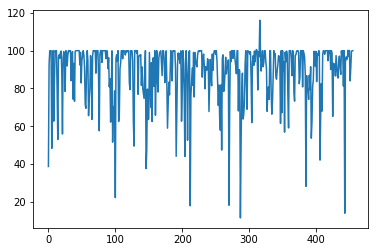

Time elapsed:11542.392768621445
| Reward: 99 | Episode: 456 


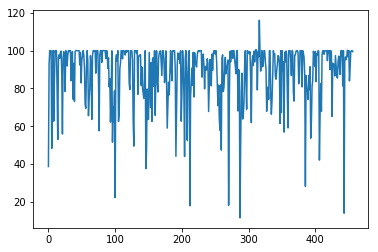

Time elapsed:11569.437663078308
| Reward: 71 | Episode: 457 


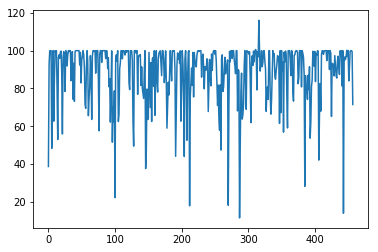

Time elapsed:11596.522435426712
| Reward: 79 | Episode: 458 


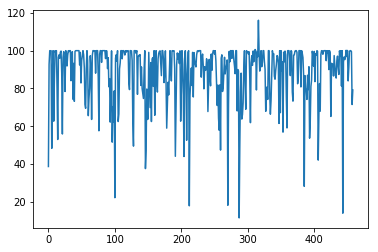

Time elapsed:11623.559210062027
| Reward: 99 | Episode: 459 


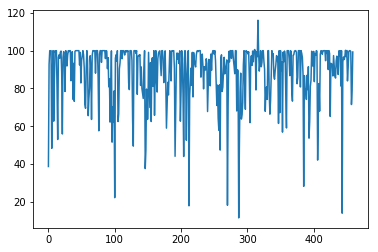

Time elapsed:11650.531234741211
| Reward: 99 | Episode: 460 


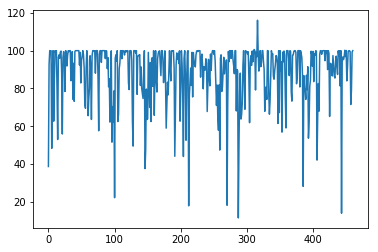

Time elapsed:11677.510577917099
| Reward: 99 | Episode: 461 


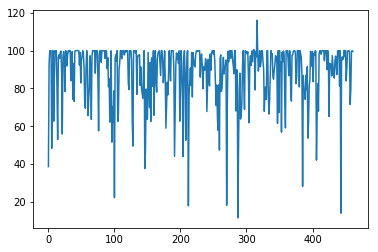

Time elapsed:11704.329988002777
| Reward: 71 | Episode: 462 


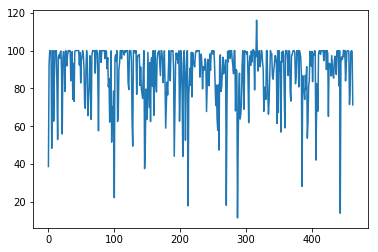

Time elapsed:11731.308945417404
| Reward: 79 | Episode: 463 


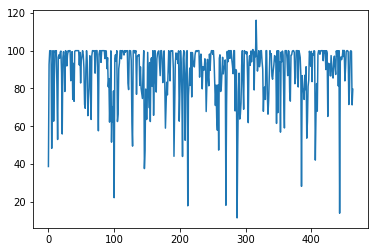

Time elapsed:11758.478703022003
| Reward: 99 | Episode: 464 


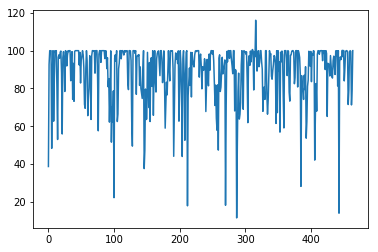

Time elapsed:11785.670016288757
| Reward: 99 | Episode: 465 


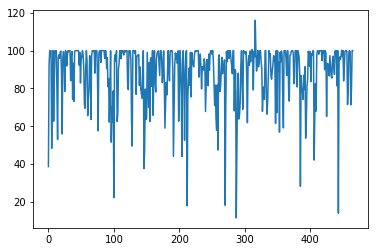

Time elapsed:11812.813856601715
| Reward: 98 | Episode: 466 


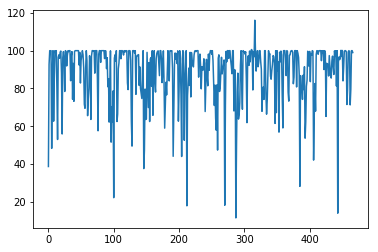

Time elapsed:11839.652976036072
| Reward: 99 | Episode: 467 


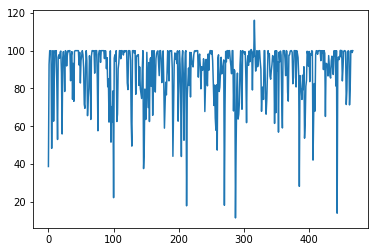

Time elapsed:11866.91280412674
| Reward: 98 | Episode: 468 


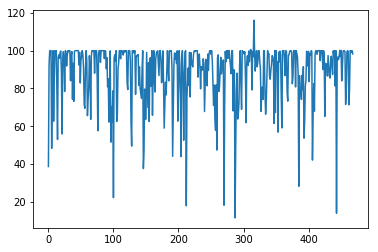

Time elapsed:11894.74494934082
| Reward: 99 | Episode: 469 


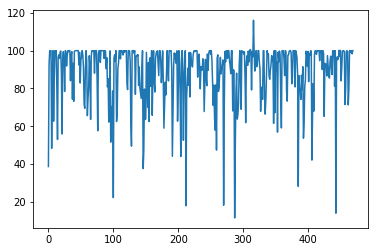

Time elapsed:11921.69488120079
| Reward: 99 | Episode: 470 


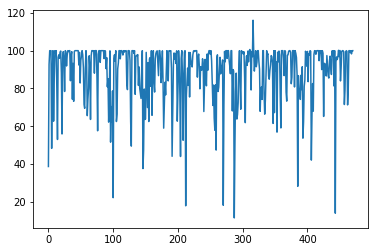

Time elapsed:11948.804398059845
| Reward: 99 | Episode: 471 


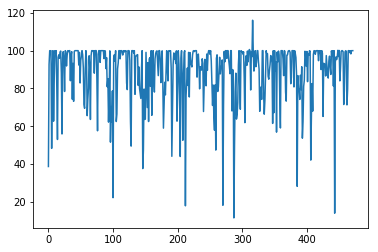

Time elapsed:11975.988847494125
| Reward: 99 | Episode: 472 


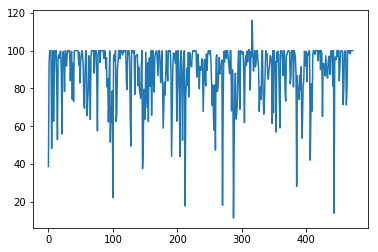

Time elapsed:12003.457914352417
| Reward: 92 | Episode: 473 


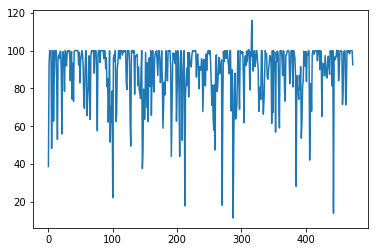

Time elapsed:12030.768530607224
| Reward: 100 | Episode: 474 


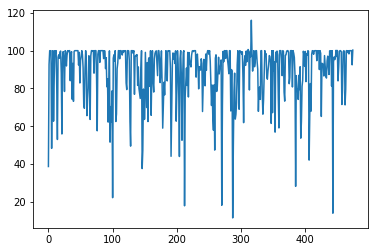

Time elapsed:12057.999933958054
| Reward: 99 | Episode: 475 


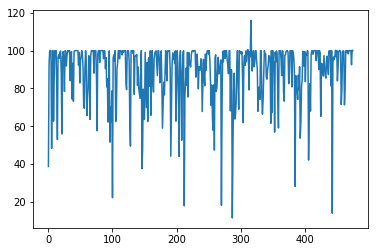

Time elapsed:12085.44883108139
| Reward: 99 | Episode: 476 


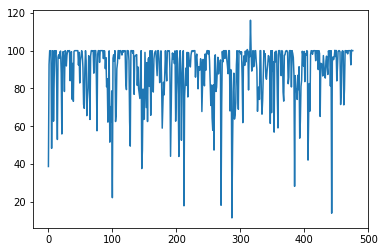

Time elapsed:12112.774843215942
| Reward: 99 | Episode: 477 


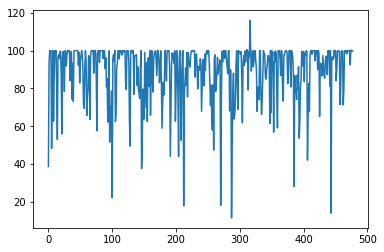

Time elapsed:12139.876304626465
| Reward: 87 | Episode: 478 


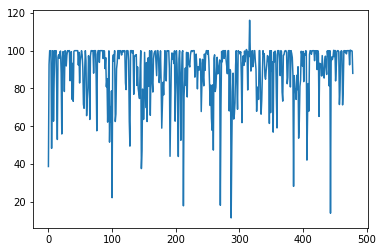

Time elapsed:12166.901205062866
| Reward: 99 | Episode: 479 


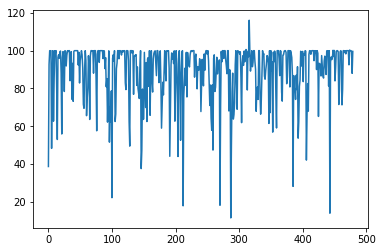

Time elapsed:12193.949079036713
| Reward: 83 | Episode: 480 


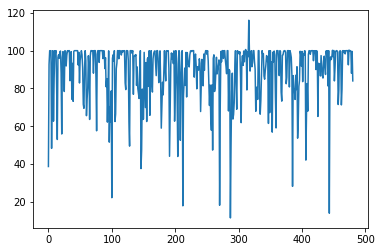

Time elapsed:12221.184232711792
| Reward: 78 | Episode: 481 


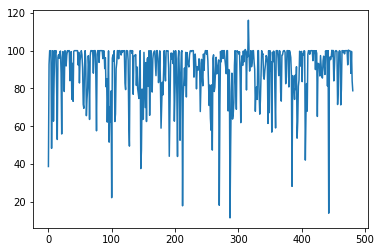

Time elapsed:12248.743513345718
| Reward: 99 | Episode: 482 


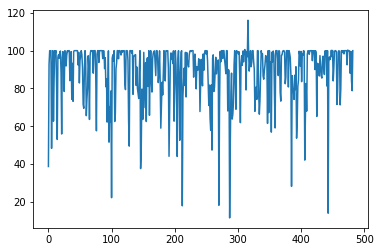

Time elapsed:12275.897369146347
| Reward: 93 | Episode: 483 


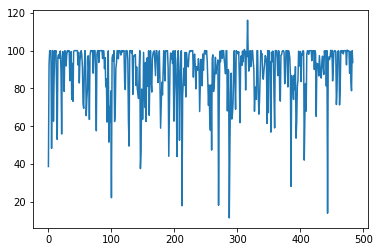

Time elapsed:12303.235785961151
| Reward: 56 | Episode: 484 


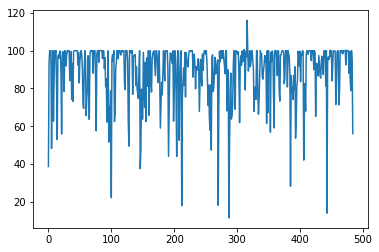

Time elapsed:12330.486383914948
| Reward: 74 | Episode: 485 


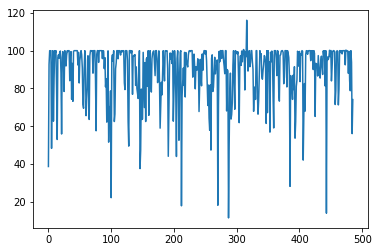

Time elapsed:12358.092131853104
| Reward: 99 | Episode: 486 


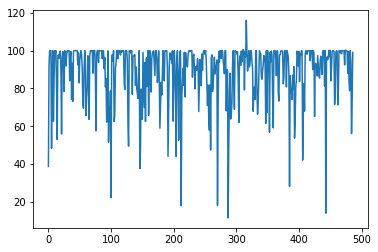

Time elapsed:12385.202263832092
| Reward: 100 | Episode: 487 


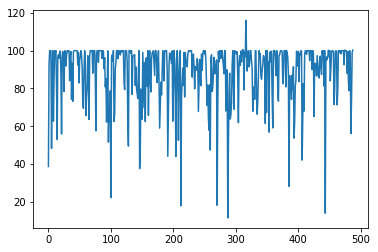

Time elapsed:12412.405721664429
| Reward: 97 | Episode: 488 


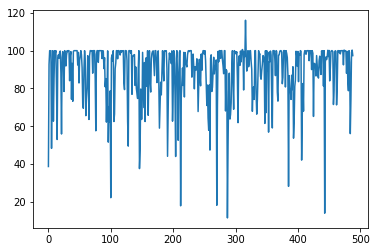

Time elapsed:12439.740747451782
| Reward: 99 | Episode: 489 


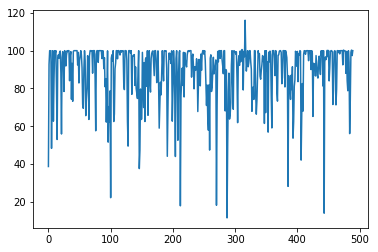

Time elapsed:12467.14784693718
| Reward: 100 | Episode: 490 


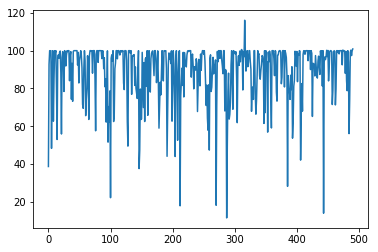

Time elapsed:12494.624887943268
| Reward: 84 | Episode: 491 


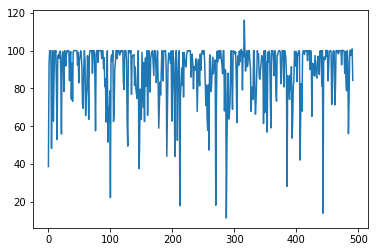

Time elapsed:12521.836244344711
| Reward: 70 | Episode: 492 


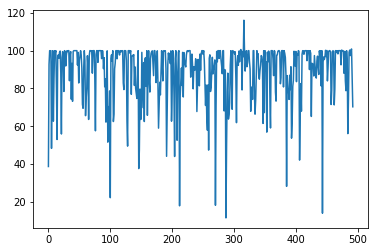

Time elapsed:12549.239398479462
| Reward: 82 | Episode: 493 


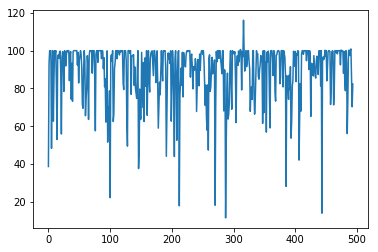

Time elapsed:12576.484015703201
| Reward: 73 | Episode: 494 


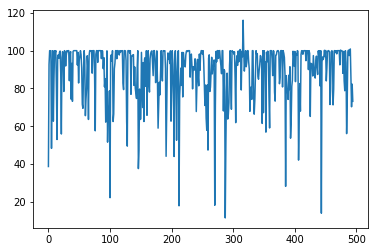

Time elapsed:12603.94044971466
| Reward: 99 | Episode: 495 


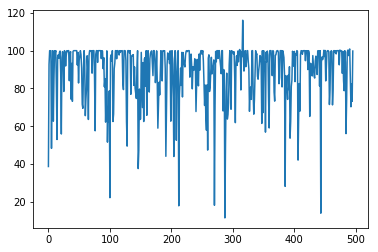

Time elapsed:12631.73862028122
| Reward: 99 | Episode: 496 


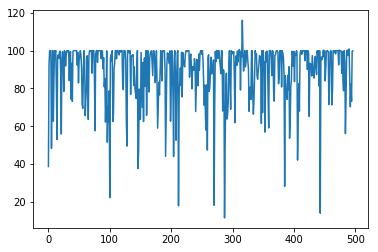

Time elapsed:12659.037825345993
| Reward: 99 | Episode: 497 


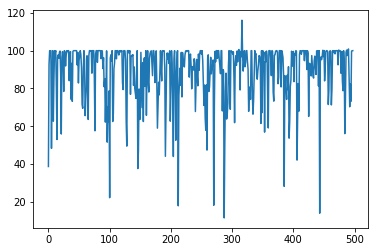

Time elapsed:12686.179263591766
| Reward: 97 | Episode: 498 


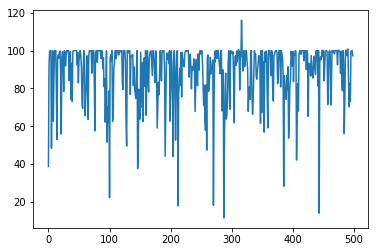

Time elapsed:12713.45729470253
| Reward: 99 | Episode: 499 


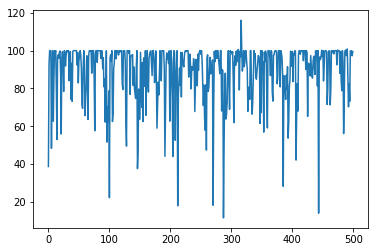

Time elapsed:12740.6543841362
| Reward: 90 | Episode: 500 


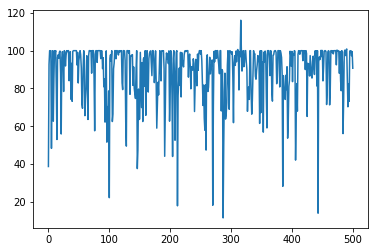

Time elapsed:12767.750286579132
| Reward: 97 | Episode: 501 


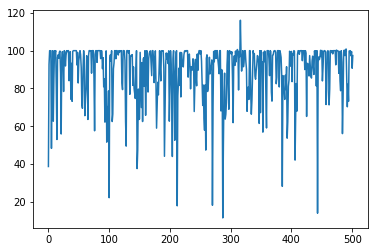

Time elapsed:12794.964592456818
| Reward: 100 | Episode: 502 


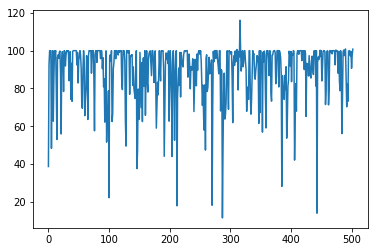

Time elapsed:12822.310616016388
| Reward: 97 | Episode: 503 


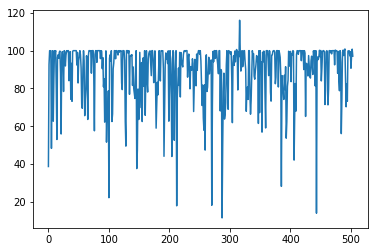

Time elapsed:12849.543448448181
| Reward: 99 | Episode: 504 


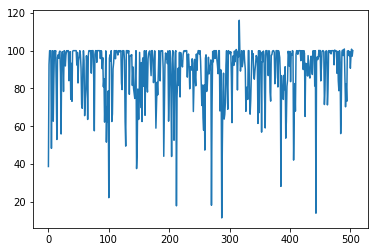

Time elapsed:12877.04971075058
| Reward: 99 | Episode: 505 


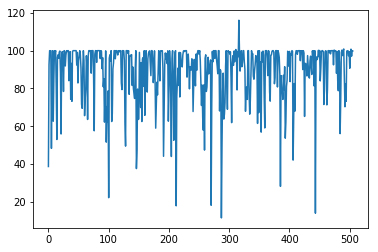

Time elapsed:12904.441889286041
| Reward: 99 | Episode: 506 


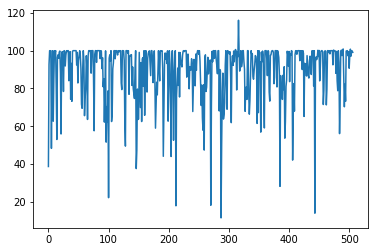

Time elapsed:12931.82645559311
| Reward: 99 | Episode: 507 


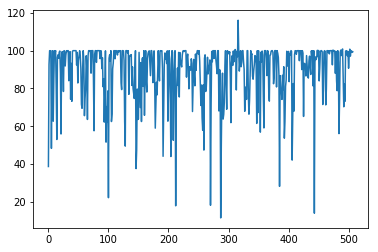

Time elapsed:12959.985611438751
| Reward: 90 | Episode: 508 


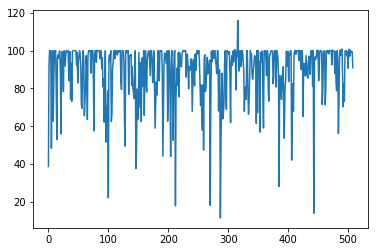

Time elapsed:12987.748004198074
| Reward: 98 | Episode: 509 


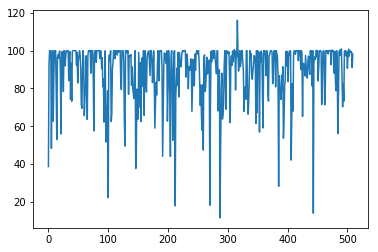

Time elapsed:13015.125722169876
| Reward: 76 | Episode: 510 


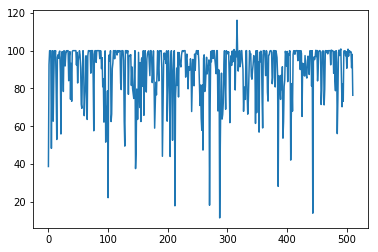

Time elapsed:13042.643948078156
| Reward: 84 | Episode: 511 


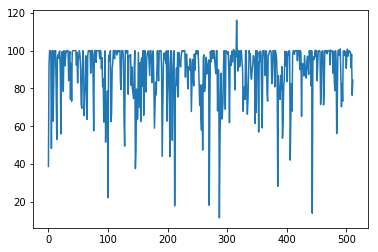

Time elapsed:13070.164198160172
| Reward: 102 | Episode: 512 


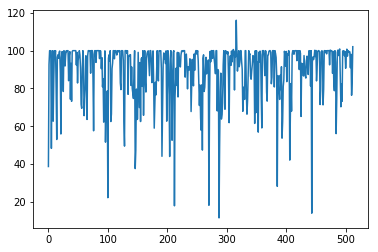

Time elapsed:13097.950205087662
| Reward: 94 | Episode: 513 


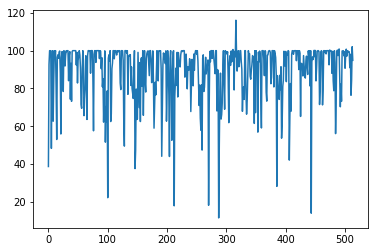

Time elapsed:13125.590525388718
| Reward: 99 | Episode: 514 


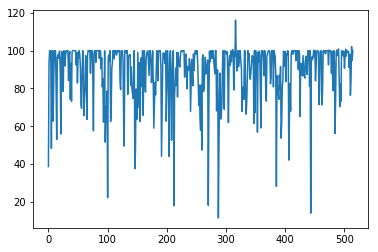

Time elapsed:13153.223064899445
| Reward: 99 | Episode: 515 


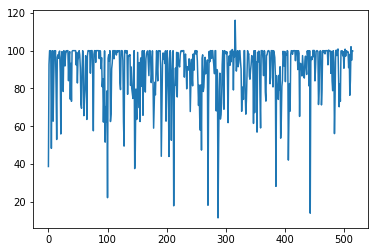

Time elapsed:13180.816064834595
| Reward: 99 | Episode: 516 


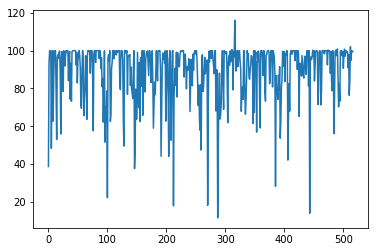

Time elapsed:13207.879665613174
| Reward: 96 | Episode: 517 


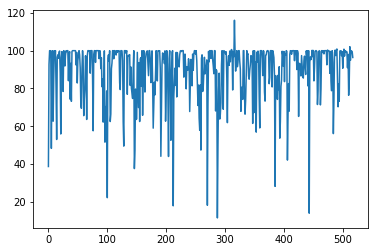

Time elapsed:13235.32879781723
| Reward: 99 | Episode: 518 


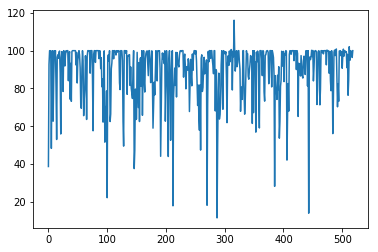

Time elapsed:13262.803256988525
| Reward: 97 | Episode: 519 


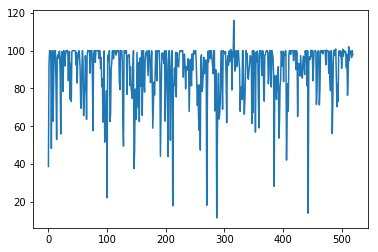

Time elapsed:13290.241708993912
| Reward: 99 | Episode: 520 


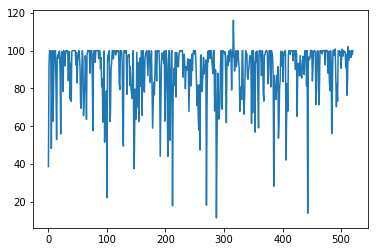

Time elapsed:13318.045565366745
| Reward: 98 | Episode: 521 


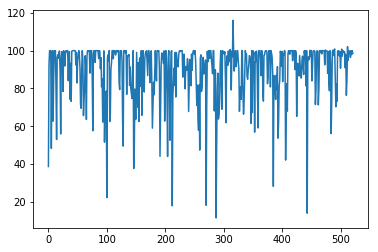

Time elapsed:13345.923617601395
| Reward: 99 | Episode: 522 


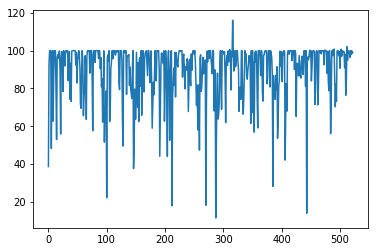

Time elapsed:13373.480578184128
| Reward: 95 | Episode: 523 


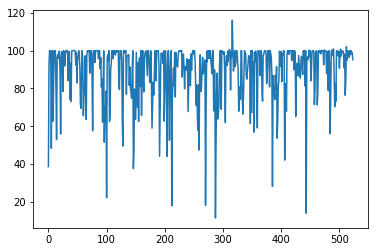

Time elapsed:13401.027352333069
| Reward: 85 | Episode: 524 


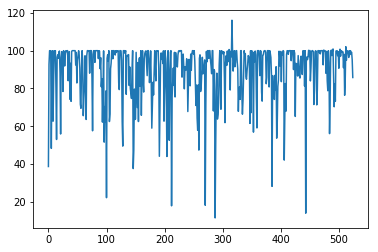

Time elapsed:13428.714740753174
| Reward: 44 | Episode: 525 


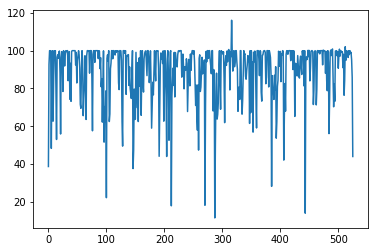

Time elapsed:13456.204572677612
| Reward: 94 | Episode: 526 


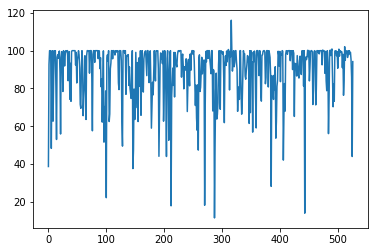

Time elapsed:13483.744976758957
| Reward: 71 | Episode: 527 


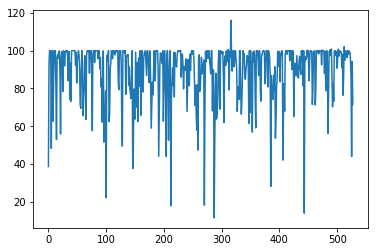

Time elapsed:13511.286590099335
| Reward: 99 | Episode: 528 


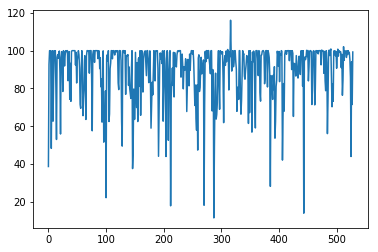

Time elapsed:13538.759013652802
| Reward: 96 | Episode: 529 


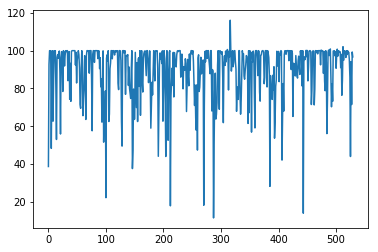

Time elapsed:13566.46716094017
| Reward: 98 | Episode: 530 


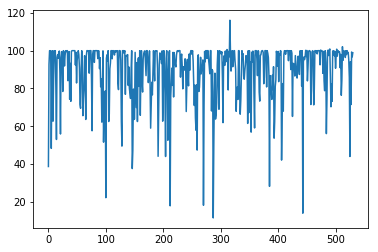

Time elapsed:13594.042711019516
| Reward: 101 | Episode: 531 


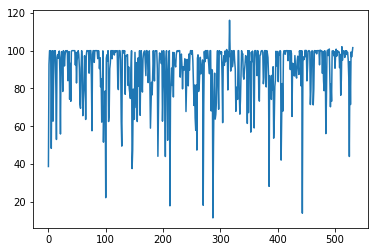

Time elapsed:13621.685234069824
| Reward: 94 | Episode: 532 


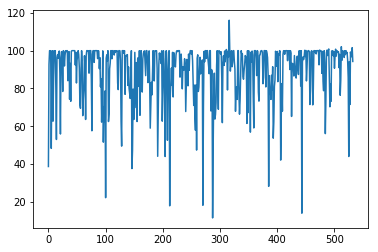

Time elapsed:13649.303656101227
| Reward: 99 | Episode: 533 


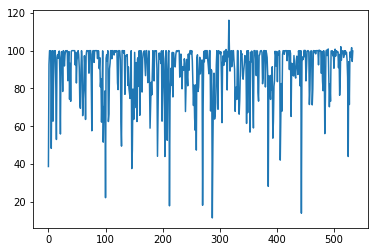

Time elapsed:13677.031084537506
| Reward: 96 | Episode: 534 


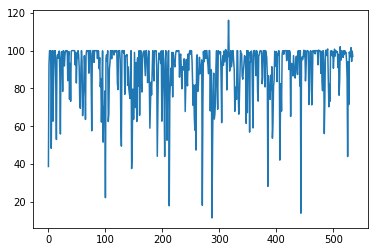

Time elapsed:13704.645987272263
| Reward: 99 | Episode: 535 


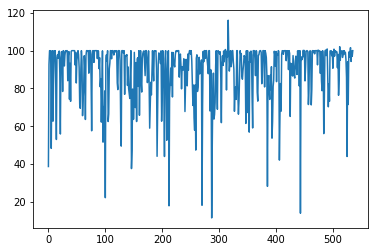

Time elapsed:13732.358003377914
| Reward: 91 | Episode: 536 


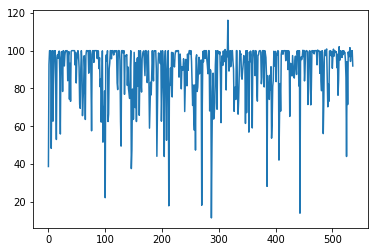

Time elapsed:13760.078968048096
| Reward: 99 | Episode: 537 


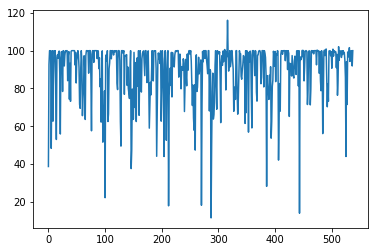

Time elapsed:13787.973723649979
| Reward: 99 | Episode: 538 


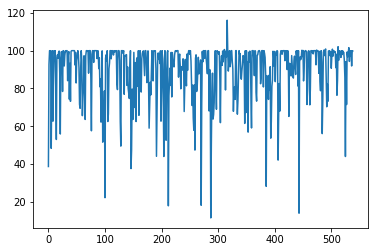

Time elapsed:13815.97772026062
| Reward: 95 | Episode: 539 


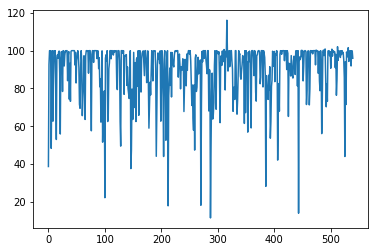

Time elapsed:13843.678568840027
| Reward: 99 | Episode: 540 


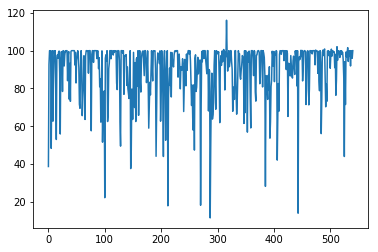

Time elapsed:13871.255967140198
| Reward: 99 | Episode: 541 


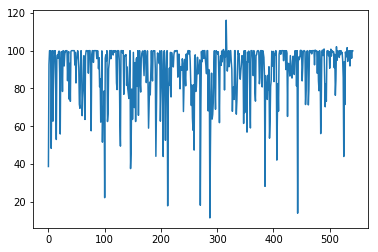

Time elapsed:13899.042546510696
| Reward: 95 | Episode: 542 


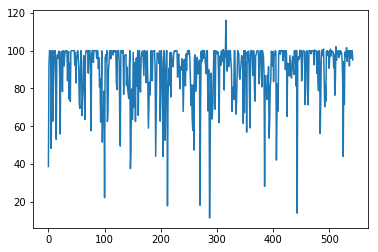

Time elapsed:13926.734305620193
| Reward: 99 | Episode: 543 


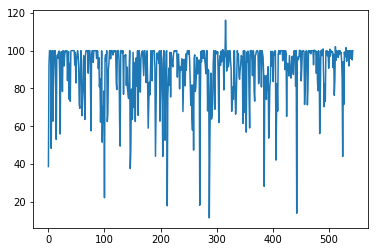

Time elapsed:13954.565305233002
| Reward: 99 | Episode: 544 


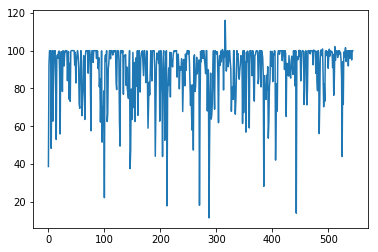

Time elapsed:13982.276860952377
| Reward: 99 | Episode: 545 


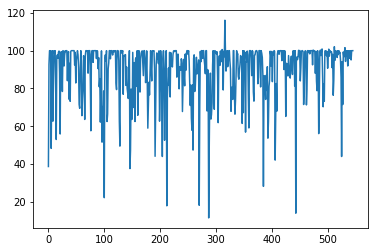

Time elapsed:14010.972773313522
| Reward: 99 | Episode: 546 


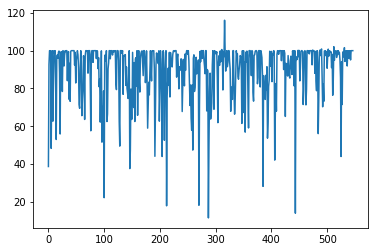

Time elapsed:14039.678814649582
| Reward: 99 | Episode: 547 


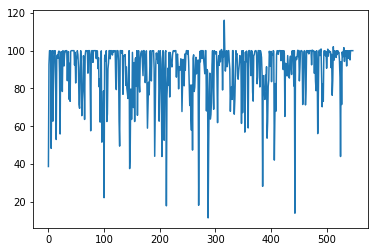

Time elapsed:14067.908245325089
| Reward: 99 | Episode: 548 


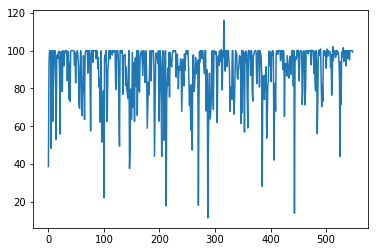

Time elapsed:14096.014155387878
| Reward: 94 | Episode: 549 


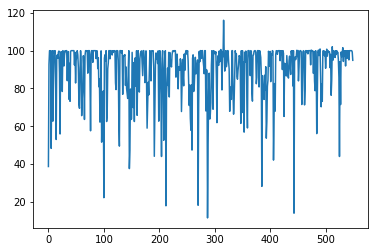

Time elapsed:14123.965577840805
| Reward: 83 | Episode: 550 


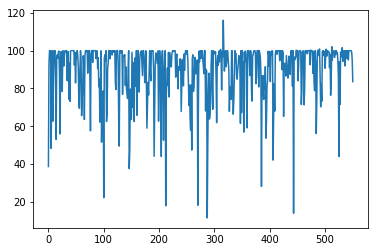

Time elapsed:14152.050131320953
| Reward: 94 | Episode: 551 


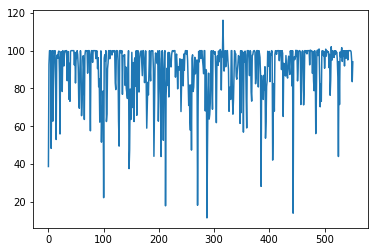

Time elapsed:14180.325155735016
| Reward: 99 | Episode: 552 


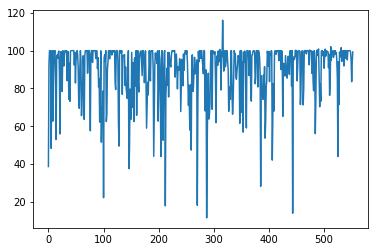

Time elapsed:14208.718777418137
| Reward: 96 | Episode: 553 


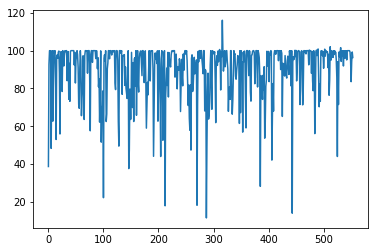

Time elapsed:14237.416935682297
| Reward: 99 | Episode: 554 


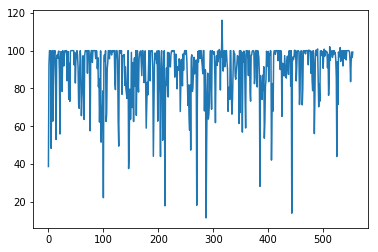

Time elapsed:14265.607135772705
| Reward: 94 | Episode: 555 


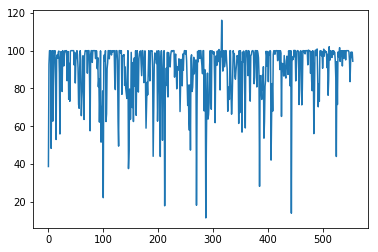

Time elapsed:14293.871609926224
| Reward: 99 | Episode: 556 


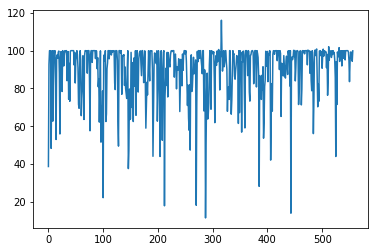

Time elapsed:14321.962834358215
| Reward: 91 | Episode: 557 


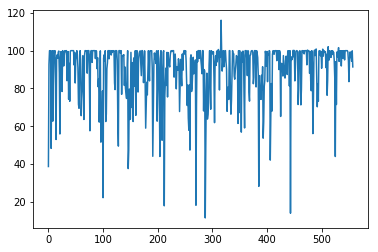

Time elapsed:14349.835036754608
| Reward: 85 | Episode: 558 


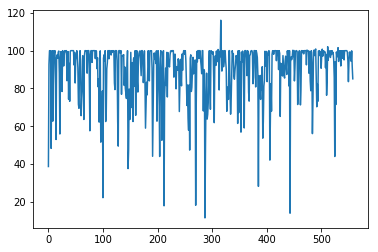

Time elapsed:14377.778511285782
| Reward: 75 | Episode: 559 


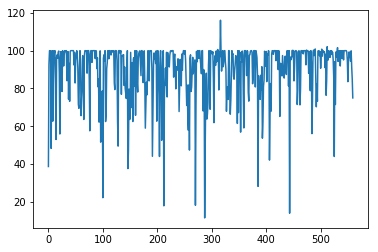

Time elapsed:14405.854040384293
| Reward: 87 | Episode: 560 


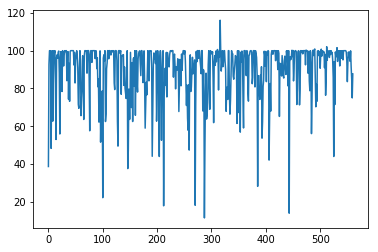

Time elapsed:14433.698220729828
| Reward: 94 | Episode: 561 


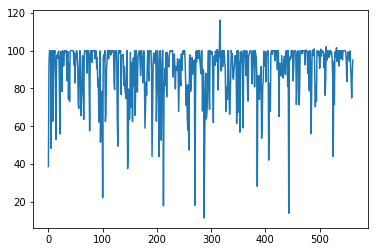

Time elapsed:14461.963643312454
| Reward: 93 | Episode: 562 


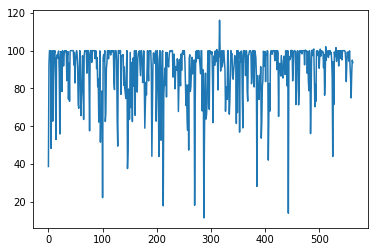

Time elapsed:14489.843499422073
| Reward: 61 | Episode: 563 


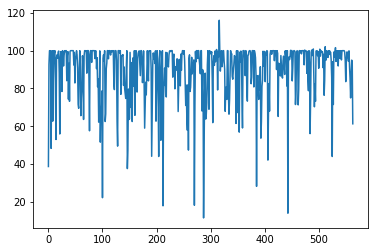

Time elapsed:14518.070684194565
| Reward: 68 | Episode: 564 


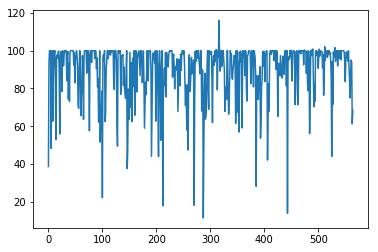

Time elapsed:14546.03574347496
| Reward: 79 | Episode: 565 


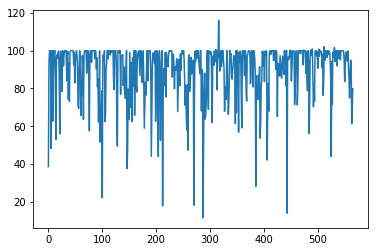

Time elapsed:14574.174203634262
| Reward: 82 | Episode: 566 


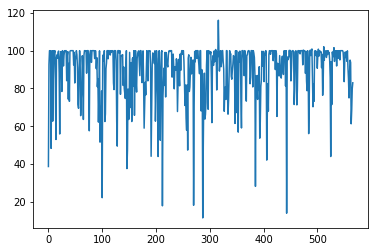

Time elapsed:14602.285145759583
| Reward: 87 | Episode: 567 


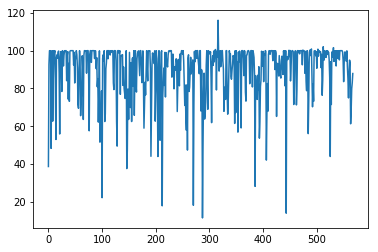

Time elapsed:14630.601909160614
| Reward: 96 | Episode: 568 


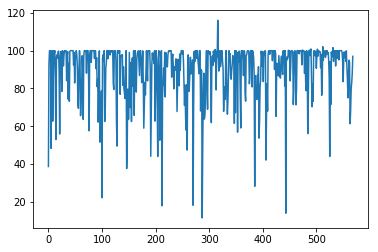

Time elapsed:14658.635645627975
| Reward: 79 | Episode: 569 


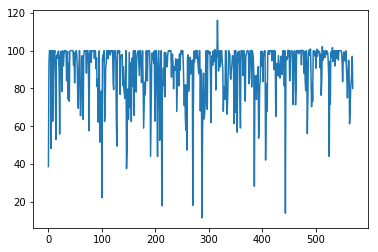

Time elapsed:14686.796328306198
| Reward: 96 | Episode: 570 


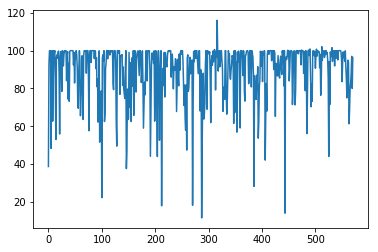

Time elapsed:14714.74321436882
| Reward: 99 | Episode: 571 


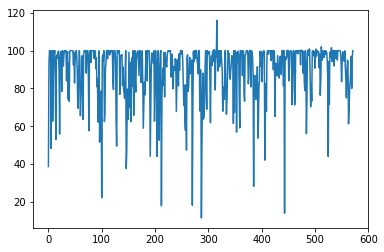

Time elapsed:14742.862598896027
| Reward: 95 | Episode: 572 


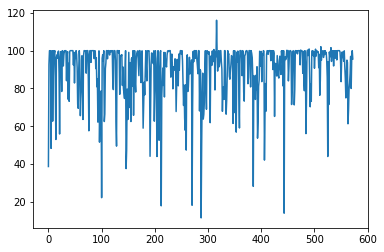

Time elapsed:14770.924102306366
| Reward: 93 | Episode: 573 


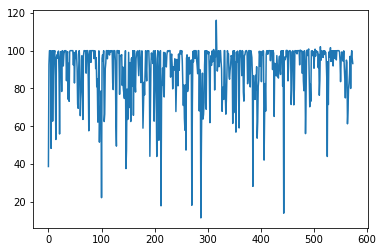

Time elapsed:14799.076297283173
| Reward: 66 | Episode: 574 


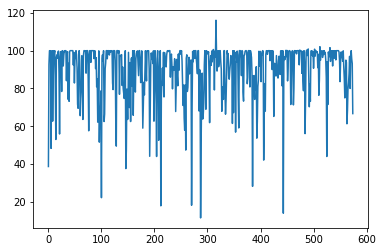

Time elapsed:14827.226869106293
| Reward: 87 | Episode: 575 


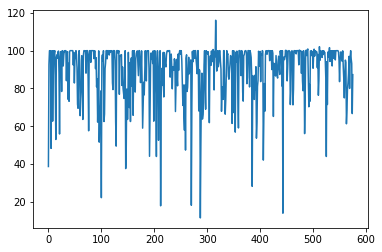

Time elapsed:14855.343029499054
| Reward: 99 | Episode: 576 


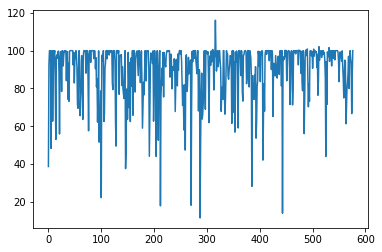

Time elapsed:14883.63758277893
| Reward: 99 | Episode: 577 


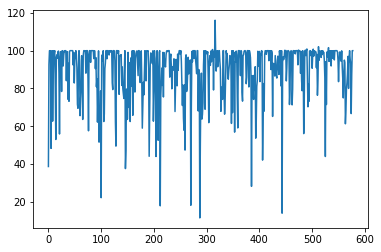

Time elapsed:14911.677301883698
| Reward: 94 | Episode: 578 


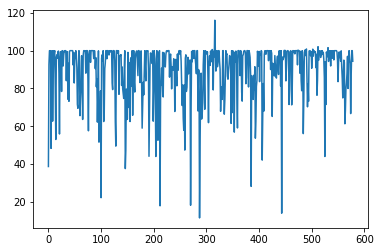

Time elapsed:14939.764352321625
| Reward: 83 | Episode: 579 


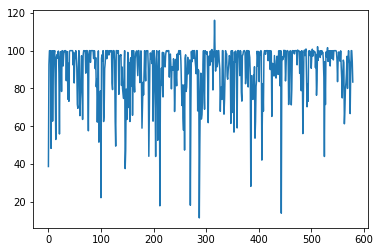

Time elapsed:14967.839810848236
| Reward: 98 | Episode: 580 


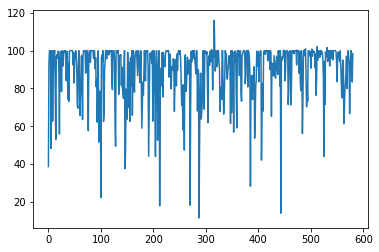

Time elapsed:14996.211421251297
| Reward: 99 | Episode: 581 


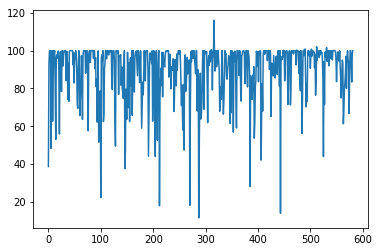

Time elapsed:15024.522369146347
| Reward: 62 | Episode: 582 


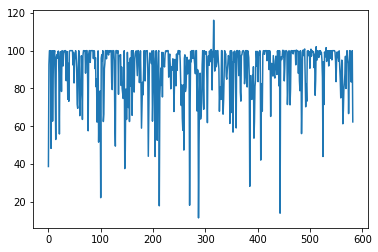

Time elapsed:15052.832198858261
| Reward: 78 | Episode: 583 


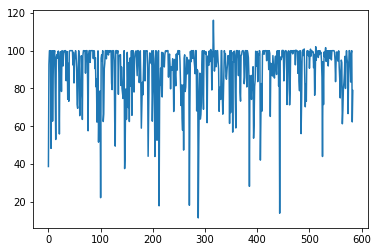

Time elapsed:15081.10623717308
| Reward: 99 | Episode: 584 


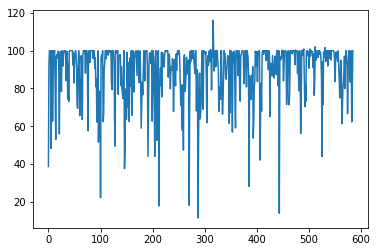

Time elapsed:15109.569927453995
| Reward: 76 | Episode: 585 


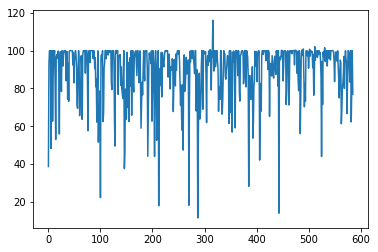

Time elapsed:15138.050367116928
| Reward: 78 | Episode: 586 


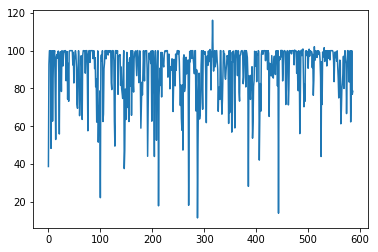

Time elapsed:15166.545525074005
| Reward: 98 | Episode: 587 


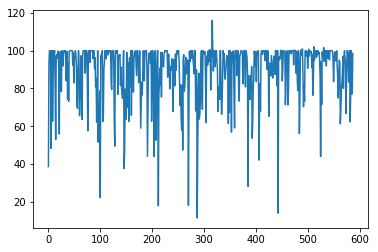

Time elapsed:15194.822643518448
| Reward: 99 | Episode: 588 


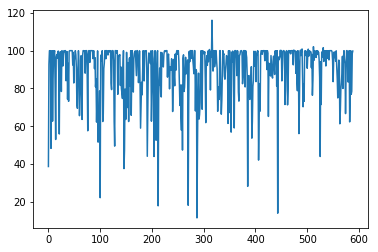

Time elapsed:15223.351020097733
| Reward: 113 | Episode: 589 


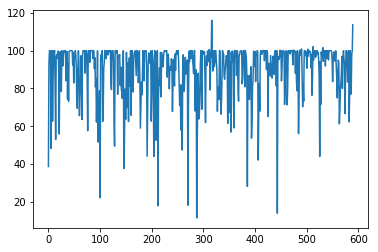

Time elapsed:15251.901632070541
| Reward: 103 | Episode: 590 


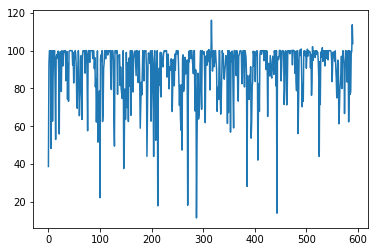

Time elapsed:15280.204409360886
| Reward: 101 | Episode: 591 


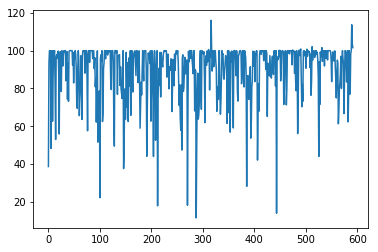

Time elapsed:15308.466189146042
| Reward: 103 | Episode: 592 


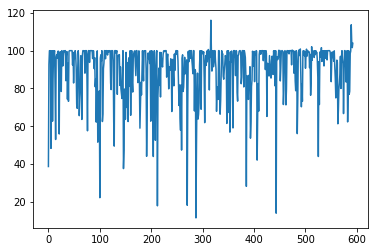

Time elapsed:15336.879424095154
| Reward: 99 | Episode: 593 


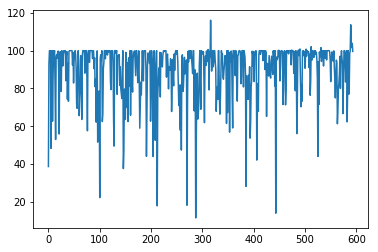

Time elapsed:15365.438428401947
| Reward: 99 | Episode: 594 


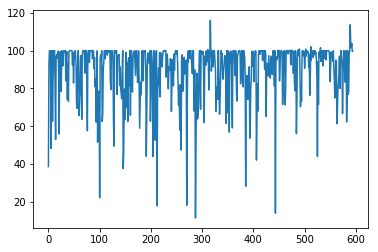

Time elapsed:15393.616505384445
| Reward: 99 | Episode: 595 


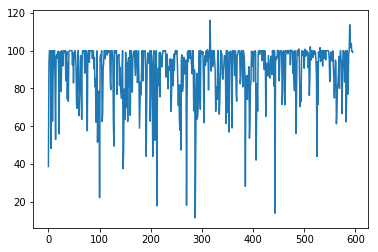

Time elapsed:15421.870505809784
| Reward: 99 | Episode: 596 


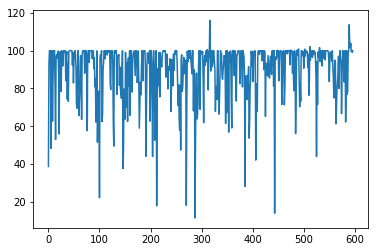

Time elapsed:15450.095642089844
| Reward: 96 | Episode: 597 


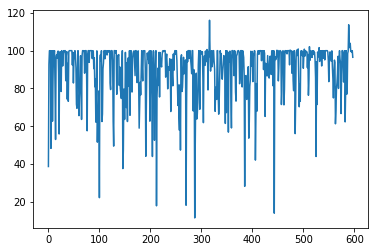

Time elapsed:15478.561021566391
| Reward: 100 | Episode: 598 


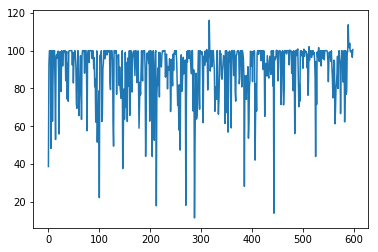

Time elapsed:15506.86273241043
| Reward: 112 | Episode: 599 


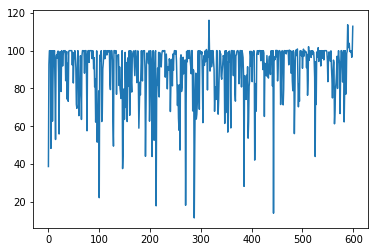

Time elapsed:15535.194287538528
| Reward: 103 | Episode: 600 


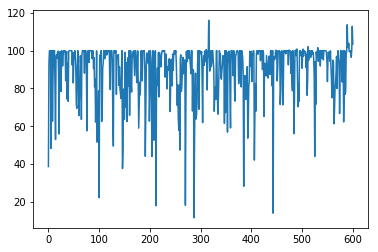

Time elapsed:15563.518546581268
| Reward: 99 | Episode: 601 


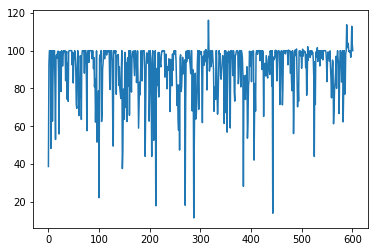

Time elapsed:15591.947828769684
| Reward: 101 | Episode: 602 


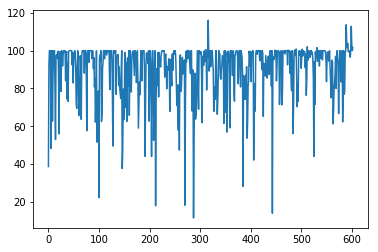

Time elapsed:15620.414533138275
| Reward: 99 | Episode: 603 


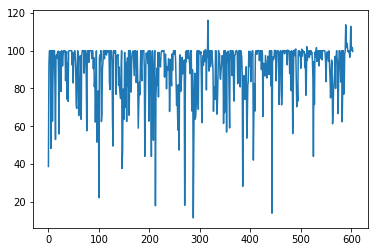

Time elapsed:15648.869378089905
| Reward: 140 | Episode: 604 


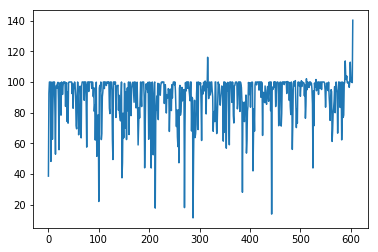

Time elapsed:15677.323473453522
| Reward: 100 | Episode: 605 


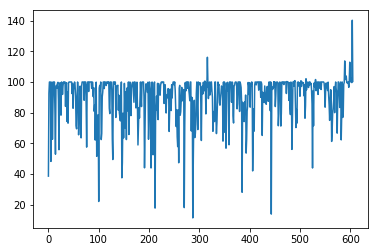

Time elapsed:15706.06871175766
| Reward: 248 | Episode: 606 


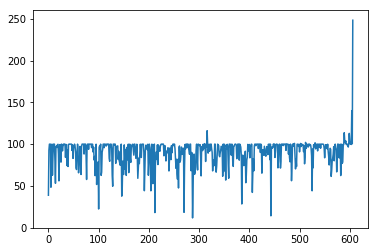

Time elapsed:15735.56772851944
| Reward: 125 | Episode: 607 


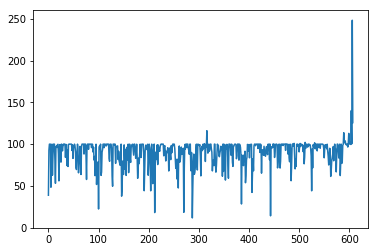

Time elapsed:15764.240268468857
| Reward: 156 | Episode: 608 


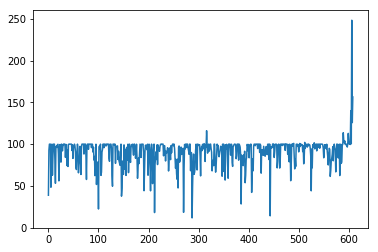

Time elapsed:15792.808621883392
| Reward: 192 | Episode: 609 


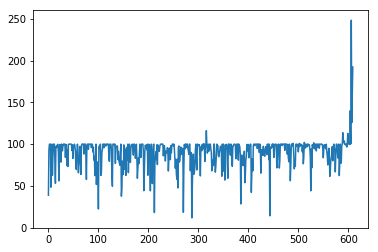

Time elapsed:15821.414949893951
| Reward: 233 | Episode: 610 


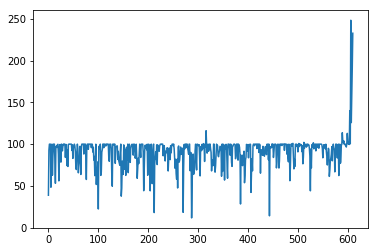

Time elapsed:15850.118276119232
| Reward: 136 | Episode: 611 


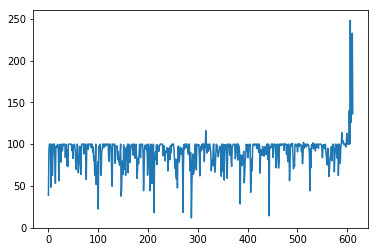

Time elapsed:15878.664018630981
| Reward: 222 | Episode: 612 


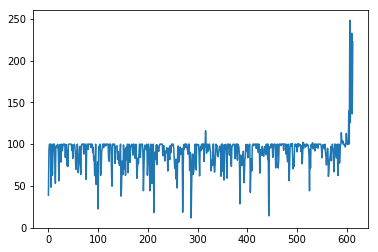

Time elapsed:15907.274708271027
| Reward: 167 | Episode: 613 


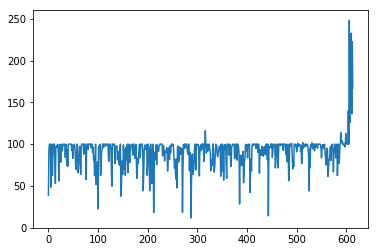

Time elapsed:15936.805694103241
| Reward: 103 | Episode: 614 


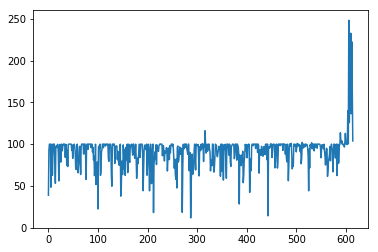

Time elapsed:15965.664403915405
| Reward: 163 | Episode: 615 


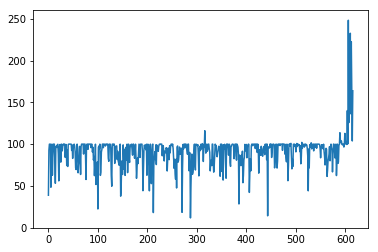

Time elapsed:15994.481455564499
| Reward: 204 | Episode: 616 


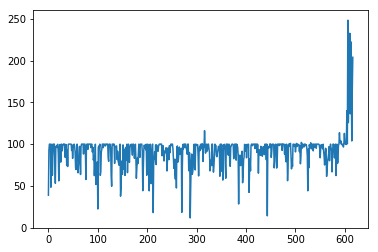

Time elapsed:16023.149970769882
| Reward: 117 | Episode: 617 


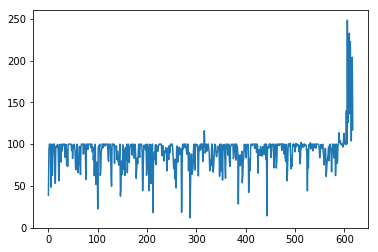

Time elapsed:16052.757065057755
| Reward: 154 | Episode: 618 


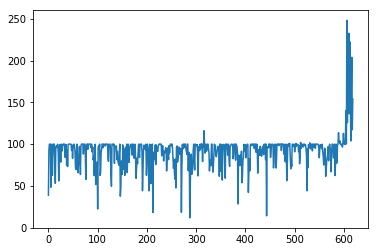

Time elapsed:16082.220921278
| Reward: 139 | Episode: 619 


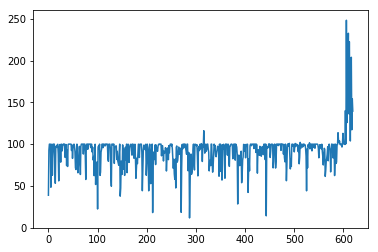

Time elapsed:16111.642137527466
| Reward: 209 | Episode: 620 


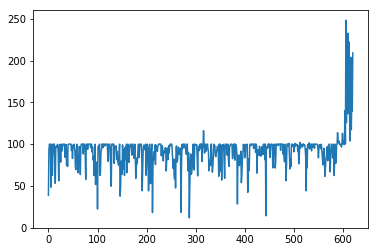

Time elapsed:16141.290087938309
| Reward: 134 | Episode: 621 


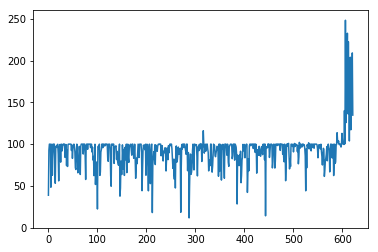

Time elapsed:16170.816343069077
| Reward: 146 | Episode: 622 


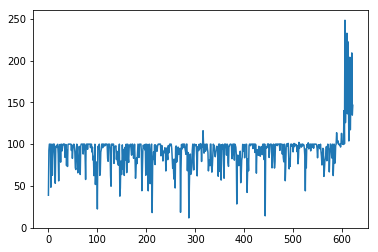

Time elapsed:16199.831665992737
| Reward: 253 | Episode: 623 


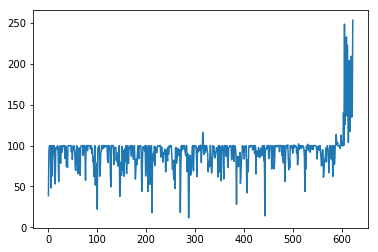

Time elapsed:16229.123433351517
| Reward: 114 | Episode: 624 


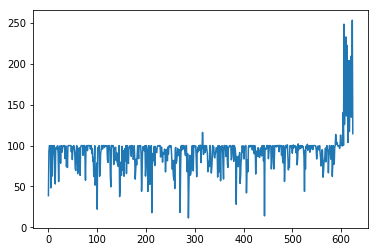

Time elapsed:16257.835592031479
| Reward: 168 | Episode: 625 


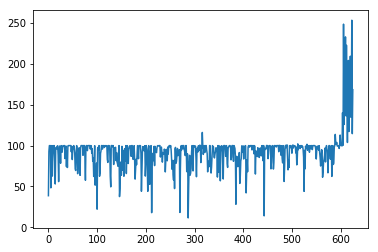

Time elapsed:16286.588301181793
| Reward: 147 | Episode: 626 


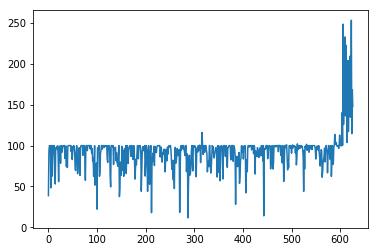

Time elapsed:16315.561156749725
| Reward: 150 | Episode: 627 


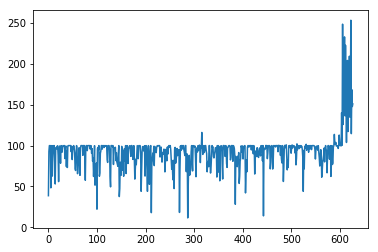

Time elapsed:16344.362282037735
| Reward: 165 | Episode: 628 


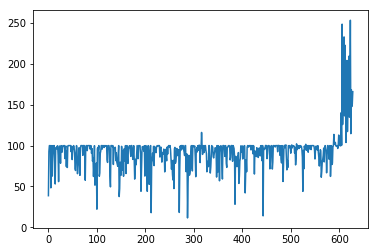

Time elapsed:16373.250844478607
| Reward: 247 | Episode: 629 


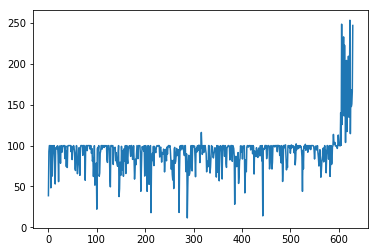

Time elapsed:16401.801345586777
| Reward: 111 | Episode: 630 


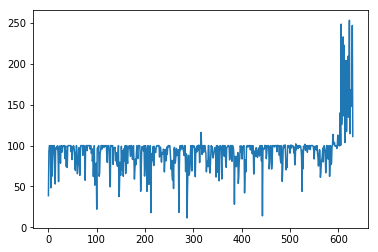

Time elapsed:16430.9478662014
| Reward: 140 | Episode: 631 


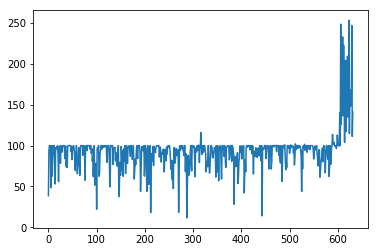

Time elapsed:16459.712864875793
| Reward: 134 | Episode: 632 


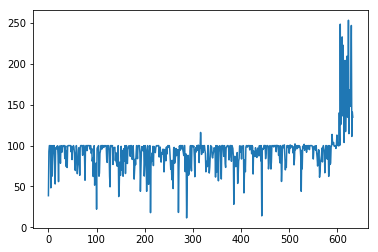

Time elapsed:16488.51762342453
| Reward: 226 | Episode: 633 


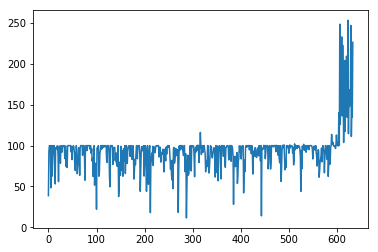

Time elapsed:16517.720057725906
| Reward: 203 | Episode: 634 


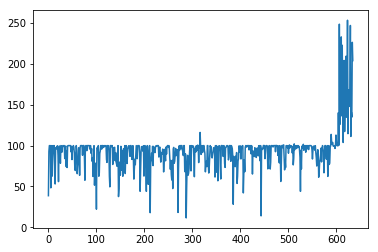

Time elapsed:16546.732454538345
| Reward: 172 | Episode: 635 


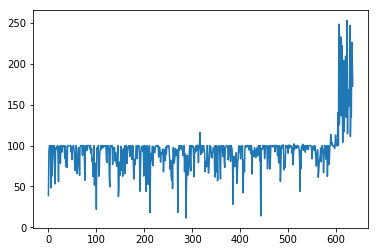

Time elapsed:16575.86824774742
| Reward: 176 | Episode: 636 


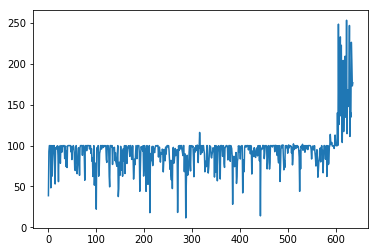

Time elapsed:16605.083874702454
| Reward: 144 | Episode: 637 


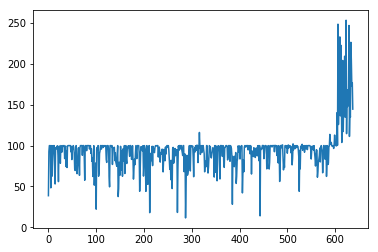

Time elapsed:16634.02723455429
| Reward: 244 | Episode: 638 


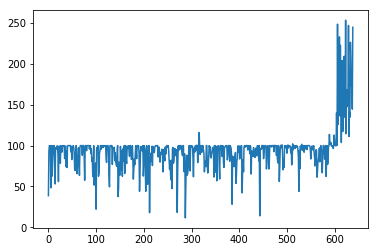

Time elapsed:16663.252751111984
| Reward: 144 | Episode: 639 


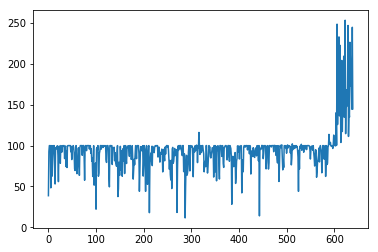

Time elapsed:16692.272050380707
| Reward: 183 | Episode: 640 


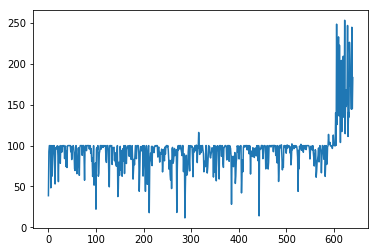

Time elapsed:16721.231954336166
| Reward: 236 | Episode: 641 


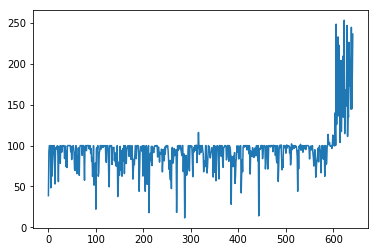

Time elapsed:16750.205845832825
| Reward: 212 | Episode: 642 


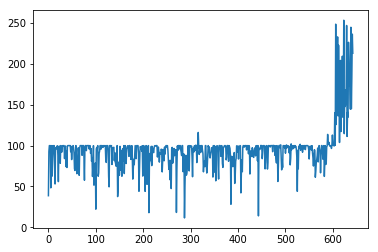

Time elapsed:16778.956967830658
| Reward: 122 | Episode: 643 


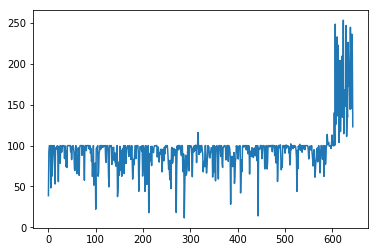

Time elapsed:16807.84844851494
| Reward: 167 | Episode: 644 


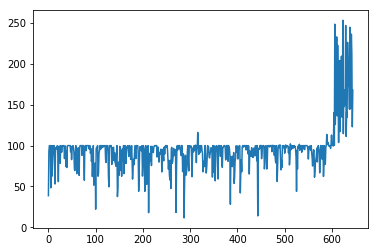

Time elapsed:16836.664662361145
| Reward: 107 | Episode: 645 


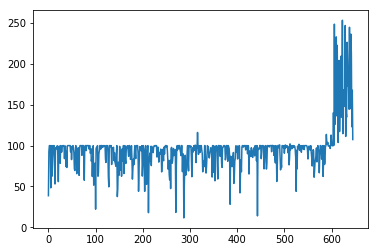

Time elapsed:16865.470712423325
| Reward: 107 | Episode: 646 


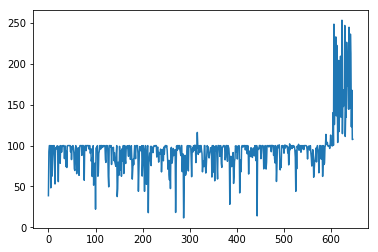

Time elapsed:16894.397890090942
| Reward: 119 | Episode: 647 


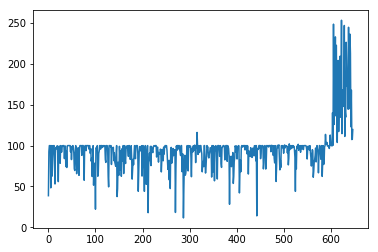

Time elapsed:16923.436376571655
| Reward: 149 | Episode: 648 


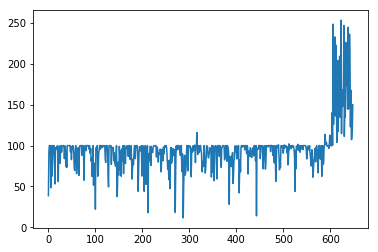

Time elapsed:16952.46837735176
| Reward: 118 | Episode: 649 


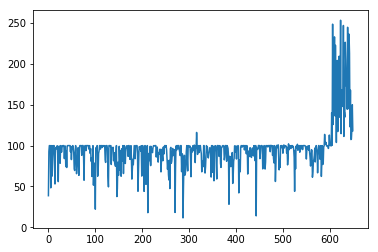

Time elapsed:16981.3612408638
| Reward: 184 | Episode: 650 


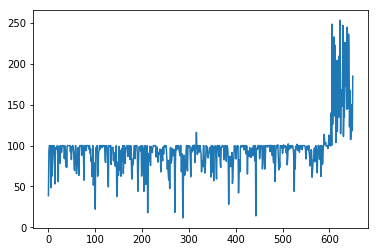

Time elapsed:17010.7243039608
| Reward: 176 | Episode: 651 


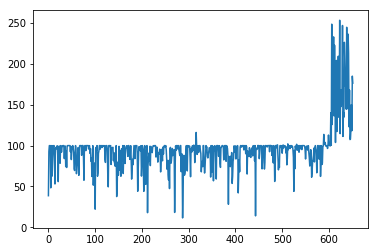

Time elapsed:17040.029465675354
| Reward: 133 | Episode: 652 


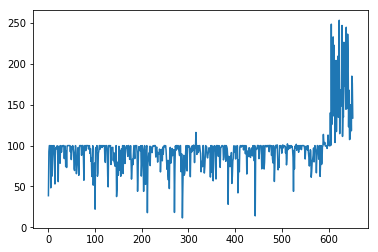

Time elapsed:17069.295224428177
| Reward: 168 | Episode: 653 


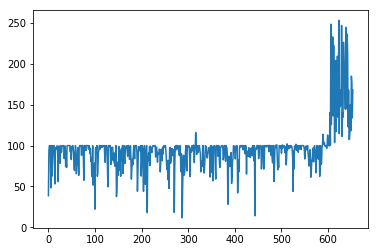

Time elapsed:17098.707356214523
| Reward: 175 | Episode: 654 


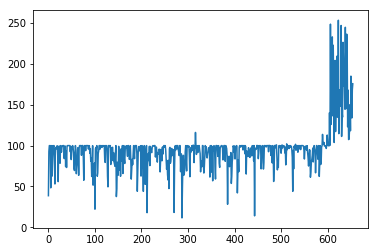

Time elapsed:17127.93421816826
| Reward: 261 | Episode: 655 


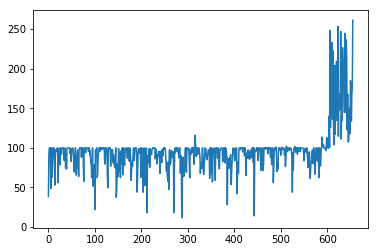

Time elapsed:17157.348963737488
| Reward: 266 | Episode: 656 


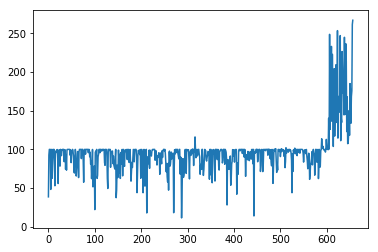

Time elapsed:17187.014385700226
| Reward: 241 | Episode: 657 


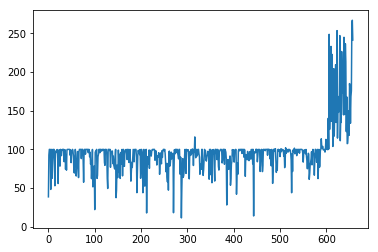

Time elapsed:17216.278798103333
| Reward: 133 | Episode: 658 


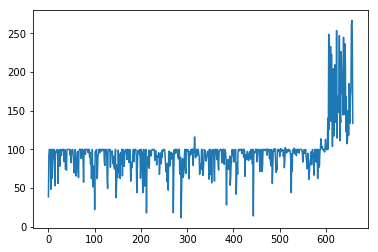

Time elapsed:17246.33803343773
| Reward: 242 | Episode: 659 


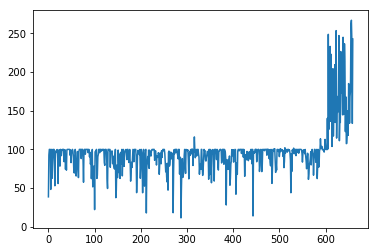

Time elapsed:17275.710389137268
| Reward: 283 | Episode: 660 


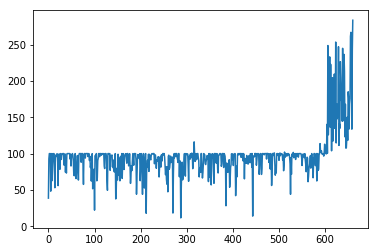

Time elapsed:17305.172385692596
| Reward: 263 | Episode: 661 


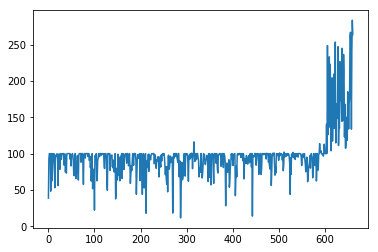

Time elapsed:17334.499744176865
| Reward: 272 | Episode: 662 


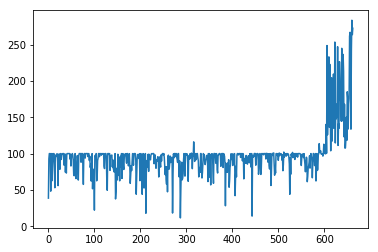

Time elapsed:17364.307953834534
| Reward: 244 | Episode: 663 


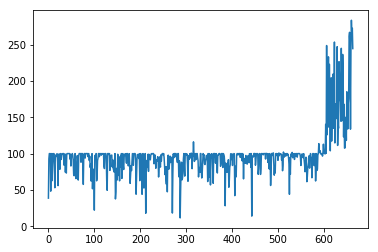

Time elapsed:17393.79730796814
| Reward: 167 | Episode: 664 


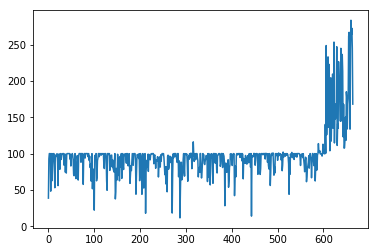

Time elapsed:17422.990826129913
| Reward: 111 | Episode: 665 


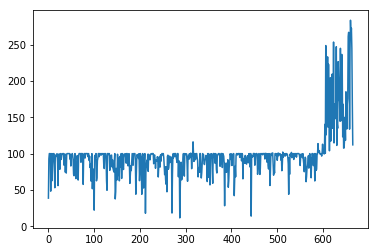

Time elapsed:17452.607530355453
| Reward: 273 | Episode: 666 


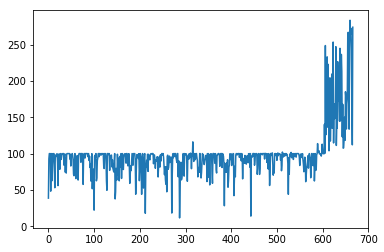

Time elapsed:17481.99245452881
| Reward: 214 | Episode: 667 


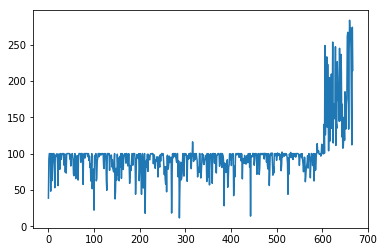

Time elapsed:17511.644560813904
| Reward: 221 | Episode: 668 


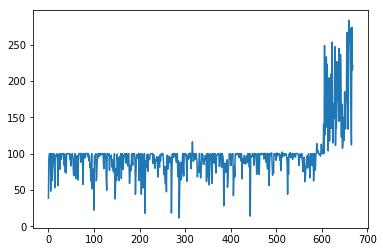

Time elapsed:17541.106036663055
| Reward: 134 | Episode: 669 


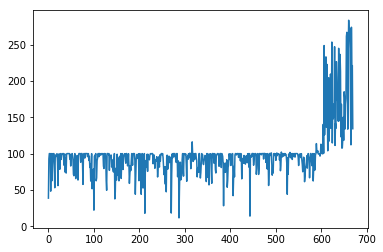

Time elapsed:17570.498005628586
| Reward: 156 | Episode: 670 


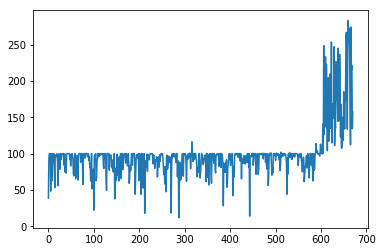

Time elapsed:17599.97577524185
| Reward: 152 | Episode: 671 


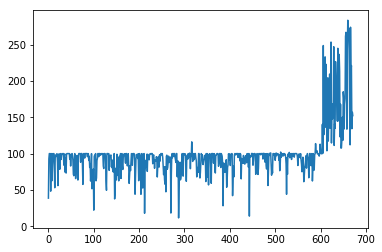

Time elapsed:17629.793808221817
| Reward: 204 | Episode: 672 


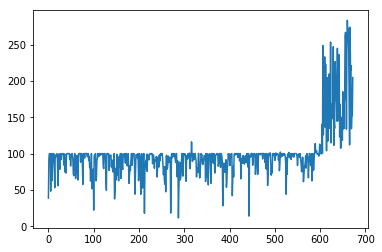

Time elapsed:17659.384282827377
| Reward: 228 | Episode: 673 


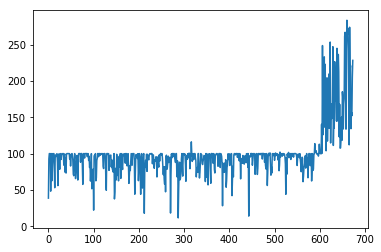

Time elapsed:17688.891259908676
| Reward: 117 | Episode: 674 


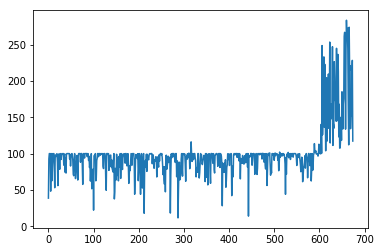

Time elapsed:17718.488461494446
| Reward: 225 | Episode: 675 


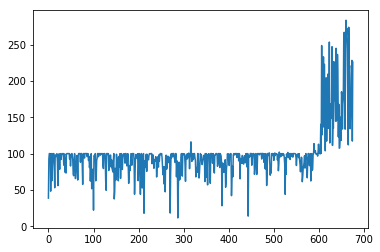

Time elapsed:17748.027490854263
| Reward: 281 | Episode: 676 


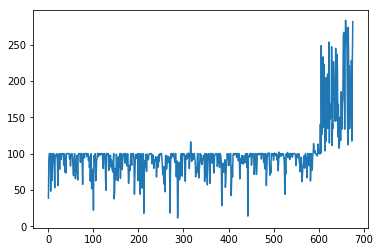

Time elapsed:17777.427988767624
| Reward: 171 | Episode: 677 


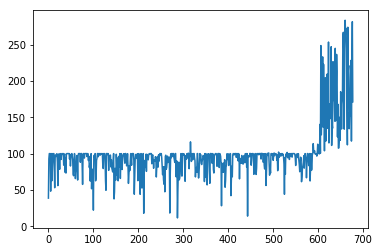

Time elapsed:17806.937396764755
| Reward: 167 | Episode: 678 


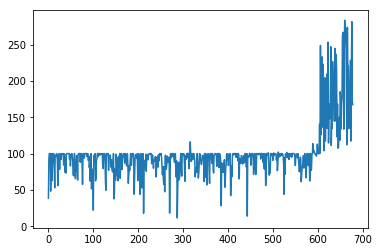

Time elapsed:17836.65727829933
| Reward: 100 | Episode: 679 


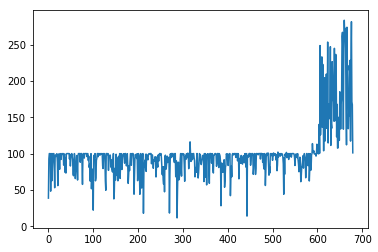

Time elapsed:17865.979162693024
| Reward: 217 | Episode: 680 


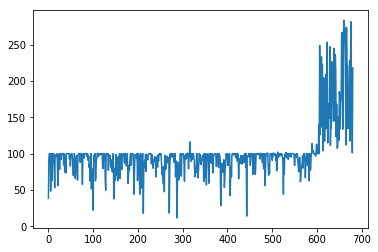

Time elapsed:17895.5509185791
| Reward: 201 | Episode: 681 


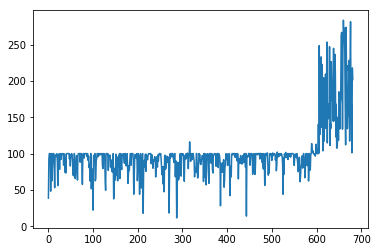

Time elapsed:17925.745723485947
| Reward: 262 | Episode: 682 


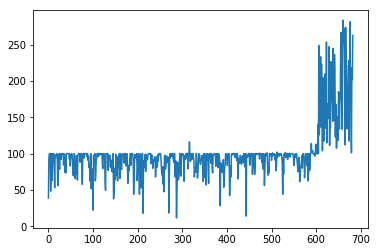

Time elapsed:17955.31913280487
| Reward: 158 | Episode: 683 


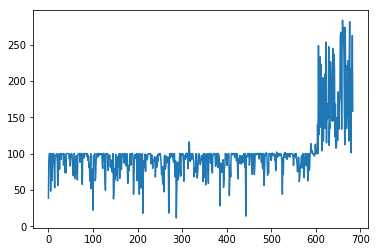

Time elapsed:17985.004281759262
| Reward: 202 | Episode: 684 


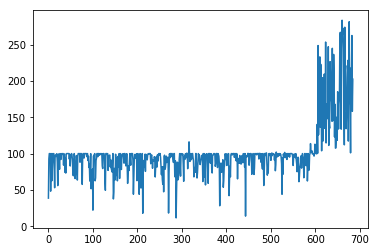

Time elapsed:18014.901243448257
| Reward: 175 | Episode: 685 


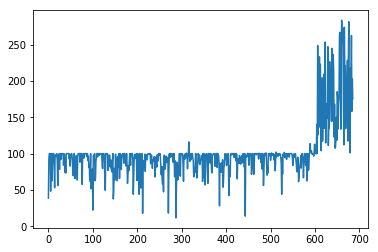

Time elapsed:18045.251685619354
| Reward: 281 | Episode: 686 


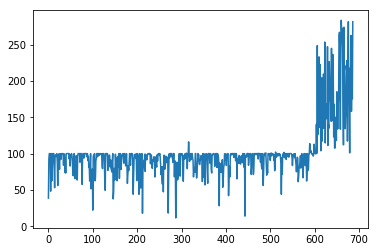

Time elapsed:18075.19534254074
| Reward: 258 | Episode: 687 


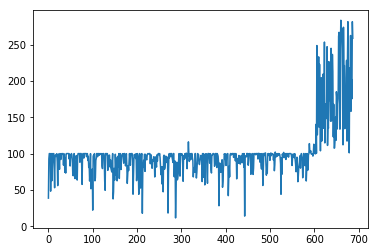

Time elapsed:18105.107667207718
| Reward: 282 | Episode: 688 


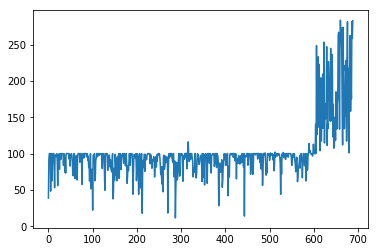

Time elapsed:18136.24776482582
| Reward: 269 | Episode: 689 


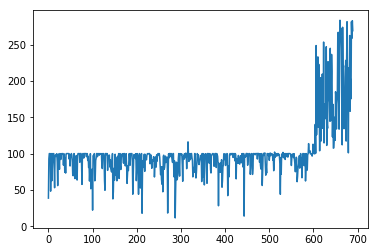

Time elapsed:18167.075555562973
| Reward: 271 | Episode: 690 


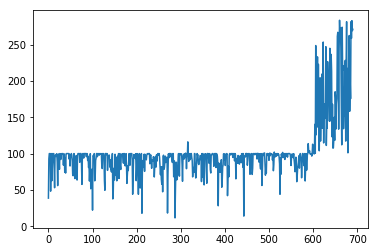

Time elapsed:18197.598806142807
| Reward: 233 | Episode: 691 


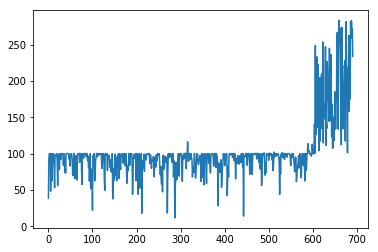

Time elapsed:18228.26135110855
| Reward: 281 | Episode: 692 


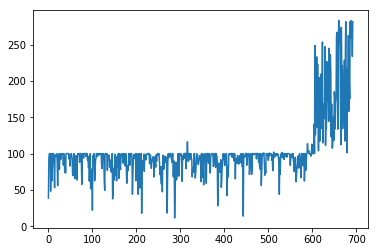

Time elapsed:18257.945145368576
| Reward: 222 | Episode: 693 


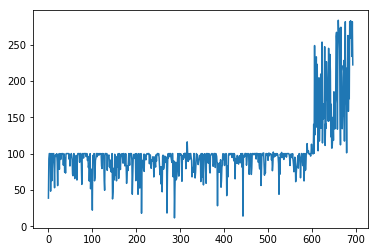

Time elapsed:18287.80068254471
| Reward: 210 | Episode: 694 


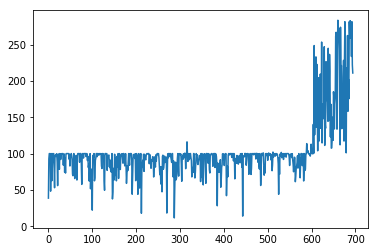

Time elapsed:18317.638476371765
| Reward: 121 | Episode: 695 


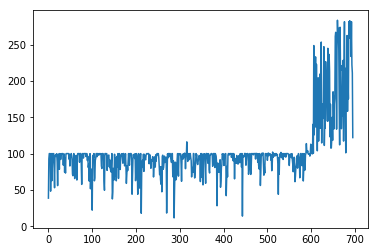

Time elapsed:18347.725161075592
| Reward: 225 | Episode: 696 


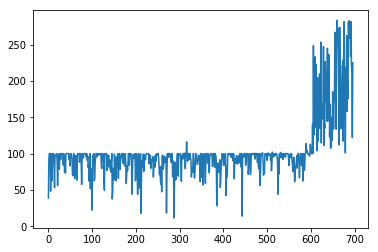

Time elapsed:18377.776178598404
| Reward: 252 | Episode: 697 


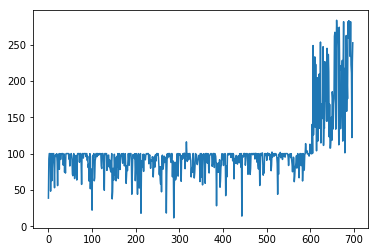

Time elapsed:18407.554037570953
| Reward: 136 | Episode: 698 


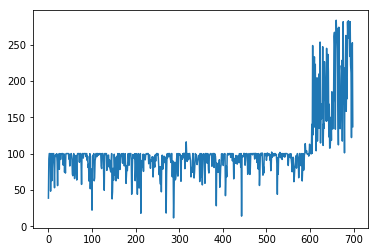

Time elapsed:18437.376904010773
| Reward: 137 | Episode: 699 


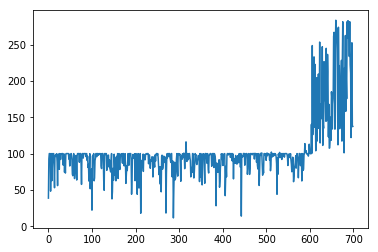

Time elapsed:18467.371045827866
| Reward: 120 | Episode: 700 


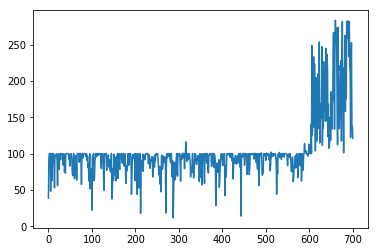

Time elapsed:18497.048857212067
| Reward: 98 | Episode: 701 


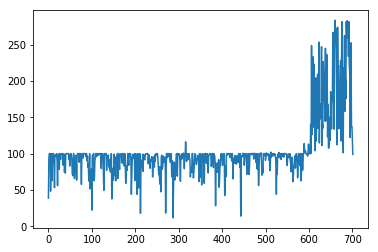

Time elapsed:18527.05667901039
| Reward: 100 | Episode: 702 


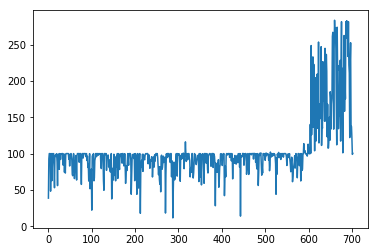

Time elapsed:18557.175020217896
| Reward: 193 | Episode: 703 


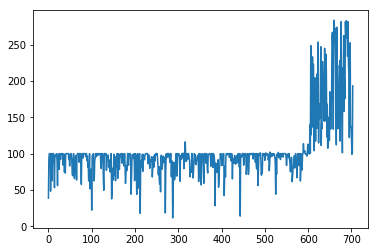

Time elapsed:18587.186616897583
| Reward: 282 | Episode: 704 


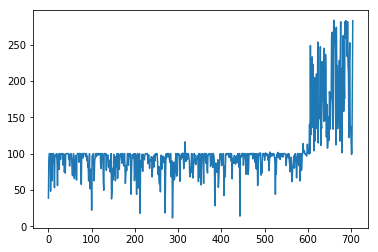

Time elapsed:18617.15918660164
| Reward: 251 | Episode: 705 


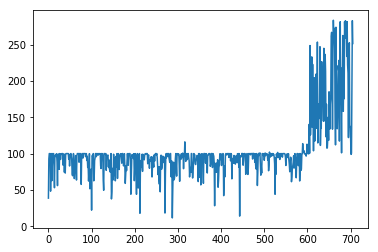

Time elapsed:18647.733680725098
| Reward: 218 | Episode: 706 


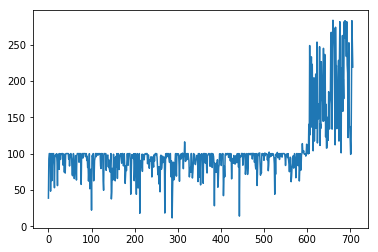

Time elapsed:18677.585982322693
| Reward: 166 | Episode: 707 


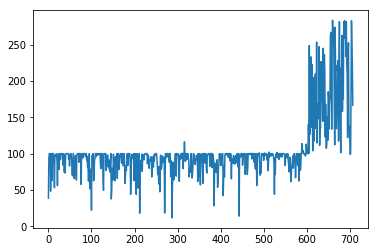

Time elapsed:18707.5494492054
| Reward: 233 | Episode: 708 


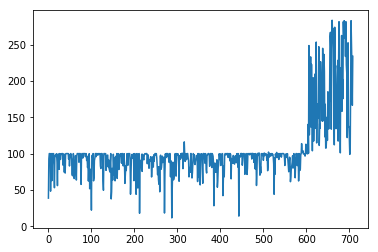

Time elapsed:18737.639055013657
| Reward: 234 | Episode: 709 


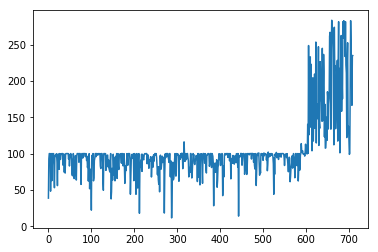

Time elapsed:18767.712198734283
| Reward: 272 | Episode: 710 


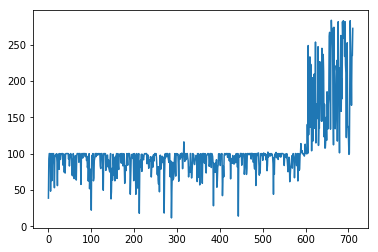

Time elapsed:18797.622208833694
| Reward: 248 | Episode: 711 


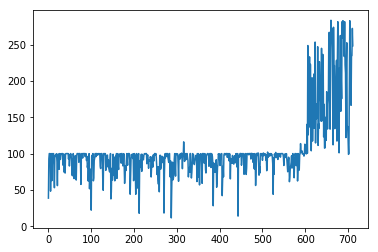

Time elapsed:18827.52158522606
| Reward: 184 | Episode: 712 


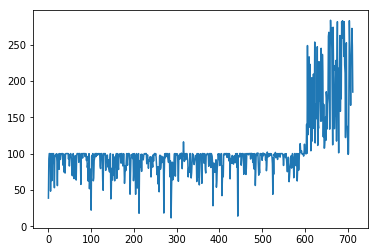

Time elapsed:18857.470563411713
| Reward: 176 | Episode: 713 


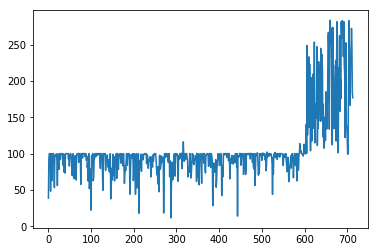

Time elapsed:18886.99025797844
| Reward: 180 | Episode: 714 


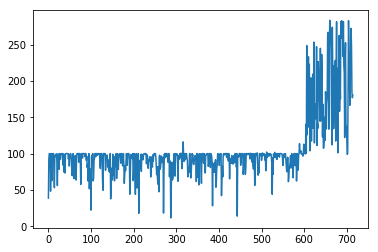

Time elapsed:18916.708178520203
| Reward: 232 | Episode: 715 


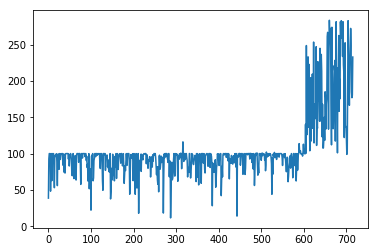

Time elapsed:18946.387898921967
| Reward: 243 | Episode: 716 


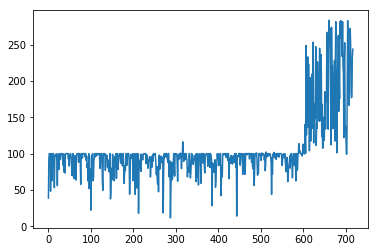

Time elapsed:18976.185571670532
| Reward: 237 | Episode: 717 


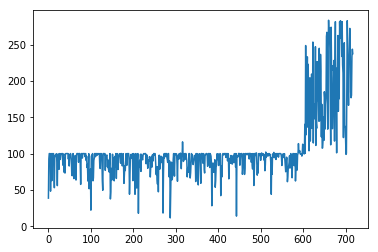

Time elapsed:19005.96628522873
| Reward: 251 | Episode: 718 


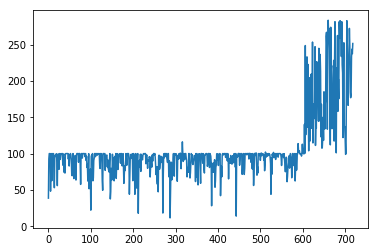

Time elapsed:19035.76409125328
| Reward: 209 | Episode: 719 


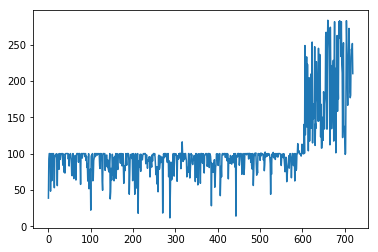

Time elapsed:19065.728361845016
| Reward: 233 | Episode: 720 


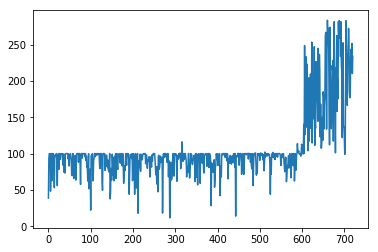

Time elapsed:19095.591386795044
| Reward: 272 | Episode: 721 


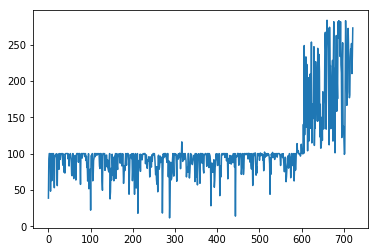

Time elapsed:19125.43309855461
| Reward: 188 | Episode: 722 


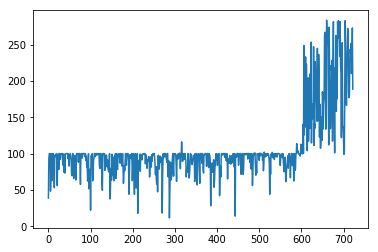

Time elapsed:19155.479415416718
| Reward: 92 | Episode: 723 


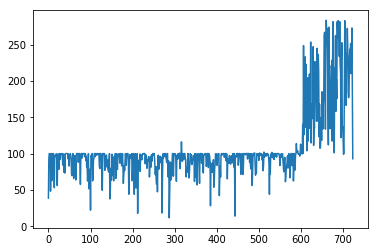

Time elapsed:19185.375846862793
| Reward: 219 | Episode: 724 


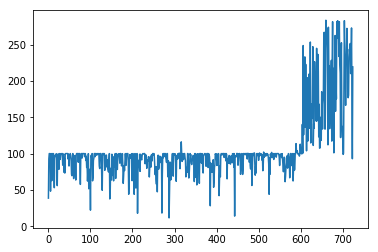

Time elapsed:19215.37605214119
| Reward: 136 | Episode: 725 


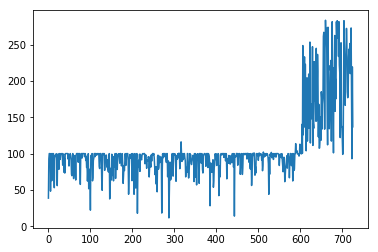

Time elapsed:19245.879242897034
| Reward: 176 | Episode: 726 


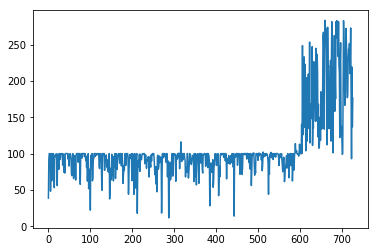

Time elapsed:19276.60940885544
| Reward: 216 | Episode: 727 


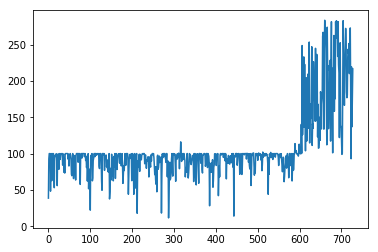

Time elapsed:19307.890329360962
| Reward: 105 | Episode: 728 


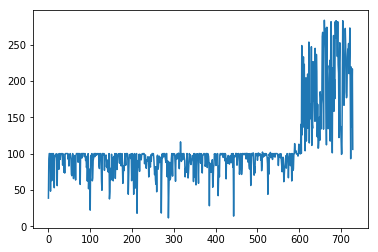

Time elapsed:19338.502087831497
| Reward: 161 | Episode: 729 


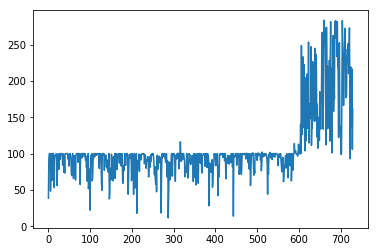

Time elapsed:19368.762220144272
| Reward: 209 | Episode: 730 


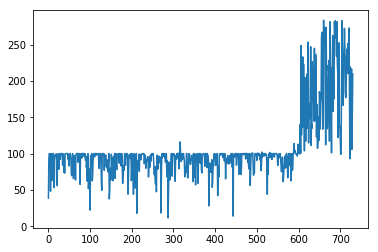

Time elapsed:19398.912115335464
| Reward: 158 | Episode: 731 


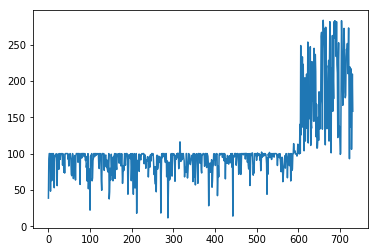

Time elapsed:19429.31186413765
| Reward: 134 | Episode: 732 


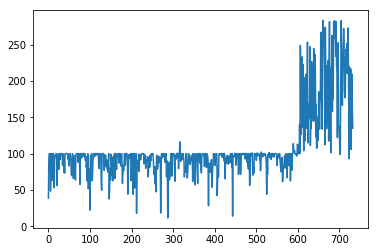

Time elapsed:19459.541718244553
| Reward: 183 | Episode: 733 


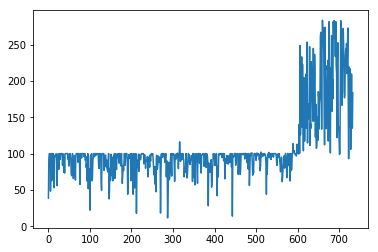

Time elapsed:19489.64098596573
| Reward: 116 | Episode: 734 


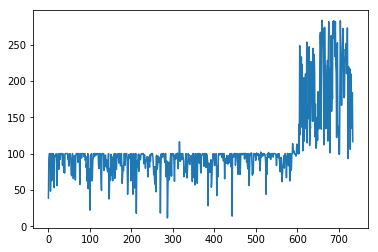

Time elapsed:19519.987147808075
| Reward: 195 | Episode: 735 


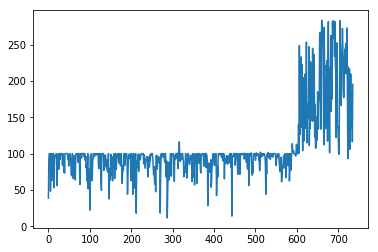

Time elapsed:19550.413726568222
| Reward: 127 | Episode: 736 


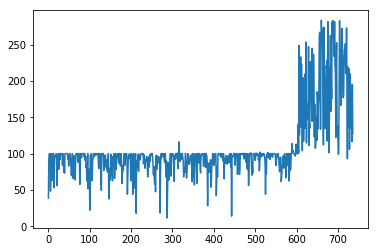

Time elapsed:19580.565403938293
| Reward: 175 | Episode: 737 


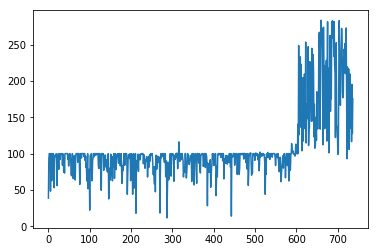

Time elapsed:19610.788242816925
| Reward: 276 | Episode: 738 


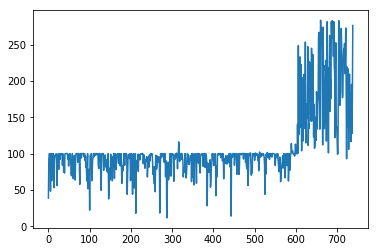

Time elapsed:19641.15104842186
| Reward: 260 | Episode: 739 


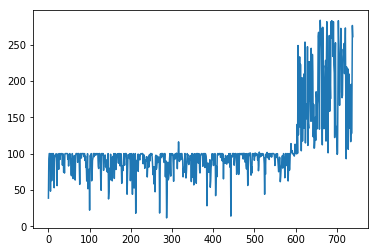

Time elapsed:19671.57937145233
| Reward: 289 | Episode: 740 


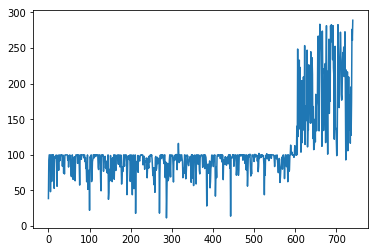

Time elapsed:19701.91324520111
| Reward: 163 | Episode: 741 


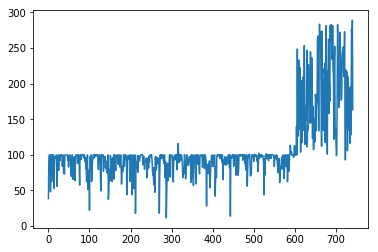

Time elapsed:19732.31407880783
| Reward: 204 | Episode: 742 


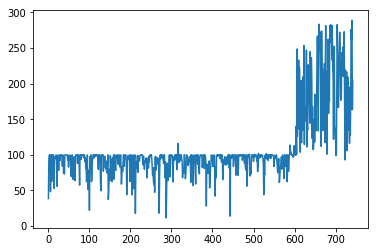

Time elapsed:19762.61464548111
| Reward: 114 | Episode: 743 


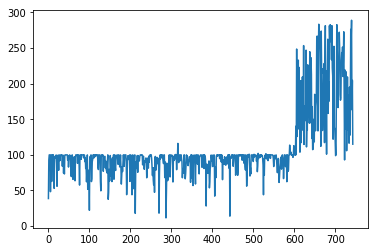

Time elapsed:19793.13869714737
| Reward: 197 | Episode: 744 


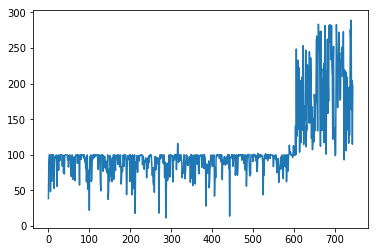

Time elapsed:19823.492413282394
| Reward: 134 | Episode: 745 


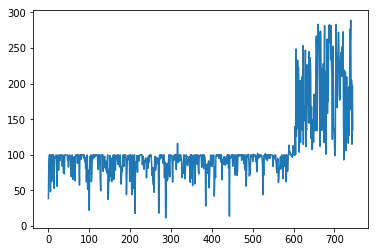

Time elapsed:19854.130611658096
| Reward: 226 | Episode: 746 


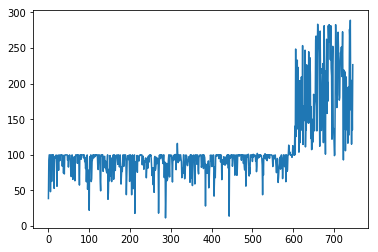

Time elapsed:19884.836505174637
| Reward: 244 | Episode: 747 


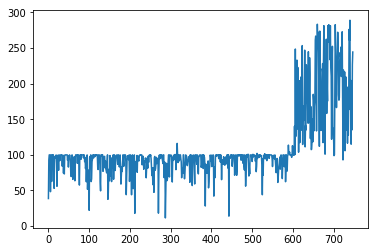

Time elapsed:19916.013358592987
| Reward: 252 | Episode: 748 


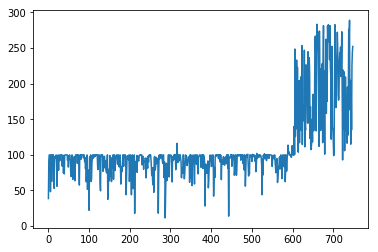

Time elapsed:19946.53337454796
| Reward: 288 | Episode: 749 


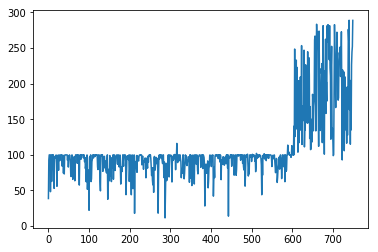

Time elapsed:19977.33762407303
| Reward: 251 | Episode: 750 


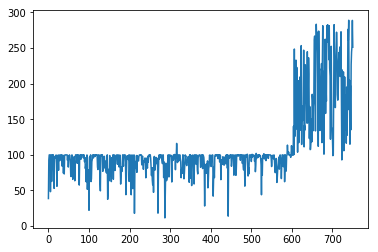

Time elapsed:20008.001568317413
| Reward: 231 | Episode: 751 


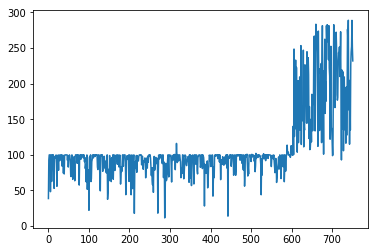

Time elapsed:20038.820643663406
| Reward: 298 | Episode: 752 


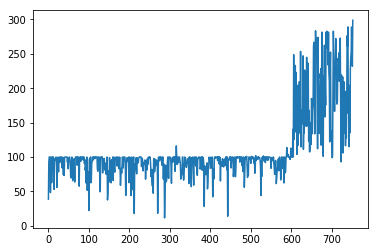

Time elapsed:20070.279095172882
| Reward: 261 | Episode: 753 


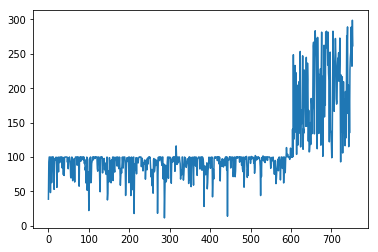

Time elapsed:20101.352168560028
| Reward: 271 | Episode: 754 


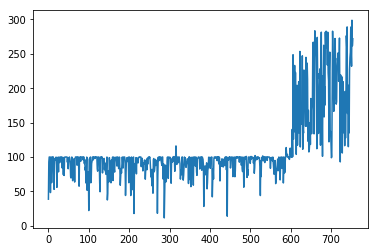

Time elapsed:20131.83844947815
| Reward: 266 | Episode: 755 


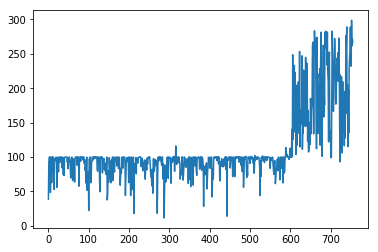

Time elapsed:20162.500084400177
| Reward: 136 | Episode: 756 


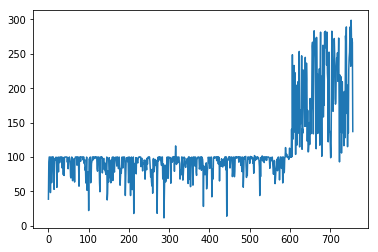

Time elapsed:20193.537836551666
| Reward: 150 | Episode: 757 


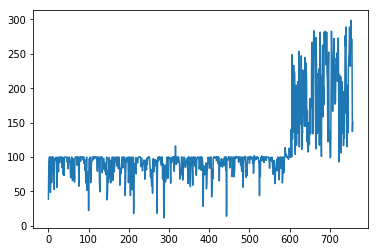

Time elapsed:20225.514101028442
| Reward: 101 | Episode: 758 


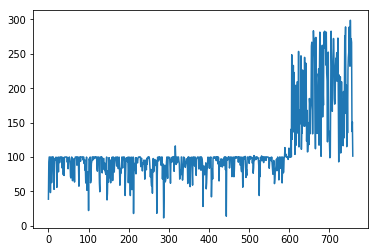

Time elapsed:20257.263159275055
| Reward: 89 | Episode: 759 


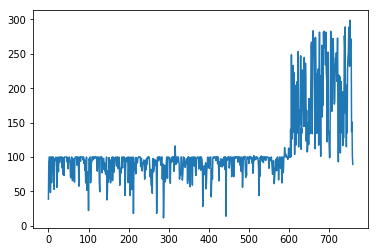

Time elapsed:20288.723309993744
| Reward: 129 | Episode: 760 


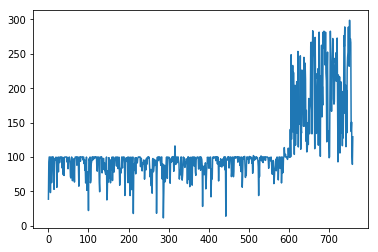

Time elapsed:20320.233003616333
| Reward: 289 | Episode: 761 


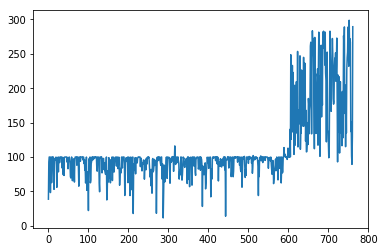

Time elapsed:20351.201528072357
| Reward: 261 | Episode: 762 


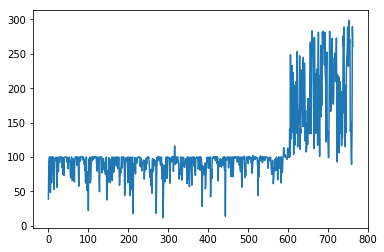

Time elapsed:20382.706634044647
| Reward: 442 | Episode: 763 


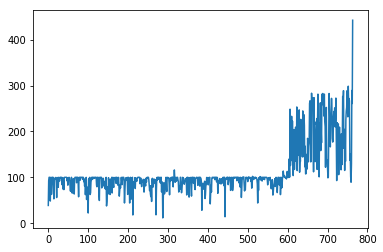

Time elapsed:20414.386837482452
| Reward: 173 | Episode: 764 


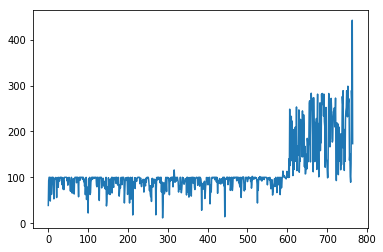

Time elapsed:20445.755486011505
| Reward: 209 | Episode: 765 


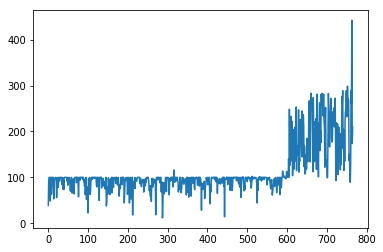

Time elapsed:20476.995747566223
| Reward: 182 | Episode: 766 


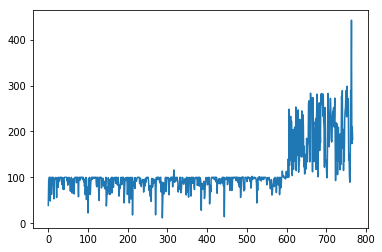

Time elapsed:20508.18463420868
| Reward: 273 | Episode: 767 


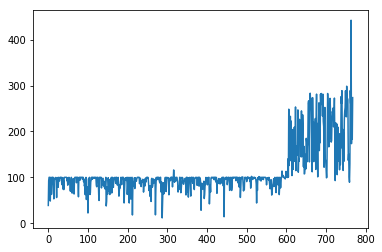

Time elapsed:20539.953078985214
| Reward: 150 | Episode: 768 


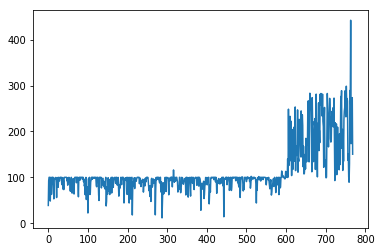

Time elapsed:20571.43464064598
| Reward: 251 | Episode: 769 


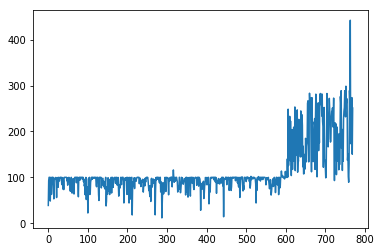

Time elapsed:20602.451073884964
| Reward: 170 | Episode: 770 


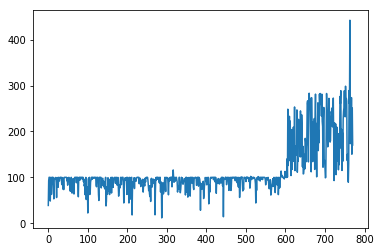

Time elapsed:20633.582158327103
| Reward: 166 | Episode: 771 


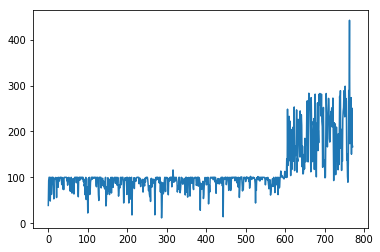

Time elapsed:20664.872093439102
| Reward: 211 | Episode: 772 


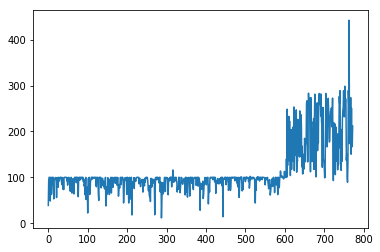

Time elapsed:20696.55082178116
| Reward: 227 | Episode: 773 


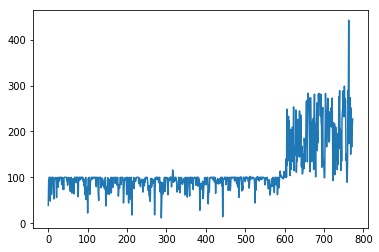

Time elapsed:20728.357110261917
| Reward: 287 | Episode: 774 


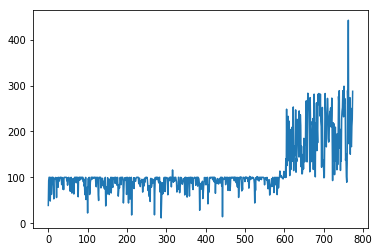

Time elapsed:20760.566388845444
| Reward: 281 | Episode: 775 


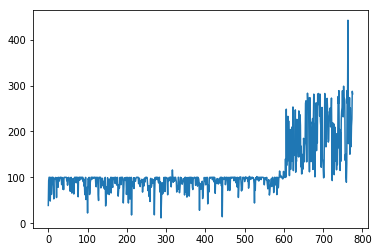

Time elapsed:20792.311917304993
| Reward: 236 | Episode: 776 


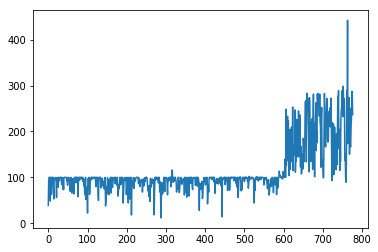

Time elapsed:20823.653897047043
| Reward: 156 | Episode: 777 


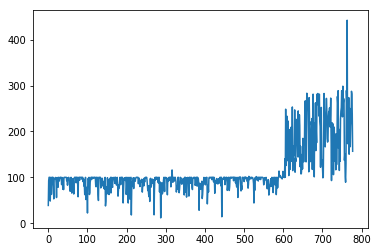

Time elapsed:20854.386894464493
| Reward: 161 | Episode: 778 


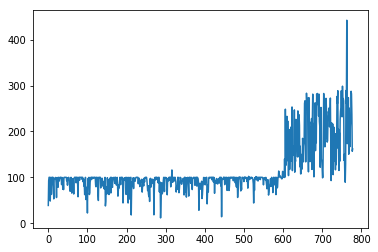

Time elapsed:20885.7497317791
| Reward: 283 | Episode: 779 


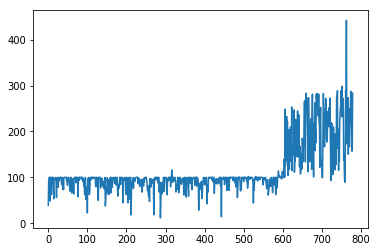

Time elapsed:20916.57799553871
| Reward: 134 | Episode: 780 


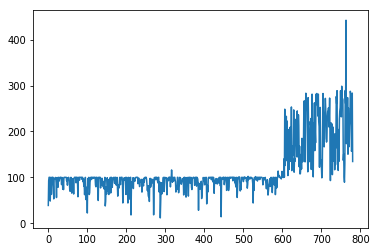

Time elapsed:20947.62445616722
| Reward: 163 | Episode: 781 


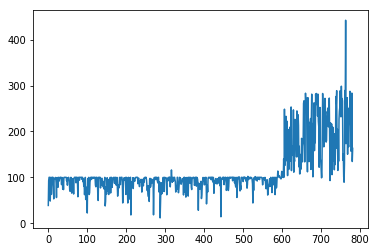

Time elapsed:20978.531014204025
| Reward: 230 | Episode: 782 


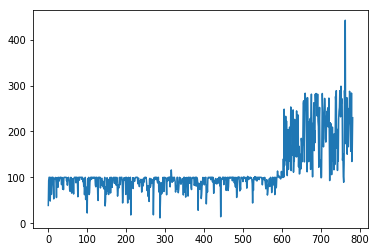

Time elapsed:21009.400994300842
| Reward: 315 | Episode: 783 


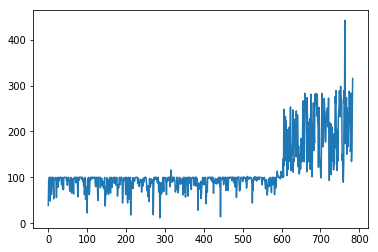

Time elapsed:21040.11691212654
| Reward: 236 | Episode: 784 


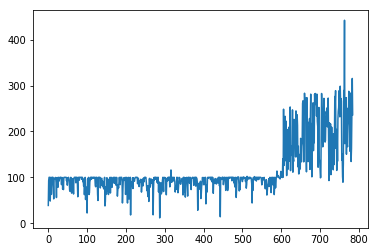

Time elapsed:21070.980943202972
| Reward: 270 | Episode: 785 


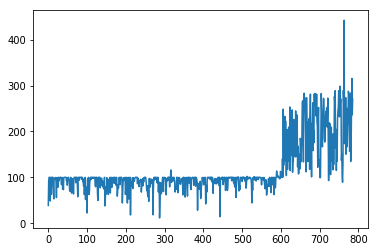

Time elapsed:21101.74436211586
| Reward: 176 | Episode: 786 


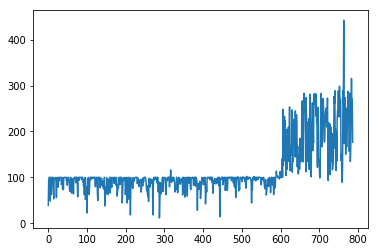

Time elapsed:21132.46958422661
| Reward: 208 | Episode: 787 


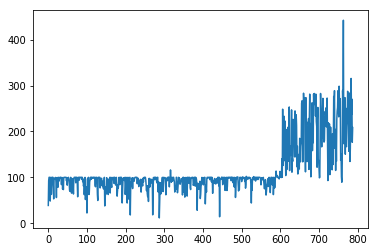

Time elapsed:21163.205743551254
| Reward: 264 | Episode: 788 


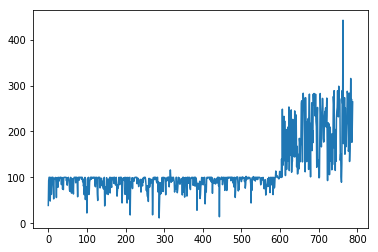

Time elapsed:21193.998148679733
| Reward: 191 | Episode: 789 


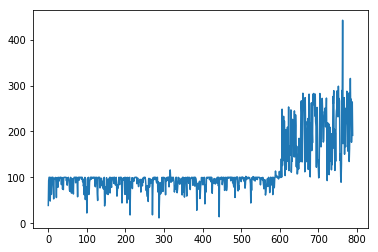

Time elapsed:21224.949762821198
| Reward: 259 | Episode: 790 


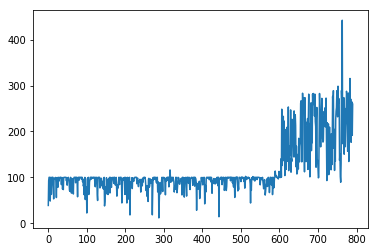

Time elapsed:21255.879724025726
| Reward: 448 | Episode: 791 


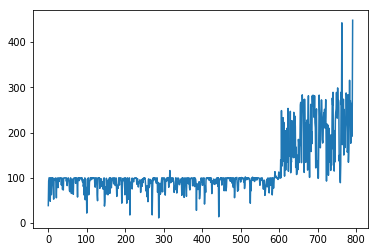

Time elapsed:21287.46950650215
| Reward: 227 | Episode: 792 


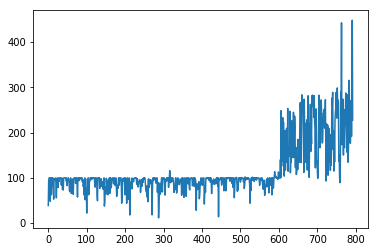

Time elapsed:21318.61348080635
| Reward: 216 | Episode: 793 


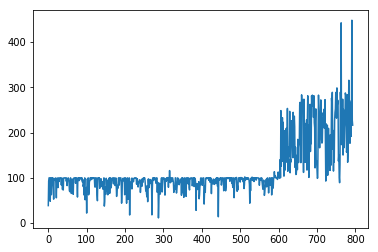

Time elapsed:21350.907004594803
| Reward: 248 | Episode: 794 


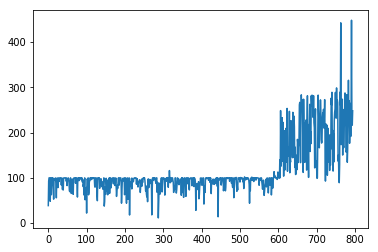

Time elapsed:21382.595438957214
| Reward: 225 | Episode: 795 


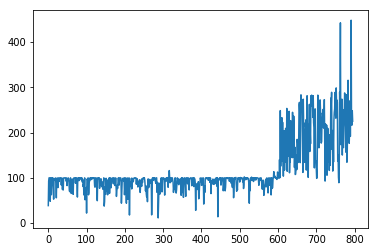

Time elapsed:21413.750693798065
| Reward: 258 | Episode: 796 


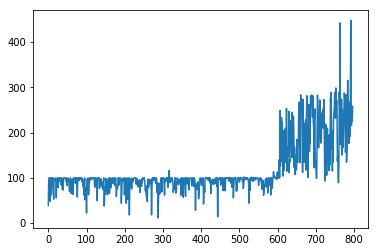

Time elapsed:21445.598757505417
| Reward: 195 | Episode: 797 


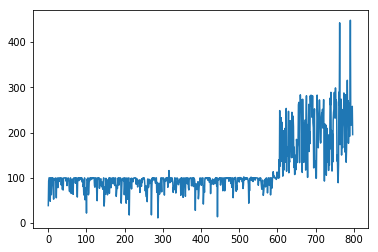

Time elapsed:21477.980098247528
| Reward: 247 | Episode: 798 


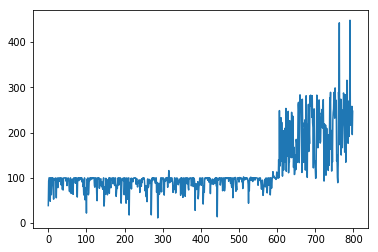

Time elapsed:21509.69767689705
| Reward: 373 | Episode: 799 


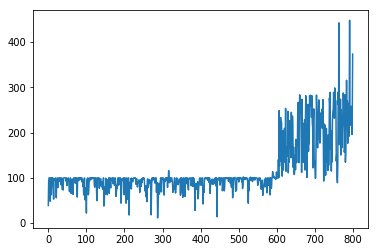

Time elapsed:21541.875511169434
| Reward: 324 | Episode: 800 


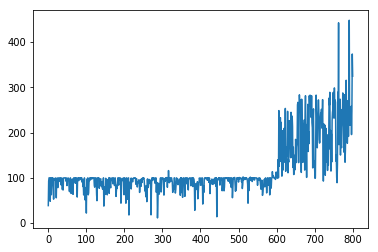

Time elapsed:21574.23227405548
| Reward: 509 | Episode: 801 


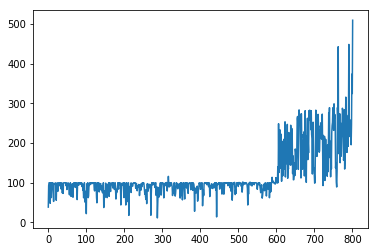

Time elapsed:21606.940440177917
| Reward: 266 | Episode: 802 


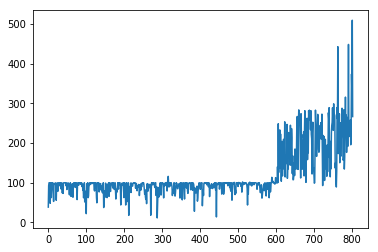

Time elapsed:21639.44196677208
| Reward: 243 | Episode: 803 


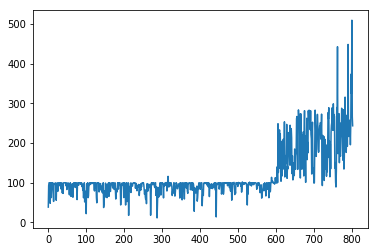

Time elapsed:21671.58328294754
| Reward: 81 | Episode: 804 


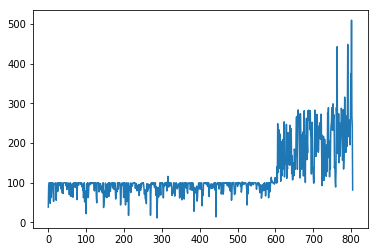

Time elapsed:21703.0772356987
| Reward: 243 | Episode: 805 


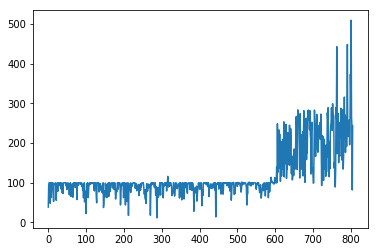

Time elapsed:21734.890773296356
| Reward: 328 | Episode: 806 


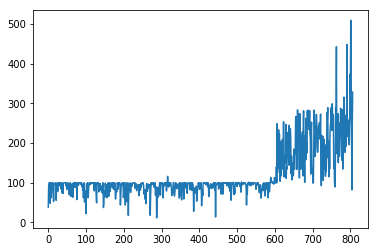

Time elapsed:21766.418709754944
| Reward: 206 | Episode: 807 


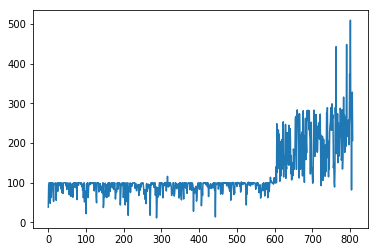

Time elapsed:21798.291574001312
| Reward: 198 | Episode: 808 


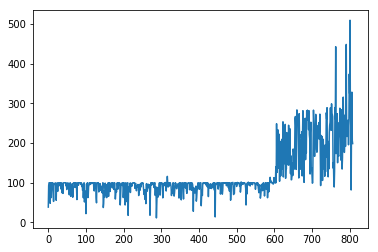

Time elapsed:21830.454896211624
| Reward: 287 | Episode: 809 


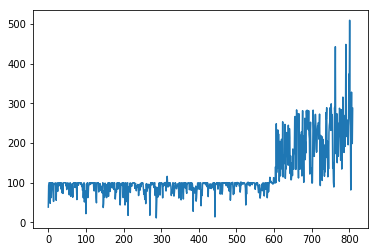

Time elapsed:21861.99116420746
| Reward: 237 | Episode: 810 


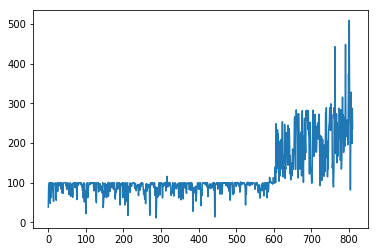

Time elapsed:21894.082158327103
| Reward: 251 | Episode: 811 


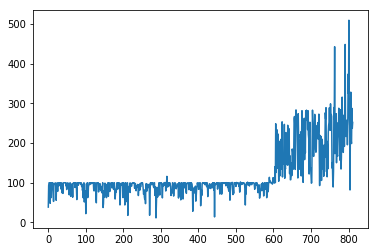

Time elapsed:21925.868568897247
| Reward: 248 | Episode: 812 


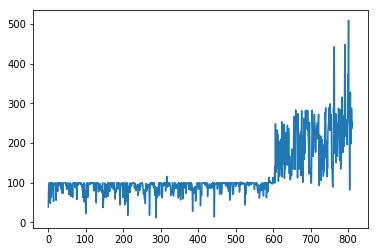

Time elapsed:21957.425009012222
| Reward: 243 | Episode: 813 


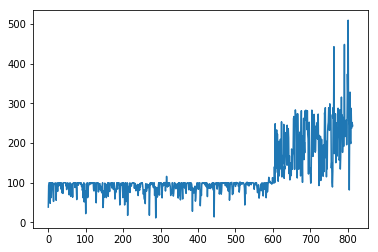

Time elapsed:21988.772075653076
| Reward: 281 | Episode: 814 


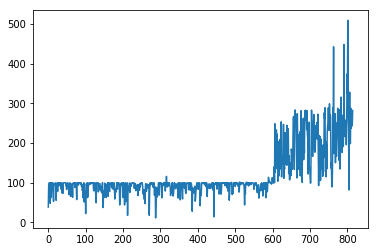

Time elapsed:22020.41409635544
| Reward: 277 | Episode: 815 


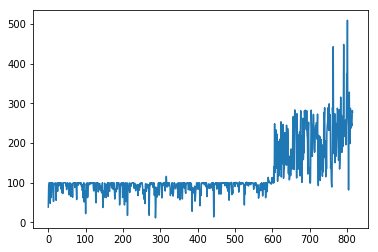

Time elapsed:22052.888926267624
| Reward: 156 | Episode: 816 


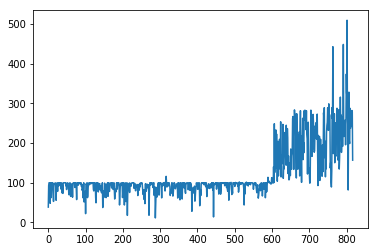

Time elapsed:22085.191452264786
| Reward: 174 | Episode: 817 


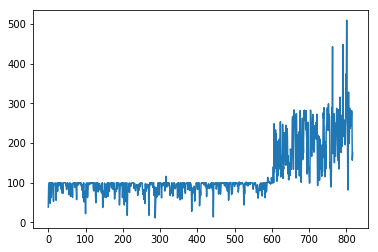

Time elapsed:22117.00076198578
| Reward: 133 | Episode: 818 


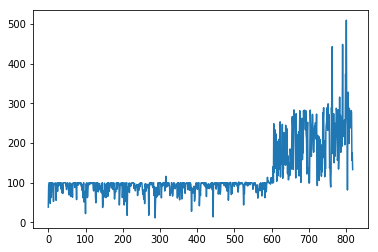

Time elapsed:22149.536324739456
| Reward: 303 | Episode: 819 


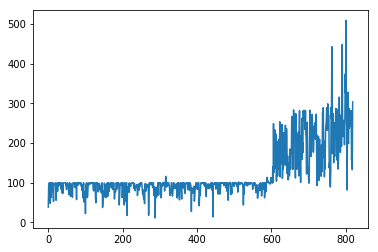

Time elapsed:22181.41387629509
| Reward: 280 | Episode: 820 


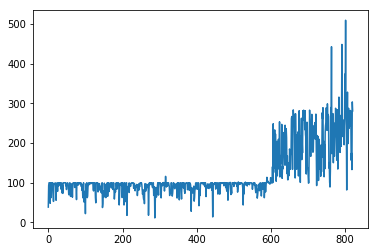

Time elapsed:22213.33176803589
| Reward: 427 | Episode: 821 


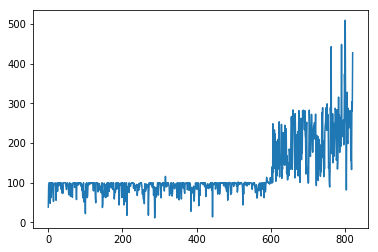

Time elapsed:22244.90434861183
| Reward: 242 | Episode: 822 


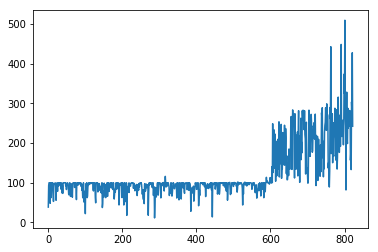

Time elapsed:22276.753711938858
| Reward: 225 | Episode: 823 


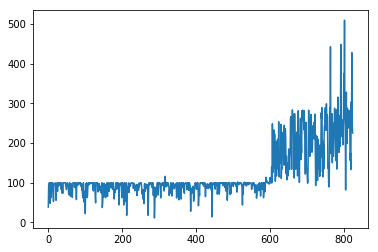

Time elapsed:22309.32667851448
| Reward: 274 | Episode: 824 


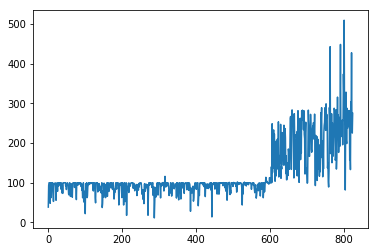

Time elapsed:22341.21902823448
| Reward: 214 | Episode: 825 


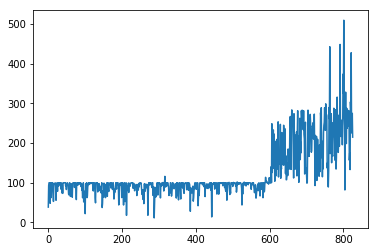

Time elapsed:22373.703137159348
| Reward: 199 | Episode: 826 


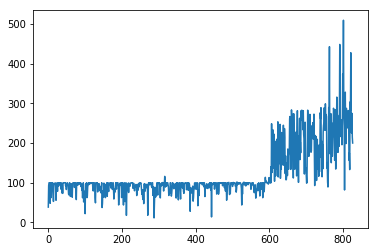

Time elapsed:22405.157681703568
| Reward: 284 | Episode: 827 


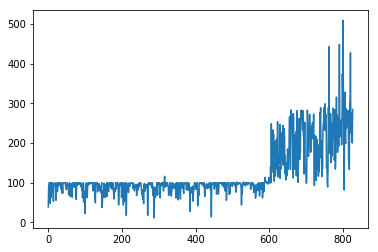

Time elapsed:22436.66169476509
| Reward: 287 | Episode: 828 


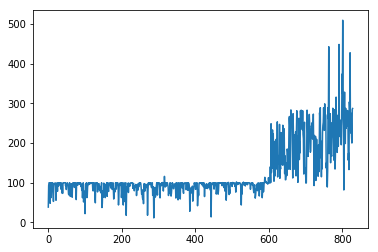

Time elapsed:22467.947812080383
| Reward: 451 | Episode: 829 


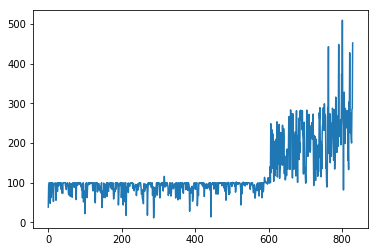

Time elapsed:22499.255766391754
| Reward: 210 | Episode: 830 


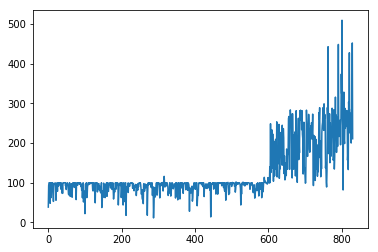

Time elapsed:22531.931771993637
| Reward: 261 | Episode: 831 


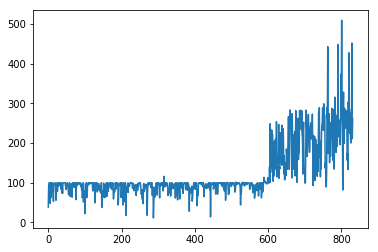

Time elapsed:22564.82170176506
| Reward: 242 | Episode: 832 


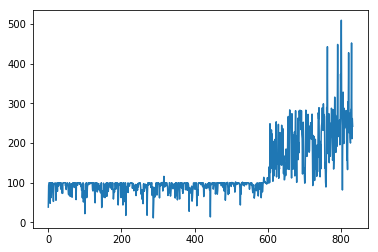

Time elapsed:22596.99926686287
| Reward: 191 | Episode: 833 


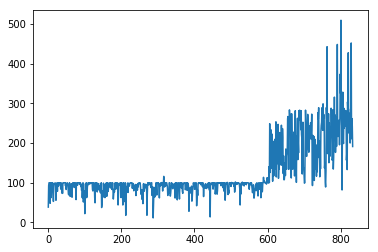

Time elapsed:22629.42985010147
| Reward: 270 | Episode: 834 


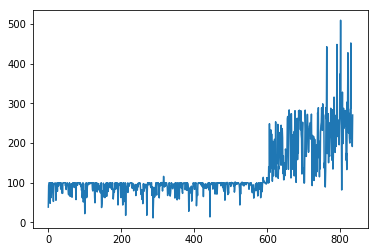

Time elapsed:22661.412301301956
| Reward: 398 | Episode: 835 


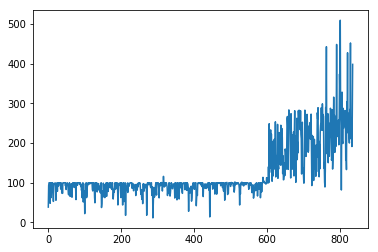

Time elapsed:22693.70968937874
| Reward: 176 | Episode: 836 


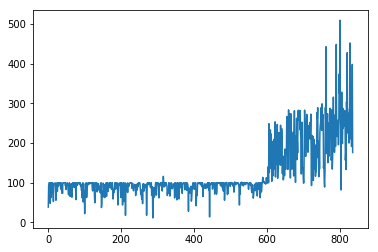

Time elapsed:22726.607375383377
| Reward: 261 | Episode: 837 


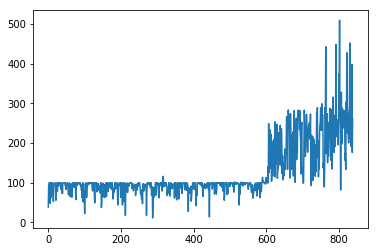

Time elapsed:22758.85315966606
| Reward: 360 | Episode: 838 


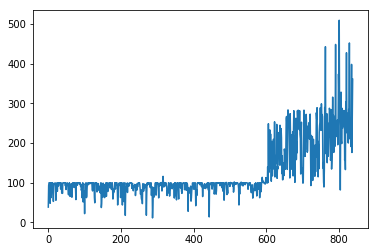

Time elapsed:22792.29654788971
| Reward: 171 | Episode: 839 


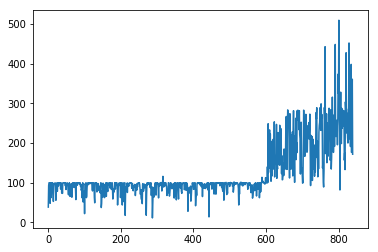

Time elapsed:22824.892681121826
| Reward: 221 | Episode: 840 


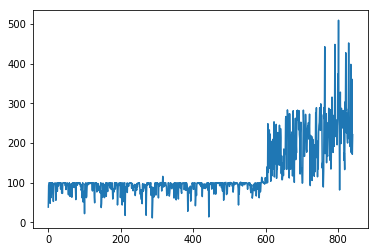

Time elapsed:22857.857872724533
| Reward: 224 | Episode: 841 


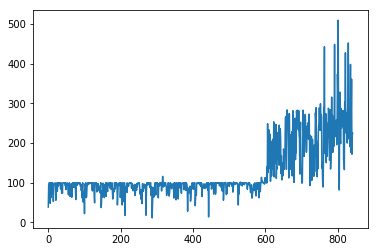

Time elapsed:22889.673330307007
| Reward: 123 | Episode: 842 


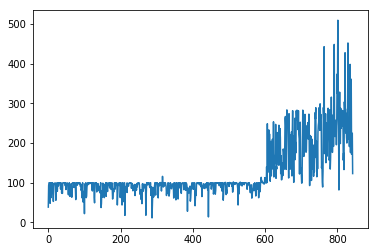

Time elapsed:22923.01674938202
| Reward: 151 | Episode: 843 


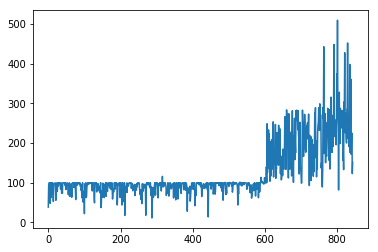

Time elapsed:22955.740142822266
| Reward: 267 | Episode: 844 


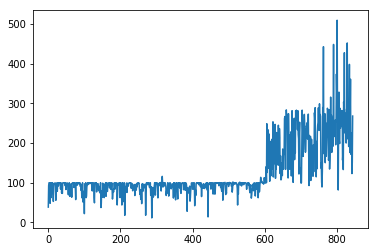

Time elapsed:22987.697059869766
| Reward: 252 | Episode: 845 


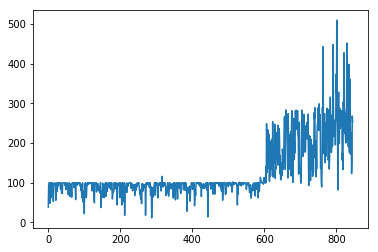

Time elapsed:23019.54758834839
| Reward: 286 | Episode: 846 


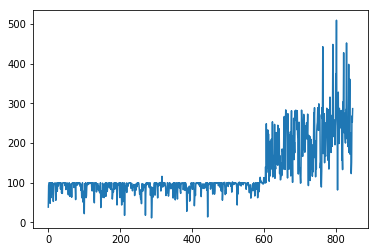

Time elapsed:23051.729938030243
| Reward: 326 | Episode: 847 


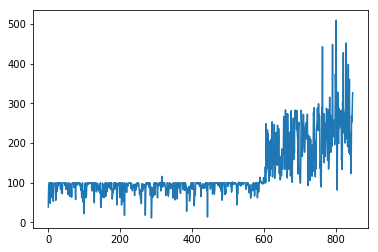

Time elapsed:23084.415709733963
| Reward: 227 | Episode: 848 


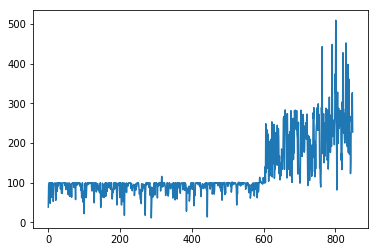

Time elapsed:23117.503291130066
| Reward: 213 | Episode: 849 


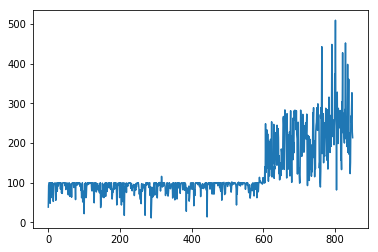

Time elapsed:23149.67911052704
| Reward: 306 | Episode: 850 


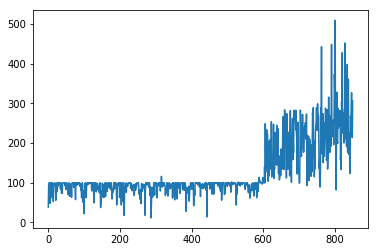

Time elapsed:23181.63642334938
| Reward: 191 | Episode: 851 


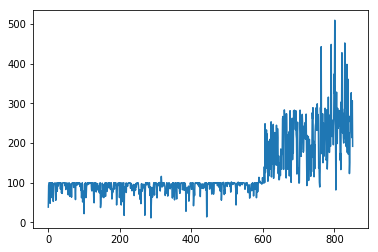

Time elapsed:23215.036971092224
| Reward: 479 | Episode: 852 


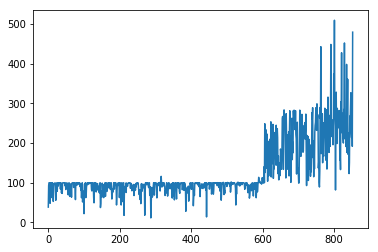

Time elapsed:23247.559087753296
| Reward: 405 | Episode: 853 


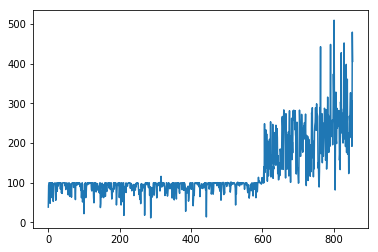

Time elapsed:23281.092125415802
| Reward: 299 | Episode: 854 


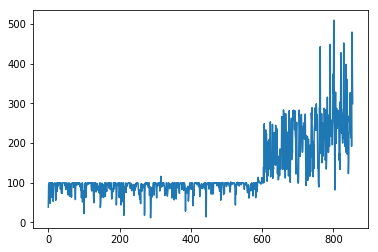

Time elapsed:23313.722911834717
| Reward: 299 | Episode: 855 


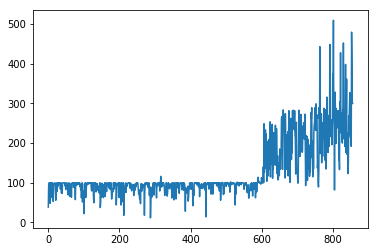

Time elapsed:23345.78228354454
| Reward: 295 | Episode: 856 


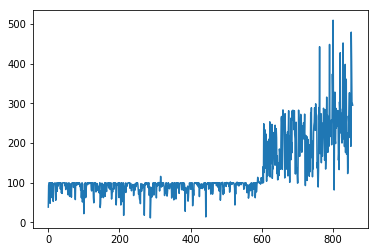

Time elapsed:23378.12785220146
| Reward: 236 | Episode: 857 


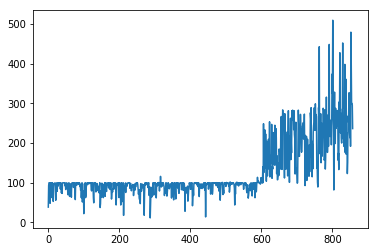

Time elapsed:23410.61123895645
| Reward: 252 | Episode: 858 


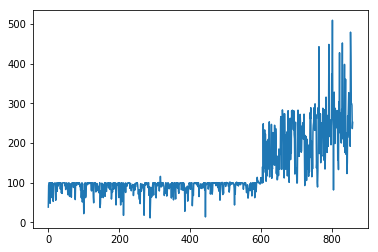

Time elapsed:23443.62048649788
| Reward: 150 | Episode: 859 


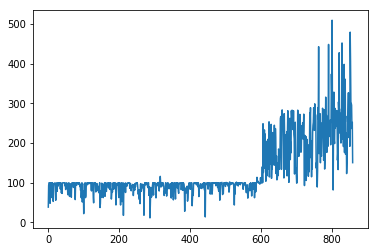

Time elapsed:23476.58042573929
| Reward: 184 | Episode: 860 


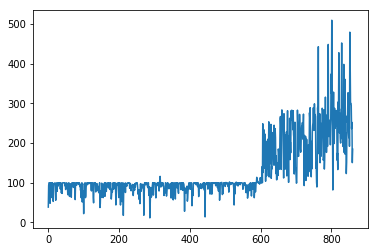

Time elapsed:23508.887502670288
| Reward: 210 | Episode: 861 


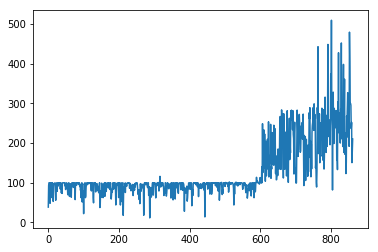

Time elapsed:23541.81080007553
| Reward: 276 | Episode: 862 


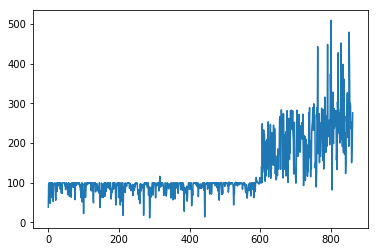

Time elapsed:23574.2141661644
| Reward: 201 | Episode: 863 


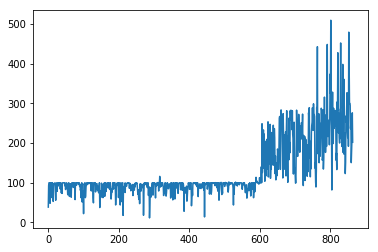

Time elapsed:23606.781821489334
| Reward: 245 | Episode: 864 


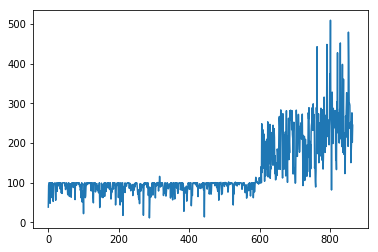

Time elapsed:23640.833551883698
| Reward: 355 | Episode: 865 


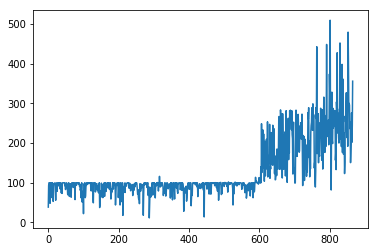

Time elapsed:23674.154059171677
| Reward: 281 | Episode: 866 


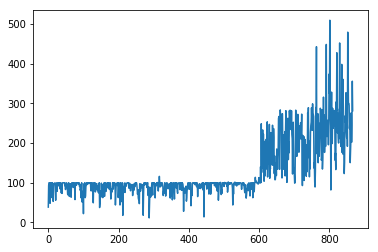

Time elapsed:23707.73626446724
| Reward: 127 | Episode: 867 


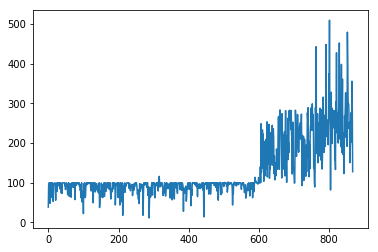

Time elapsed:23740.385384321213
| Reward: 270 | Episode: 868 


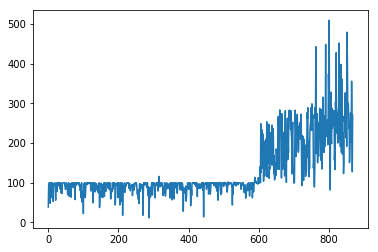

Time elapsed:23773.300810575485
| Reward: 234 | Episode: 869 


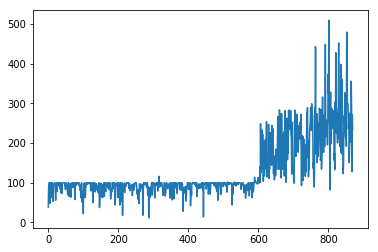

Time elapsed:23806.539706468582
| Reward: 248 | Episode: 870 


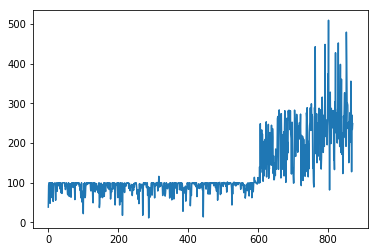

Time elapsed:23840.1527864933
| Reward: 280 | Episode: 871 


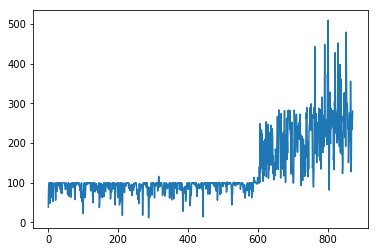

Time elapsed:23873.426525831223
| Reward: 144 | Episode: 872 


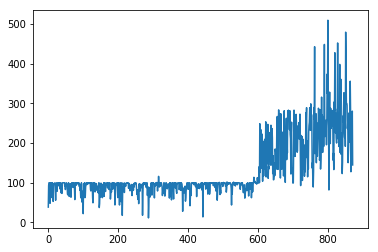

Time elapsed:23906.958534240723
| Reward: 252 | Episode: 873 


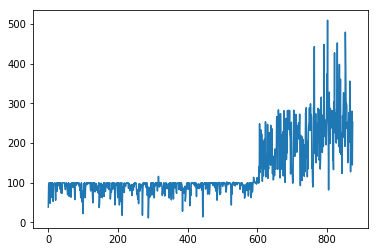

Time elapsed:23939.38078022003
| Reward: 251 | Episode: 874 


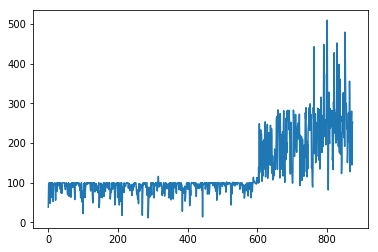

Time elapsed:23972.699785470963
| Reward: 189 | Episode: 875 


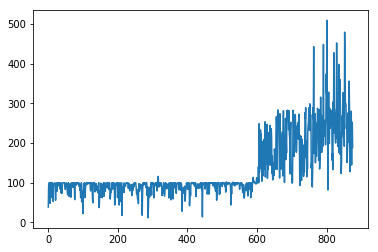

Time elapsed:24005.499870300293
| Reward: 118 | Episode: 876 


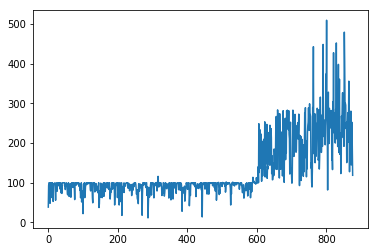

Time elapsed:24038.107810735703
| Reward: 134 | Episode: 877 


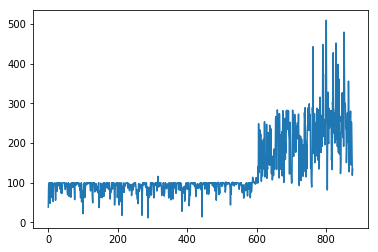

Time elapsed:24070.232794761658
| Reward: 199 | Episode: 878 


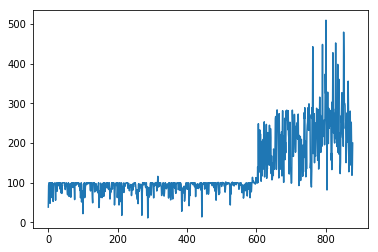

Time elapsed:24102.82744884491
| Reward: 217 | Episode: 879 


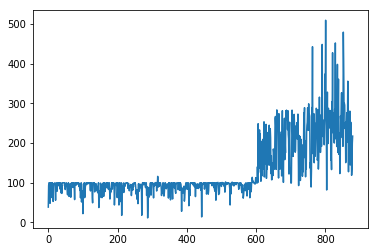

Time elapsed:24135.212245941162
| Reward: 338 | Episode: 880 


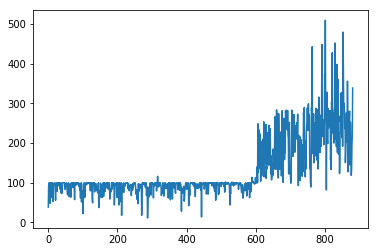

Time elapsed:24167.98061823845
| Reward: 363 | Episode: 881 


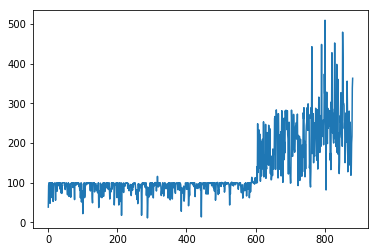

Time elapsed:24200.600717306137
| Reward: 92 | Episode: 882 


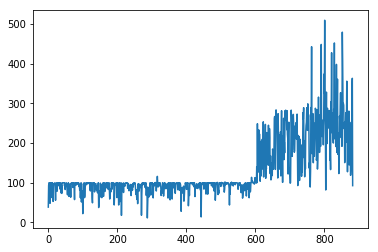

Time elapsed:24233.230520009995
| Reward: 250 | Episode: 883 


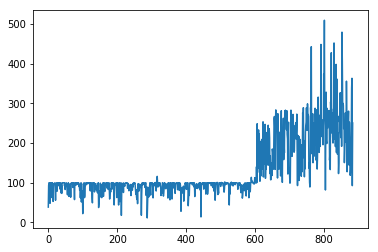

Time elapsed:24265.67066335678
| Reward: 185 | Episode: 884 


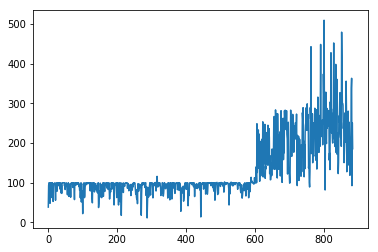

Time elapsed:24298.067778348923
| Reward: 179 | Episode: 885 


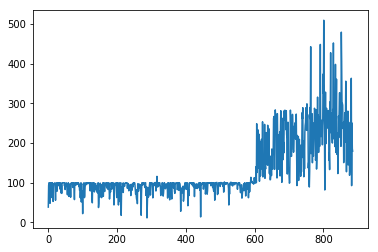

Time elapsed:24330.98969602585
| Reward: 285 | Episode: 886 


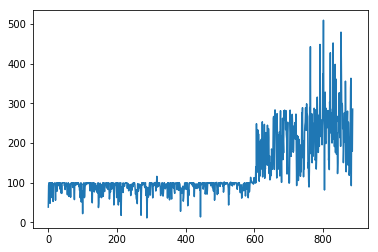

Time elapsed:24364.76900458336
| Reward: 293 | Episode: 887 


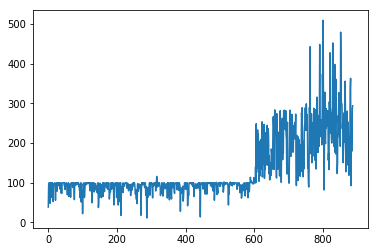

Time elapsed:24398.4835665226
| Reward: 332 | Episode: 888 


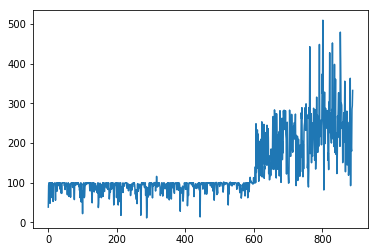

Time elapsed:24432.08745265007
| Reward: 278 | Episode: 889 


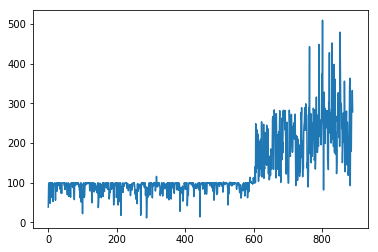

Time elapsed:24465.974570274353
| Reward: 396 | Episode: 890 


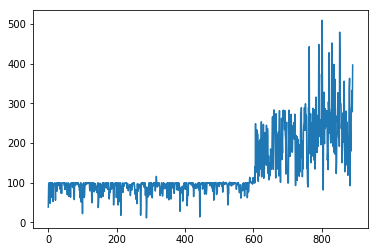

Time elapsed:24500.031801700592
| Reward: 200 | Episode: 891 


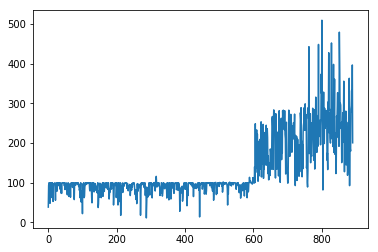

Time elapsed:24533.366655111313
| Reward: 208 | Episode: 892 


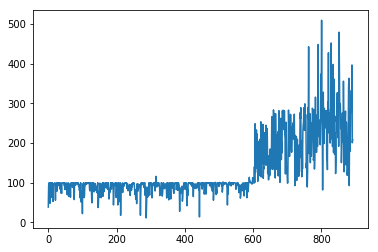

Time elapsed:24566.383754730225
| Reward: 271 | Episode: 893 


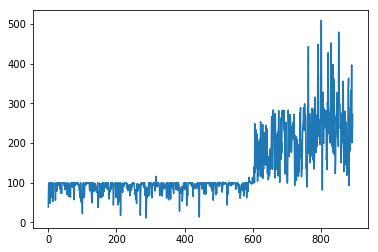

Time elapsed:24599.884201288223
| Reward: 198 | Episode: 894 


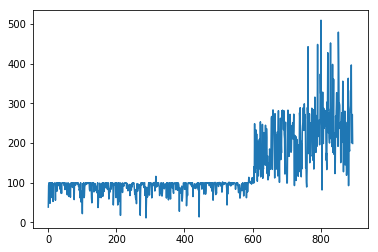

Time elapsed:24632.783796787262
| Reward: 395 | Episode: 895 


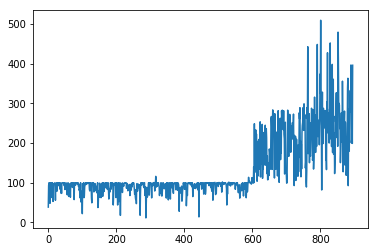

Time elapsed:24665.717322587967
| Reward: 235 | Episode: 896 


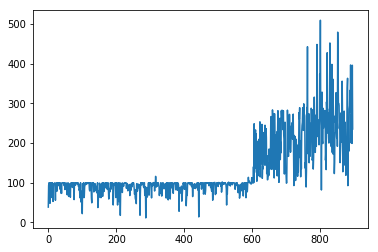

Time elapsed:24698.426953792572
| Reward: 133 | Episode: 897 


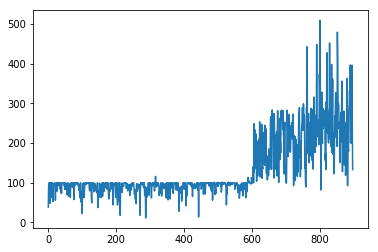

Time elapsed:24732.881237268448
| Reward: 108 | Episode: 898 


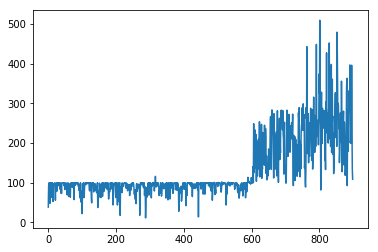

Time elapsed:24766.83513522148
| Reward: 154 | Episode: 899 


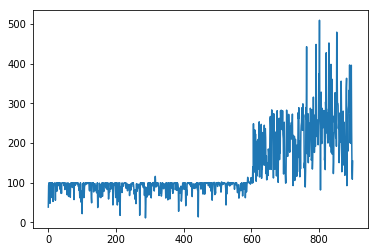

Time elapsed:24799.827257871628
| Reward: 188 | Episode: 900 


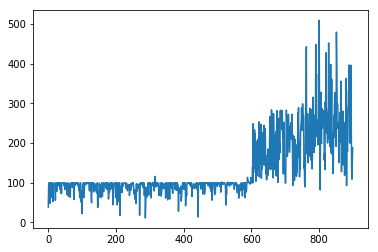

Time elapsed:24834.181854486465
| Reward: 288 | Episode: 901 


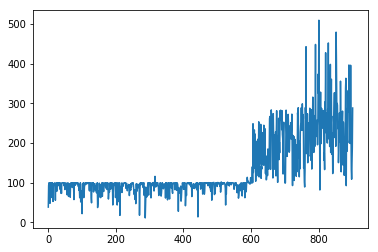

Time elapsed:24866.923362493515
| Reward: 285 | Episode: 902 


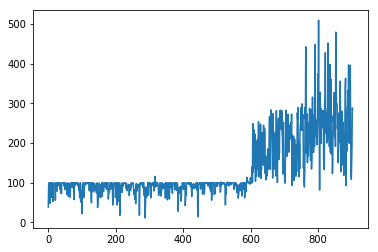

Time elapsed:24899.41379928589
| Reward: 273 | Episode: 903 


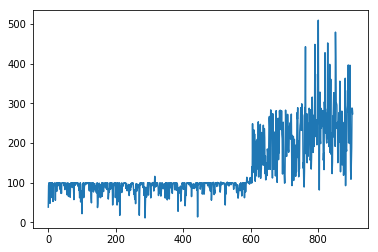

Time elapsed:24931.715288877487
| Reward: 145 | Episode: 904 


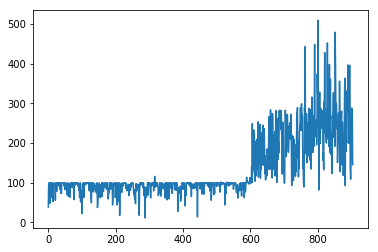

Time elapsed:24964.465098381042
| Reward: 111 | Episode: 905 


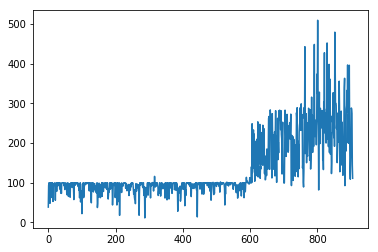

Time elapsed:24997.149426460266
| Reward: 150 | Episode: 906 


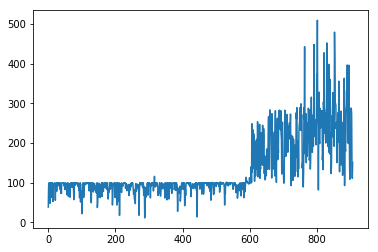

Time elapsed:25029.80350780487
| Reward: 259 | Episode: 907 


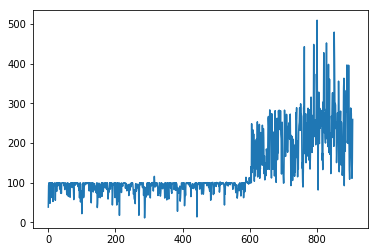

Time elapsed:25062.75765323639
| Reward: 245 | Episode: 908 


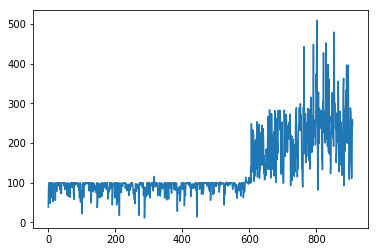

Time elapsed:25096.575328826904
| Reward: 271 | Episode: 909 


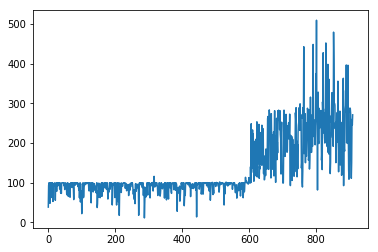

Time elapsed:25130.010859966278
| Reward: 302 | Episode: 910 


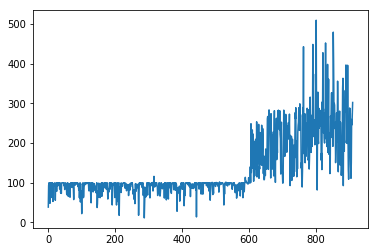

Time elapsed:25162.967497348785
| Reward: 299 | Episode: 911 


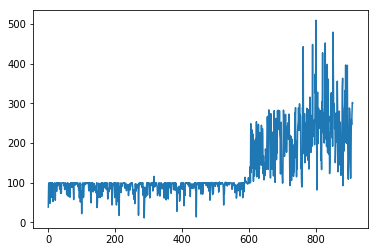

Time elapsed:25196.334599733353
| Reward: 382 | Episode: 912 


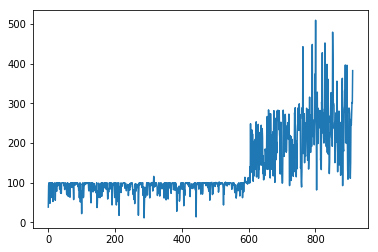

Time elapsed:25229.344294071198
| Reward: 307 | Episode: 913 


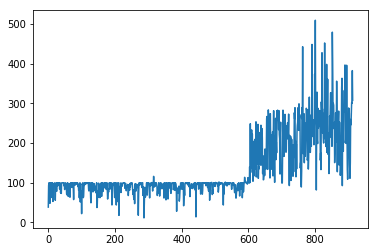

Time elapsed:25262.3634455204
| Reward: 286 | Episode: 914 


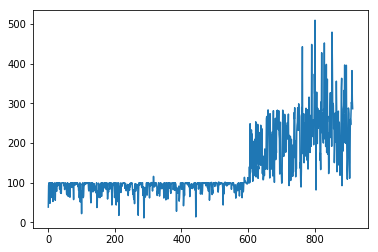

Time elapsed:25295.61878991127
| Reward: 278 | Episode: 915 


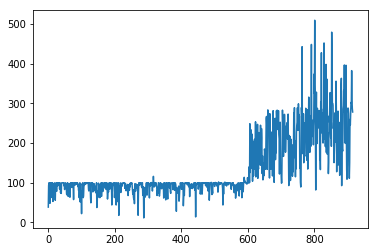

Time elapsed:25329.35282945633
| Reward: 287 | Episode: 916 


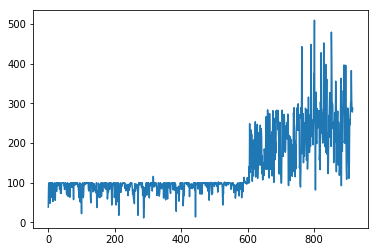

Time elapsed:25363.279378414154
| Reward: 288 | Episode: 917 


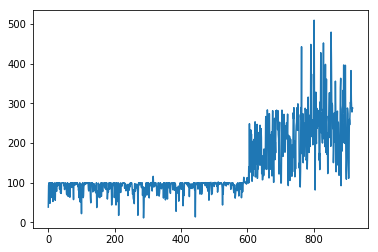

Time elapsed:25397.158399105072
| Reward: 385 | Episode: 918 


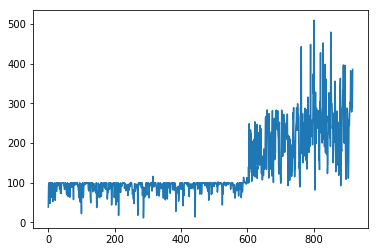

Time elapsed:25431.031686782837
| Reward: 240 | Episode: 919 


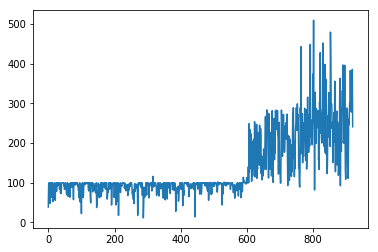

Time elapsed:25464.955929517746
| Reward: 274 | Episode: 920 


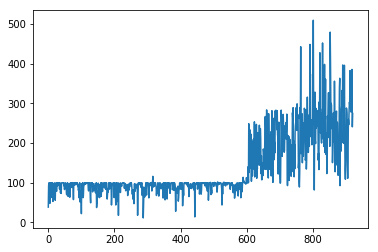

Time elapsed:25499.267194271088
| Reward: 278 | Episode: 921 


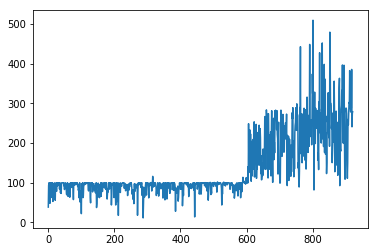

Time elapsed:25533.431972503662
| Reward: 391 | Episode: 922 


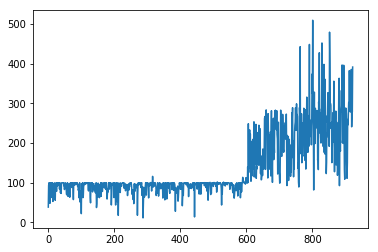

Time elapsed:25566.819425344467
| Reward: 230 | Episode: 923 


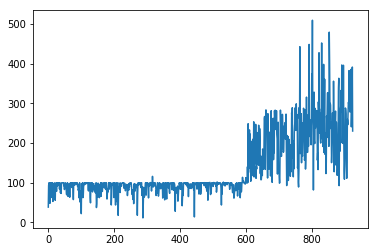

Time elapsed:25600.257214069366
| Reward: 195 | Episode: 924 


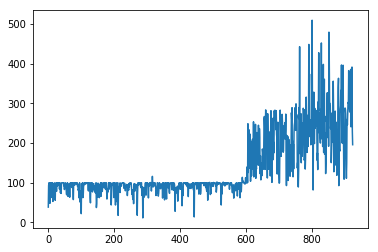

Time elapsed:25633.4542927742
| Reward: 465 | Episode: 925 


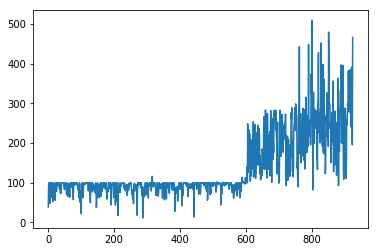

Time elapsed:25666.677305459976
| Reward: 341 | Episode: 926 


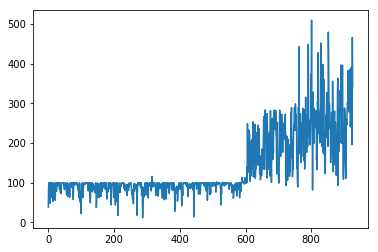

Time elapsed:25700.87145137787
| Reward: 264 | Episode: 927 


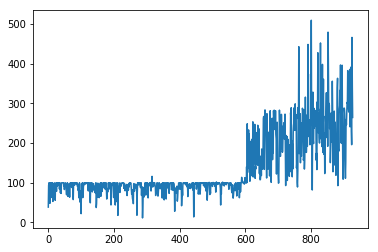

Time elapsed:25735.00903391838
| Reward: 88 | Episode: 928 


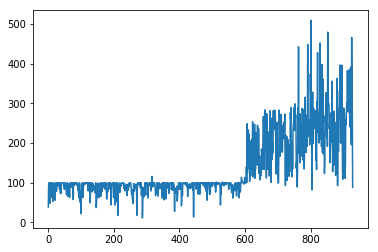

Time elapsed:25769.019875764847
| Reward: 97 | Episode: 929 


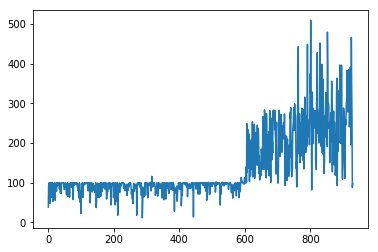

Time elapsed:25803.67519903183
| Reward: 257 | Episode: 930 


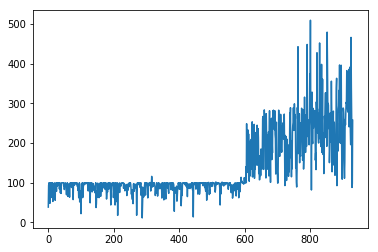

Time elapsed:25837.6425511837
| Reward: 195 | Episode: 931 


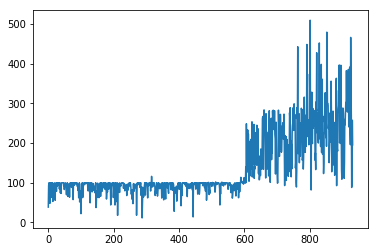

Time elapsed:25871.57275533676
| Reward: 208 | Episode: 932 


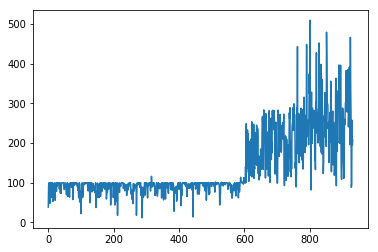

Time elapsed:25906.05133342743
| Reward: 239 | Episode: 933 


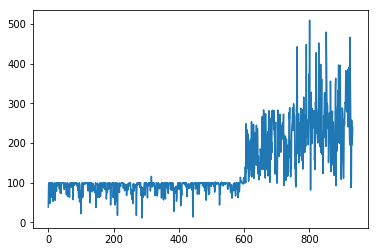

Time elapsed:25939.7320227623
| Reward: 235 | Episode: 934 


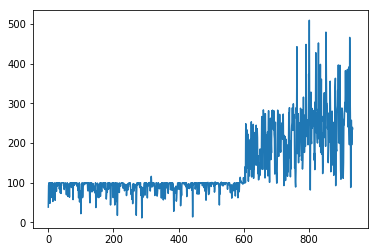

Time elapsed:25974.18425798416
| Reward: 213 | Episode: 935 


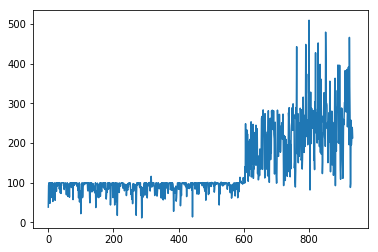

Time elapsed:26008.92332839966
| Reward: 413 | Episode: 936 


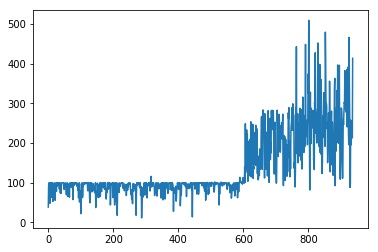

Time elapsed:26044.00764465332
| Reward: 563 | Episode: 937 


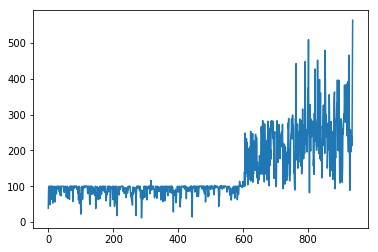

Time elapsed:26078.612647294998
| Reward: 264 | Episode: 938 


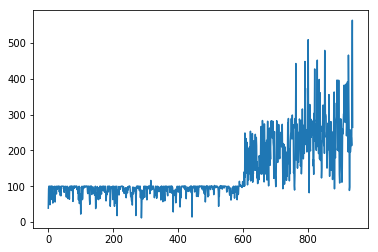

Time elapsed:26112.423632621765
| Reward: 219 | Episode: 939 


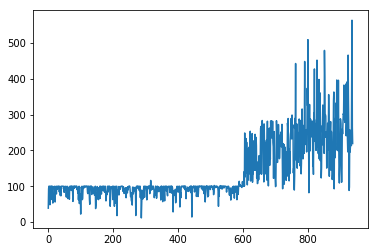

Time elapsed:26146.4061126709
| Reward: 153 | Episode: 940 


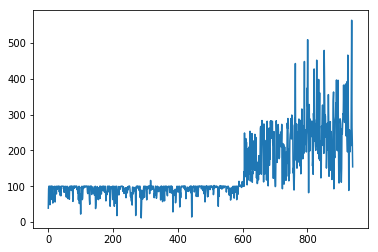

Time elapsed:26180.385796546936
| Reward: 215 | Episode: 941 


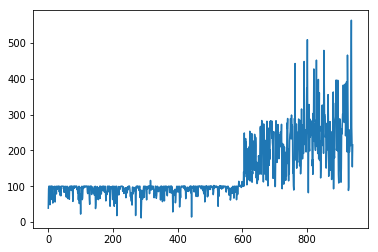

Time elapsed:26214.345868587494
| Reward: 239 | Episode: 942 


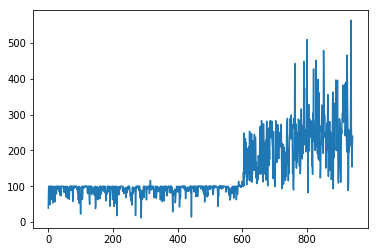

Time elapsed:26247.422609567642
| Reward: 216 | Episode: 943 


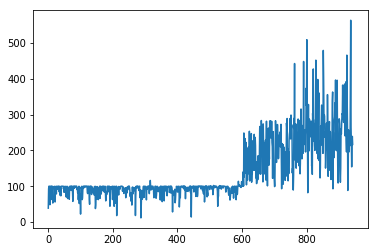

Time elapsed:26282.55875992775
| Reward: 143 | Episode: 944 


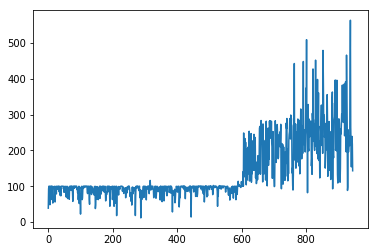

Time elapsed:26316.653853416443
| Reward: 228 | Episode: 945 


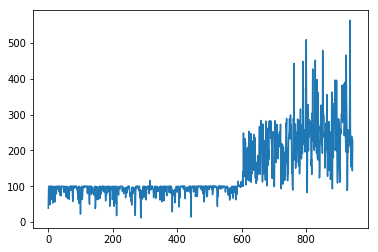

Time elapsed:26351.247957229614
| Reward: 368 | Episode: 946 


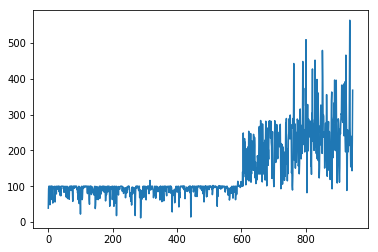

Time elapsed:26384.887674808502
| Reward: 253 | Episode: 947 


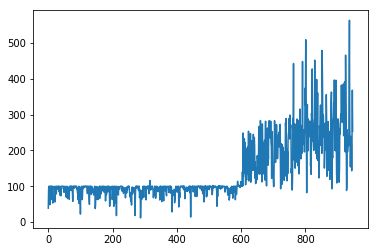

Time elapsed:26418.517793893814
| Reward: 170 | Episode: 948 


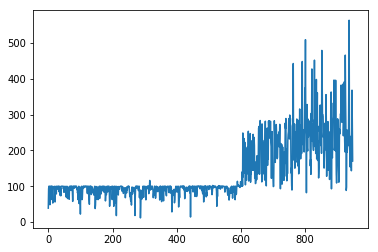

Time elapsed:26452.24534368515
| Reward: 190 | Episode: 949 


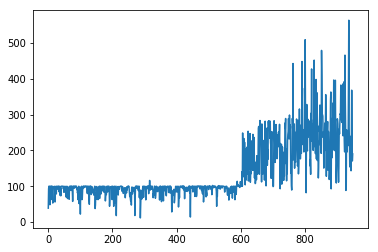

Time elapsed:26486.19454407692
| Reward: 185 | Episode: 950 


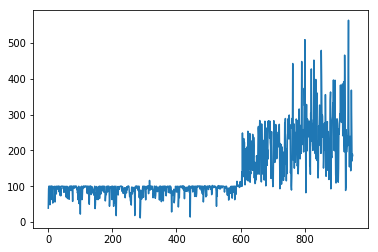

Time elapsed:26521.279866933823
| Reward: 186 | Episode: 951 


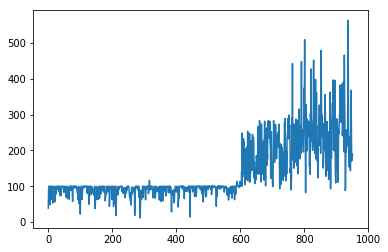

Time elapsed:26554.680597305298
| Reward: 179 | Episode: 952 


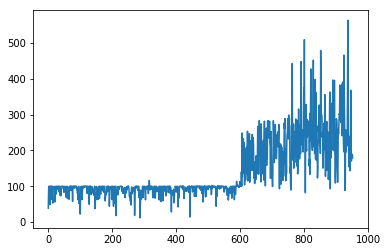

Time elapsed:26588.069878339767
| Reward: 351 | Episode: 953 


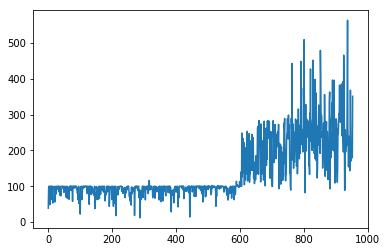

Time elapsed:26621.688749313354
| Reward: 170 | Episode: 954 


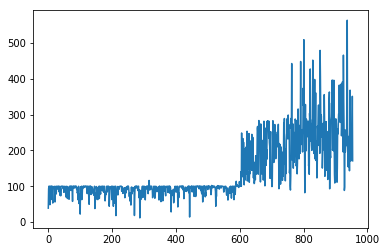

Time elapsed:26655.109679698944
| Reward: 183 | Episode: 955 


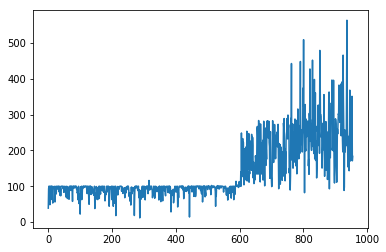

Time elapsed:26688.876159906387
| Reward: 211 | Episode: 956 


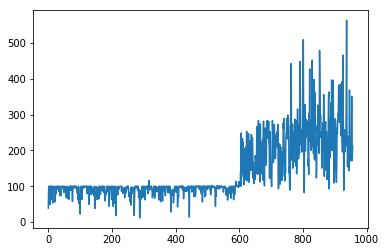

Time elapsed:26722.766861200333
| Reward: 116 | Episode: 957 


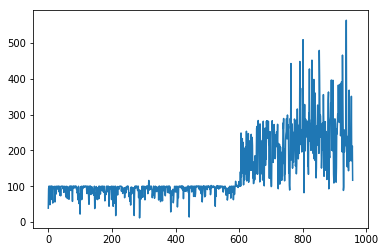

Time elapsed:26756.56058382988
| Reward: 122 | Episode: 958 


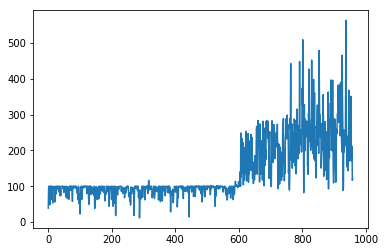

Time elapsed:26790.162121772766
| Reward: 196 | Episode: 959 


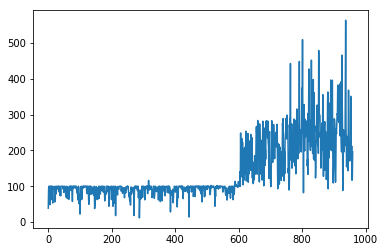

Time elapsed:26824.715767383575
| Reward: 248 | Episode: 960 


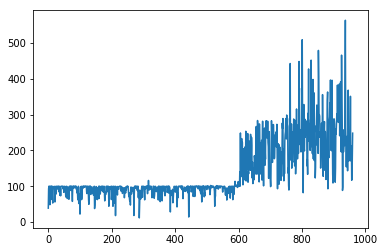

Time elapsed:26859.355204105377
| Reward: 239 | Episode: 961 


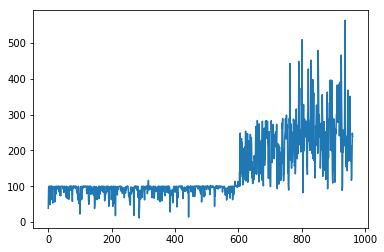

Time elapsed:26894.380258321762
| Reward: 254 | Episode: 962 


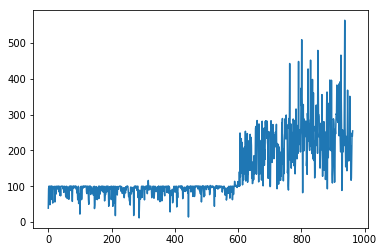

Time elapsed:26929.486647367477
| Reward: 217 | Episode: 963 


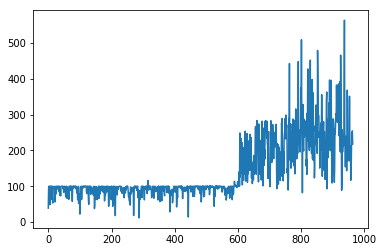

Time elapsed:26964.457785844803
| Reward: 298 | Episode: 964 


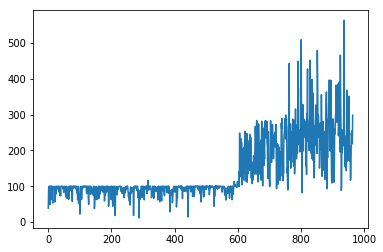

Time elapsed:26999.433931589127
| Reward: 322 | Episode: 965 


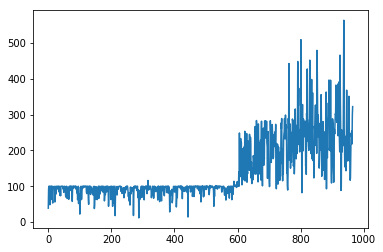

Time elapsed:27033.40528512001
| Reward: 289 | Episode: 966 


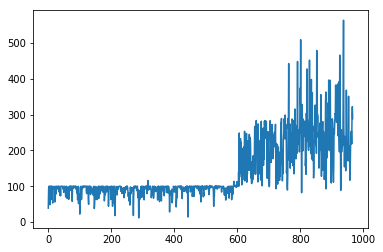

Time elapsed:27067.92529320717
| Reward: 323 | Episode: 967 


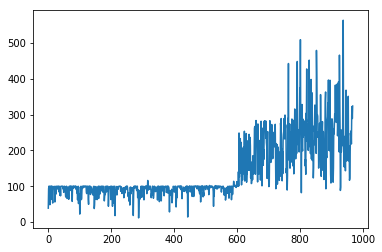

Time elapsed:27102.708797693253
| Reward: 263 | Episode: 968 


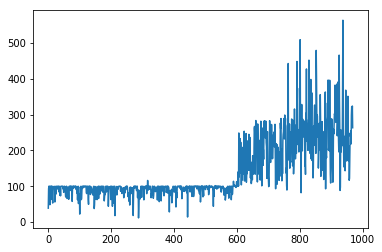

Time elapsed:27137.60738492012
| Reward: 233 | Episode: 969 


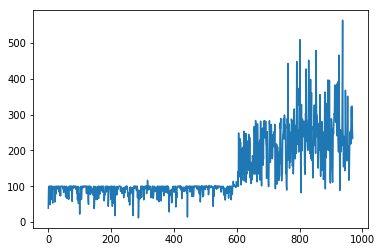

Time elapsed:27172.9227912426
| Reward: 342 | Episode: 970 


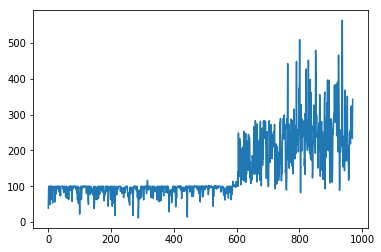

Time elapsed:27207.838010787964
| Reward: 278 | Episode: 971 


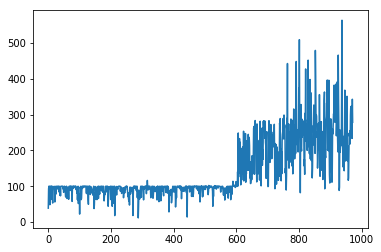

Time elapsed:27243.120205640793
| Reward: 166 | Episode: 972 


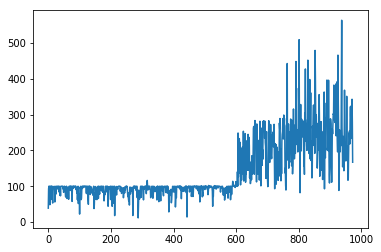

Time elapsed:27276.84060573578
| Reward: 225 | Episode: 973 


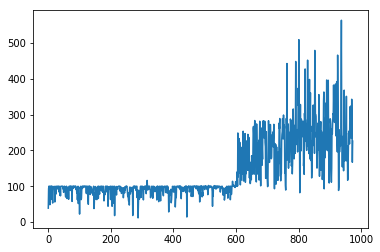

Time elapsed:27311.258224010468
| Reward: 251 | Episode: 974 


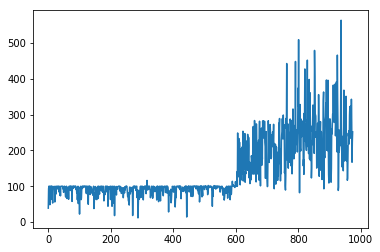

Time elapsed:27345.96359705925
| Reward: 261 | Episode: 975 


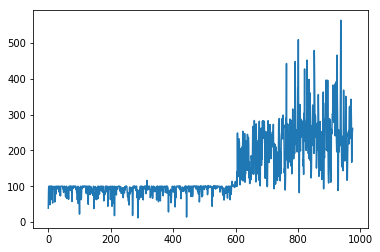

Time elapsed:27379.80957055092
| Reward: 303 | Episode: 976 


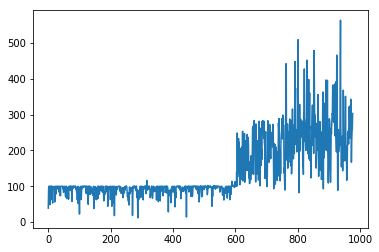

Time elapsed:27414.376308918
| Reward: 229 | Episode: 977 


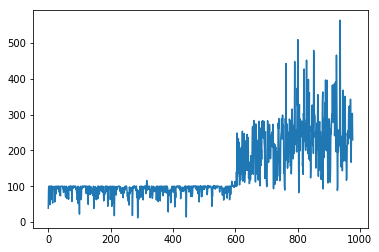

Time elapsed:27448.951598882675
| Reward: 258 | Episode: 978 


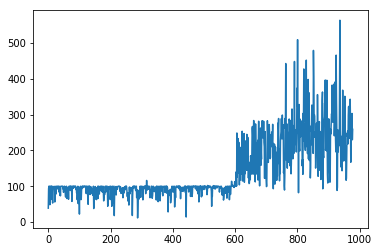

Time elapsed:27483.491567611694
| Reward: 367 | Episode: 979 


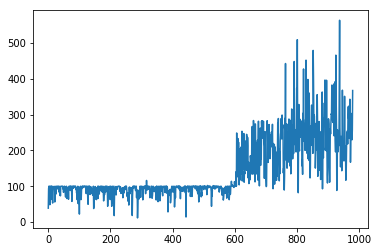

Time elapsed:27517.588720560074
| Reward: 270 | Episode: 980 


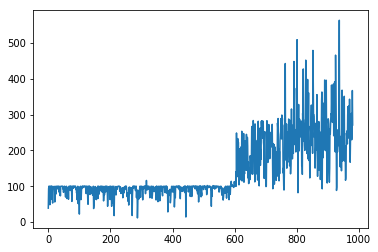

Time elapsed:27552.178446531296
| Reward: 271 | Episode: 981 


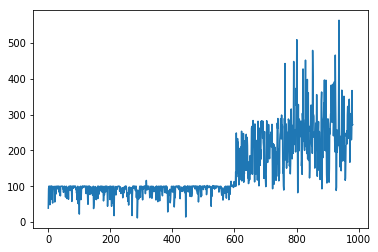

Time elapsed:27586.961242198944
| Reward: 165 | Episode: 982 


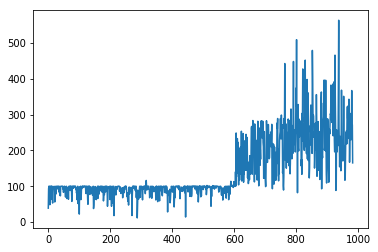

Time elapsed:27622.748084783554
| Reward: 243 | Episode: 983 


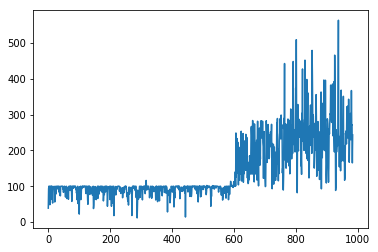

Time elapsed:27658.23608493805
| Reward: 226 | Episode: 984 


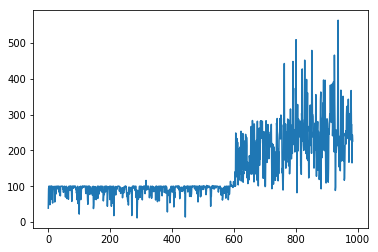

Time elapsed:27693.691618919373
| Reward: 236 | Episode: 985 


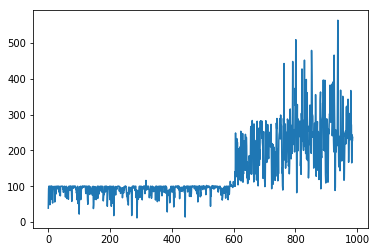

Time elapsed:27728.76967024803
| Reward: 118 | Episode: 986 


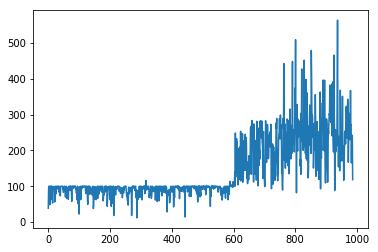

Time elapsed:27764.355564832687
| Reward: 166 | Episode: 987 


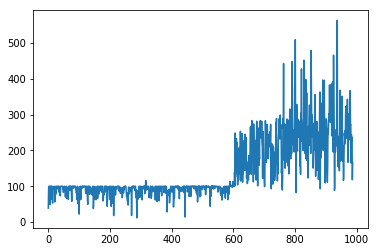

Time elapsed:27799.884659290314
| Reward: 230 | Episode: 988 


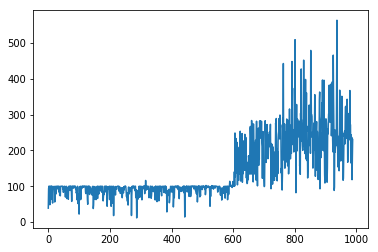

Time elapsed:27835.69525051117
| Reward: 220 | Episode: 989 


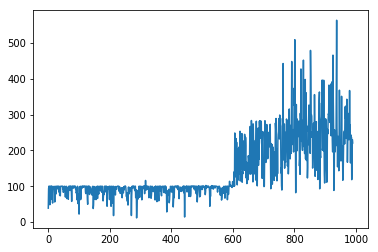

Time elapsed:27870.577419281006
| Reward: 231 | Episode: 990 


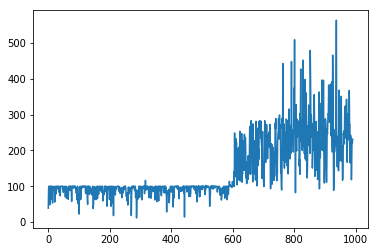

Time elapsed:27904.667531251907
| Reward: 211 | Episode: 991 


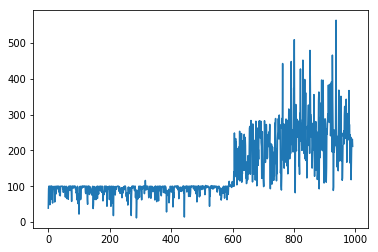

Time elapsed:27940.181715011597
| Reward: 347 | Episode: 992 


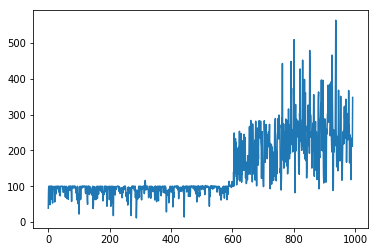

Time elapsed:27975.48853993416
| Reward: 179 | Episode: 993 


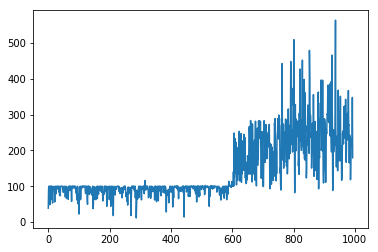

Time elapsed:28010.76953482628
| Reward: 256 | Episode: 994 


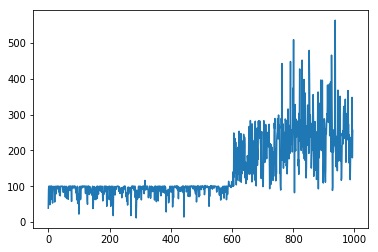

Time elapsed:28045.12380552292
| Reward: 218 | Episode: 995 


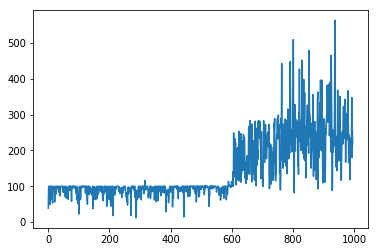

Time elapsed:28079.352084875107
| Reward: 171 | Episode: 996 


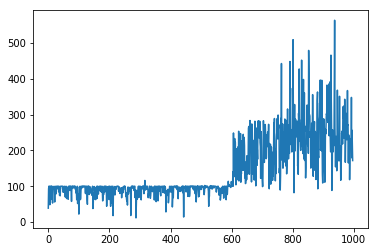

Time elapsed:28114.030523777008
| Reward: 435 | Episode: 997 


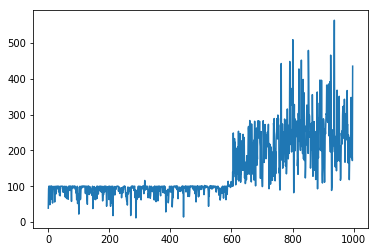

Time elapsed:28148.968537330627
| Reward: 237 | Episode: 998 


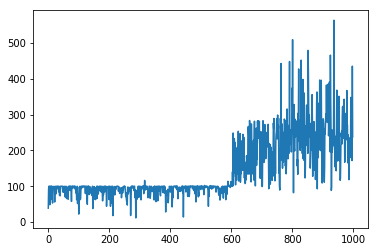

Time elapsed:28183.67648100853
| Reward: 233 | Episode: 999 


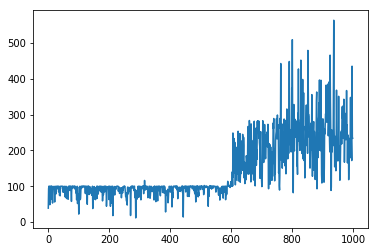

Time elapsed:28218.97499847412
| Reward: 353 | Episode: 1000 


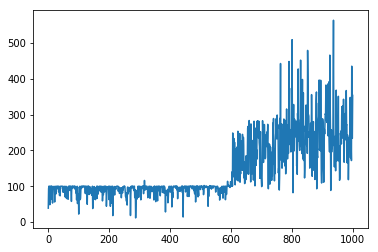

Time elapsed:28254.164688825607
| Reward: 313 | Episode: 1001 


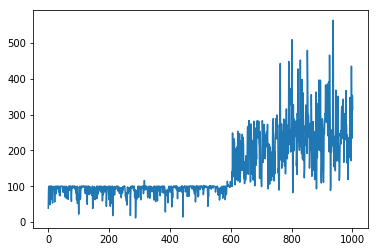

Time elapsed:28289.3874065876
| Reward: 327 | Episode: 1002 


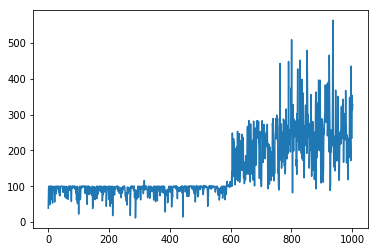

Time elapsed:28325.072315454483
| Reward: 220 | Episode: 1003 


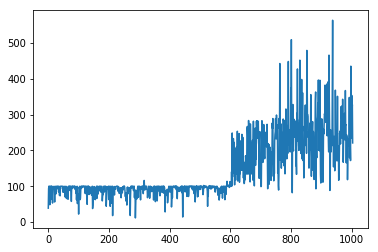

Time elapsed:28360.527626991272
| Reward: 287 | Episode: 1004 


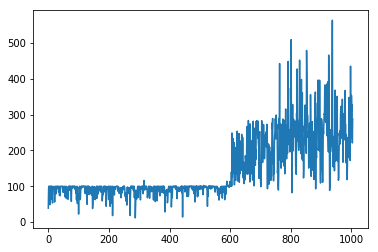

Time elapsed:28395.92598772049
| Reward: 369 | Episode: 1005 


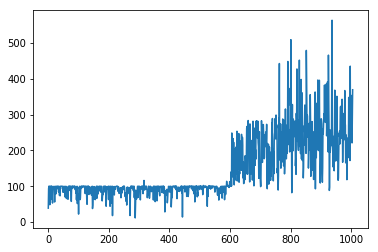

Time elapsed:28432.040309667587
| Reward: 255 | Episode: 1006 


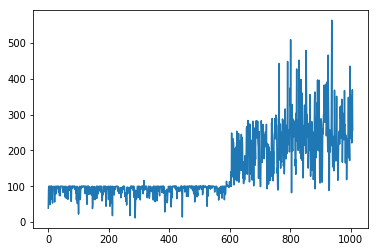

Time elapsed:28467.982527256012
| Reward: 251 | Episode: 1007 


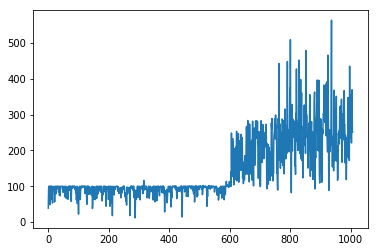

Time elapsed:28503.140221118927
| Reward: 327 | Episode: 1008 


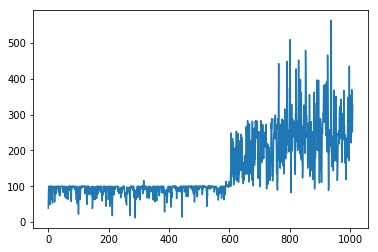

Time elapsed:28538.365933418274
| Reward: 295 | Episode: 1009 


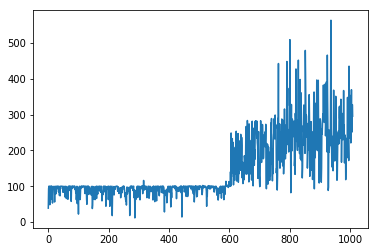

Time elapsed:28573.7256360054
| Reward: 123 | Episode: 1010 


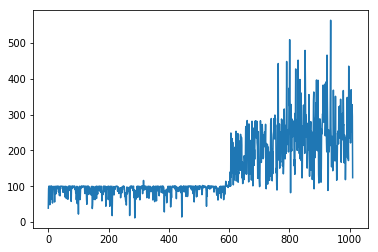

Time elapsed:28609.175396203995
| Reward: 242 | Episode: 1011 


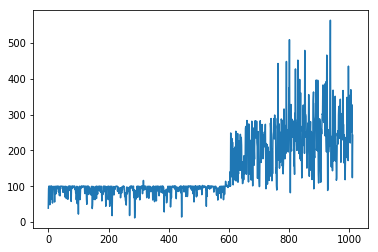

Time elapsed:28644.976470947266
| Reward: 236 | Episode: 1012 


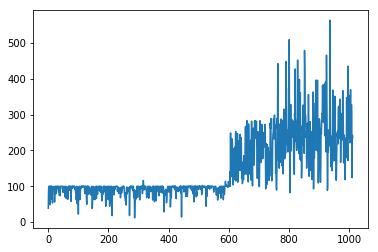

Time elapsed:28680.869769334793
| Reward: 191 | Episode: 1013 


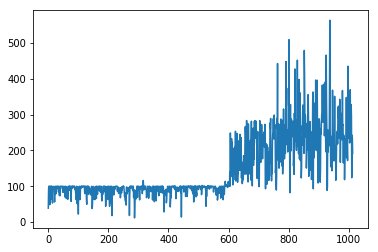

Time elapsed:28716.74509048462
| Reward: 312 | Episode: 1014 


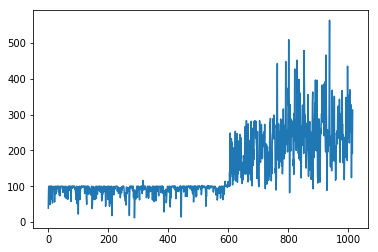

Time elapsed:28752.737239837646
| Reward: 305 | Episode: 1015 


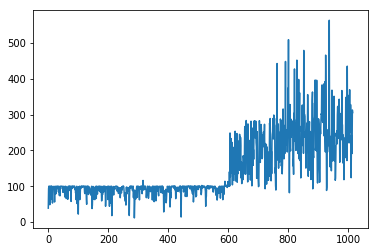

Time elapsed:28788.508115768433
| Reward: 251 | Episode: 1016 


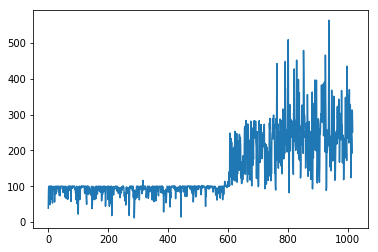

Time elapsed:28824.596529960632
| Reward: 252 | Episode: 1017 


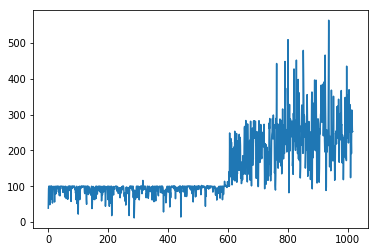

Time elapsed:28860.242699623108
| Reward: 232 | Episode: 1018 


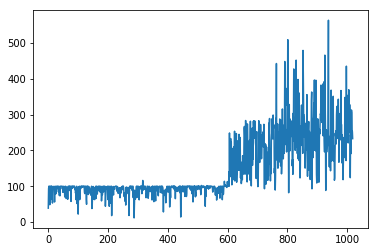

Time elapsed:28895.5352602005
| Reward: 619 | Episode: 1019 


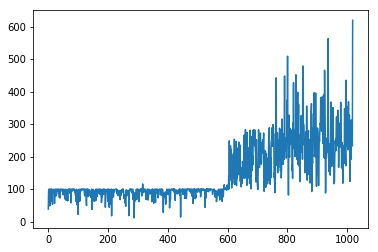

Time elapsed:28929.94548869133
| Reward: 160 | Episode: 1020 


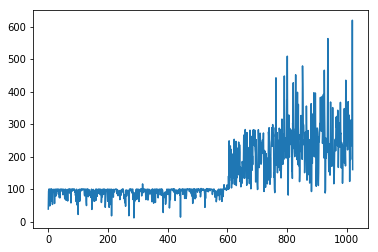

Time elapsed:28964.303265094757
| Reward: 276 | Episode: 1021 


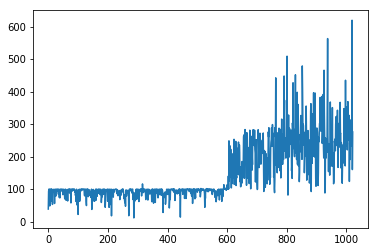

Time elapsed:28999.33337688446
| Reward: 171 | Episode: 1022 


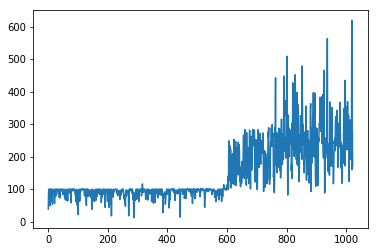

Time elapsed:29034.47221684456
| Reward: 252 | Episode: 1023 


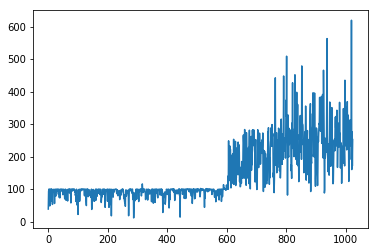

Time elapsed:29069.981367349625
| Reward: 232 | Episode: 1024 


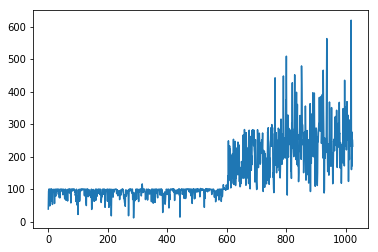

Time elapsed:29105.012186288834
| Reward: 152 | Episode: 1025 


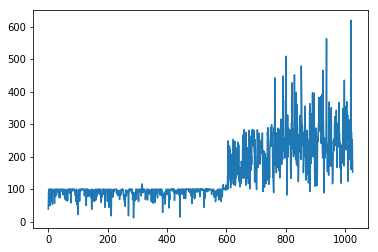

Time elapsed:29140.12571167946
| Reward: 105 | Episode: 1026 


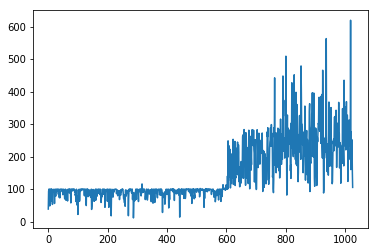

Time elapsed:29175.99216413498
| Reward: 119 | Episode: 1027 


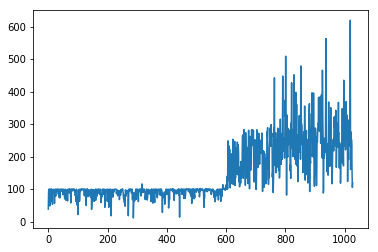

Time elapsed:29210.94711780548
| Reward: 267 | Episode: 1028 


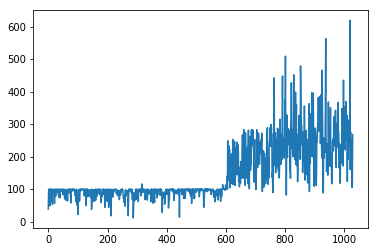

Time elapsed:29246.774559259415
| Reward: 354 | Episode: 1029 


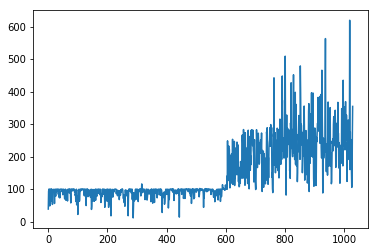

Time elapsed:29282.58471751213
| Reward: 338 | Episode: 1030 


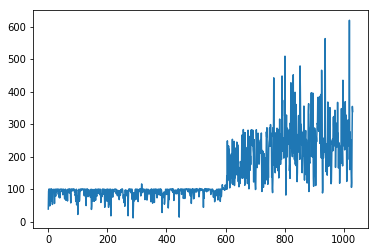

Time elapsed:29318.228207588196
| Reward: 181 | Episode: 1031 


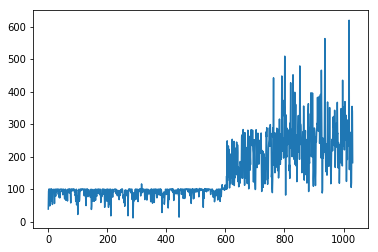

Time elapsed:29353.81805038452
| Reward: 185 | Episode: 1032 


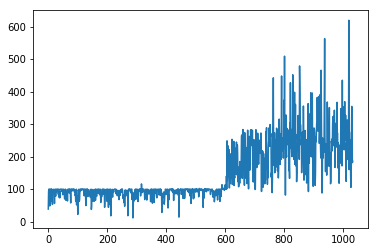

Time elapsed:29389.90580677986
| Reward: 233 | Episode: 1033 


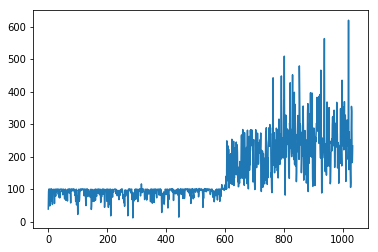

Time elapsed:29425.412588596344
| Reward: 287 | Episode: 1034 


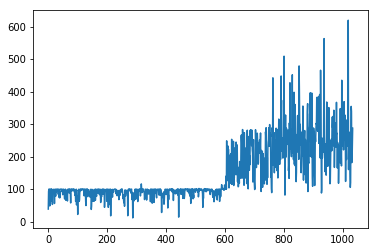

Time elapsed:29461.10925102234
| Reward: 335 | Episode: 1035 


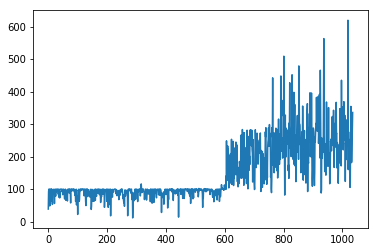

Time elapsed:29496.757253170013
| Reward: 281 | Episode: 1036 


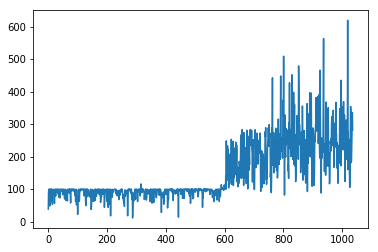

Time elapsed:29532.657654047012
| Reward: 319 | Episode: 1037 


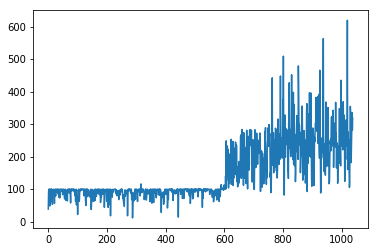

Time elapsed:29567.94559597969
| Reward: 398 | Episode: 1038 


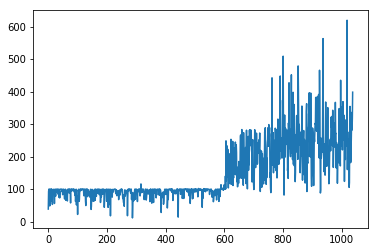

Time elapsed:29603.771210432053
| Reward: 205 | Episode: 1039 


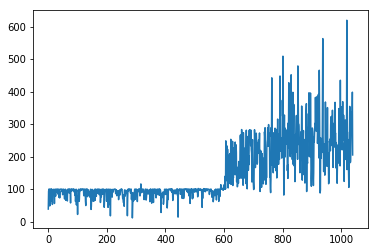

Time elapsed:29639.62934923172
| Reward: 138 | Episode: 1040 


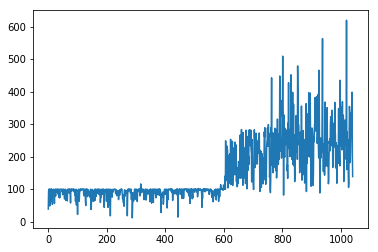

Time elapsed:29675.291503429413
| Reward: 191 | Episode: 1041 


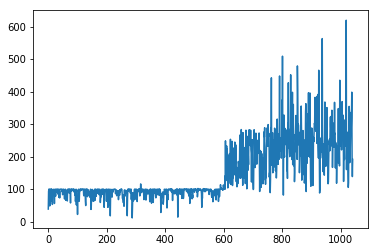

Time elapsed:29710.57852268219
| Reward: 164 | Episode: 1042 


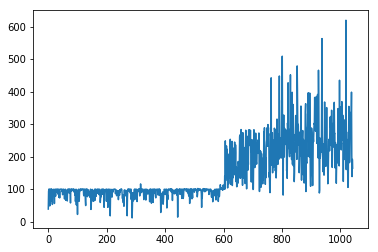

Time elapsed:29745.381519794464
| Reward: 97 | Episode: 1043 


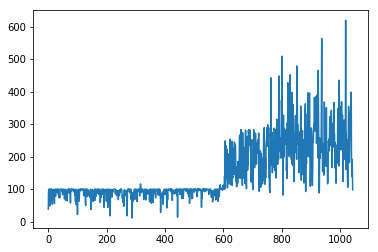

Time elapsed:29780.718707084656
| Reward: 117 | Episode: 1044 


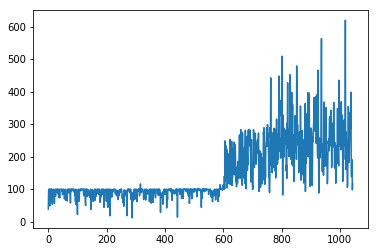

Time elapsed:29815.40778851509
| Reward: 103 | Episode: 1045 


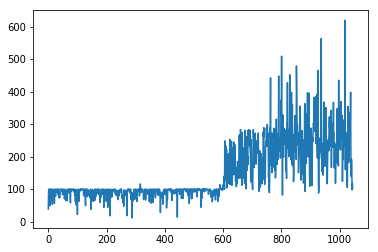

Time elapsed:29850.180505990982
| Reward: 246 | Episode: 1046 


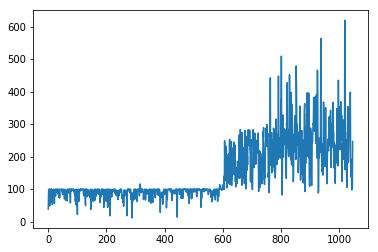

Time elapsed:29885.220118045807
| Reward: 274 | Episode: 1047 


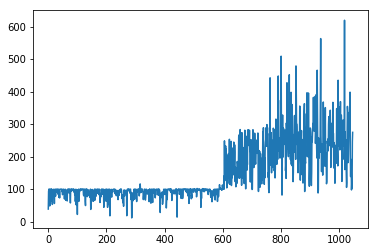

Time elapsed:29919.797224998474
| Reward: 281 | Episode: 1048 


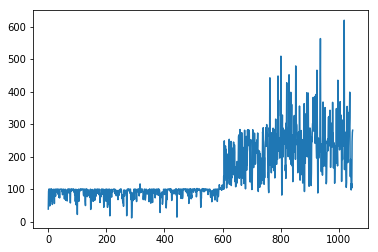

Time elapsed:29955.09993124008
| Reward: 263 | Episode: 1049 


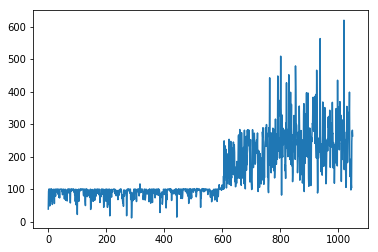

Time elapsed:29989.85757112503
| Reward: 272 | Episode: 1050 


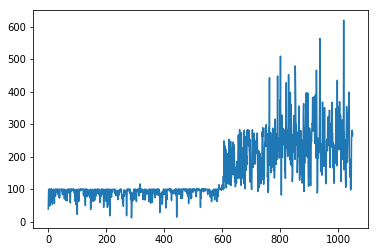

Time elapsed:30024.862364768982
| Reward: 197 | Episode: 1051 


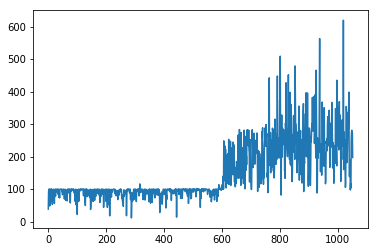

Time elapsed:30060.46338534355
| Reward: 293 | Episode: 1052 


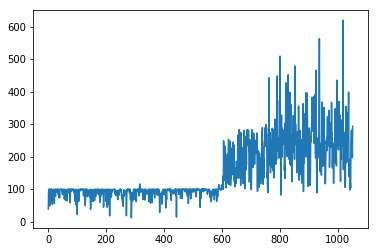

Time elapsed:30095.90333175659
| Reward: 363 | Episode: 1053 


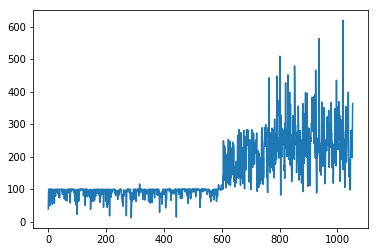

Time elapsed:30131.55542087555
| Reward: 220 | Episode: 1054 


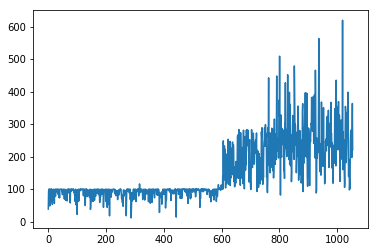

Time elapsed:30166.94708108902
| Reward: 278 | Episode: 1055 


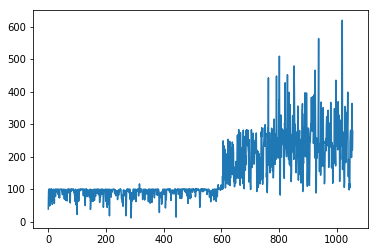

Time elapsed:30202.248470544815
| Reward: 221 | Episode: 1056 


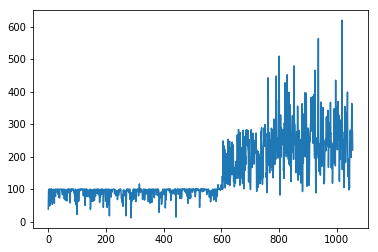

Time elapsed:30236.54200053215
| Reward: 215 | Episode: 1057 


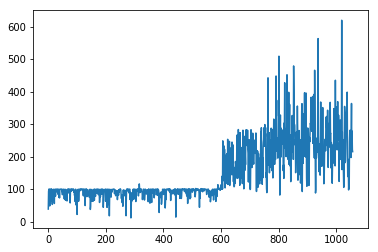

Time elapsed:30271.805493354797
| Reward: 202 | Episode: 1058 


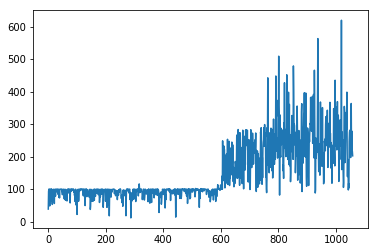

Time elapsed:30307.023823738098
| Reward: 200 | Episode: 1059 


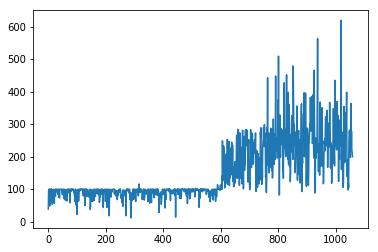

Time elapsed:30341.430688381195
| Reward: 200 | Episode: 1060 


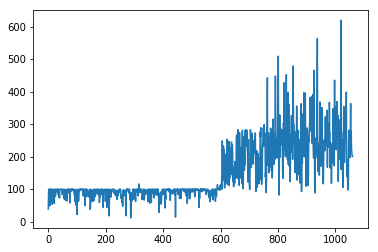

Time elapsed:30376.76286149025
| Reward: 112 | Episode: 1061 


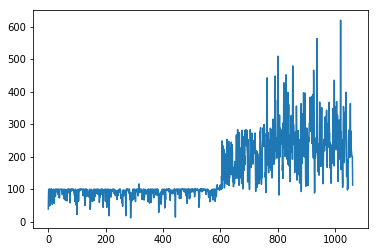

Time elapsed:30411.818222761154
| Reward: 280 | Episode: 1062 


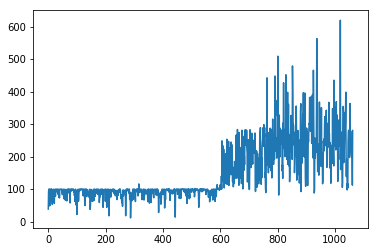

Time elapsed:30445.768004655838
| Reward: 246 | Episode: 1063 


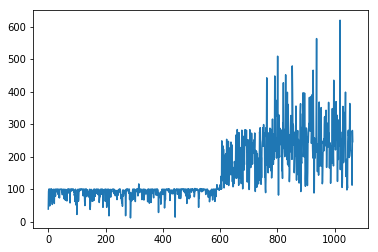

Time elapsed:30480.086668729782
| Reward: 302 | Episode: 1064 


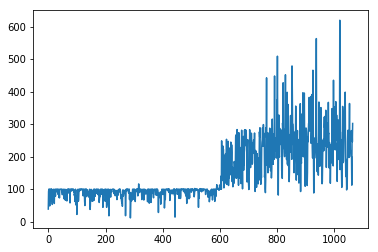

Time elapsed:30514.78969478607
| Reward: 191 | Episode: 1065 


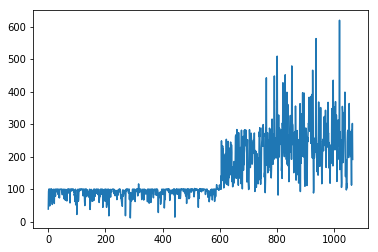

Time elapsed:30549.109183311462
| Reward: 191 | Episode: 1066 


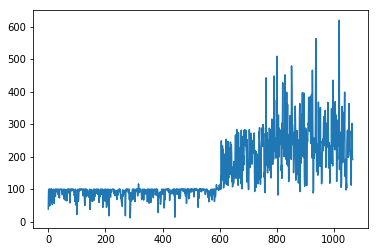

Time elapsed:30583.304140090942
| Reward: 232 | Episode: 1067 


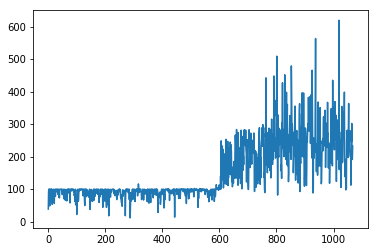

Time elapsed:30618.104256629944
| Reward: 188 | Episode: 1068 


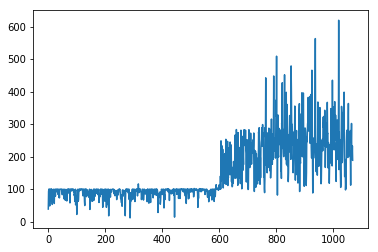

Time elapsed:30653.01019358635
| Reward: 523 | Episode: 1069 


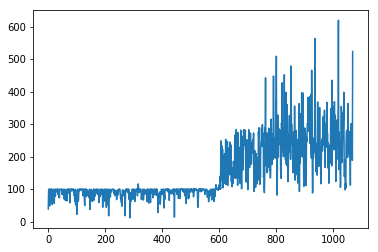

Time elapsed:30687.70863866806
| Reward: 295 | Episode: 1070 


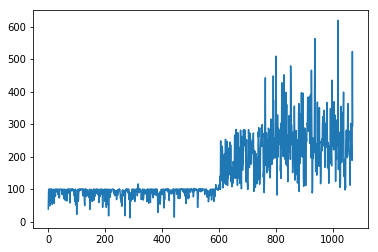

Time elapsed:30722.602674484253
| Reward: 342 | Episode: 1071 


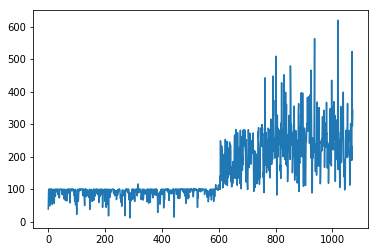

Time elapsed:30757.354833841324
| Reward: 222 | Episode: 1072 


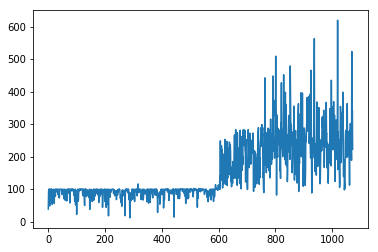

Time elapsed:30792.58108139038
| Reward: 304 | Episode: 1073 


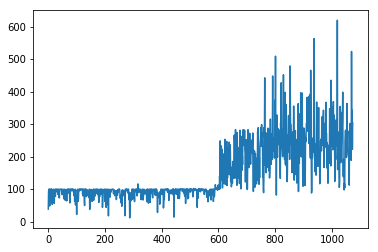

Time elapsed:30827.552609443665
| Reward: 299 | Episode: 1074 


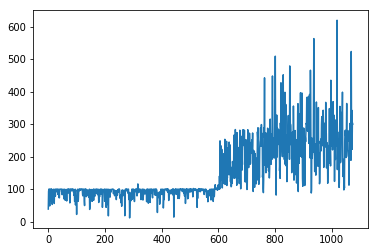

Time elapsed:30862.73303794861
| Reward: 184 | Episode: 1075 


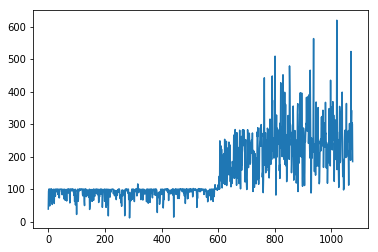

Time elapsed:30898.075063943863
| Reward: 241 | Episode: 1076 


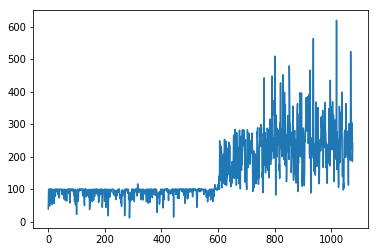

Time elapsed:30933.44889998436
| Reward: 321 | Episode: 1077 


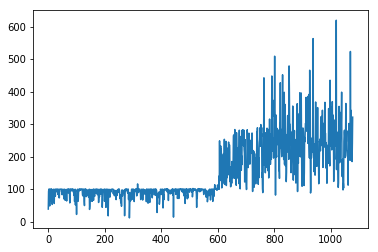

Time elapsed:30969.048627614975
| Reward: 302 | Episode: 1078 


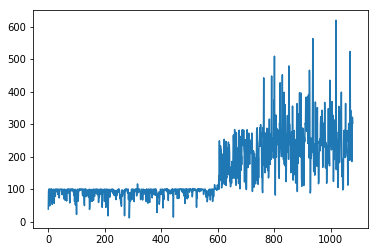

Time elapsed:31004.427601337433
| Reward: 288 | Episode: 1079 


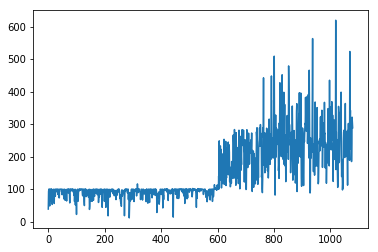

Time elapsed:31039.836015939713
| Reward: 239 | Episode: 1080 


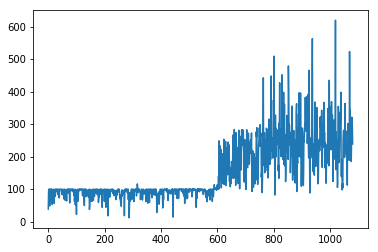

Time elapsed:31075.159147024155
| Reward: 150 | Episode: 1081 


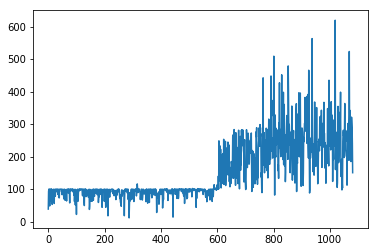

Time elapsed:31109.199833869934
| Reward: 240 | Episode: 1082 


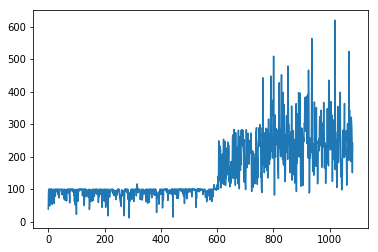

Time elapsed:31143.557005882263
| Reward: 360 | Episode: 1083 


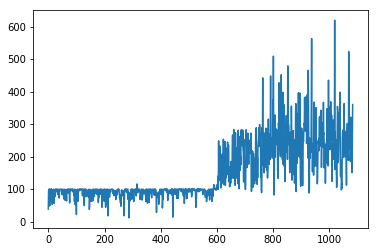

Time elapsed:31178.332103729248
| Reward: 344 | Episode: 1084 


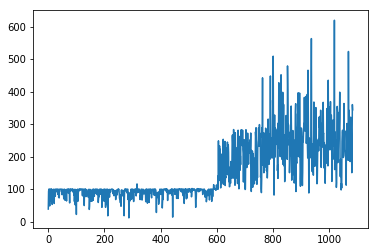

Time elapsed:31213.65450310707
| Reward: 177 | Episode: 1085 


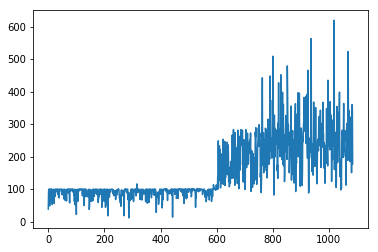

Time elapsed:31248.87261247635
| Reward: 178 | Episode: 1086 


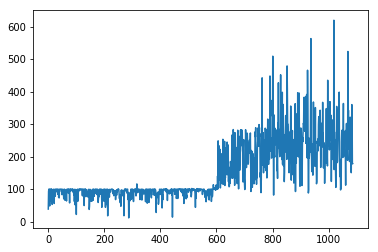

Time elapsed:31283.192777633667
| Reward: 191 | Episode: 1087 


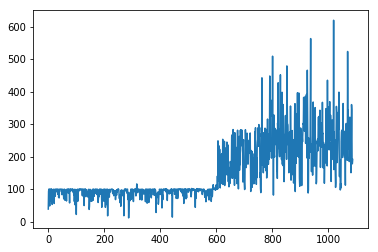

Time elapsed:31318.669089078903
| Reward: 108 | Episode: 1088 


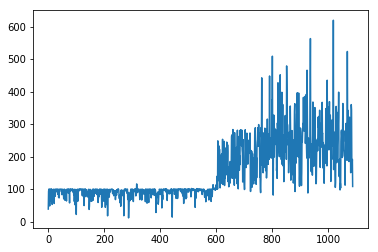

Time elapsed:31353.881793022156
| Reward: 311 | Episode: 1089 


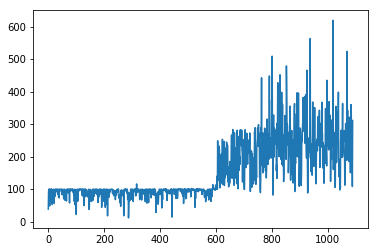

Time elapsed:31389.132068634033
| Reward: 251 | Episode: 1090 


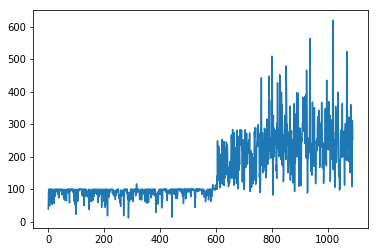

Time elapsed:31424.379267692566
| Reward: 174 | Episode: 1091 


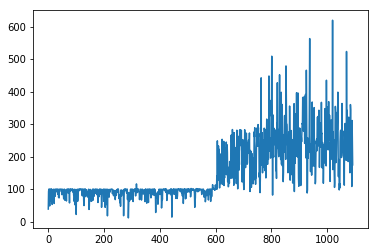

Time elapsed:31458.65286374092
| Reward: 190 | Episode: 1092 


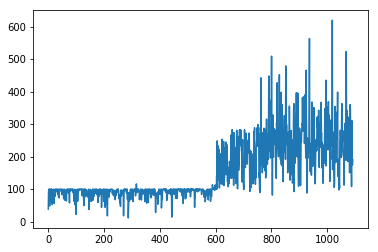

Time elapsed:31493.590671777725
| Reward: 171 | Episode: 1093 


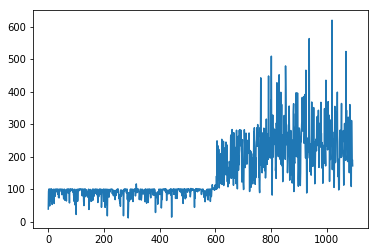

Time elapsed:31528.145925045013
| Reward: 250 | Episode: 1094 


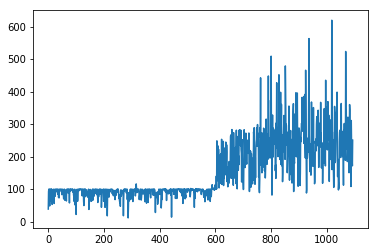

Time elapsed:31563.120099306107
| Reward: 139 | Episode: 1095 


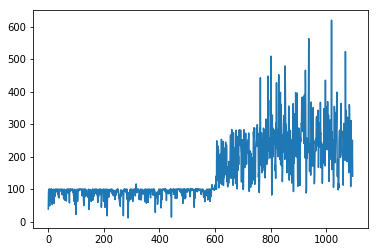

Time elapsed:31597.789498806
| Reward: 103 | Episode: 1096 


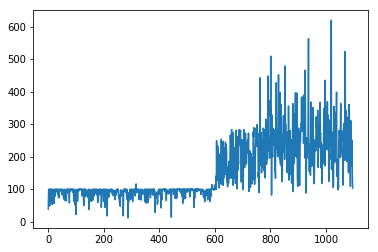

Time elapsed:31632.406442642212
| Reward: 110 | Episode: 1097 


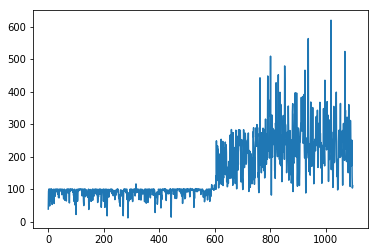

Time elapsed:31668.112123966217
| Reward: 119 | Episode: 1098 


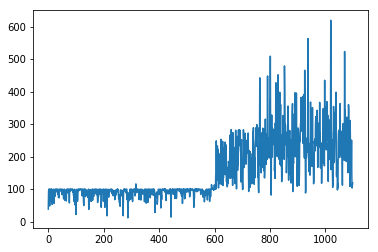

Time elapsed:31703.484700918198
| Reward: 177 | Episode: 1099 


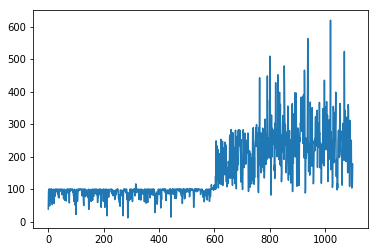

Time elapsed:31738.739580392838
| Reward: 134 | Episode: 1100 


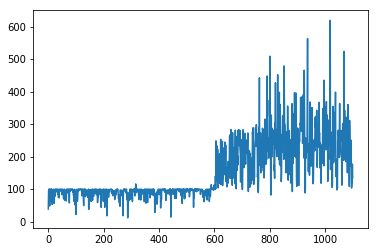

Time elapsed:31774.404590845108
| Reward: 387 | Episode: 1101 


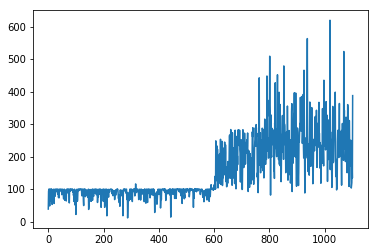

Time elapsed:31809.74003148079
| Reward: 283 | Episode: 1102 


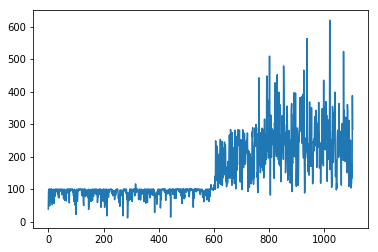

Time elapsed:31844.98703145981
| Reward: 265 | Episode: 1103 


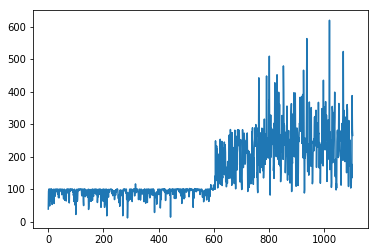

Time elapsed:31879.447365045547
| Reward: 341 | Episode: 1104 


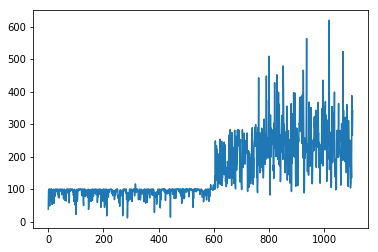

Time elapsed:31913.64800262451
| Reward: 288 | Episode: 1105 


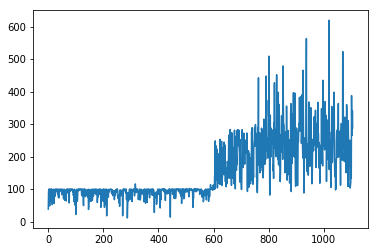

Time elapsed:31948.825259685516
| Reward: 260 | Episode: 1106 


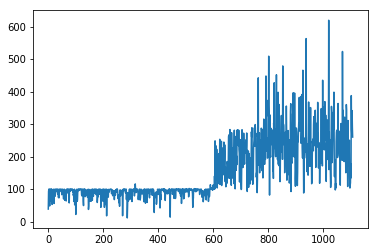

Time elapsed:31983.033361673355
| Reward: 177 | Episode: 1107 


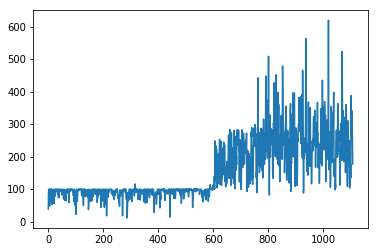

Time elapsed:32018.44483947754
| Reward: 198 | Episode: 1108 


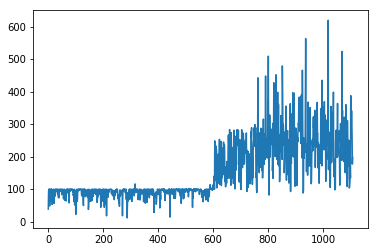

Time elapsed:32053.893815279007
| Reward: 122 | Episode: 1109 


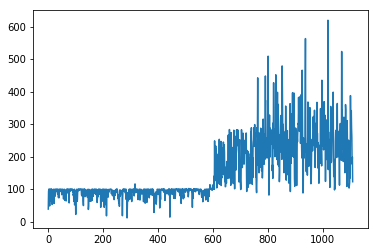

Time elapsed:32089.140671491623
| Reward: 190 | Episode: 1110 


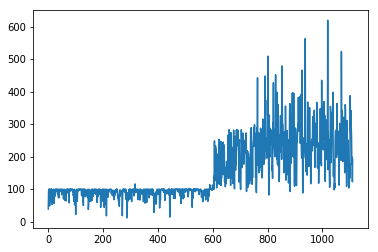

Time elapsed:32124.333142518997
| Reward: 213 | Episode: 1111 


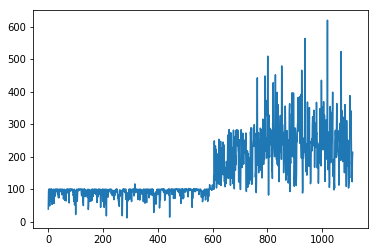

Time elapsed:32159.510784864426
| Reward: 297 | Episode: 1112 


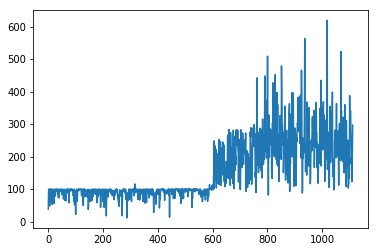

Time elapsed:32194.389450073242
| Reward: 320 | Episode: 1113 


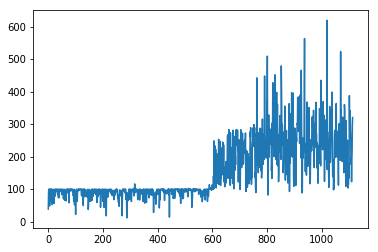

Time elapsed:32229.20857644081
| Reward: 248 | Episode: 1114 


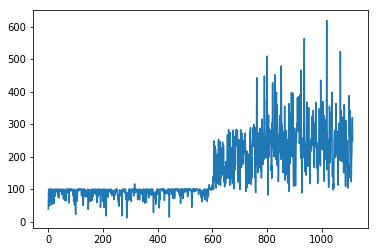

Time elapsed:32264.240450382233
| Reward: 168 | Episode: 1115 


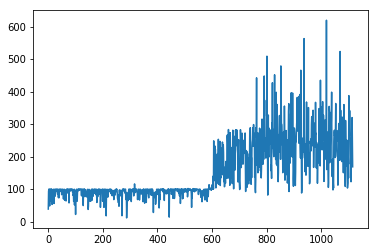

Time elapsed:32299.13134074211
| Reward: 130 | Episode: 1116 


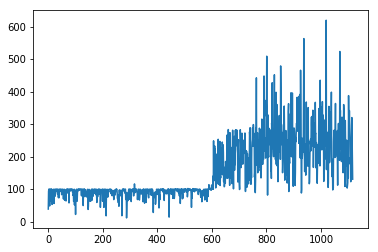

Time elapsed:32333.154262781143
| Reward: 165 | Episode: 1117 


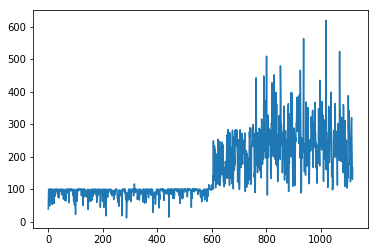

Time elapsed:32368.053919553757
| Reward: 137 | Episode: 1118 


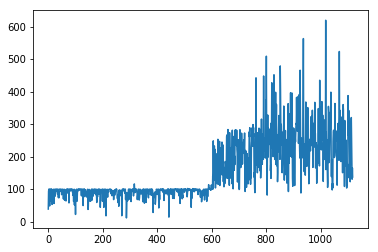

Time elapsed:32402.889929533005
| Reward: 302 | Episode: 1119 


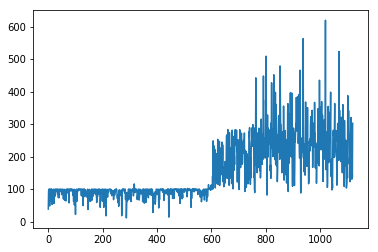

Time elapsed:32437.749446630478
| Reward: 308 | Episode: 1120 


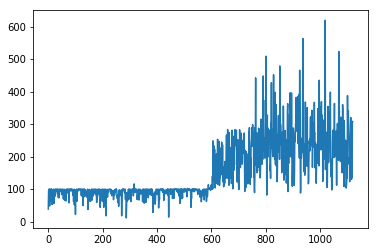

Time elapsed:32471.80222272873
| Reward: 237 | Episode: 1121 


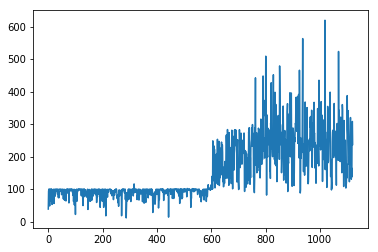

Time elapsed:32507.48183655739
| Reward: 253 | Episode: 1122 


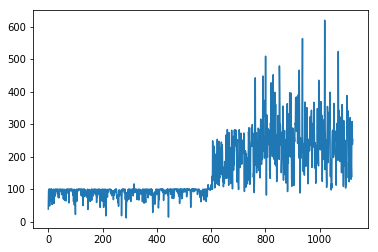

Time elapsed:32542.513077497482
| Reward: 263 | Episode: 1123 


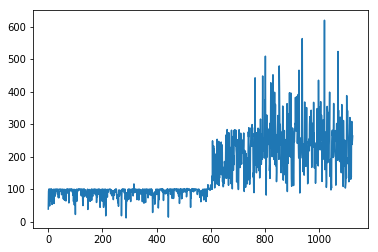

Time elapsed:32577.440574645996
| Reward: 360 | Episode: 1124 


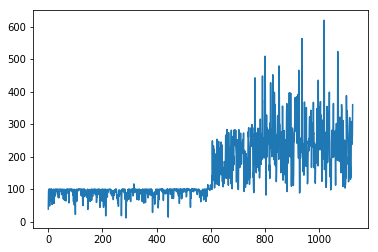

Time elapsed:32612.893652677536
| Reward: 240 | Episode: 1125 


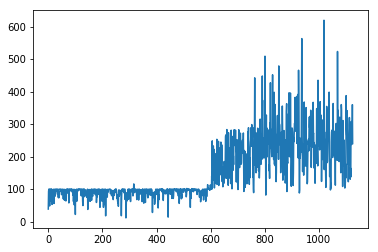

Time elapsed:32647.95943903923
| Reward: 191 | Episode: 1126 


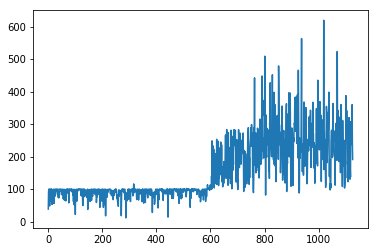

Time elapsed:32682.887365102768
| Reward: 212 | Episode: 1127 


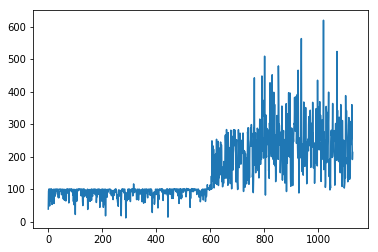

Time elapsed:32717.02604699135
| Reward: 272 | Episode: 1128 


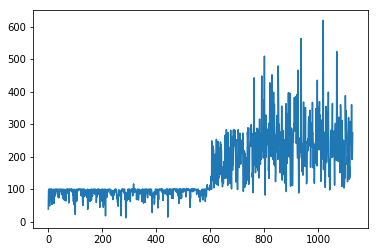

Time elapsed:32752.46573281288
| Reward: 231 | Episode: 1129 


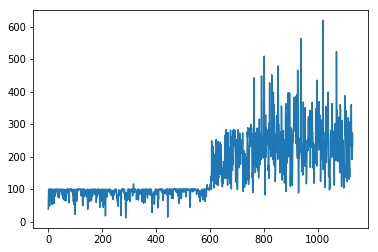

Time elapsed:32787.60312962532
| Reward: 306 | Episode: 1130 


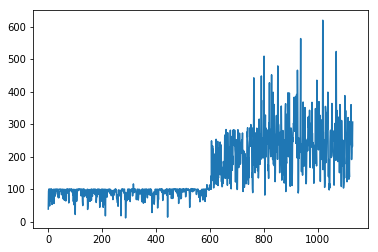

Time elapsed:32822.93391060829
| Reward: 612 | Episode: 1131 


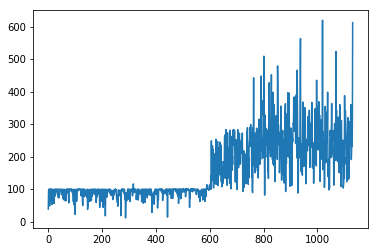

Time elapsed:32857.73467731476
| Reward: 234 | Episode: 1132 


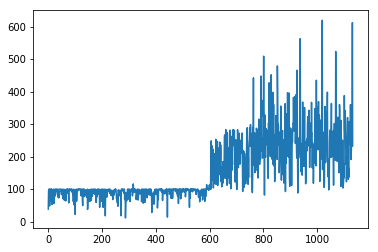

Time elapsed:32891.934938430786
| Reward: 136 | Episode: 1133 


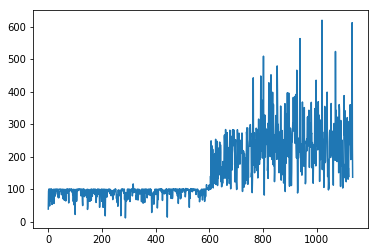

Time elapsed:32926.69374656677
| Reward: 97 | Episode: 1134 


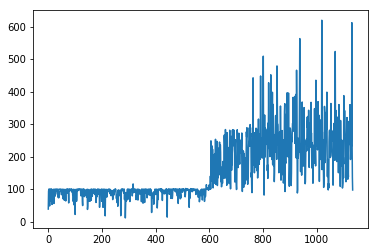

Time elapsed:32961.25094819069
| Reward: 249 | Episode: 1135 


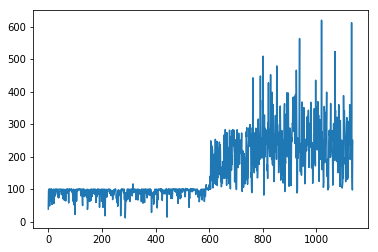

Time elapsed:32996.807384967804
| Reward: 373 | Episode: 1136 


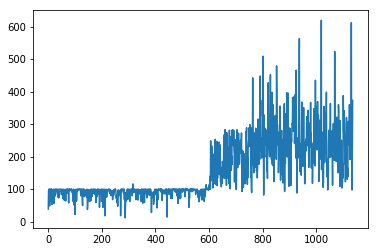

Time elapsed:33031.213520526886
| Reward: 280 | Episode: 1137 


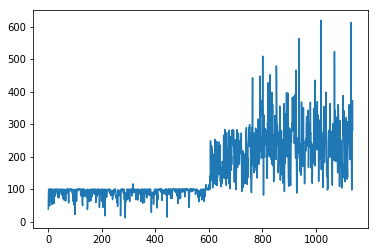

Time elapsed:33066.250722408295
| Reward: 278 | Episode: 1138 


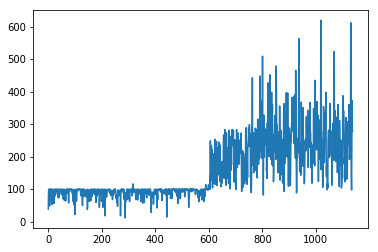

Time elapsed:33100.84667301178
| Reward: 308 | Episode: 1139 


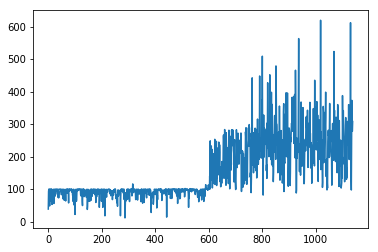

Time elapsed:33133.503653526306
| Reward: 312 | Episode: 1140 


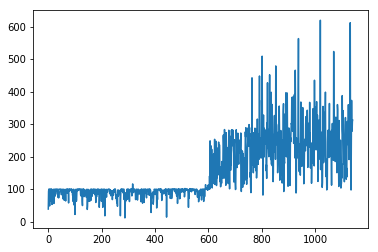

Time elapsed:33167.07548332214
| Reward: 108 | Episode: 1141 


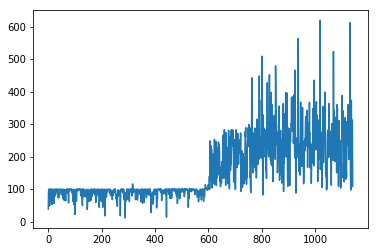

Time elapsed:33201.2468585968
| Reward: 134 | Episode: 1142 


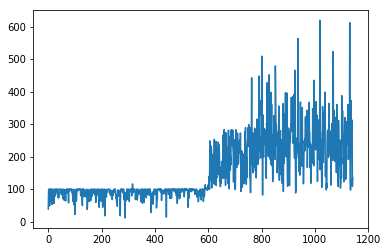

Time elapsed:33235.560656785965
| Reward: 289 | Episode: 1143 


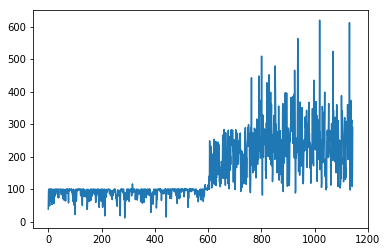

Time elapsed:33269.962958574295
| Reward: 200 | Episode: 1144 


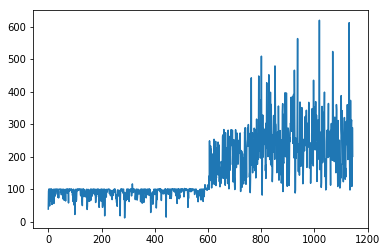

Time elapsed:33304.12445926666
| Reward: 322 | Episode: 1145 


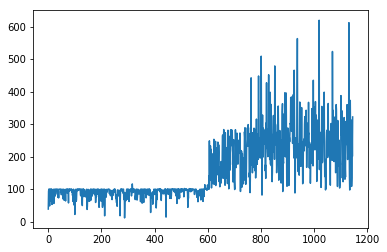

Time elapsed:33339.44892859459
| Reward: 266 | Episode: 1146 


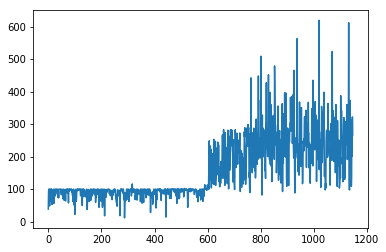

Time elapsed:33374.90043878555
| Reward: 194 | Episode: 1147 


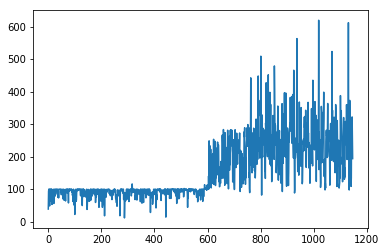

Time elapsed:33410.27746963501
| Reward: 168 | Episode: 1148 


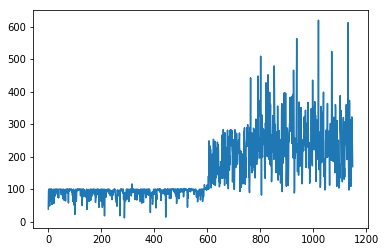

Time elapsed:33445.53800868988
| Reward: 213 | Episode: 1149 


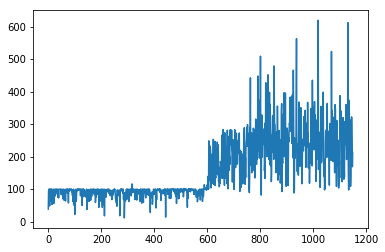

Time elapsed:33480.1510579586
| Reward: 276 | Episode: 1150 


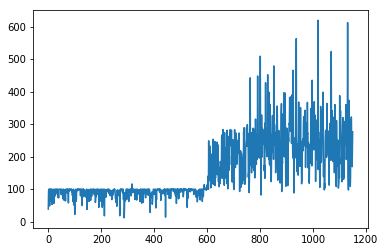

Time elapsed:33515.59347844124
| Reward: 352 | Episode: 1151 


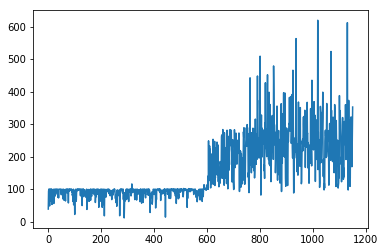

Time elapsed:33550.54077196121
| Reward: 317 | Episode: 1152 


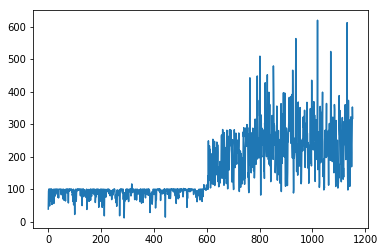

Time elapsed:33586.26512956619
| Reward: 267 | Episode: 1153 


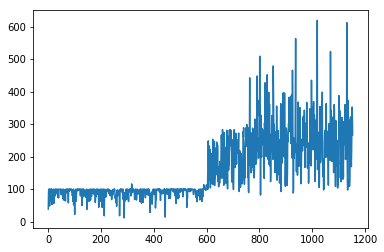

Time elapsed:33621.60594749451
| Reward: 161 | Episode: 1154 


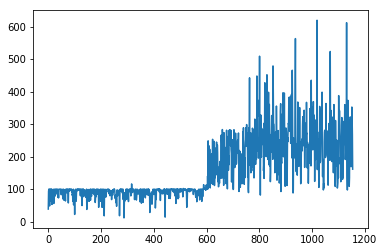

Time elapsed:33656.57275056839
| Reward: 184 | Episode: 1155 


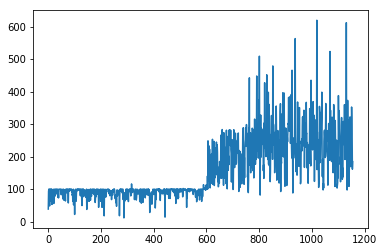

Time elapsed:33690.72526264191
| Reward: 261 | Episode: 1156 


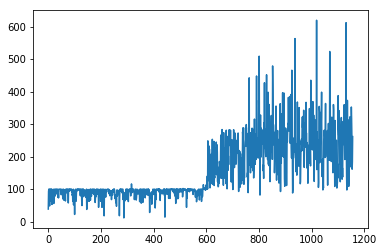

Time elapsed:33726.156780958176
| Reward: 255 | Episode: 1157 


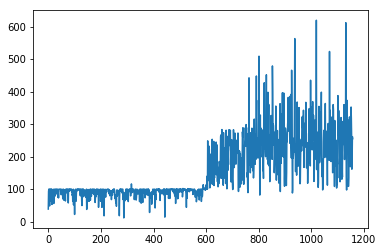

Time elapsed:33760.95749640465
| Reward: 116 | Episode: 1158 


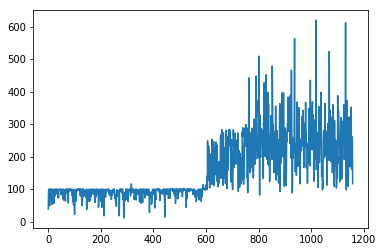

Time elapsed:33795.688091516495
| Reward: 267 | Episode: 1159 


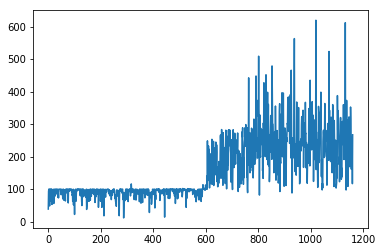

Time elapsed:33830.38937354088
| Reward: 282 | Episode: 1160 


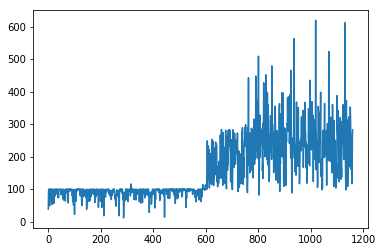

Time elapsed:33864.71449828148
| Reward: 287 | Episode: 1161 


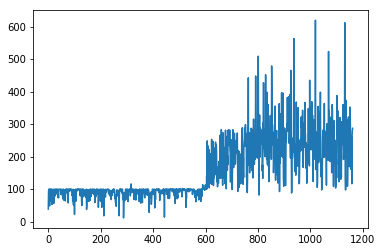

Time elapsed:33898.69336295128
| Reward: 284 | Episode: 1162 


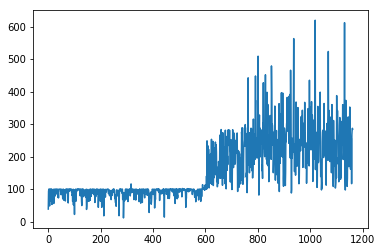

Time elapsed:33932.45408797264
| Reward: 300 | Episode: 1163 


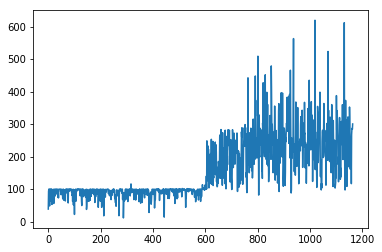

Time elapsed:33966.46223258972
| Reward: 232 | Episode: 1164 


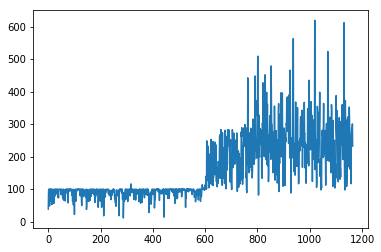

Time elapsed:34000.94065499306
| Reward: 458 | Episode: 1165 


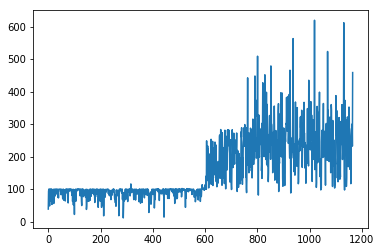

Time elapsed:34035.02751374245
| Reward: 238 | Episode: 1166 


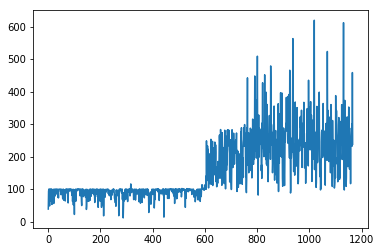

Time elapsed:34069.60155034065
| Reward: 251 | Episode: 1167 


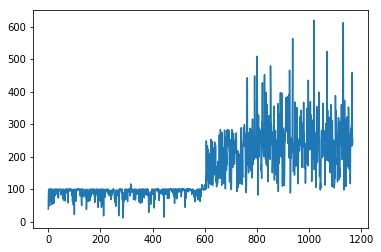

Time elapsed:34103.552837610245
| Reward: 253 | Episode: 1168 


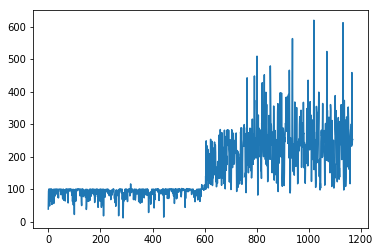

Time elapsed:34138.02345299721
| Reward: 298 | Episode: 1169 


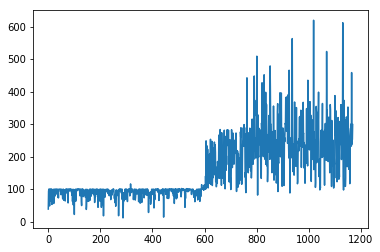

Time elapsed:34172.216101169586
| Reward: 221 | Episode: 1170 


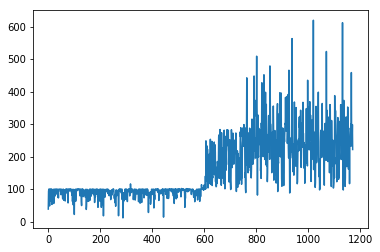

Time elapsed:34206.77956843376
| Reward: 230 | Episode: 1171 


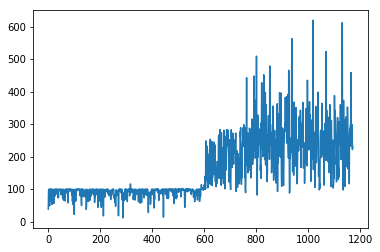

Time elapsed:34240.99063873291
| Reward: 176 | Episode: 1172 


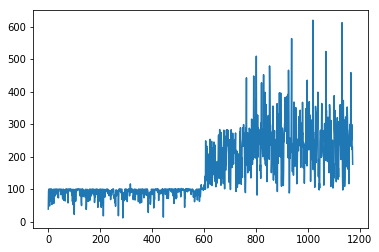

Time elapsed:34275.538232564926
| Reward: 372 | Episode: 1173 


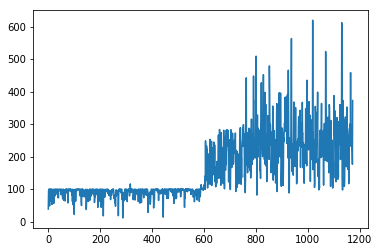

Time elapsed:34311.05660390854
| Reward: 452 | Episode: 1174 


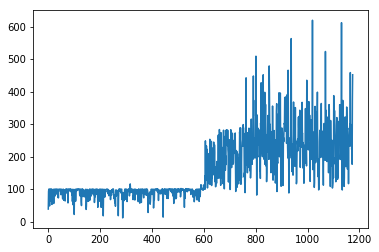

Time elapsed:34345.00234913826
| Reward: 204 | Episode: 1175 


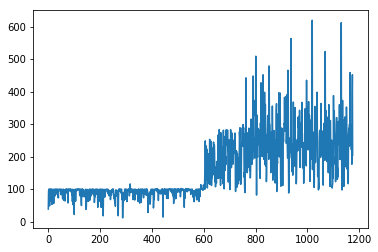

Time elapsed:34379.56830692291
| Reward: 159 | Episode: 1176 


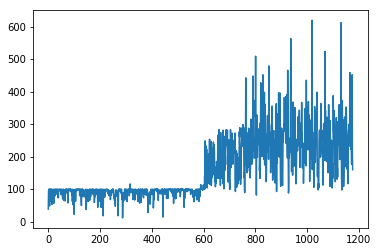

Time elapsed:34414.09504532814
| Reward: 212 | Episode: 1177 


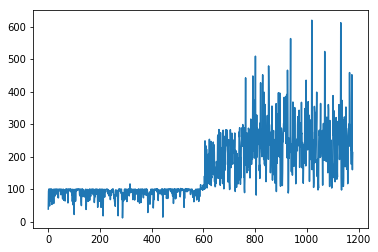

Time elapsed:34448.44810342789
| Reward: 320 | Episode: 1178 


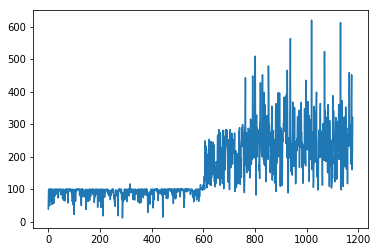

Time elapsed:34482.65251994133
| Reward: 193 | Episode: 1179 


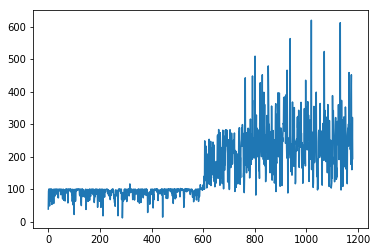

Time elapsed:34516.75309610367
| Reward: 336 | Episode: 1180 


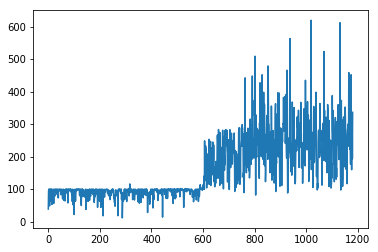

Time elapsed:34552.10659790039
| Reward: 443 | Episode: 1181 


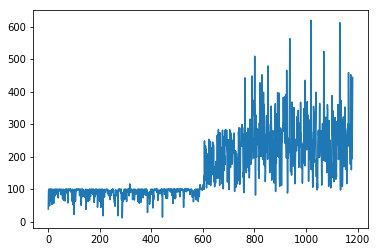

Time elapsed:34587.1928563118
| Reward: 265 | Episode: 1182 


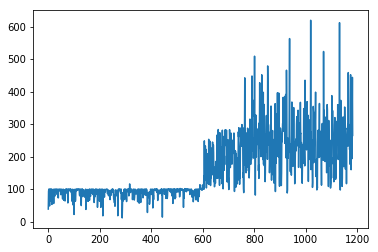

Time elapsed:34622.621886491776
| Reward: 426 | Episode: 1183 


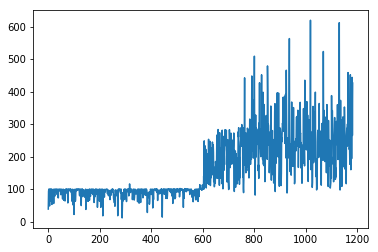

Time elapsed:34657.618020534515
| Reward: 90 | Episode: 1184 


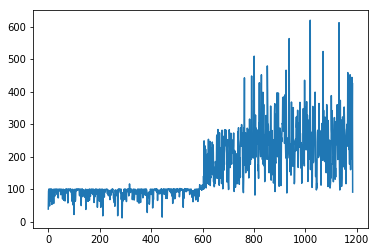

Time elapsed:34692.07490968704
| Reward: 112 | Episode: 1185 


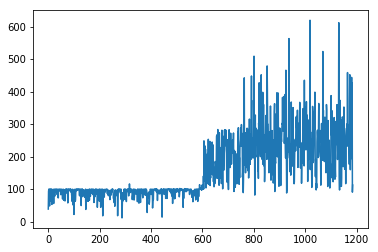

Time elapsed:34726.005192518234
| Reward: 456 | Episode: 1186 


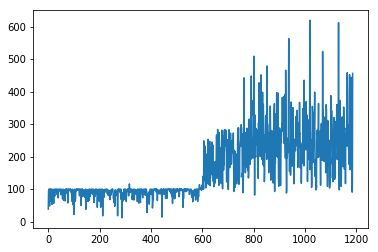

Time elapsed:34760.60320067406
| Reward: 463 | Episode: 1187 


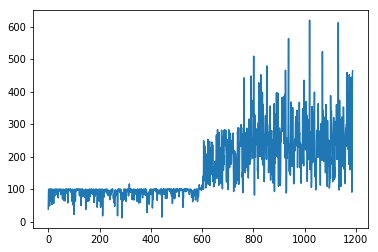

Time elapsed:34795.01727771759
| Reward: 245 | Episode: 1188 


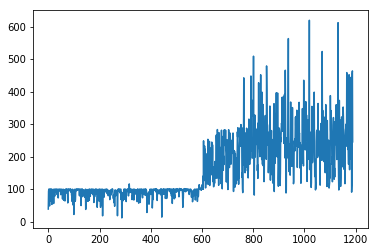

Time elapsed:34829.677993774414
| Reward: 231 | Episode: 1189 


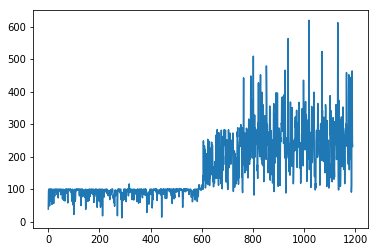

Time elapsed:34864.77460861206
| Reward: 226 | Episode: 1190 


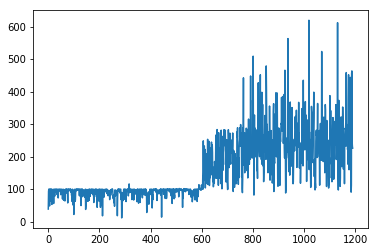

Time elapsed:34899.87784194946
| Reward: 254 | Episode: 1191 


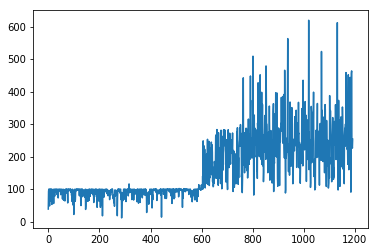

Time elapsed:34934.591270923615
| Reward: 212 | Episode: 1192 


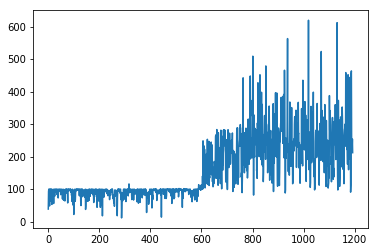

Time elapsed:34968.87773704529
| Reward: 220 | Episode: 1193 


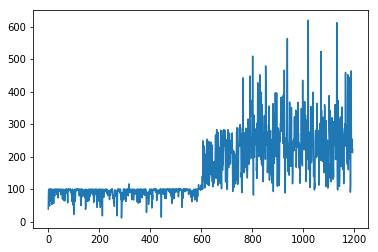

Time elapsed:35003.14591693878
| Reward: 125 | Episode: 1194 


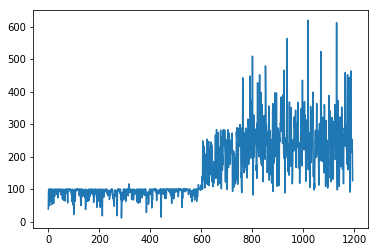

Time elapsed:35037.564224004745
| Reward: 277 | Episode: 1195 


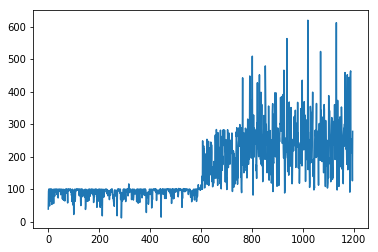

Time elapsed:35073.063120126724
| Reward: 201 | Episode: 1196 


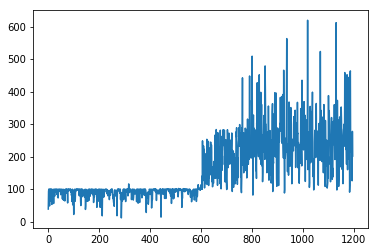

Time elapsed:35108.0653963089
| Reward: 227 | Episode: 1197 


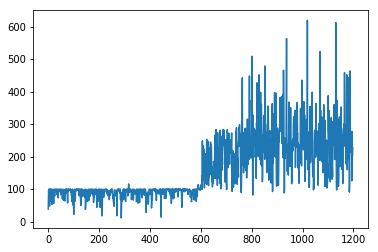

Time elapsed:35143.549330711365
| Reward: 279 | Episode: 1198 


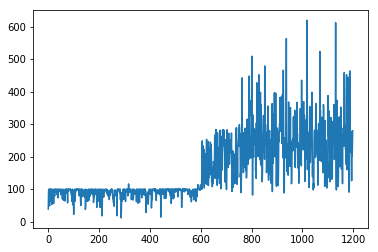

Time elapsed:35178.21444940567
| Reward: 191 | Episode: 1199 


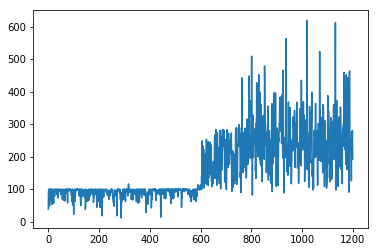

Time elapsed:35212.316447496414
| Reward: 170 | Episode: 1200 


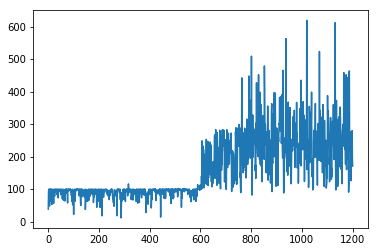

Time elapsed:35246.27130937576
| Reward: 115 | Episode: 1201 


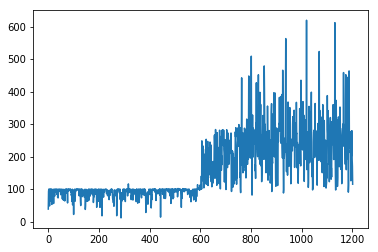

Time elapsed:35281.71509242058
| Reward: 166 | Episode: 1202 


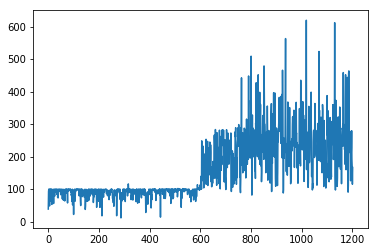

Time elapsed:35316.677210092545
| Reward: 372 | Episode: 1203 


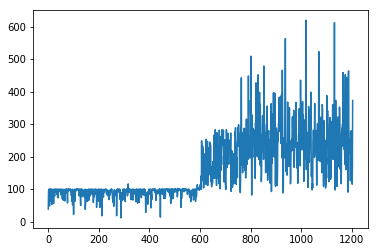

Time elapsed:35351.57738995552
| Reward: 412 | Episode: 1204 


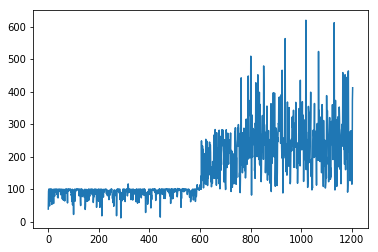

Time elapsed:35385.839688539505
| Reward: 394 | Episode: 1205 


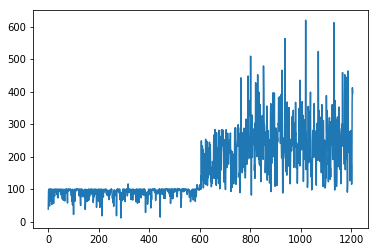

Time elapsed:35419.62284708023
| Reward: 270 | Episode: 1206 


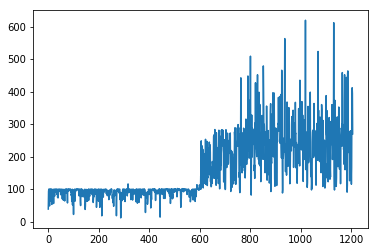

Time elapsed:35453.54651427269
| Reward: 283 | Episode: 1207 


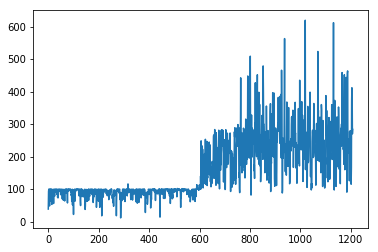

Time elapsed:35488.200692892075
| Reward: 239 | Episode: 1208 


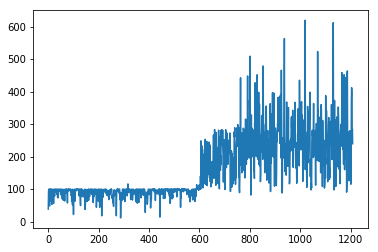

Time elapsed:35522.3715569973
| Reward: 128 | Episode: 1209 


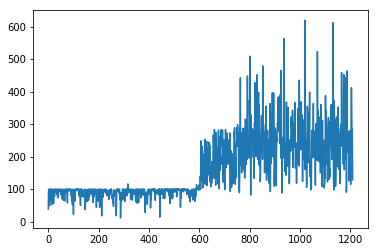

Time elapsed:35557.562265872955
| Reward: 141 | Episode: 1210 


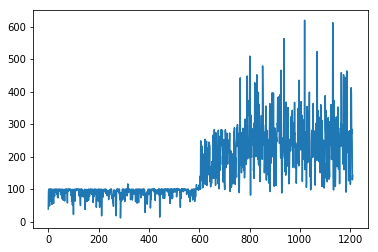

Time elapsed:35592.32170534134
| Reward: 321 | Episode: 1211 


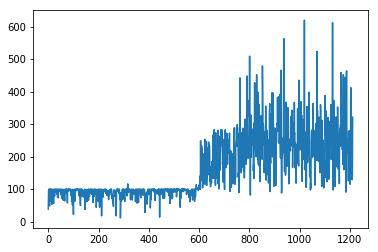

Time elapsed:35628.01521897316
| Reward: 229 | Episode: 1212 


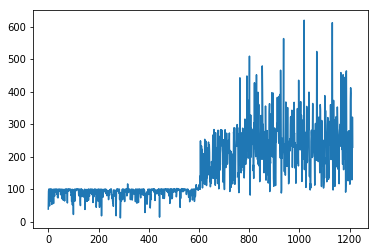

Time elapsed:35663.7897567749
| Reward: 159 | Episode: 1213 


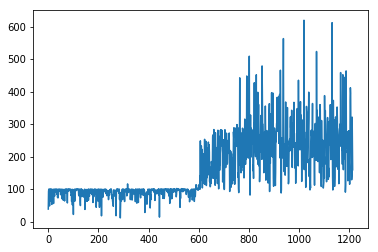

Time elapsed:35699.125849962234
| Reward: 249 | Episode: 1214 


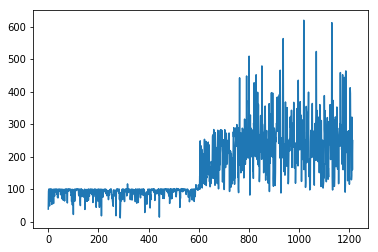

Time elapsed:35733.733115673065
| Reward: 242 | Episode: 1215 


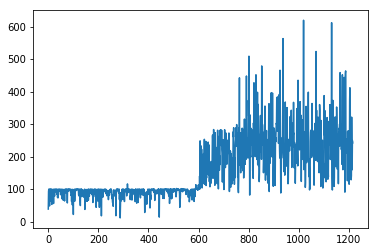

Time elapsed:35769.16789317131
| Reward: 324 | Episode: 1216 


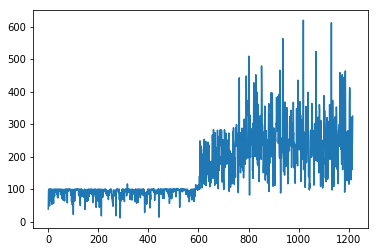

Time elapsed:35803.33668637276
| Reward: 183 | Episode: 1217 


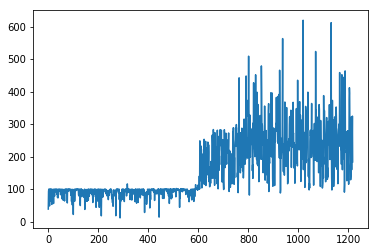

Time elapsed:35837.60054564476
| Reward: 193 | Episode: 1218 


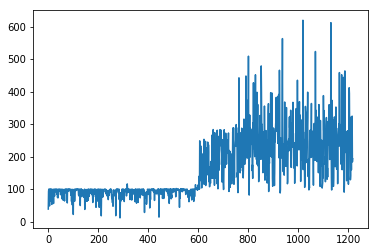

Time elapsed:35873.09654259682
| Reward: 227 | Episode: 1219 


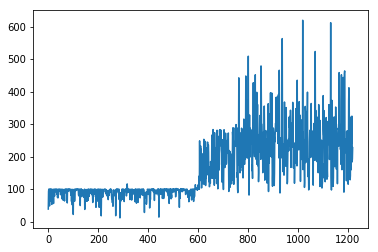

Time elapsed:35908.81047582626
| Reward: 170 | Episode: 1220 


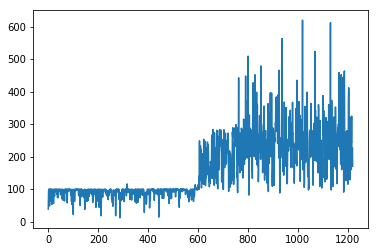

Time elapsed:35944.01532673836
| Reward: 347 | Episode: 1221 


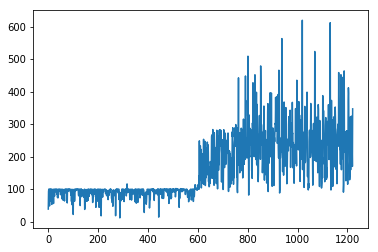

Time elapsed:35978.08251070976
| Reward: 271 | Episode: 1222 


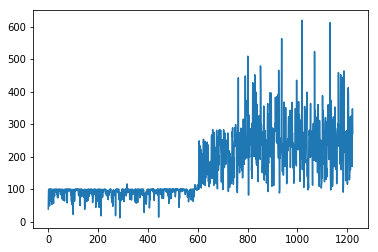

Time elapsed:36013.007324934006
| Reward: 161 | Episode: 1223 


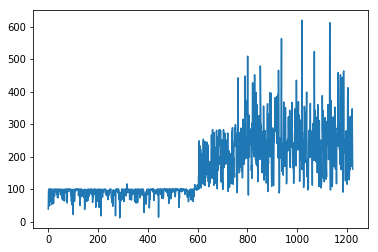

Time elapsed:36047.12690496445
| Reward: 204 | Episode: 1224 


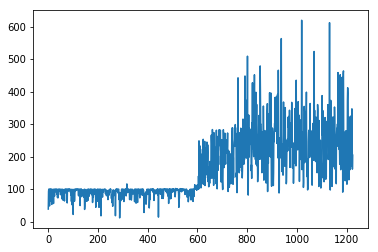

Time elapsed:36082.527998924255
| Reward: 299 | Episode: 1225 


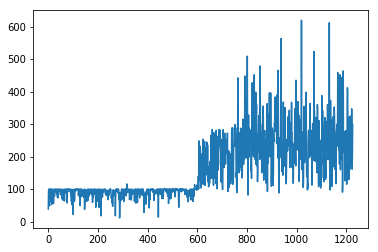

Time elapsed:36117.63794159889
| Reward: 228 | Episode: 1226 


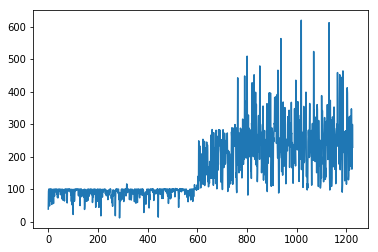

Time elapsed:36152.934343099594
| Reward: 287 | Episode: 1227 


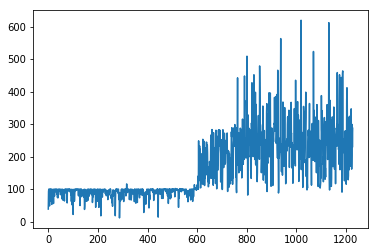

Time elapsed:36187.410056591034
| Reward: 254 | Episode: 1228 


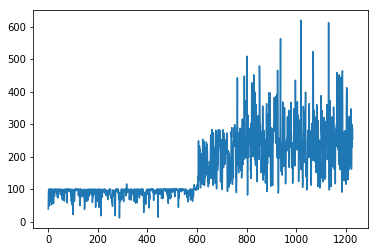

Time elapsed:36221.509070158005
| Reward: 214 | Episode: 1229 


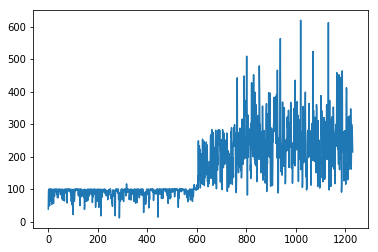

Time elapsed:36255.65924739838
| Reward: 245 | Episode: 1230 


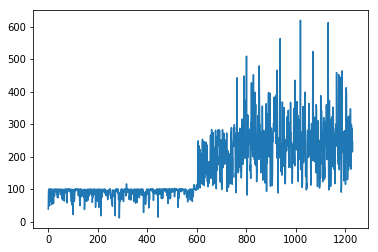

Time elapsed:36289.89894795418
| Reward: 255 | Episode: 1231 


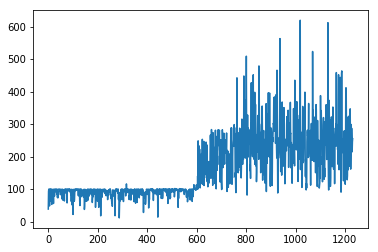

Time elapsed:36323.80830287933
| Reward: 249 | Episode: 1232 


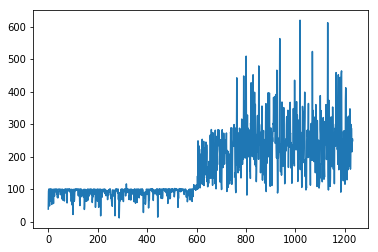

Time elapsed:36357.43865823746
| Reward: 228 | Episode: 1233 


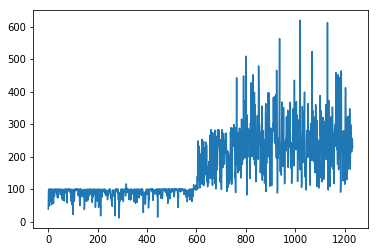

Time elapsed:36391.870178461075
| Reward: 200 | Episode: 1234 


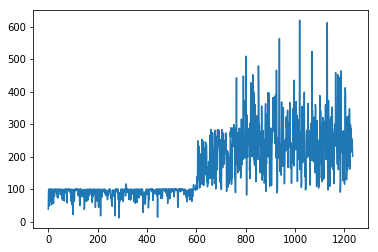

Time elapsed:36426.6885368824
| Reward: 218 | Episode: 1235 


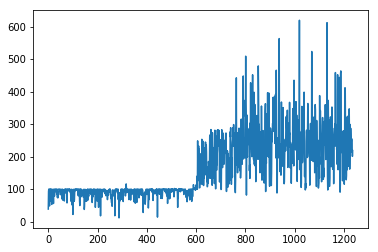

Time elapsed:36462.266729831696
| Reward: 314 | Episode: 1236 


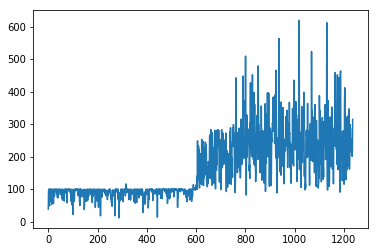

Time elapsed:36497.75120306015
| Reward: 124 | Episode: 1237 


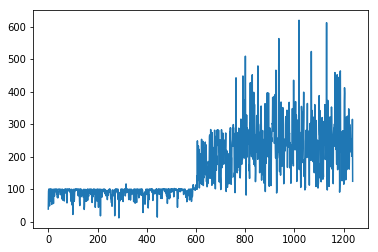

Time elapsed:36532.32800126076
| Reward: 217 | Episode: 1238 


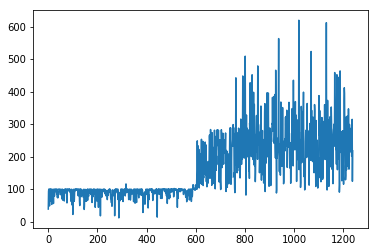

Time elapsed:36567.02402830124
| Reward: 130 | Episode: 1239 


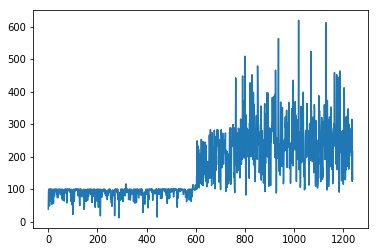

Time elapsed:36601.8028216362
| Reward: 109 | Episode: 1240 


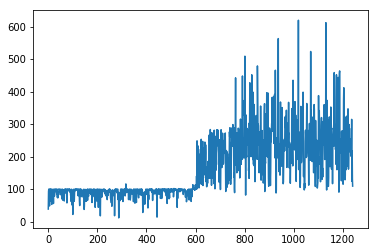

Time elapsed:36636.22757315636
| Reward: 167 | Episode: 1241 


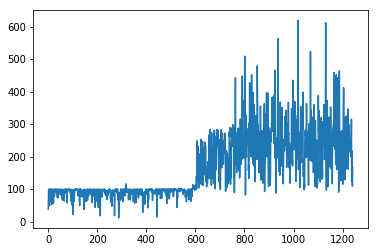

Time elapsed:36671.742928266525
| Reward: 220 | Episode: 1242 


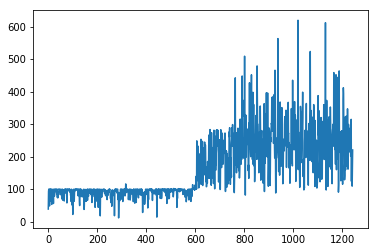

Time elapsed:36706.94271183014
| Reward: 280 | Episode: 1243 


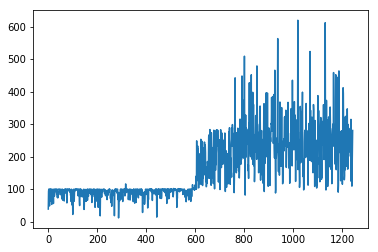

Time elapsed:36742.32324743271
| Reward: 228 | Episode: 1244 


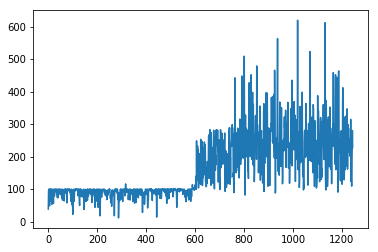

Time elapsed:36776.40210938454
| Reward: 311 | Episode: 1245 


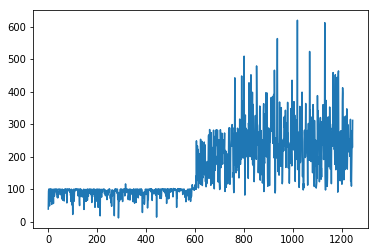

Time elapsed:36811.52701687813
| Reward: 253 | Episode: 1246 


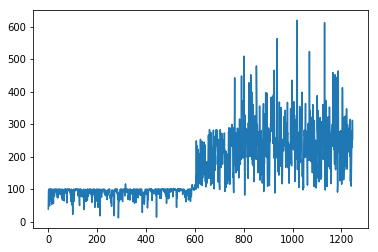

Time elapsed:36846.733060121536
| Reward: 196 | Episode: 1247 


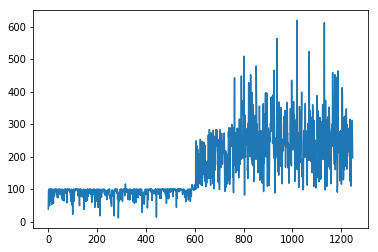

Time elapsed:36880.70937204361
| Reward: 292 | Episode: 1248 


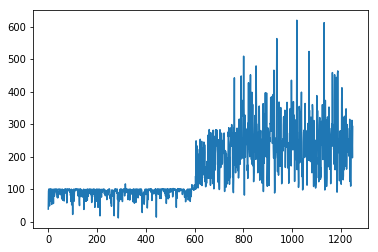

Time elapsed:36915.57400250435
| Reward: 270 | Episode: 1249 


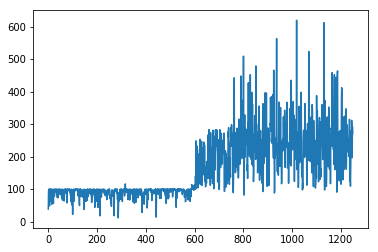

Time elapsed:36950.51958966255
| Reward: 285 | Episode: 1250 


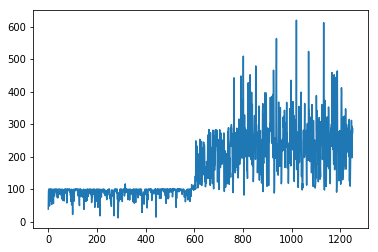

Time elapsed:36984.52578616142
| Reward: 215 | Episode: 1251 


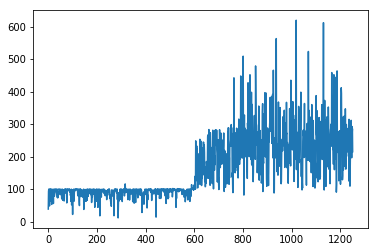

Time elapsed:37018.22906398773
| Reward: 248 | Episode: 1252 


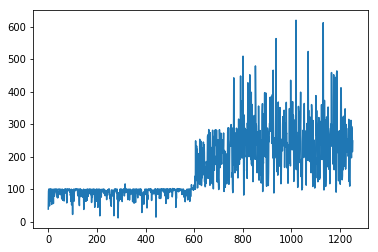

Time elapsed:37052.99351453781
| Reward: 220 | Episode: 1253 


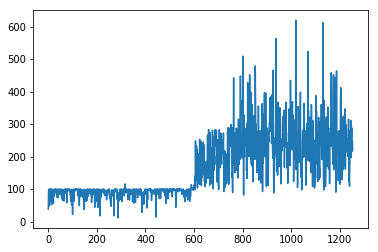

Time elapsed:37088.35550880432
| Reward: 164 | Episode: 1254 


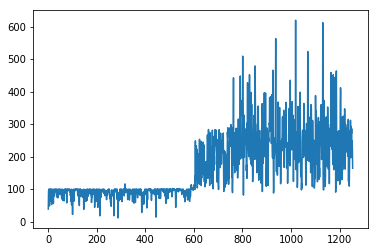

Time elapsed:37122.202162742615
| Reward: 158 | Episode: 1255 


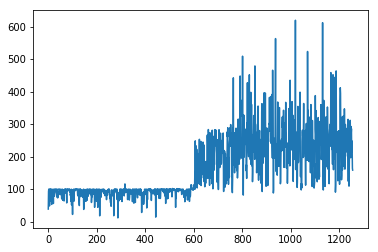

Time elapsed:37156.97959947586
| Reward: 203 | Episode: 1256 


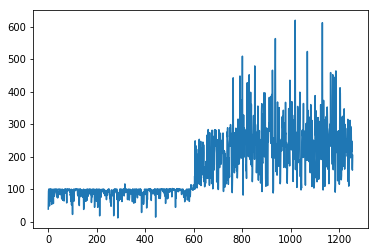

Time elapsed:37191.50416970253
| Reward: 128 | Episode: 1257 


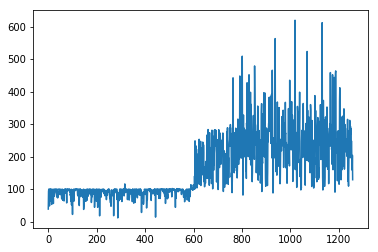

Time elapsed:37225.801745414734
| Reward: 190 | Episode: 1258 


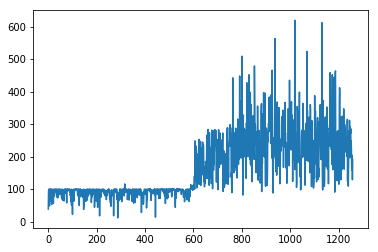

Time elapsed:37260.384474515915
| Reward: 190 | Episode: 1259 


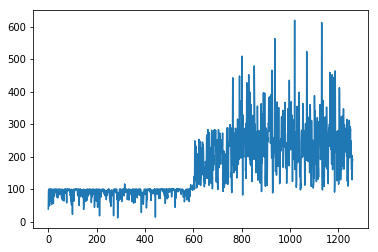

Time elapsed:37295.423439502716
| Reward: 380 | Episode: 1260 


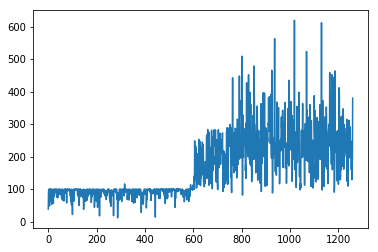

Time elapsed:37330.302186489105
| Reward: 279 | Episode: 1261 


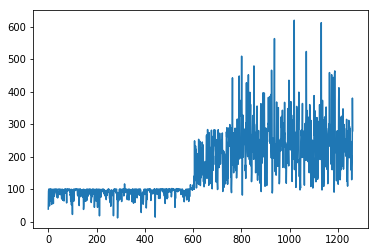

Time elapsed:37364.751854896545
| Reward: 225 | Episode: 1262 


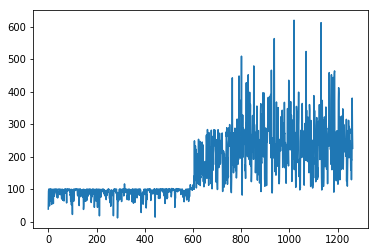

Time elapsed:37399.62287902832
| Reward: 307 | Episode: 1263 


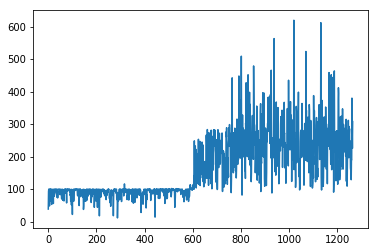

Time elapsed:37435.078588724136
| Reward: 352 | Episode: 1264 


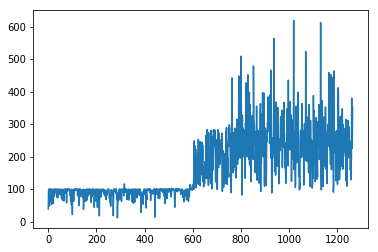

Time elapsed:37470.89982533455
| Reward: 299 | Episode: 1265 


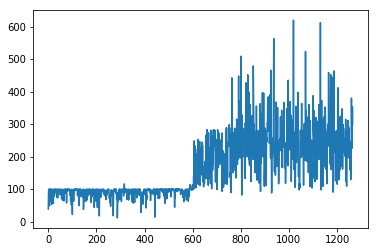

Time elapsed:37506.53944182396
| Reward: 303 | Episode: 1266 


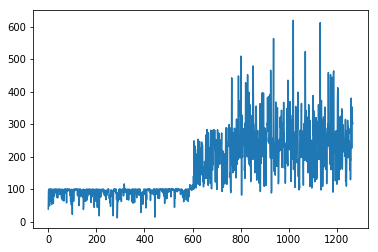

Time elapsed:37542.23086643219
| Reward: 246 | Episode: 1267 


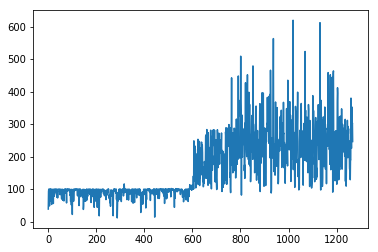

Time elapsed:37577.870544195175
| Reward: 338 | Episode: 1268 


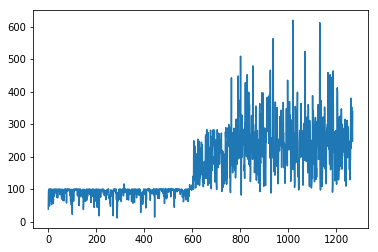

Time elapsed:37611.5600464344
| Reward: 134 | Episode: 1269 


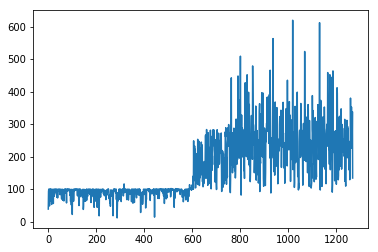

Time elapsed:37645.302990436554
| Reward: 115 | Episode: 1270 


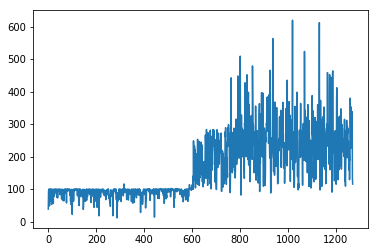

Time elapsed:37679.75808787346
| Reward: 100 | Episode: 1271 


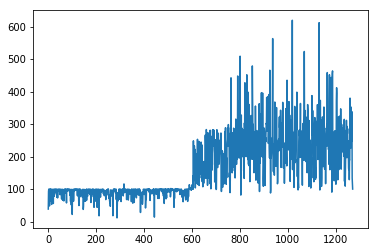

Time elapsed:37713.83858561516
| Reward: 100 | Episode: 1272 


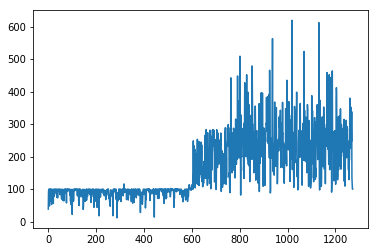

Time elapsed:37748.96204948425
| Reward: 233 | Episode: 1273 


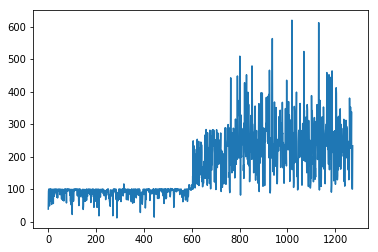

Time elapsed:37783.508397102356
| Reward: 340 | Episode: 1274 


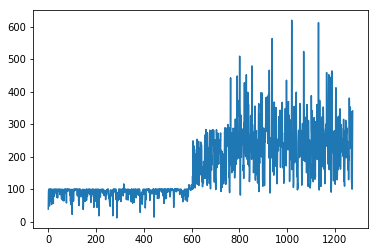

Time elapsed:37818.35823774338
| Reward: 281 | Episode: 1275 


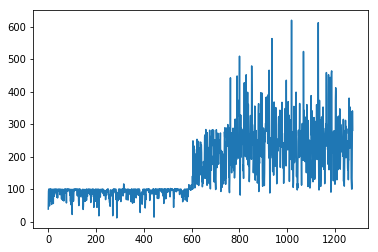

Time elapsed:37852.60639834404
| Reward: 190 | Episode: 1276 


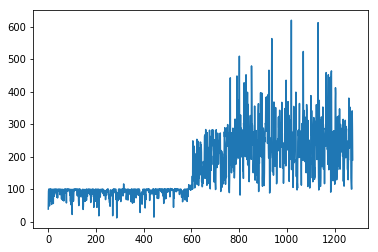

Time elapsed:37887.42341995239
| Reward: 215 | Episode: 1277 


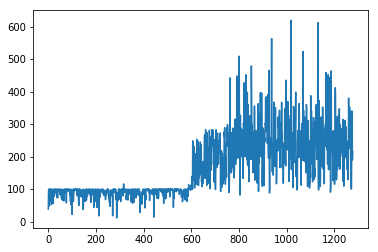

Time elapsed:37922.21353888512
| Reward: 333 | Episode: 1278 


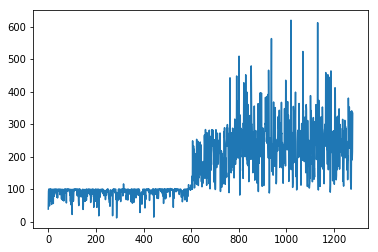

Time elapsed:37955.91715216637
| Reward: 579 | Episode: 1279 


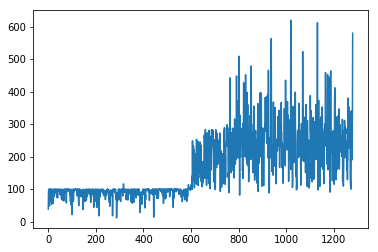

Time elapsed:37990.49136900902
| Reward: 209 | Episode: 1280 


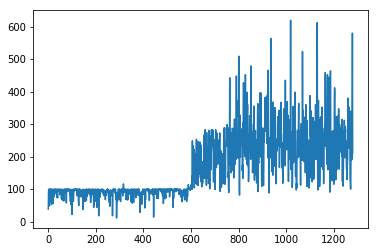

Time elapsed:38025.530354738235
| Reward: 422 | Episode: 1281 


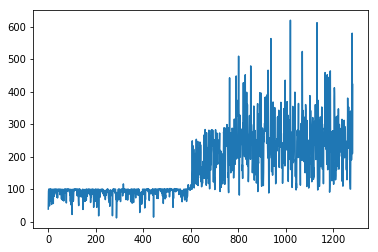

Time elapsed:38060.63036084175
| Reward: 214 | Episode: 1282 


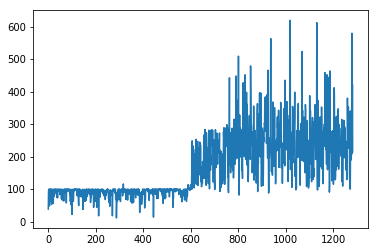

Time elapsed:38095.98366475105
| Reward: 111 | Episode: 1283 


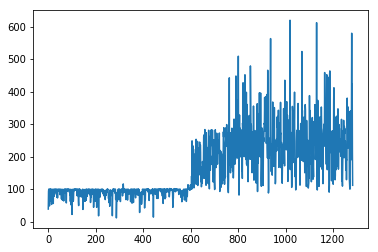

Time elapsed:38130.42381167412
| Reward: 100 | Episode: 1284 


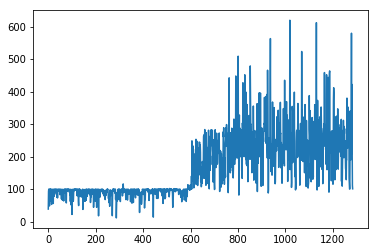

Time elapsed:38165.184824466705
| Reward: 295 | Episode: 1285 


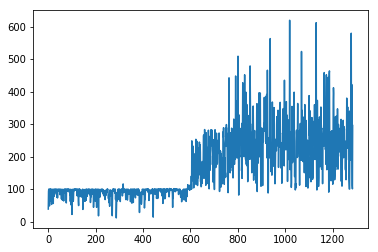

Time elapsed:38199.57717251778
| Reward: 297 | Episode: 1286 


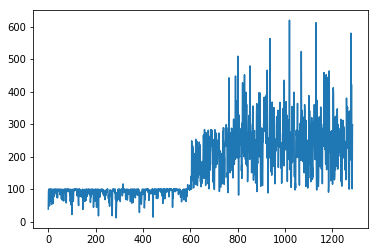

Time elapsed:38235.17236804962
| Reward: 240 | Episode: 1287 


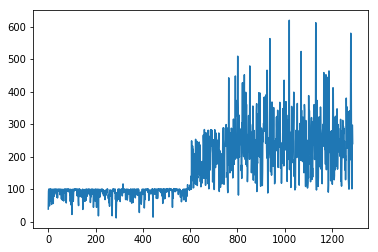

Time elapsed:38270.6858215332
| Reward: 339 | Episode: 1288 


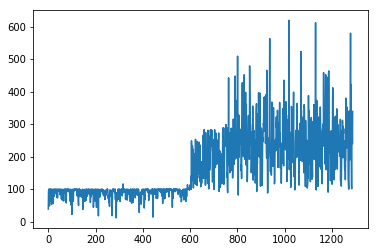

Time elapsed:38305.9712703228
| Reward: 303 | Episode: 1289 


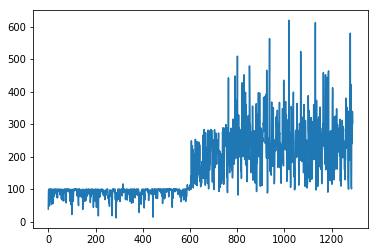

Time elapsed:38341.05351519585
| Reward: 346 | Episode: 1290 


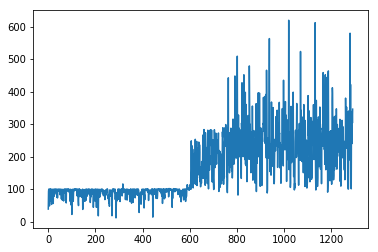

Time elapsed:38376.62554907799
| Reward: 278 | Episode: 1291 


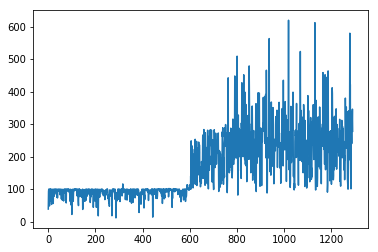

Time elapsed:38411.099292993546
| Reward: 219 | Episode: 1292 


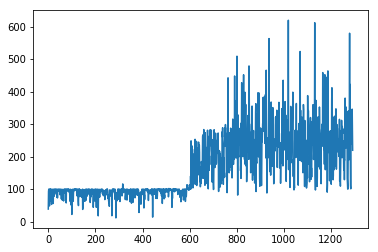

Time elapsed:38445.751162052155
| Reward: 187 | Episode: 1293 


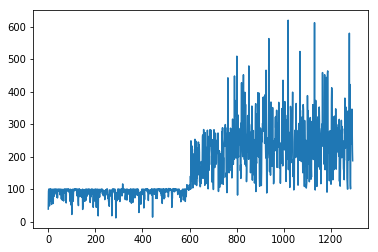

Time elapsed:38480.59873700142
| Reward: 260 | Episode: 1294 


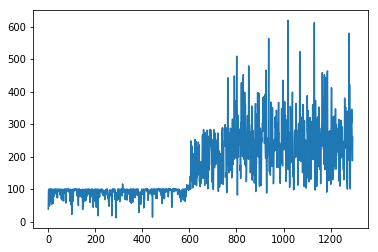

Time elapsed:38514.834882974625
| Reward: 205 | Episode: 1295 


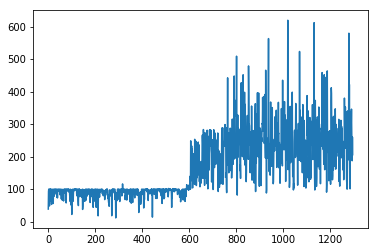

Time elapsed:38548.62071681023
| Reward: 221 | Episode: 1296 


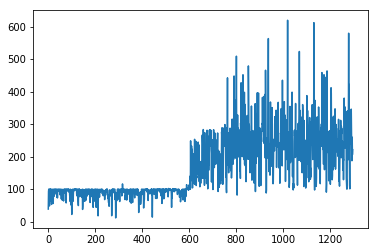

Time elapsed:38582.02729320526
| Reward: 261 | Episode: 1297 


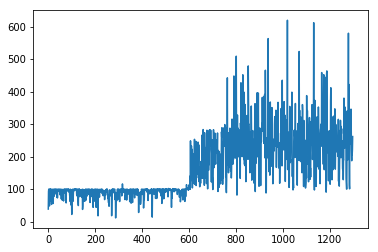

Time elapsed:38615.16070461273
| Reward: 152 | Episode: 1298 


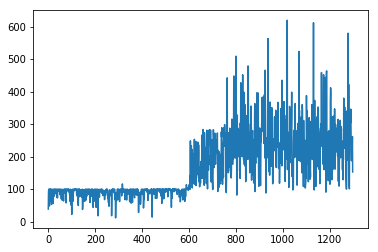

Time elapsed:38648.59839749336
| Reward: 216 | Episode: 1299 


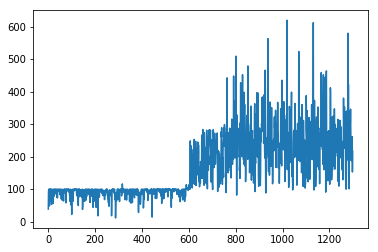

Time elapsed:38682.16562747955
| Reward: 192 | Episode: 1300 


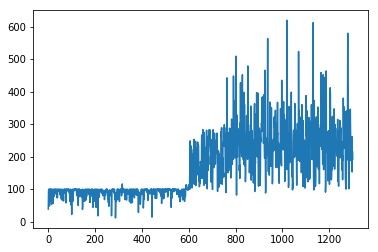

Time elapsed:38715.61043548584
| Reward: 160 | Episode: 1301 


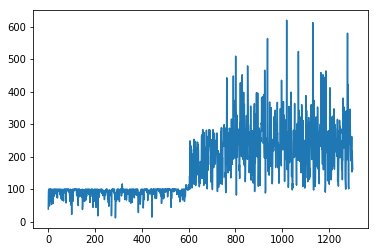

Time elapsed:38748.896555662155
| Reward: 218 | Episode: 1302 


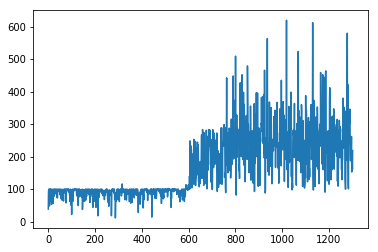

Time elapsed:38783.18735289574
| Reward: 268 | Episode: 1303 


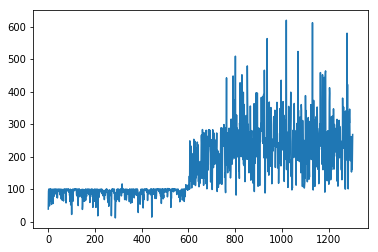

Time elapsed:38817.51876950264
| Reward: 234 | Episode: 1304 


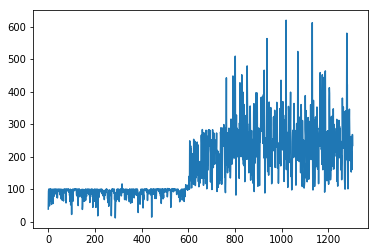

Time elapsed:38851.79205036163
| Reward: 119 | Episode: 1305 


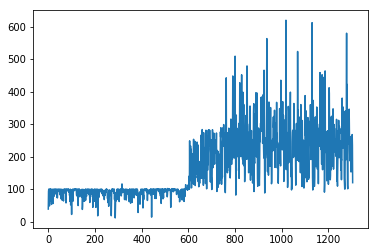

Time elapsed:38886.40201449394
| Reward: 125 | Episode: 1306 


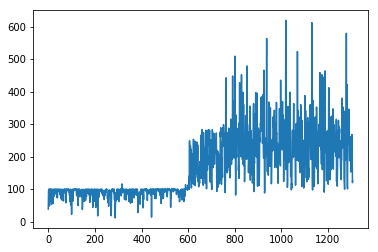

Time elapsed:38920.8868060112
| Reward: 238 | Episode: 1307 


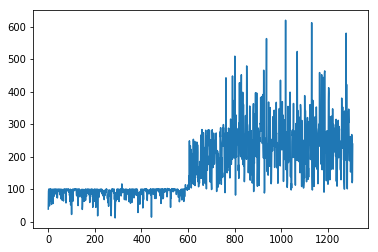

Time elapsed:38955.46523356438
| Reward: 217 | Episode: 1308 


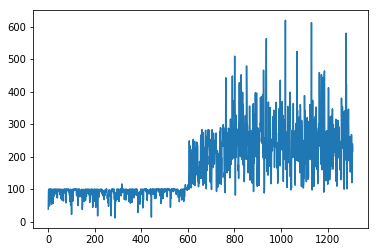

Time elapsed:38990.61681675911
| Reward: 176 | Episode: 1309 


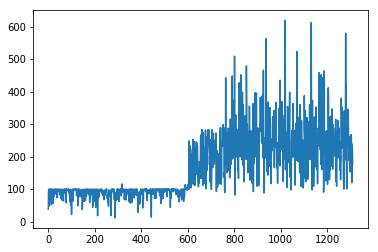

Time elapsed:39025.496811151505
| Reward: 387 | Episode: 1310 


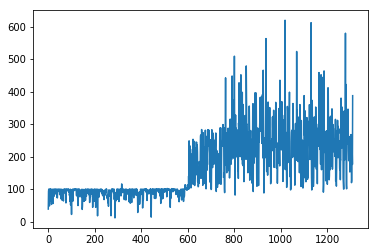

Time elapsed:39059.86732888222
| Reward: 371 | Episode: 1311 


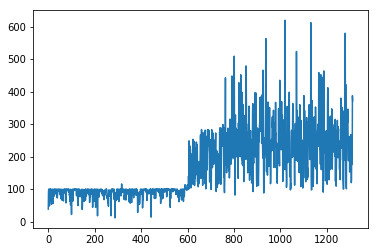

Time elapsed:39094.94514155388
| Reward: 149 | Episode: 1312 


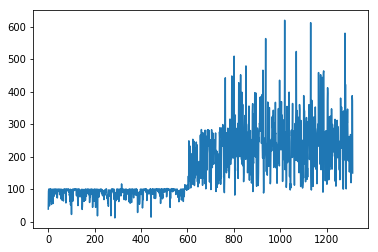

Time elapsed:39130.043998241425
| Reward: 525 | Episode: 1313 


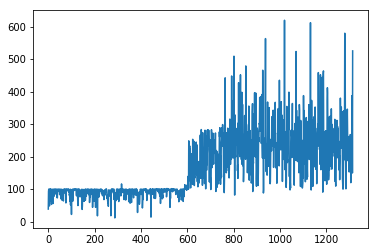

Time elapsed:39165.17493700981
| Reward: 144 | Episode: 1314 


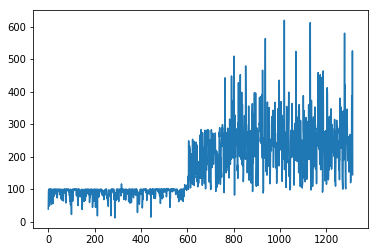

Time elapsed:39198.95548939705
| Reward: 189 | Episode: 1315 


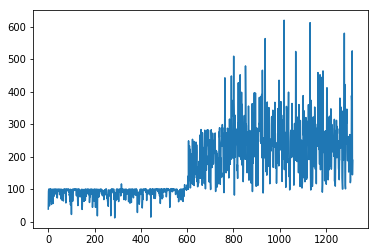

Time elapsed:39233.41904401779
| Reward: 263 | Episode: 1316 


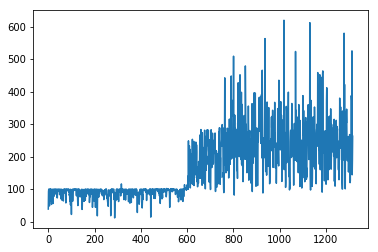

Time elapsed:39267.508023023605
| Reward: 234 | Episode: 1317 


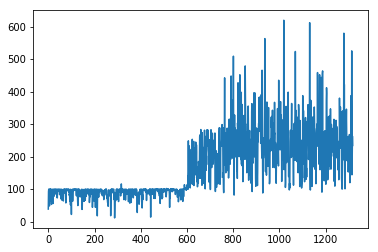

Time elapsed:39301.09237194061
| Reward: 279 | Episode: 1318 


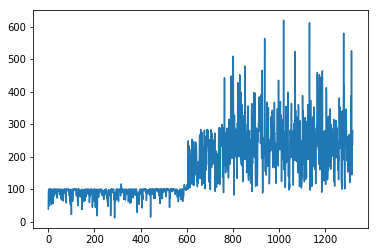

Time elapsed:39335.04383444786
| Reward: 181 | Episode: 1319 


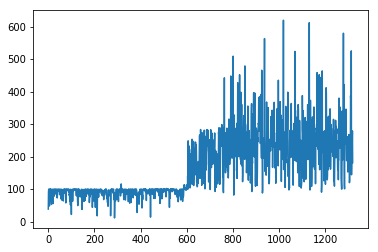

Time elapsed:39369.186348199844
| Reward: 232 | Episode: 1320 


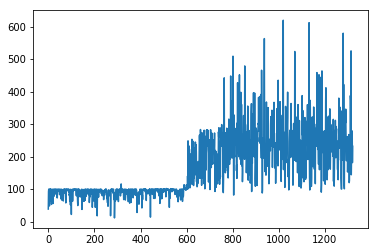

Time elapsed:39402.767557621
| Reward: 282 | Episode: 1321 


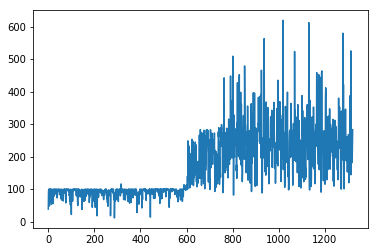

Time elapsed:39436.89933514595
| Reward: 384 | Episode: 1322 


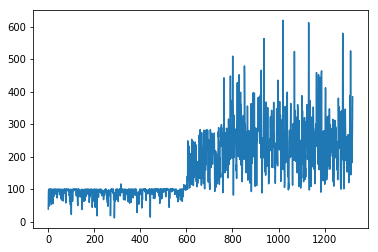

Time elapsed:39470.914847135544
| Reward: 579 | Episode: 1323 


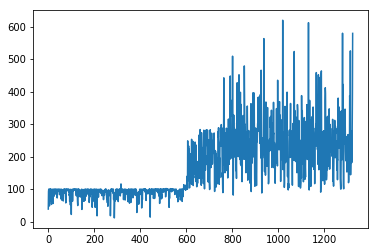

Time elapsed:39504.66974711418
| Reward: 425 | Episode: 1324 


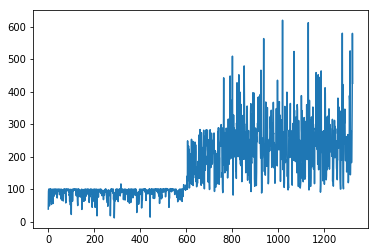

Time elapsed:39538.647137880325
| Reward: 281 | Episode: 1325 


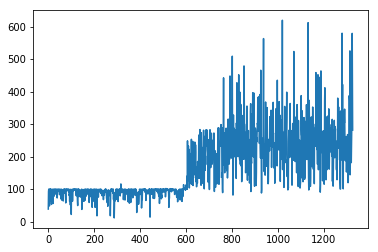

Time elapsed:39572.991753578186
| Reward: 226 | Episode: 1326 


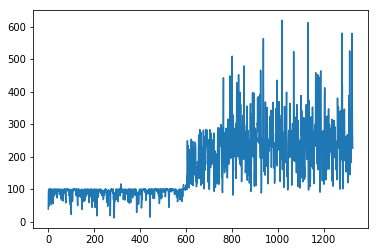

Time elapsed:39607.62483763695
| Reward: 163 | Episode: 1327 


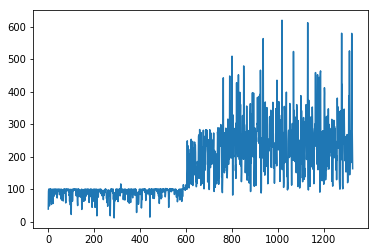

Time elapsed:39641.94579434395
| Reward: 371 | Episode: 1328 


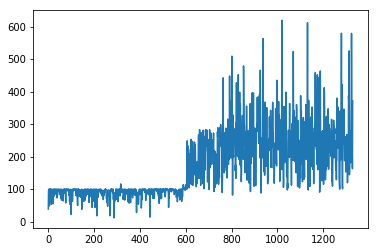

Time elapsed:39676.64889883995
| Reward: 323 | Episode: 1329 


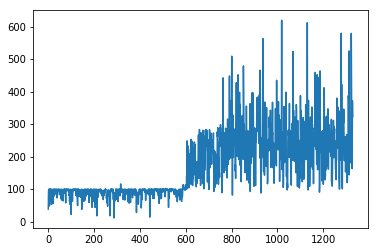

Time elapsed:39711.93577337265
| Reward: 204 | Episode: 1330 


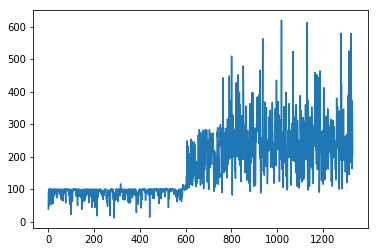

Time elapsed:39746.42582511902
| Reward: 220 | Episode: 1331 


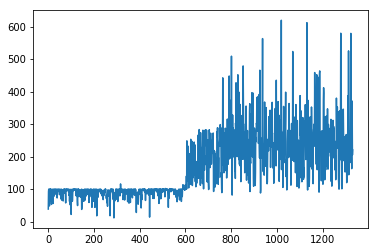

Time elapsed:39781.23296761513
| Reward: 339 | Episode: 1332 


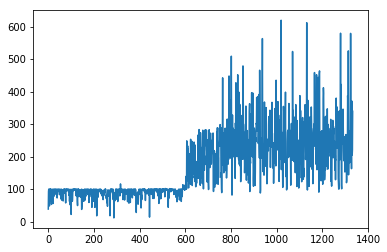

Time elapsed:39816.88985276222
| Reward: 377 | Episode: 1333 


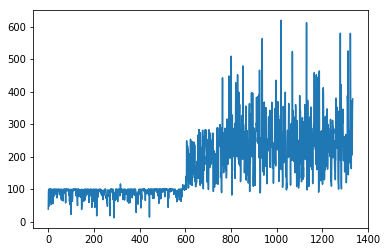

Time elapsed:39851.535165309906
| Reward: 228 | Episode: 1334 


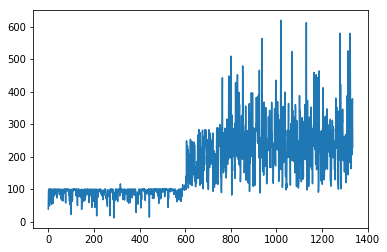

Time elapsed:39885.704463243484
| Reward: 393 | Episode: 1335 


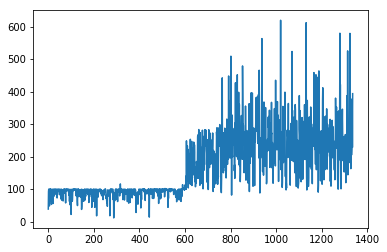

Time elapsed:39919.94758820534
| Reward: 273 | Episode: 1336 


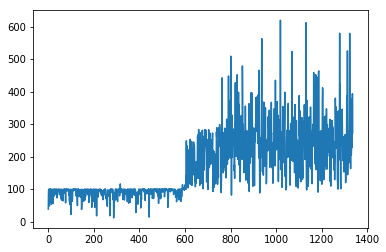

Time elapsed:39954.50993680954
| Reward: 386 | Episode: 1337 


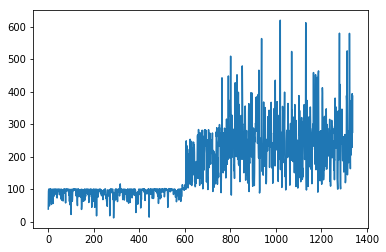

Time elapsed:39989.27138853073
| Reward: 276 | Episode: 1338 


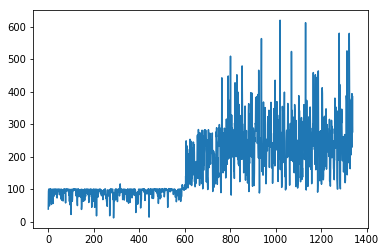

Time elapsed:40023.54093837738
| Reward: 58 | Episode: 1339 


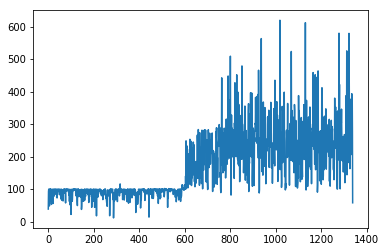

Time elapsed:40057.63643503189
| Reward: 211 | Episode: 1340 


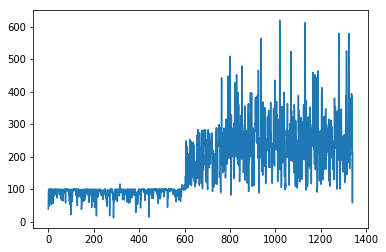

Time elapsed:40092.161373376846
| Reward: 214 | Episode: 1341 


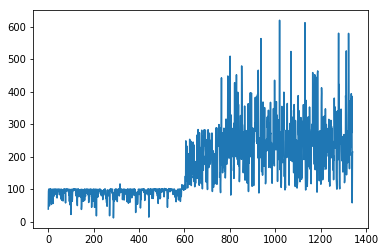

Time elapsed:40126.10316610336
| Reward: 405 | Episode: 1342 


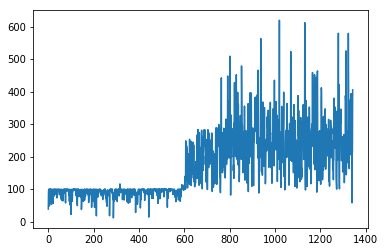

Time elapsed:40159.87398815155
| Reward: 165 | Episode: 1343 


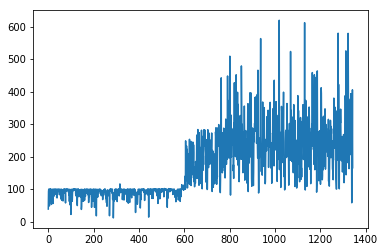

Time elapsed:40193.8430249691
| Reward: 266 | Episode: 1344 


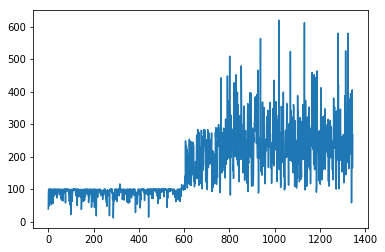

Time elapsed:40227.60241317749
| Reward: 192 | Episode: 1345 


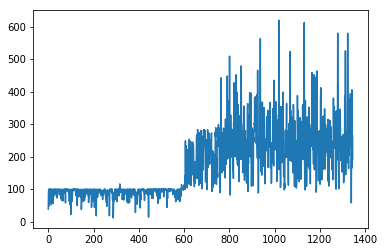

Time elapsed:40261.72935318947
| Reward: 260 | Episode: 1346 


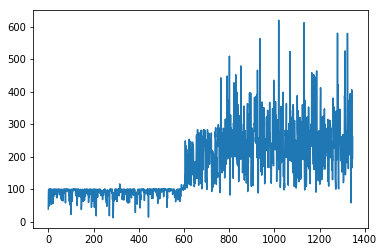

Time elapsed:40295.63751959801
| Reward: 234 | Episode: 1347 


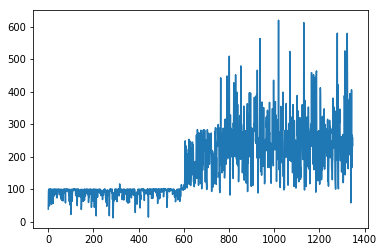

Time elapsed:40329.85421490669
| Reward: 188 | Episode: 1348 


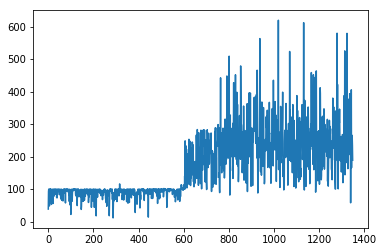

Time elapsed:40364.15338516235
| Reward: 183 | Episode: 1349 


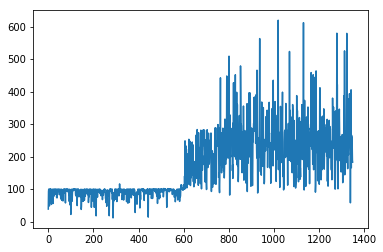

Time elapsed:40398.2653028965
| Reward: 327 | Episode: 1350 


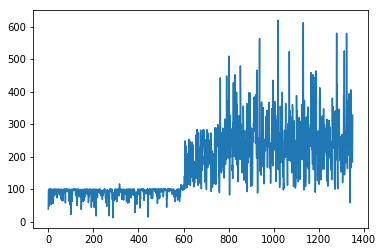

Time elapsed:40432.96457648277
| Reward: 425 | Episode: 1351 


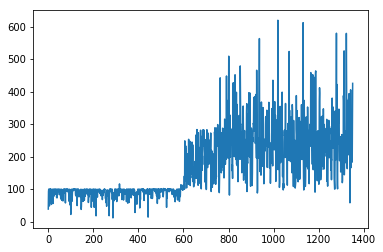

Time elapsed:40467.53982114792
| Reward: 277 | Episode: 1352 


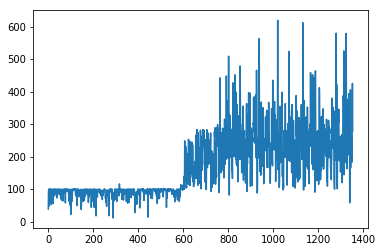

Time elapsed:40502.20541882515
| Reward: 268 | Episode: 1353 


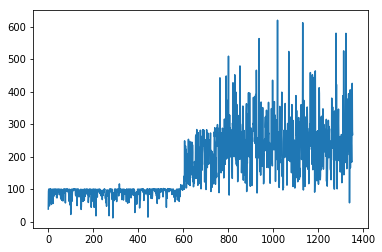

Time elapsed:40536.15048575401
| Reward: 210 | Episode: 1354 


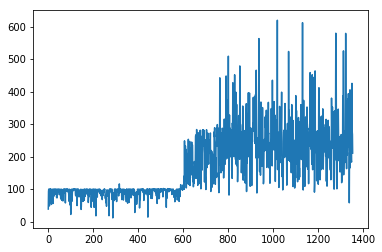

Time elapsed:40570.85871052742
| Reward: 223 | Episode: 1355 


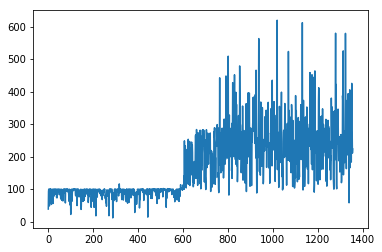

Time elapsed:40606.71314764023
| Reward: 348 | Episode: 1356 


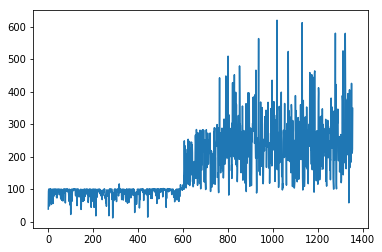

Time elapsed:40641.0208735466
| Reward: 371 | Episode: 1357 


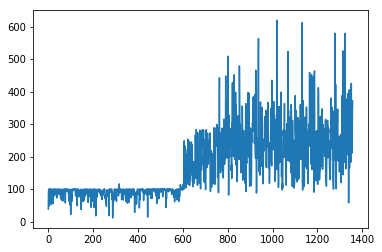

Time elapsed:40675.52833175659
| Reward: 292 | Episode: 1358 


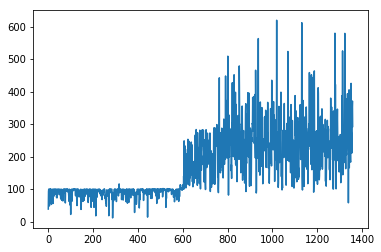

Time elapsed:40710.16052174568
| Reward: 281 | Episode: 1359 


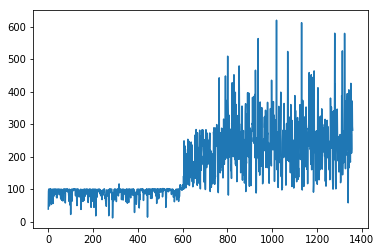

Time elapsed:40744.32604384422
| Reward: 213 | Episode: 1360 


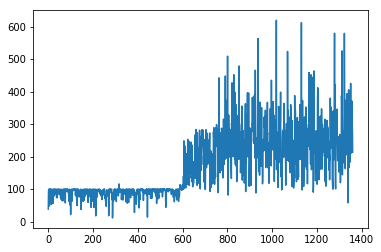

Time elapsed:40778.60120391846
| Reward: 253 | Episode: 1361 


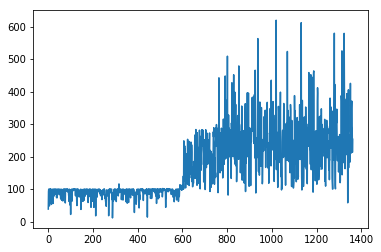

Time elapsed:40813.16238903999
| Reward: 215 | Episode: 1362 


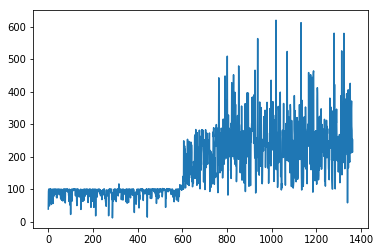

Time elapsed:40847.26828575134
| Reward: 203 | Episode: 1363 


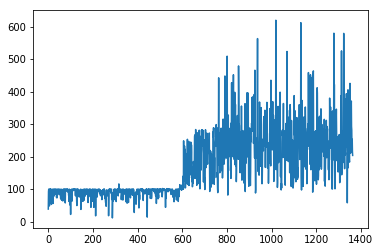

Time elapsed:40881.49928832054
| Reward: 379 | Episode: 1364 


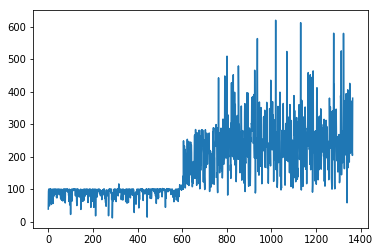

Time elapsed:40915.95892381668
| Reward: 365 | Episode: 1365 


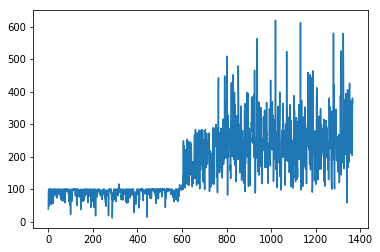

Time elapsed:40950.387358903885
| Reward: 435 | Episode: 1366 


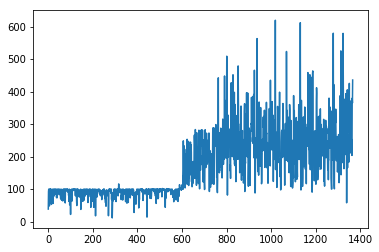

Time elapsed:40984.21215891838
| Reward: 259 | Episode: 1367 


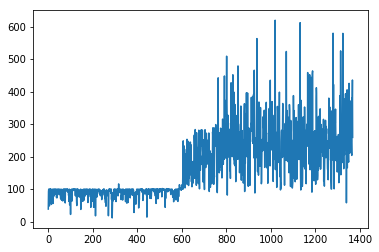

Time elapsed:41017.96266579628
| Reward: 434 | Episode: 1368 


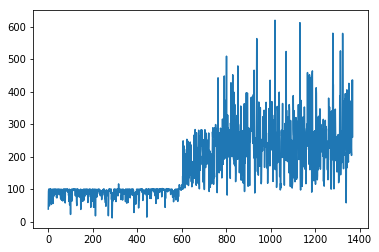

Time elapsed:41051.71305465698
| Reward: 285 | Episode: 1369 


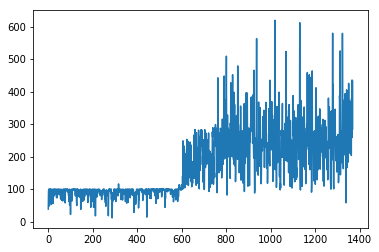

Time elapsed:41085.537548065186
| Reward: 319 | Episode: 1370 


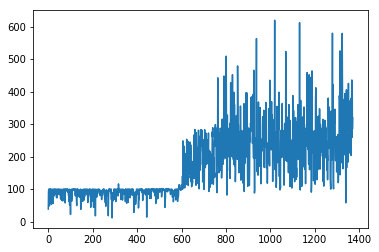

Time elapsed:41119.14317035675
| Reward: 137 | Episode: 1371 


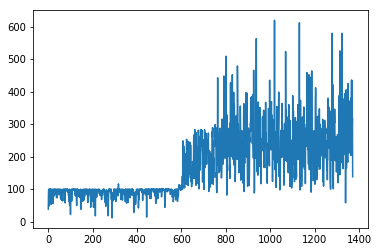

Time elapsed:41153.6799185276
| Reward: 139 | Episode: 1372 


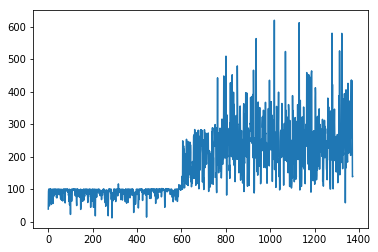

Time elapsed:41187.89201235771
| Reward: 259 | Episode: 1373 


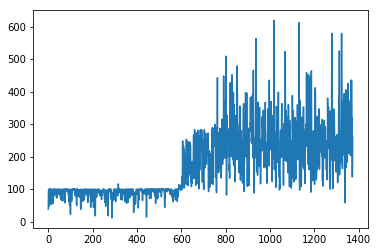

Time elapsed:41222.14700269699
| Reward: 230 | Episode: 1374 


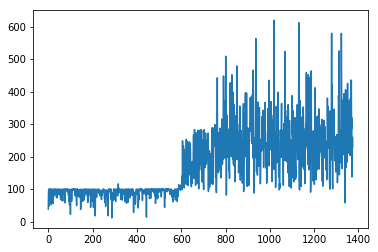

Time elapsed:41256.27181434631
| Reward: 191 | Episode: 1375 


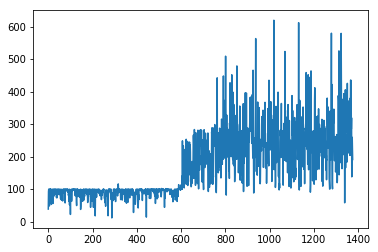

Time elapsed:41290.958837747574
| Reward: 192 | Episode: 1376 


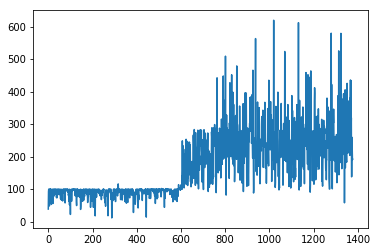

Time elapsed:41324.77127575874
| Reward: 188 | Episode: 1377 


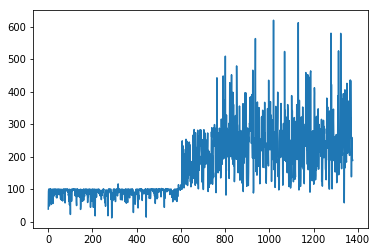

Time elapsed:41359.013597011566
| Reward: 298 | Episode: 1378 


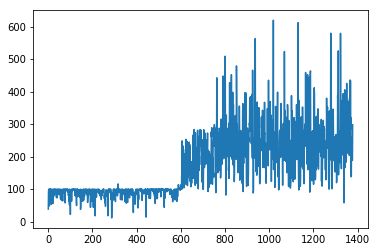

Time elapsed:41394.55348134041
| Reward: 275 | Episode: 1379 


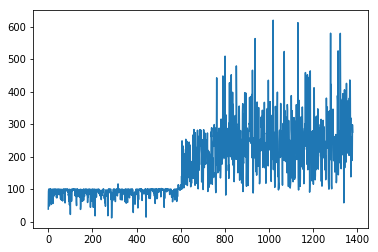

Time elapsed:41428.84197163582
| Reward: 141 | Episode: 1380 


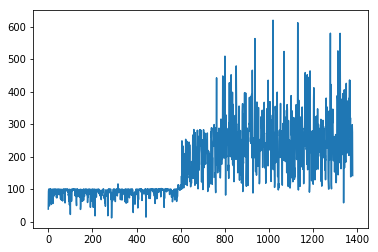

Time elapsed:41462.83062815666
| Reward: 268 | Episode: 1381 


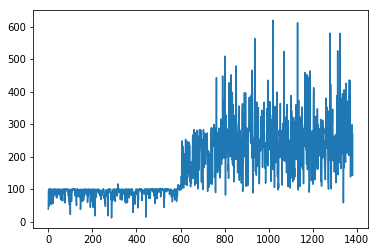

Time elapsed:41497.051859140396
| Reward: 234 | Episode: 1382 


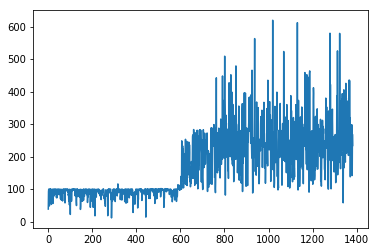

Time elapsed:41531.666202783585
| Reward: 223 | Episode: 1383 


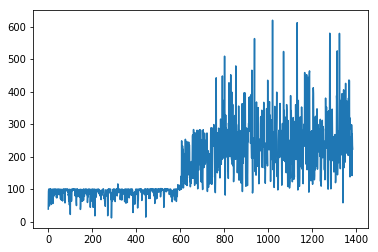

Time elapsed:41566.94459891319
| Reward: 237 | Episode: 1384 


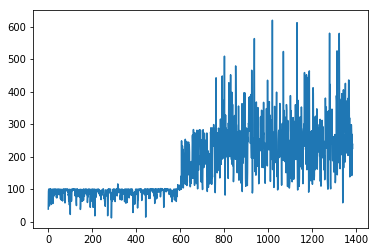

Time elapsed:41601.20086979866
| Reward: 359 | Episode: 1385 


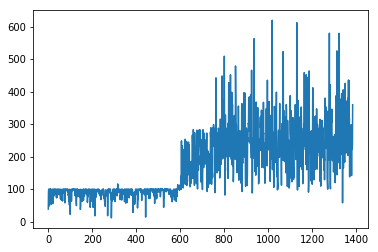

Time elapsed:41635.38426756859
| Reward: 242 | Episode: 1386 


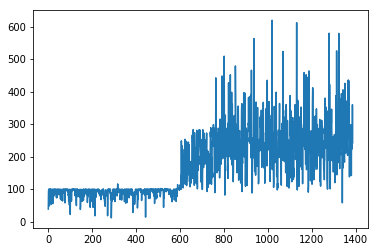

Time elapsed:41669.28582596779
| Reward: 320 | Episode: 1387 


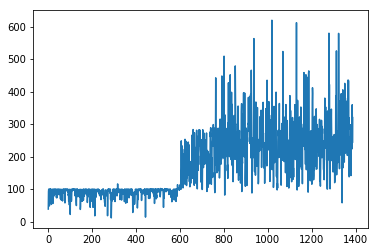

Time elapsed:41703.292333841324
| Reward: 130 | Episode: 1388 


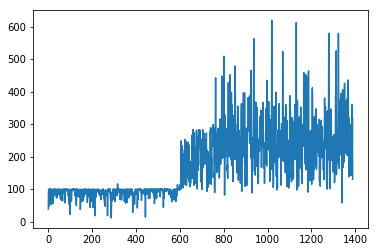

Time elapsed:41737.17207622528
| Reward: 201 | Episode: 1389 


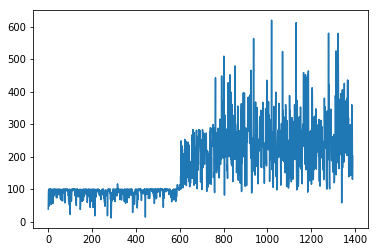

Time elapsed:41771.9270567894
| Reward: 124 | Episode: 1390 


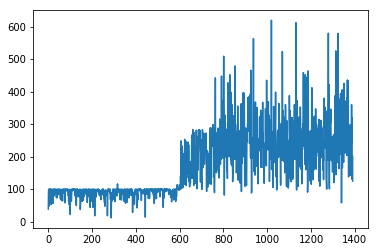

Time elapsed:41805.21243047714
| Reward: 196 | Episode: 1391 


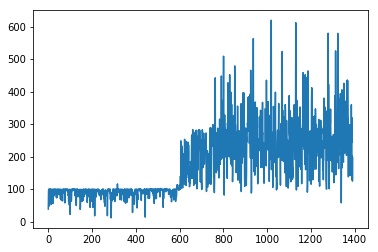

Time elapsed:41838.6721470356
| Reward: 278 | Episode: 1392 


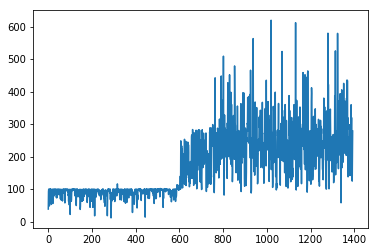

Time elapsed:41872.44229078293
| Reward: 233 | Episode: 1393 


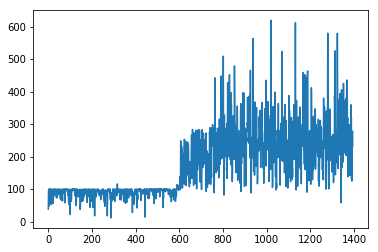

Time elapsed:41906.170769929886
| Reward: 207 | Episode: 1394 


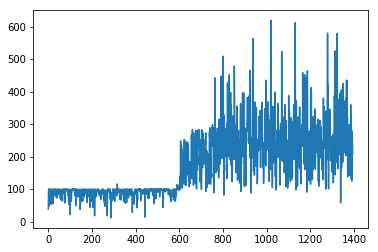

Time elapsed:41940.12542581558
| Reward: 307 | Episode: 1395 


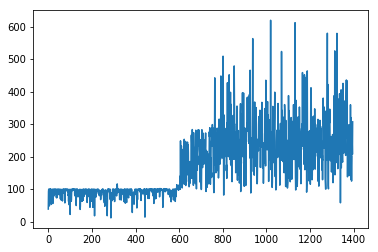

Time elapsed:41975.26642727852
| Reward: 332 | Episode: 1396 


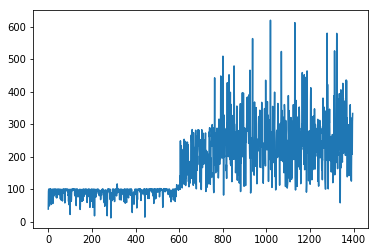

Time elapsed:42010.242028713226
| Reward: 288 | Episode: 1397 


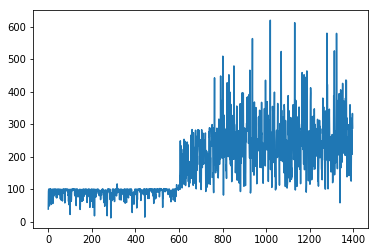

Time elapsed:42044.82499074936
| Reward: 330 | Episode: 1398 


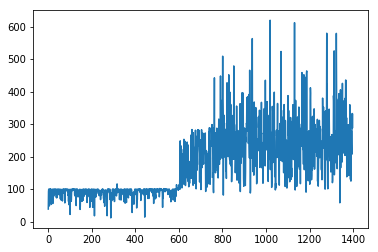

Time elapsed:42079.33675003052
| Reward: 193 | Episode: 1399 


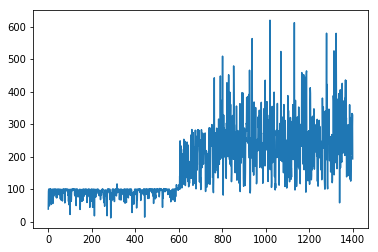

Time elapsed:42114.276691913605
| Reward: 229 | Episode: 1400 


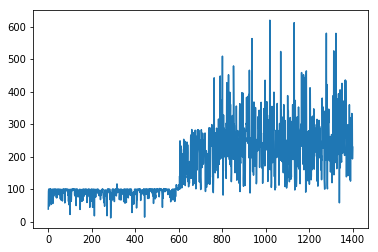

Time elapsed:42149.89767050743
| Reward: 317 | Episode: 1401 


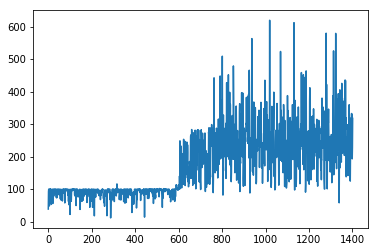

Time elapsed:42184.15884590149
| Reward: 329 | Episode: 1402 


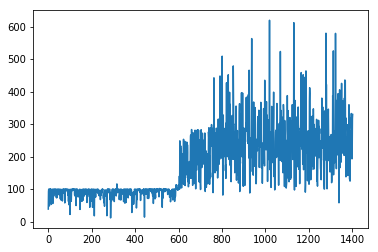

Time elapsed:42218.03889846802
| Reward: 165 | Episode: 1403 


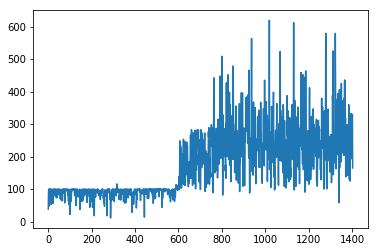

Time elapsed:42252.819843530655
| Reward: 253 | Episode: 1404 


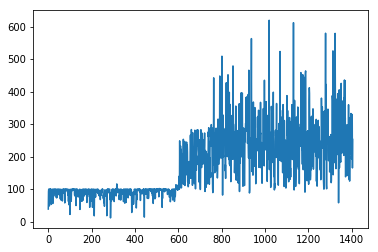

Time elapsed:42287.20204091072
| Reward: 245 | Episode: 1405 


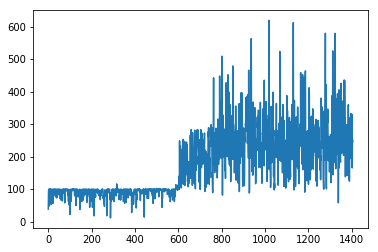

Time elapsed:42321.26778173447
| Reward: 285 | Episode: 1406 


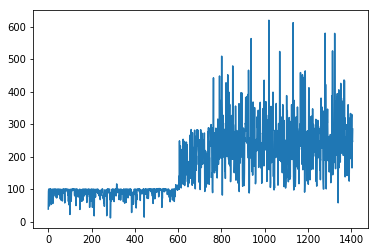

Time elapsed:42355.58566904068
| Reward: 105 | Episode: 1407 


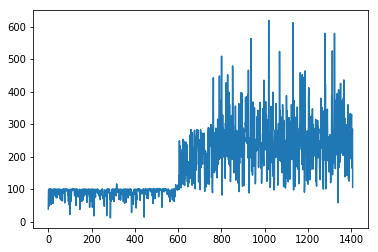

Time elapsed:42389.753465652466
| Reward: 208 | Episode: 1408 


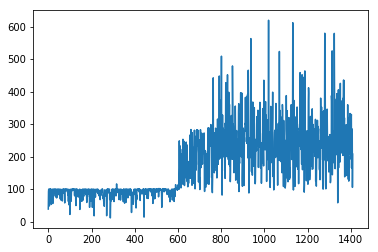

Time elapsed:42423.8420894146
| Reward: 217 | Episode: 1409 


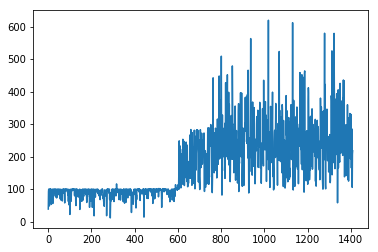

Time elapsed:42457.903326272964
| Reward: 166 | Episode: 1410 


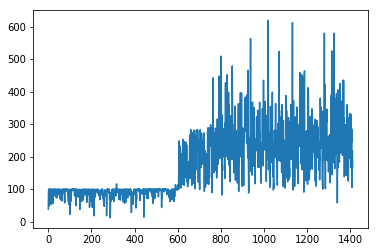

Time elapsed:42493.4944498539
| Reward: 290 | Episode: 1411 


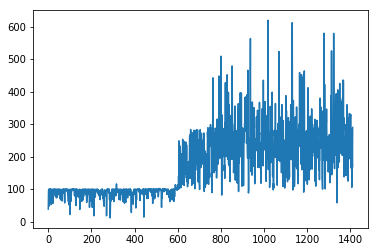

Time elapsed:42527.47427225113
| Reward: 186 | Episode: 1412 


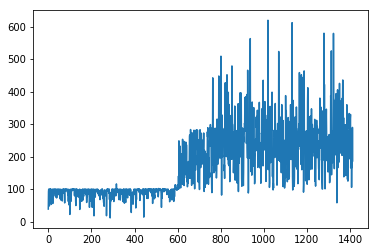

Time elapsed:42562.37911224365
| Reward: 203 | Episode: 1413 


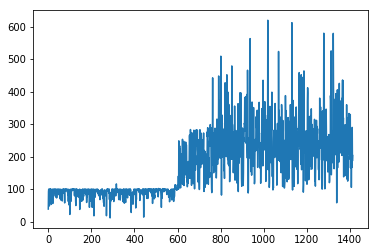

Time elapsed:42597.35865664482
| Reward: 243 | Episode: 1414 


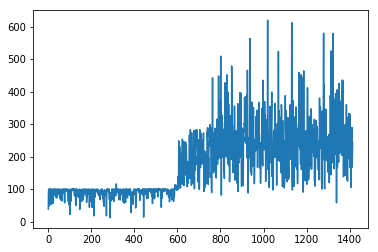

Time elapsed:42631.16492271423
| Reward: 258 | Episode: 1415 


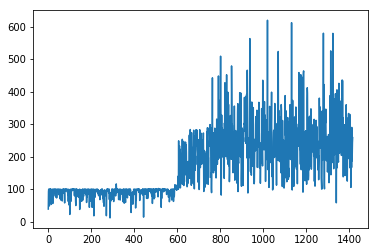

Time elapsed:42665.711695194244
| Reward: 167 | Episode: 1416 


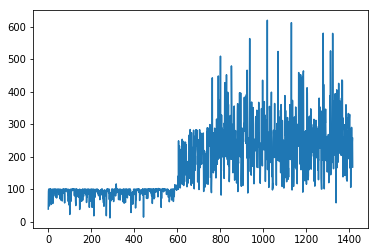

Time elapsed:42699.39282488823
| Reward: 145 | Episode: 1417 


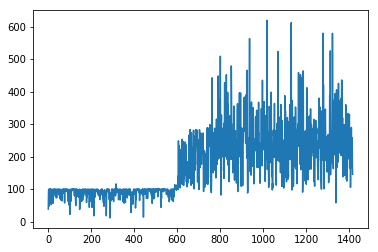

Time elapsed:42733.96872925758
| Reward: 273 | Episode: 1418 


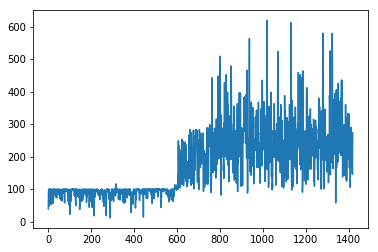

Time elapsed:42769.14375329018
| Reward: 226 | Episode: 1419 


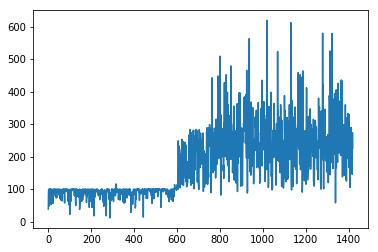

Time elapsed:42804.47357106209
| Reward: 223 | Episode: 1420 


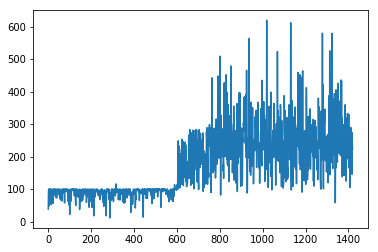

Time elapsed:42840.445125579834
| Reward: 203 | Episode: 1421 


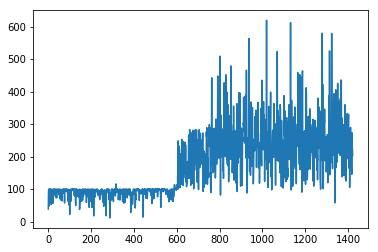

Time elapsed:42875.48087930679
| Reward: 210 | Episode: 1422 


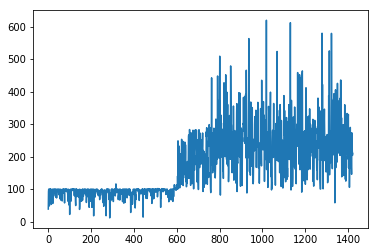

Time elapsed:42911.083241701126
| Reward: 187 | Episode: 1423 


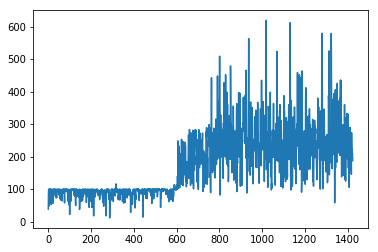

Time elapsed:42946.90034985542
| Reward: 156 | Episode: 1424 


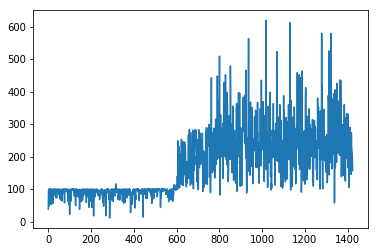

Time elapsed:42982.86207199097
| Reward: 275 | Episode: 1425 


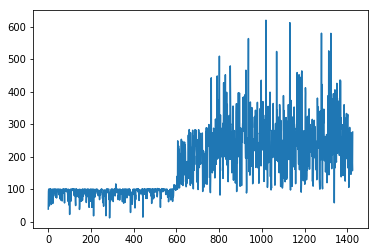

Time elapsed:43017.40995430946
| Reward: 195 | Episode: 1426 


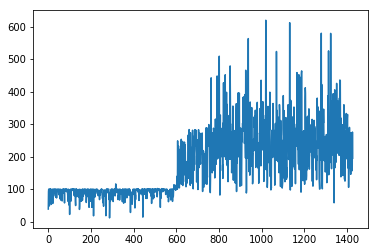

Time elapsed:43052.51977348328
| Reward: 218 | Episode: 1427 


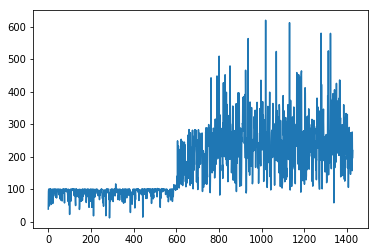

Time elapsed:43088.904695272446
| Reward: 183 | Episode: 1428 


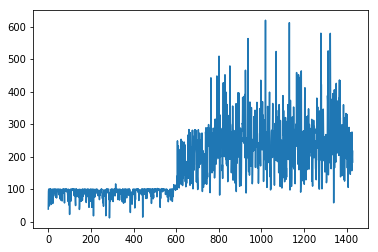

Time elapsed:43124.87166213989
| Reward: 217 | Episode: 1429 


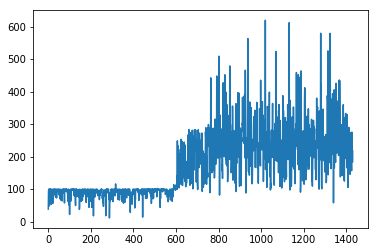

Time elapsed:43159.49989056587
| Reward: 185 | Episode: 1430 


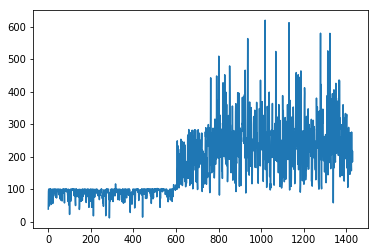

Time elapsed:43193.9795320034
| Reward: 287 | Episode: 1431 


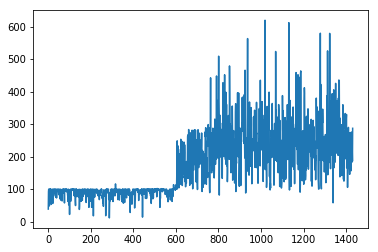

Time elapsed:43229.53620529175
| Reward: 303 | Episode: 1432 


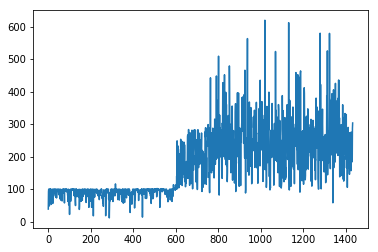

Time elapsed:43265.06565284729
| Reward: 461 | Episode: 1433 


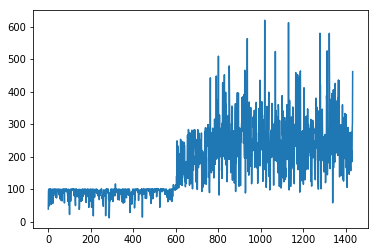

Time elapsed:43300.5643222332
| Reward: 554 | Episode: 1434 


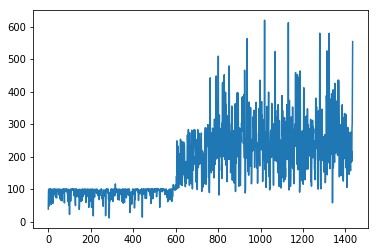

Time elapsed:43336.311026096344
| Reward: 111 | Episode: 1435 


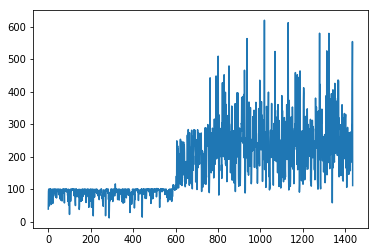

Time elapsed:43371.296375989914
| Reward: 157 | Episode: 1436 


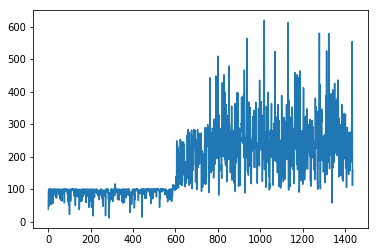

Time elapsed:43406.365315914154
| Reward: 277 | Episode: 1437 


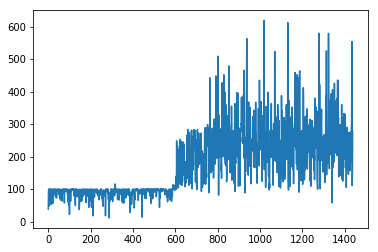

Time elapsed:43441.91048741341
| Reward: 381 | Episode: 1438 


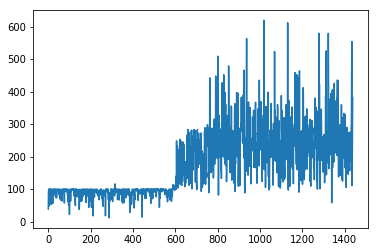

Time elapsed:43476.31279540062
| Reward: 162 | Episode: 1439 


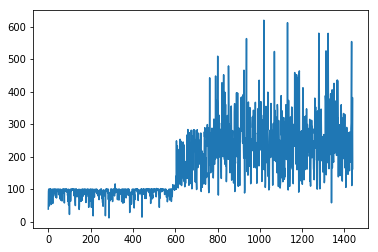

Time elapsed:43510.6282658577
| Reward: 246 | Episode: 1440 


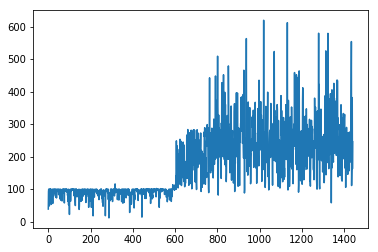

Time elapsed:43545.424399614334
| Reward: 294 | Episode: 1441 


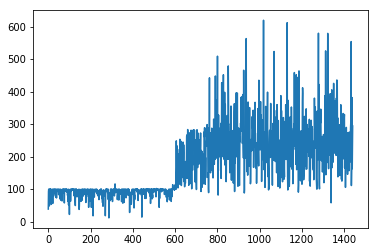

Time elapsed:43579.83361721039
| Reward: 534 | Episode: 1442 


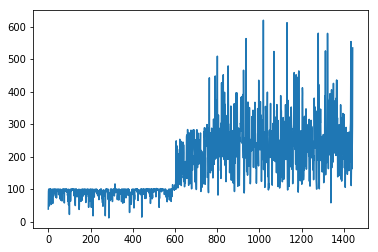

Time elapsed:43615.21646785736
| Reward: 217 | Episode: 1443 


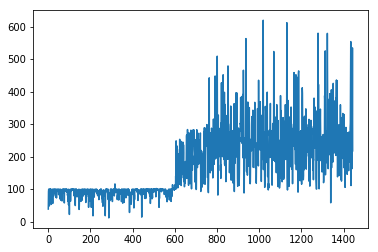

Time elapsed:43649.6055996418
| Reward: 319 | Episode: 1444 


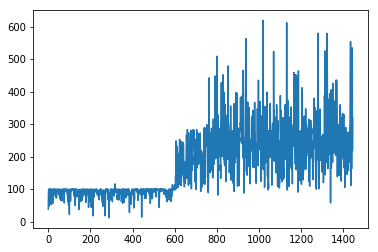

Time elapsed:43685.627228975296
| Reward: 233 | Episode: 1445 


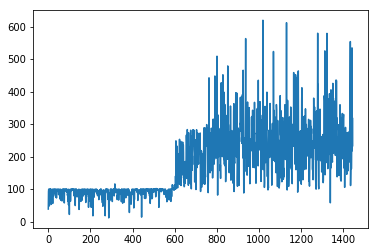

Time elapsed:43720.27396130562
| Reward: 265 | Episode: 1446 


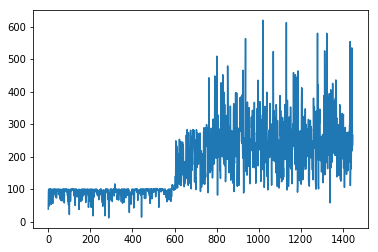

Time elapsed:43755.19471693039
| Reward: 316 | Episode: 1447 


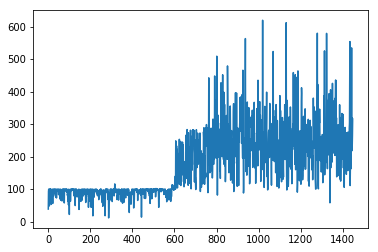

Time elapsed:43789.703273534775
| Reward: 241 | Episode: 1448 


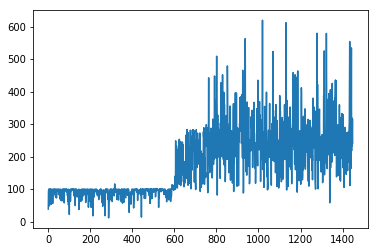

Time elapsed:43824.306604623795
| Reward: 338 | Episode: 1449 


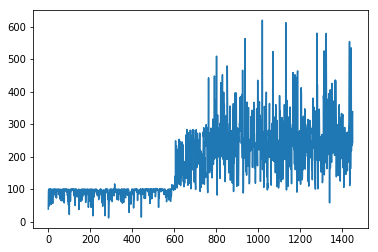

Time elapsed:43860.11950850487
| Reward: 177 | Episode: 1450 


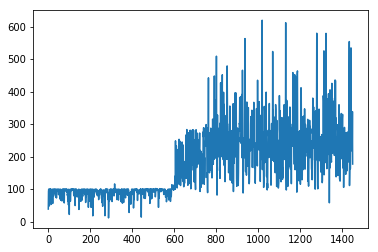

Time elapsed:43895.98316025734
| Reward: 149 | Episode: 1451 


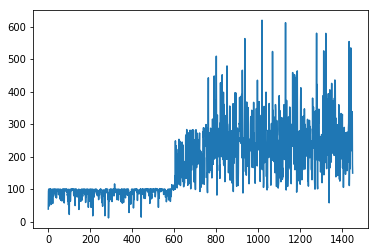

Time elapsed:43931.18859052658
| Reward: 236 | Episode: 1452 


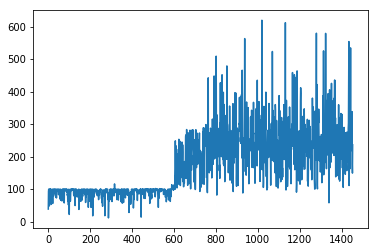

Time elapsed:43966.31321144104
| Reward: 245 | Episode: 1453 


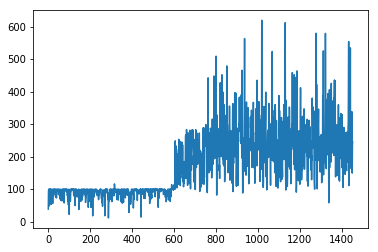

Time elapsed:44001.894471883774
| Reward: 219 | Episode: 1454 


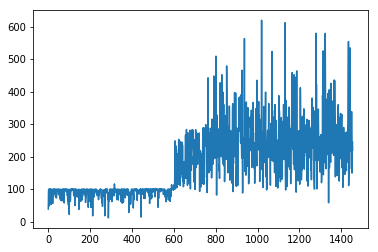

Time elapsed:44037.68671751022
| Reward: 151 | Episode: 1455 


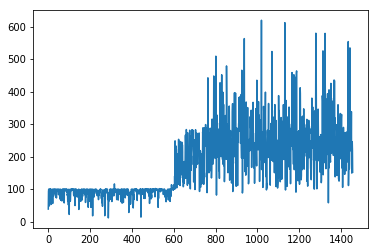

Time elapsed:44073.65046906471
| Reward: 164 | Episode: 1456 


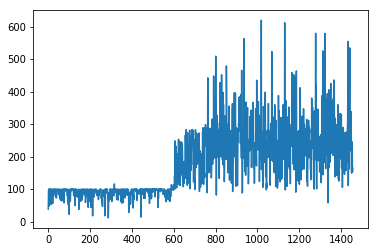

Time elapsed:44108.538586854935
| Reward: 177 | Episode: 1457 


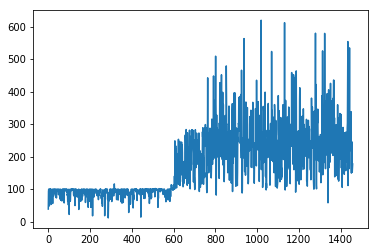

Time elapsed:44143.41125535965
| Reward: 270 | Episode: 1458 


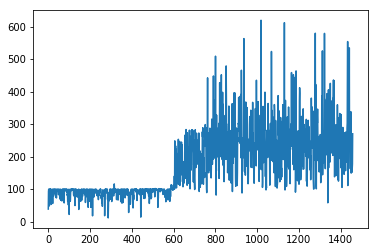

Time elapsed:44177.33623409271
| Reward: 182 | Episode: 1459 


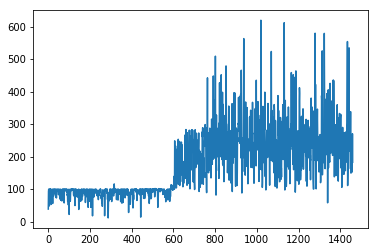

Time elapsed:44210.95184016228
| Reward: 498 | Episode: 1460 


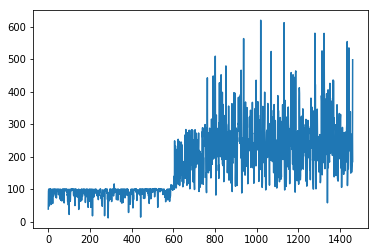

Time elapsed:44244.48698043823
| Reward: 197 | Episode: 1461 


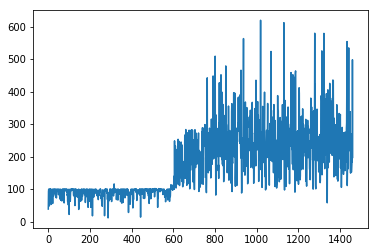

Time elapsed:44278.046114206314
| Reward: 410 | Episode: 1462 


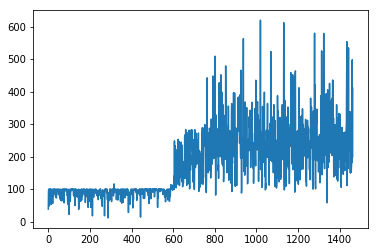

Time elapsed:44312.33191680908
| Reward: 483 | Episode: 1463 


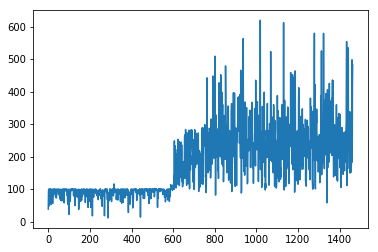

Time elapsed:44346.553614377975
| Reward: 301 | Episode: 1464 


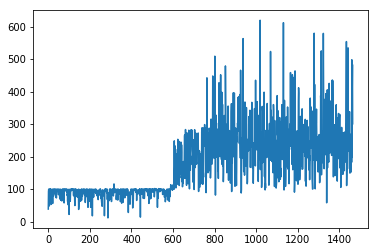

Time elapsed:44381.0548517704
| Reward: 270 | Episode: 1465 


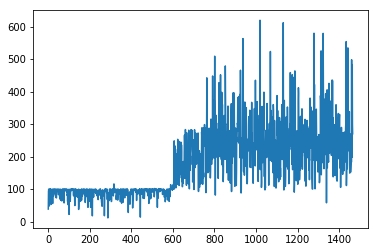

Time elapsed:44415.40588068962
| Reward: 252 | Episode: 1466 


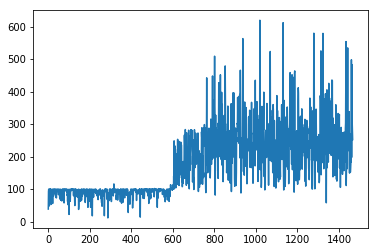

Time elapsed:44449.52261209488
| Reward: 162 | Episode: 1467 


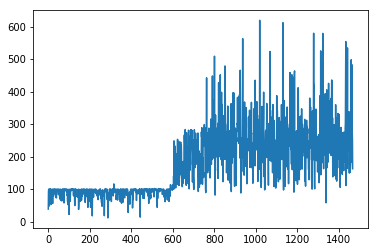

Time elapsed:44483.91894316673
| Reward: 245 | Episode: 1468 


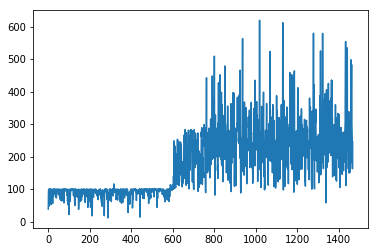

Time elapsed:44518.74251484871
| Reward: 177 | Episode: 1469 


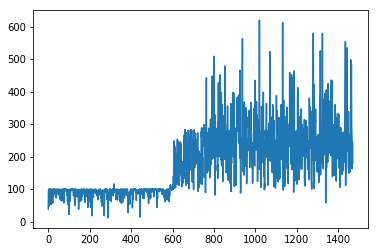

Time elapsed:44553.75959563255
| Reward: 291 | Episode: 1470 


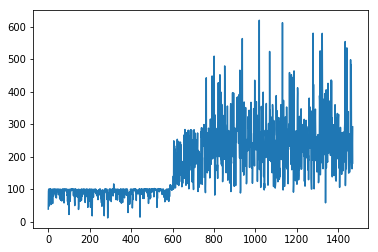

Time elapsed:44588.32558941841
| Reward: 248 | Episode: 1471 


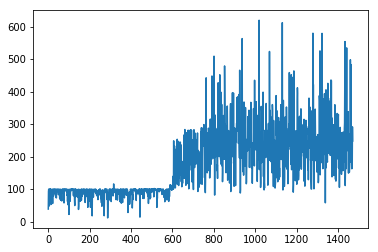

Time elapsed:44624.1248459816
| Reward: 268 | Episode: 1472 


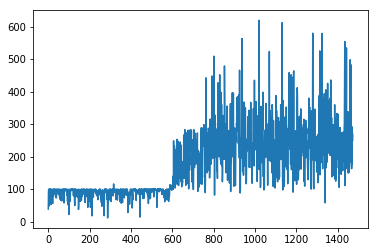

Time elapsed:44660.13944196701
| Reward: 268 | Episode: 1473 


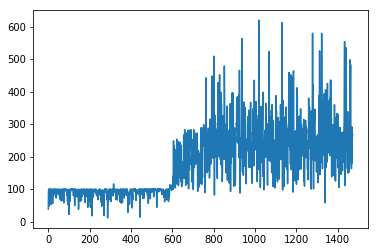

Time elapsed:44695.8424243927
| Reward: 217 | Episode: 1474 


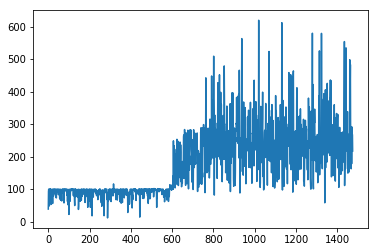

Time elapsed:44730.17811870575
| Reward: 293 | Episode: 1475 


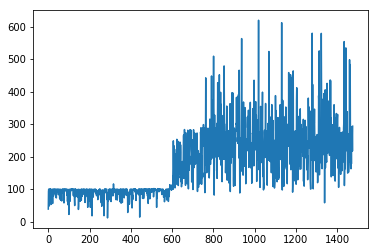

Time elapsed:44764.829194784164
| Reward: 337 | Episode: 1476 


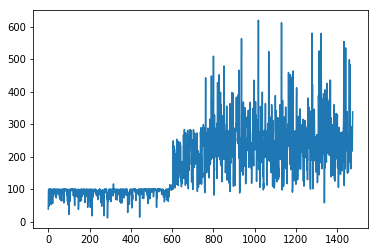

Time elapsed:44800.70499944687
| Reward: 187 | Episode: 1477 


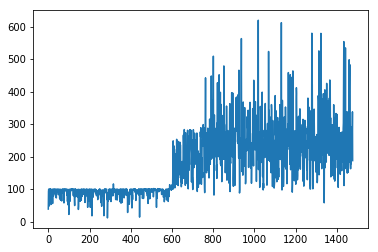

Time elapsed:44835.47413492203
| Reward: 273 | Episode: 1478 


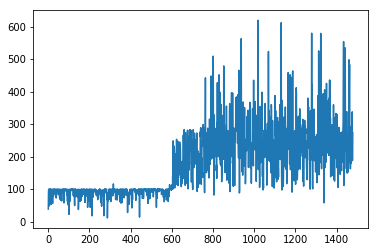

Time elapsed:44871.027128219604
| Reward: 226 | Episode: 1479 


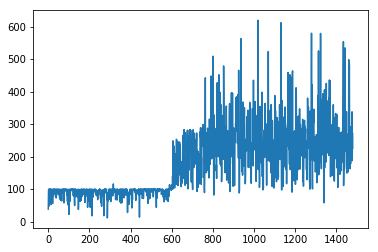

Time elapsed:44906.546931266785
| Reward: 106 | Episode: 1480 


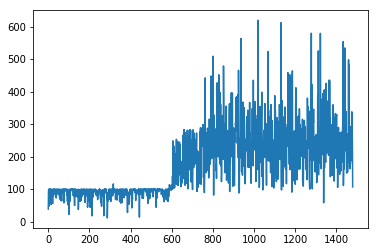

Time elapsed:44942.091457128525
| Reward: 280 | Episode: 1481 


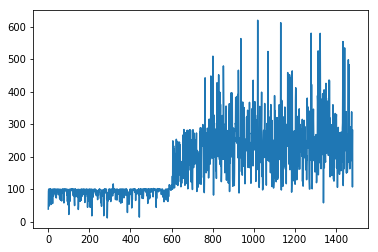

Time elapsed:44976.49099230766
| Reward: 307 | Episode: 1482 


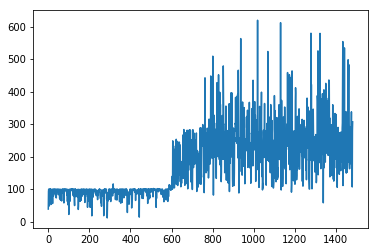

Time elapsed:45010.59502720833
| Reward: 233 | Episode: 1483 


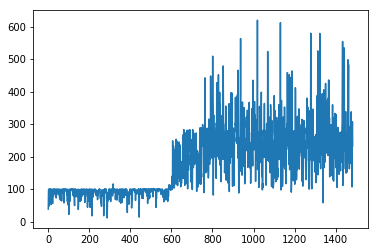

Time elapsed:45044.67026758194
| Reward: 329 | Episode: 1484 


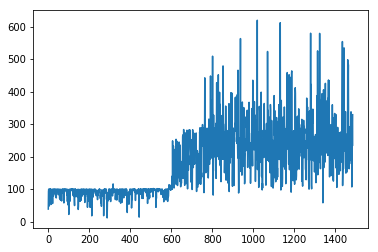

Time elapsed:45078.49434065819
| Reward: 440 | Episode: 1485 


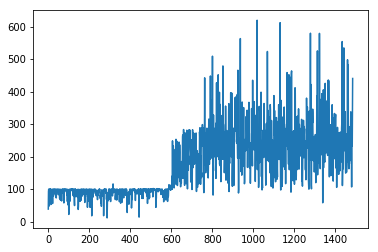

Time elapsed:45114.60011053085
| Reward: 298 | Episode: 1486 


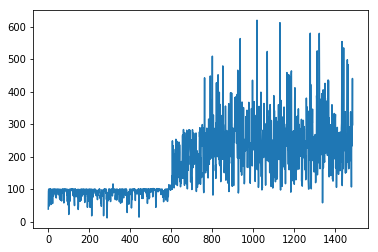

Time elapsed:45149.13480067253
| Reward: 389 | Episode: 1487 


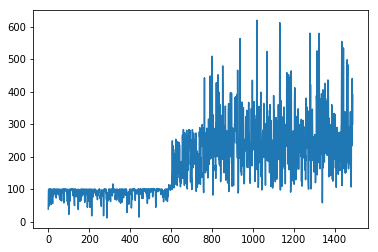

Time elapsed:45184.79747509956
| Reward: 358 | Episode: 1488 


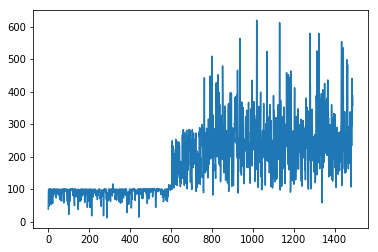

Time elapsed:45219.92335653305
| Reward: 152 | Episode: 1489 


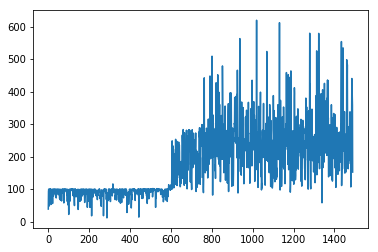

Time elapsed:45255.90229845047
| Reward: 134 | Episode: 1490 


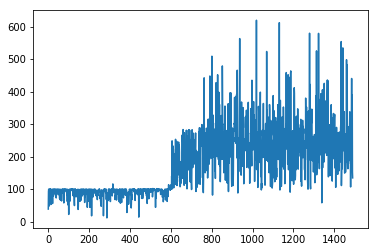

Time elapsed:45291.55554461479
| Reward: 180 | Episode: 1491 


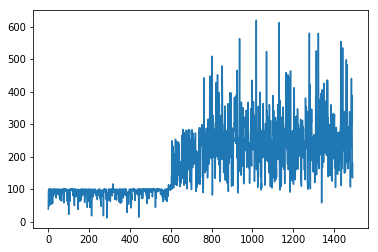

Time elapsed:45325.76962971687
| Reward: 239 | Episode: 1492 


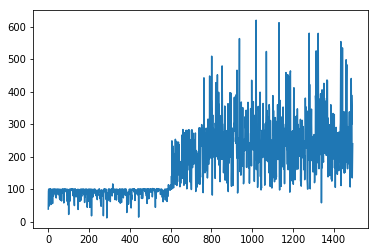

Time elapsed:45360.761524915695
| Reward: 269 | Episode: 1493 


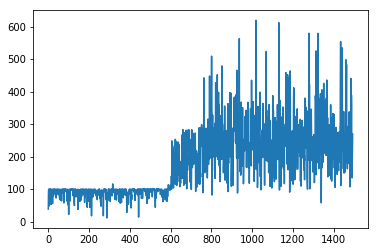

Time elapsed:45396.131867170334
| Reward: 172 | Episode: 1494 


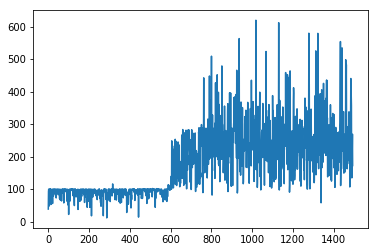

Time elapsed:45430.83963274956
| Reward: 218 | Episode: 1495 


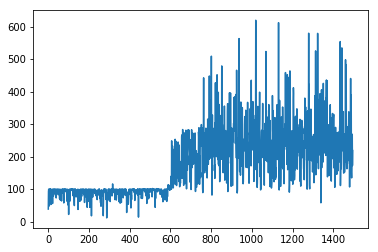

Time elapsed:45465.53177666664
| Reward: 518 | Episode: 1496 


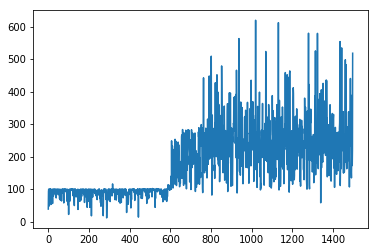

Time elapsed:45501.3806283474
| Reward: 114 | Episode: 1497 


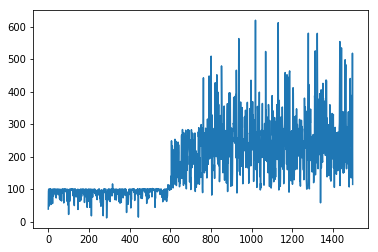

Time elapsed:45536.82031440735
| Reward: 213 | Episode: 1498 


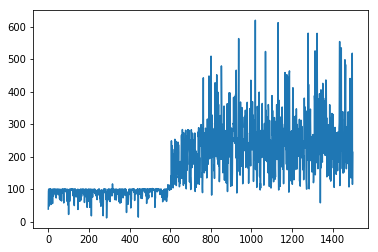

Time elapsed:45571.20577144623
| Reward: 327 | Episode: 1499 


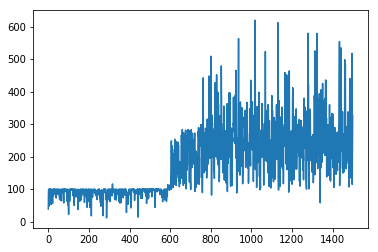

Time elapsed:45605.54506778717
| Reward: 154 | Episode: 1500 


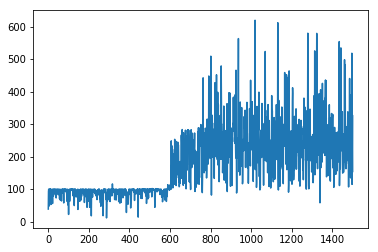

Time elapsed:45640.87231373787
| Reward: 215 | Episode: 1501 


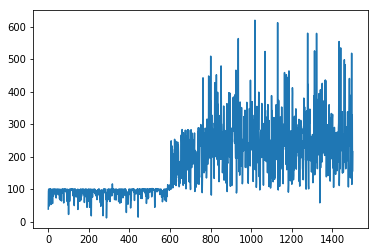

Time elapsed:45676.038445711136
| Reward: 303 | Episode: 1502 


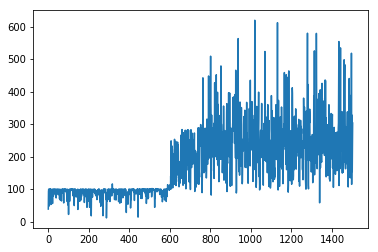

Time elapsed:45711.1218829155
| Reward: 213 | Episode: 1503 


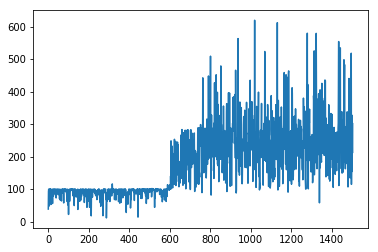

Time elapsed:45746.32307434082
| Reward: 257 | Episode: 1504 


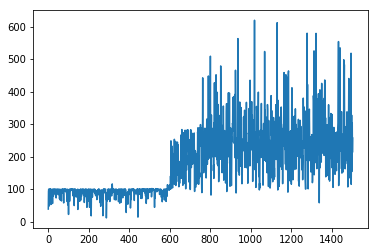

Time elapsed:45781.4487695694
| Reward: 306 | Episode: 1505 


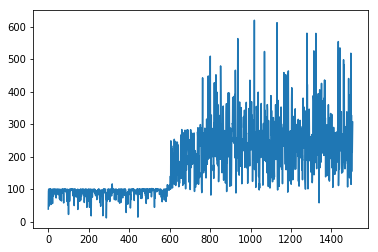

Time elapsed:45816.17146778107
| Reward: 318 | Episode: 1506 


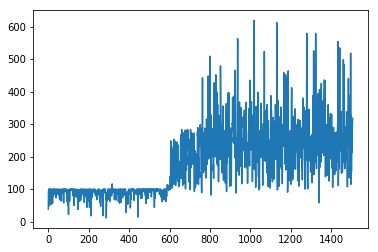

Time elapsed:45851.15629315376
| Reward: 221 | Episode: 1507 


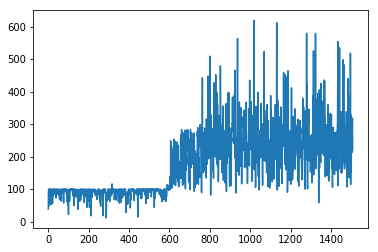

Time elapsed:45886.90120077133
| Reward: 258 | Episode: 1508 


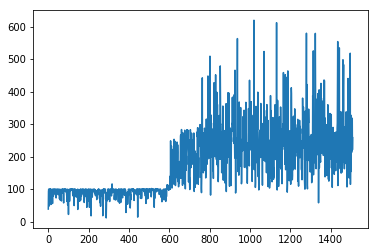

Time elapsed:45921.90765428543
| Reward: 221 | Episode: 1509 


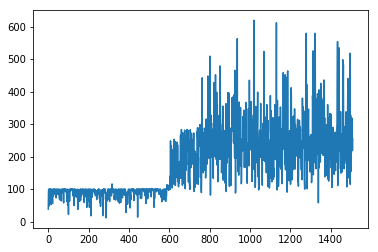

Time elapsed:45957.969366550446
| Reward: 184 | Episode: 1510 


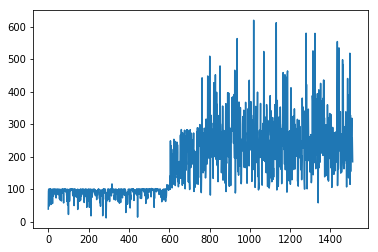

Time elapsed:45992.44666361809
| Reward: 258 | Episode: 1511 


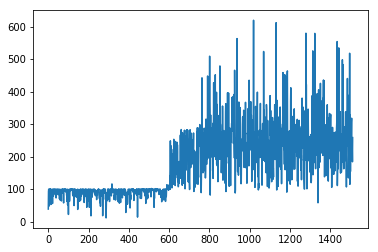

Time elapsed:46027.50378584862
| Reward: 393 | Episode: 1512 


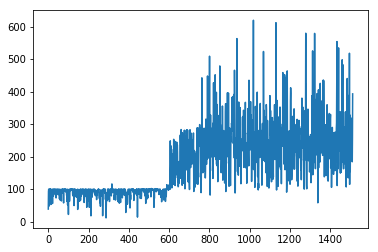

Time elapsed:46063.04667139053
| Reward: 292 | Episode: 1513 


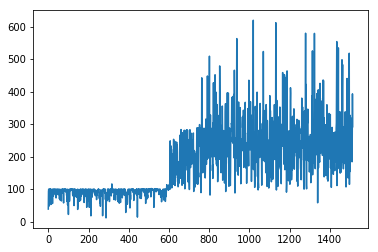

Time elapsed:46097.23590826988
| Reward: 159 | Episode: 1514 


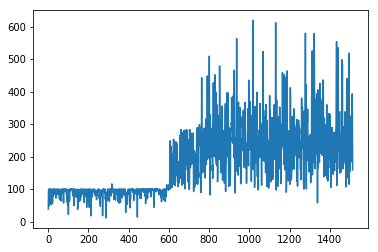

Time elapsed:46132.81897234917
| Reward: 337 | Episode: 1515 


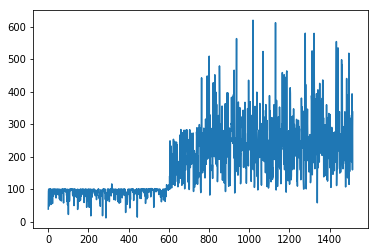

Time elapsed:46167.04034423828
| Reward: 274 | Episode: 1516 


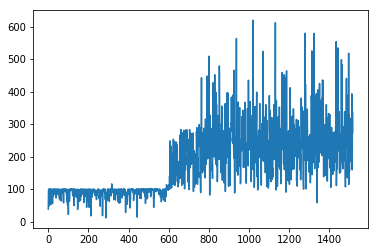

Time elapsed:46201.27065491676
| Reward: 253 | Episode: 1517 


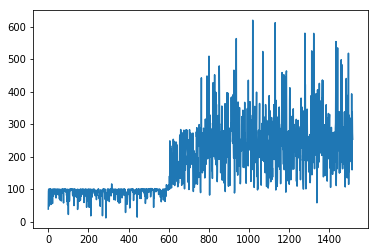

Time elapsed:46235.51240372658
| Reward: 228 | Episode: 1518 


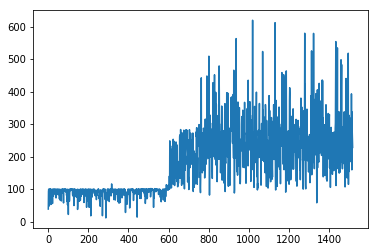

Time elapsed:46269.908272981644
| Reward: 162 | Episode: 1519 


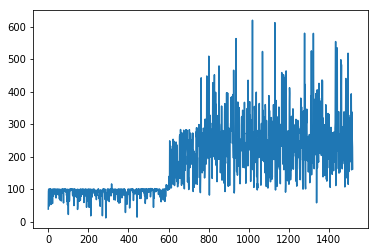

Time elapsed:46304.16003417969
| Reward: 397 | Episode: 1520 


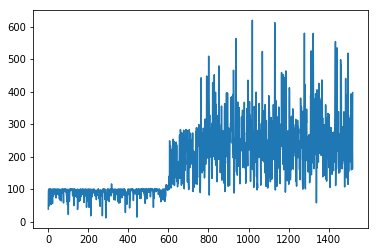

Time elapsed:46338.46172165871
| Reward: 430 | Episode: 1521 


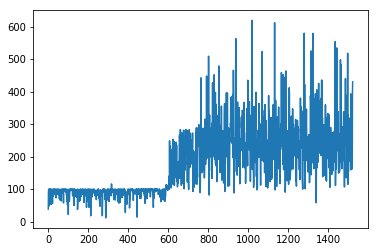

Time elapsed:46372.563385248184
| Reward: 196 | Episode: 1522 


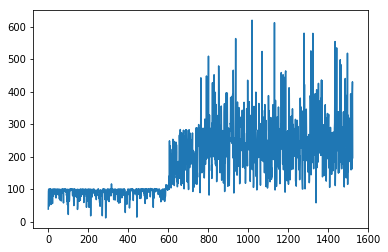

Time elapsed:46406.54775071144
| Reward: 441 | Episode: 1523 


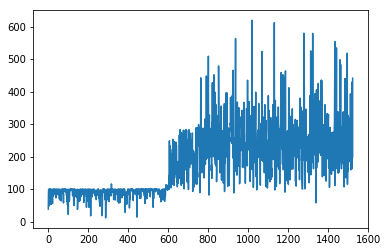

Time elapsed:46441.18795514107
| Reward: 559 | Episode: 1524 


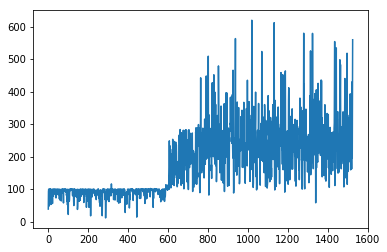

Time elapsed:46475.23902273178
| Reward: 382 | Episode: 1525 


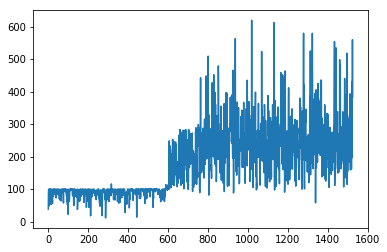

Time elapsed:46508.98781490326
| Reward: 238 | Episode: 1526 


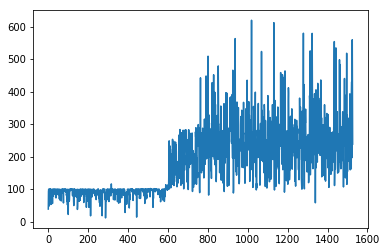

Time elapsed:46543.632190704346
| Reward: 255 | Episode: 1527 


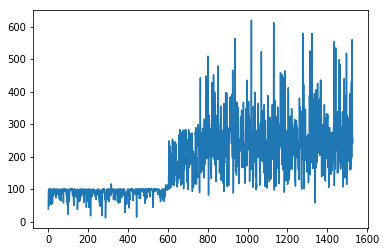

Time elapsed:46577.2900185585
| Reward: 324 | Episode: 1528 


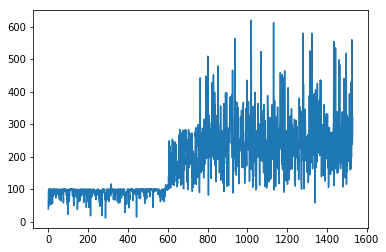

Time elapsed:46610.81489801407
| Reward: 502 | Episode: 1529 


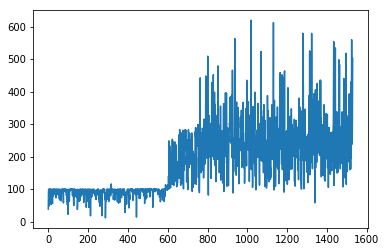

Time elapsed:46644.4818611145
| Reward: 316 | Episode: 1530 


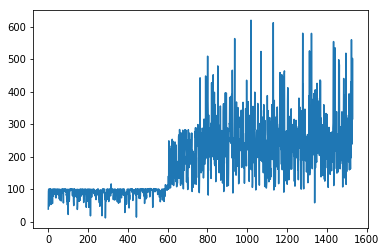

Time elapsed:46680.536607027054
| Reward: 449 | Episode: 1531 


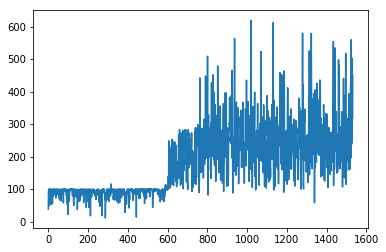

Time elapsed:46716.29760861397
| Reward: 249 | Episode: 1532 


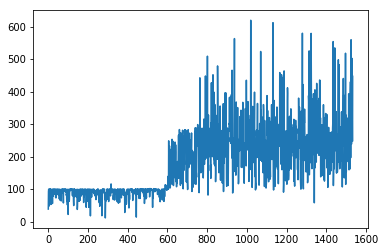

Time elapsed:46751.92233967781
| Reward: 221 | Episode: 1533 


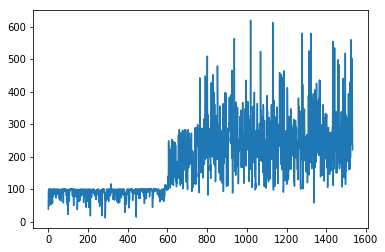

Time elapsed:46787.20723032951
| Reward: 265 | Episode: 1534 


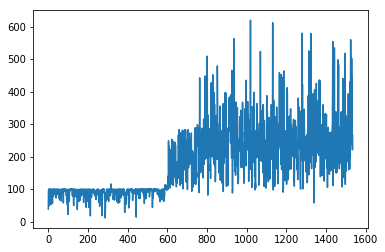

Time elapsed:46822.79343414307
| Reward: 282 | Episode: 1535 


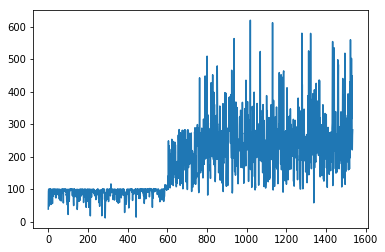

Time elapsed:46856.764298439026
| Reward: 177 | Episode: 1536 


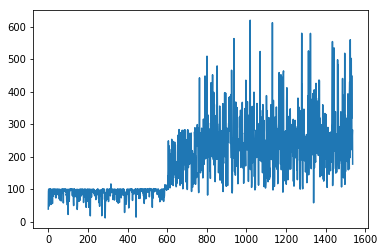

Time elapsed:46890.89861822128
| Reward: 120 | Episode: 1537 


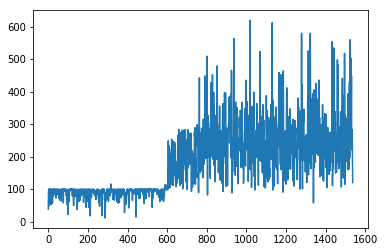

Time elapsed:46926.01649618149
| Reward: 223 | Episode: 1538 


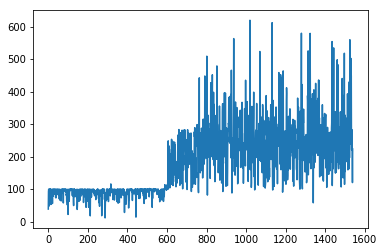

Time elapsed:46961.37759804726
| Reward: 179 | Episode: 1539 


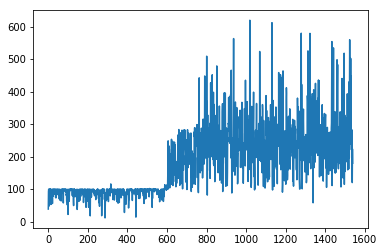

Time elapsed:46995.57174682617
| Reward: 268 | Episode: 1540 


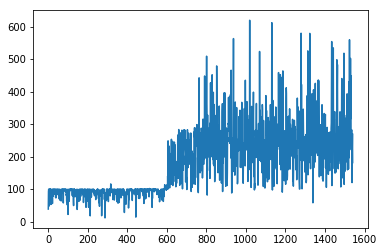

Time elapsed:47030.42954874039
| Reward: 478 | Episode: 1541 


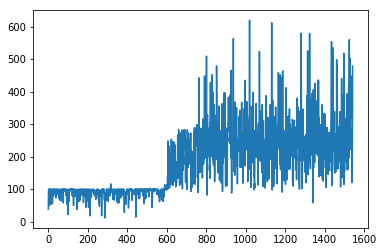

Time elapsed:47063.8785905838
| Reward: 172 | Episode: 1542 


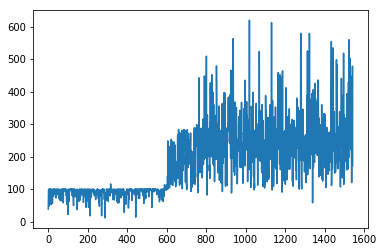

Time elapsed:47097.91955828667
| Reward: 269 | Episode: 1543 


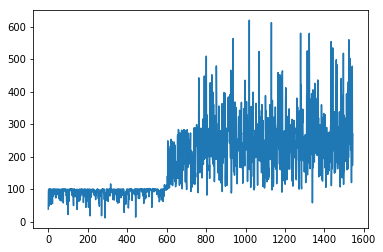

Time elapsed:47131.946224689484
| Reward: 193 | Episode: 1544 


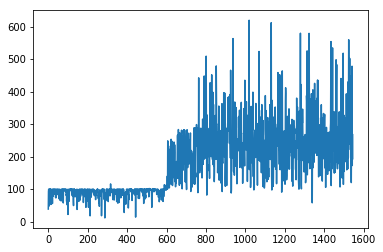

Time elapsed:47167.35695695877
| Reward: 232 | Episode: 1545 


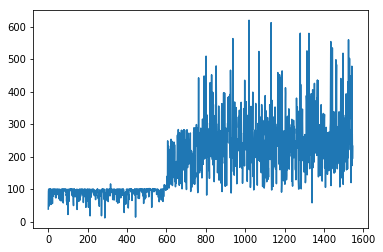

Time elapsed:47201.47204828262
| Reward: 284 | Episode: 1546 


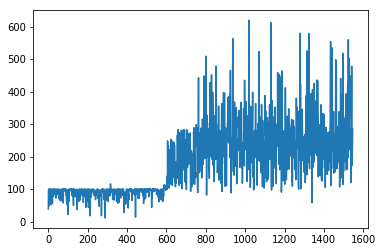

Time elapsed:47235.323721408844
| Reward: 281 | Episode: 1547 


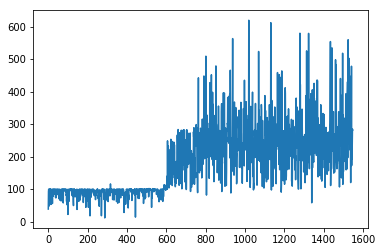

Time elapsed:47269.59039759636
| Reward: 361 | Episode: 1548 


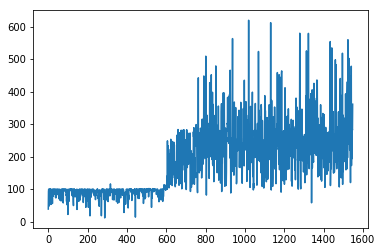

Time elapsed:47303.38636445999
| Reward: 281 | Episode: 1549 


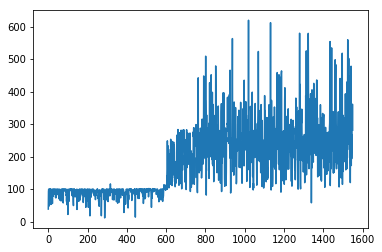

Time elapsed:47337.09942340851
| Reward: 235 | Episode: 1550 


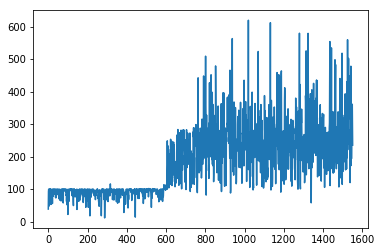

Time elapsed:47371.006165504456
| Reward: 207 | Episode: 1551 


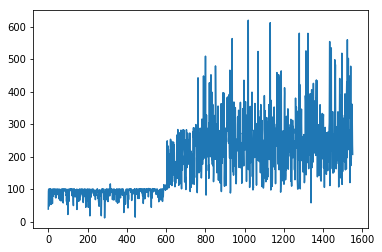

Time elapsed:47405.09523463249
| Reward: 209 | Episode: 1552 


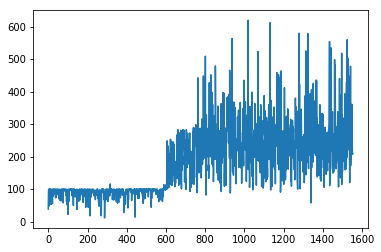

Time elapsed:47440.927690029144
| Reward: 296 | Episode: 1553 


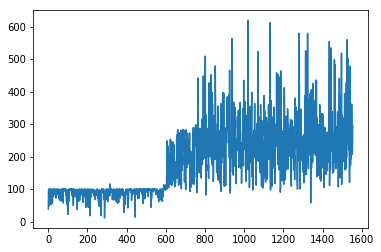

Time elapsed:47476.69552111626
| Reward: 219 | Episode: 1554 


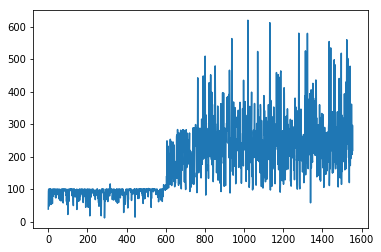

Time elapsed:47512.66340780258
| Reward: 213 | Episode: 1555 


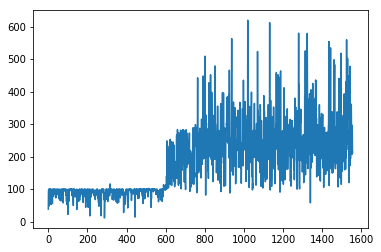

Time elapsed:47548.33517050743
| Reward: 103 | Episode: 1556 


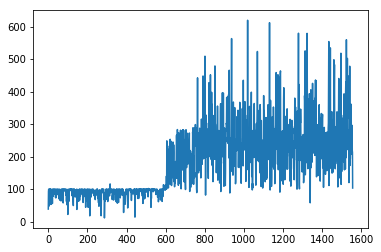

Time elapsed:47583.258717536926
| Reward: 206 | Episode: 1557 


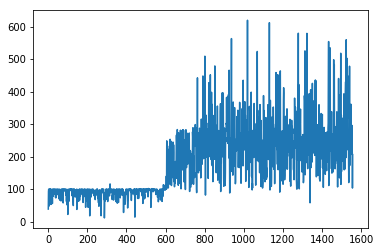

Time elapsed:47618.402295827866
| Reward: 361 | Episode: 1558 


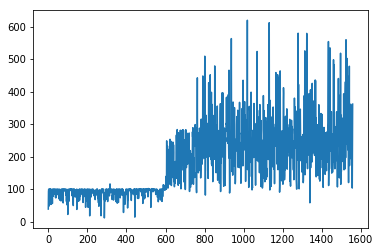

Time elapsed:47654.072785139084
| Reward: 253 | Episode: 1559 


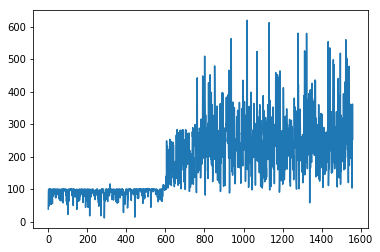

Time elapsed:47688.82321715355
| Reward: 261 | Episode: 1560 


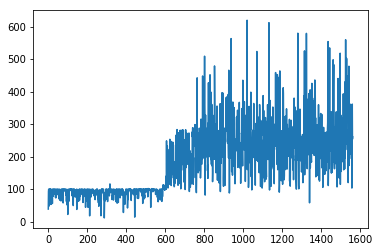

Time elapsed:47723.33569645882
| Reward: 243 | Episode: 1561 


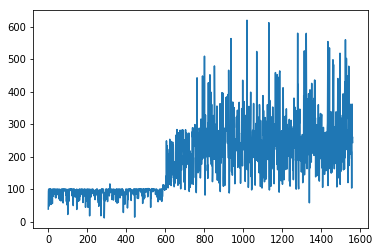

Time elapsed:47757.88426423073
| Reward: 179 | Episode: 1562 


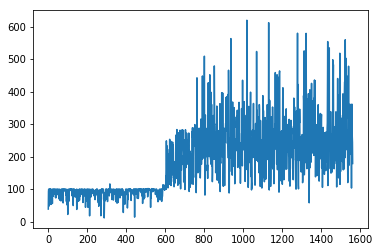

Time elapsed:47793.34086275101
| Reward: 210 | Episode: 1563 


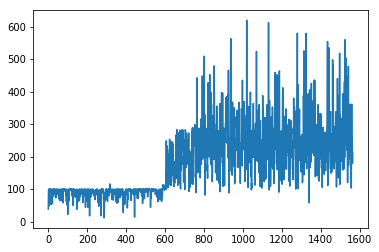

Time elapsed:47827.82311487198
| Reward: 255 | Episode: 1564 


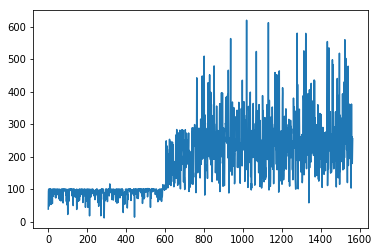

Time elapsed:47863.2025642395
| Reward: 233 | Episode: 1565 


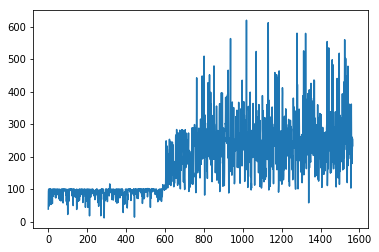

Time elapsed:47897.23422527313
| Reward: 245 | Episode: 1566 


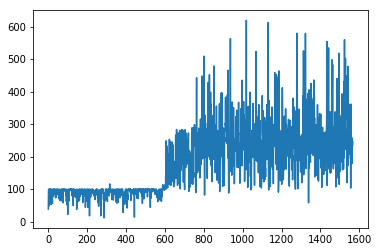

Time elapsed:47932.694809913635
| Reward: 238 | Episode: 1567 


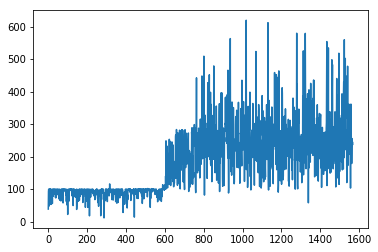

Time elapsed:47968.18642306328
| Reward: 502 | Episode: 1568 


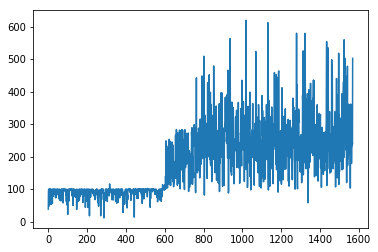

Time elapsed:48003.50809597969
| Reward: 223 | Episode: 1569 


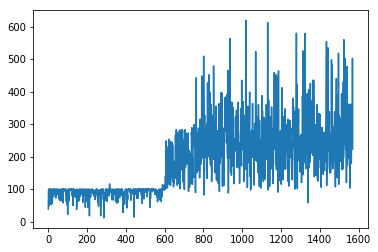

Time elapsed:48038.60651373863
| Reward: 263 | Episode: 1570 


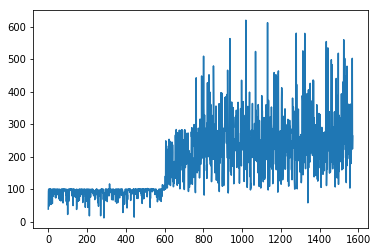

Time elapsed:48073.92895197868
| Reward: 221 | Episode: 1571 


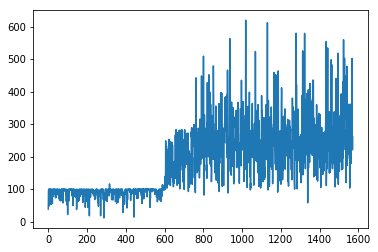

Time elapsed:48109.135778427124
| Reward: 258 | Episode: 1572 


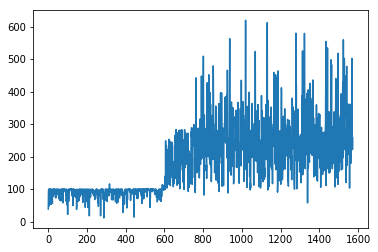

Time elapsed:48143.614777326584
| Reward: 445 | Episode: 1573 


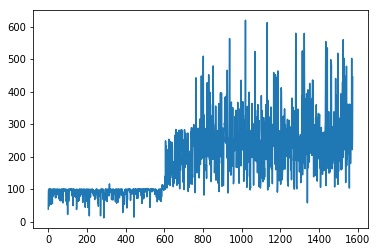

Time elapsed:48178.581741809845
| Reward: 312 | Episode: 1574 


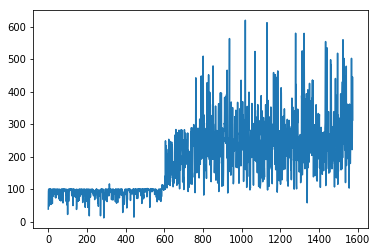

Time elapsed:48214.50301551819
| Reward: 273 | Episode: 1575 


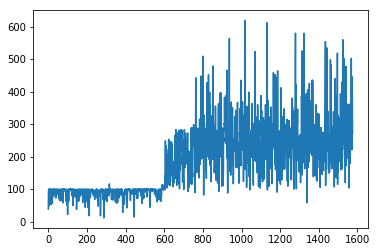

Time elapsed:48250.255687236786
| Reward: 259 | Episode: 1576 


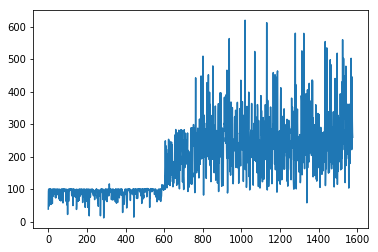

Time elapsed:48286.10146379471
| Reward: 263 | Episode: 1577 


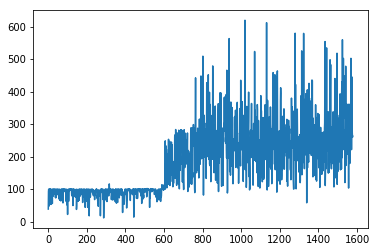

Time elapsed:48322.12890648842
| Reward: 208 | Episode: 1578 


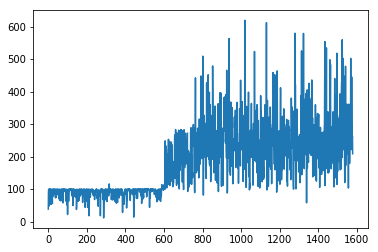

Time elapsed:48358.233471393585
| Reward: 211 | Episode: 1579 


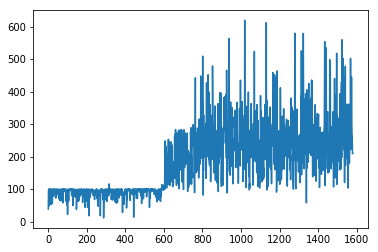

Time elapsed:48393.769790410995
| Reward: 270 | Episode: 1580 


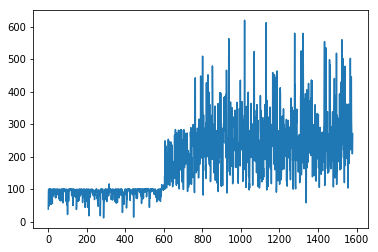

Time elapsed:48429.53100275993
| Reward: 258 | Episode: 1581 


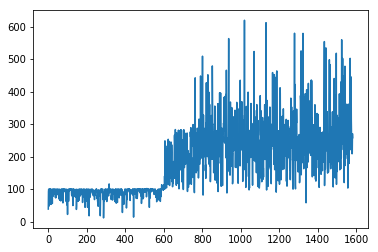

Time elapsed:48464.87403225899
| Reward: 260 | Episode: 1582 


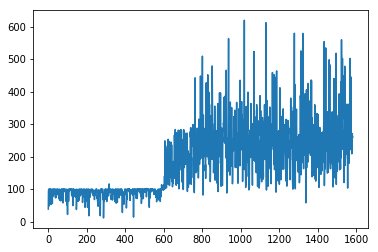

Time elapsed:48500.342787504196
| Reward: 266 | Episode: 1583 


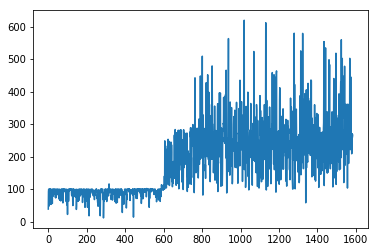

Time elapsed:48535.746415138245
| Reward: 217 | Episode: 1584 


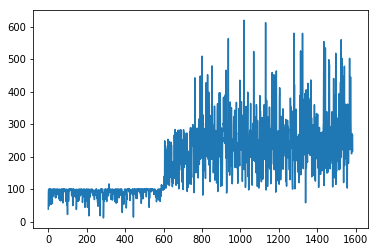

Time elapsed:48571.19813132286
| Reward: 230 | Episode: 1585 


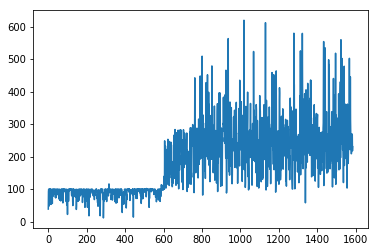

Time elapsed:48606.952046871185
| Reward: 175 | Episode: 1586 


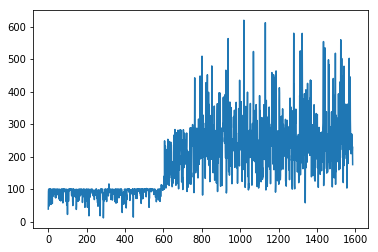

Time elapsed:48642.38464689255
| Reward: 233 | Episode: 1587 


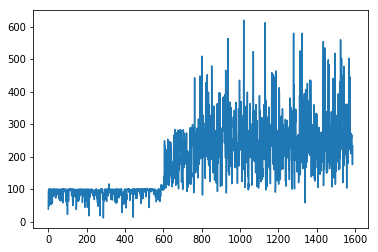

Time elapsed:48677.66541099548
| Reward: 200 | Episode: 1588 


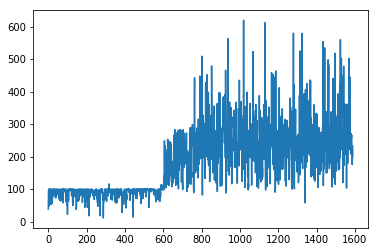

Time elapsed:48713.24809932709
| Reward: 141 | Episode: 1589 


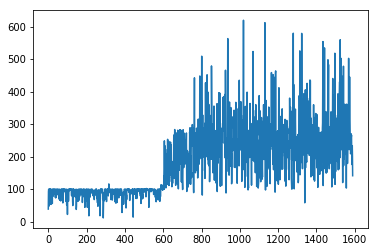

Time elapsed:48748.906487464905
| Reward: 187 | Episode: 1590 


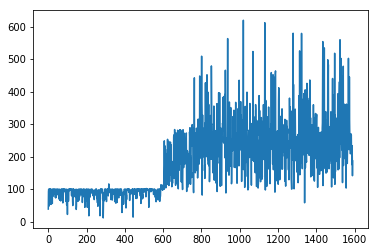

Time elapsed:48784.25210523605
| Reward: 225 | Episode: 1591 


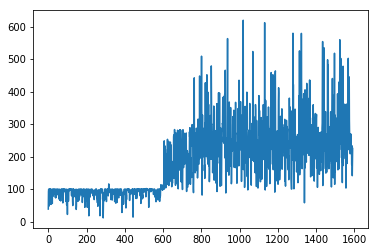

Time elapsed:48819.723653793335
| Reward: 127 | Episode: 1592 


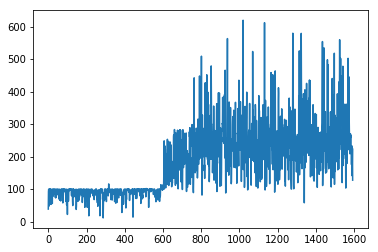

Time elapsed:48855.49310016632
| Reward: 297 | Episode: 1593 


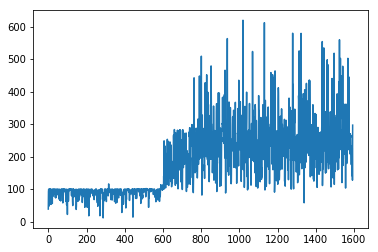

Time elapsed:48890.761249542236
| Reward: 320 | Episode: 1594 


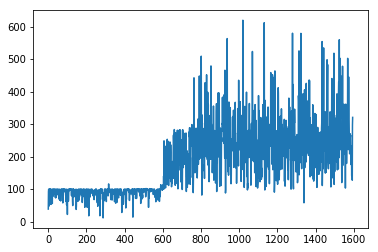

Time elapsed:48925.3565158844
| Reward: 389 | Episode: 1595 


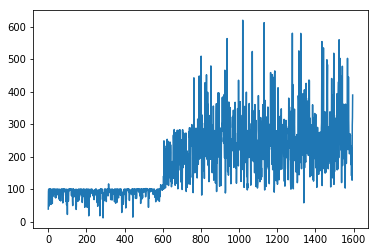

Time elapsed:48959.338381290436
| Reward: 256 | Episode: 1596 


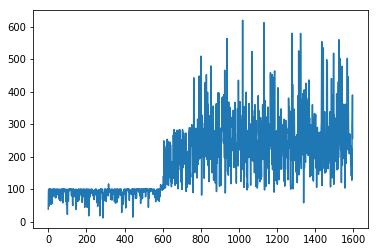

Time elapsed:48995.13526058197
| Reward: 170 | Episode: 1597 


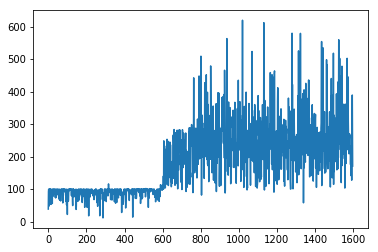

Time elapsed:49031.02502179146
| Reward: 251 | Episode: 1598 


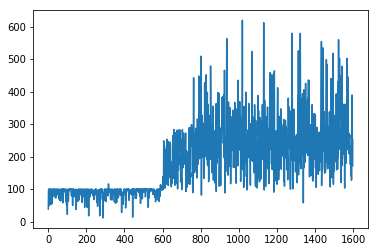

Time elapsed:49066.42348885536
| Reward: 390 | Episode: 1599 


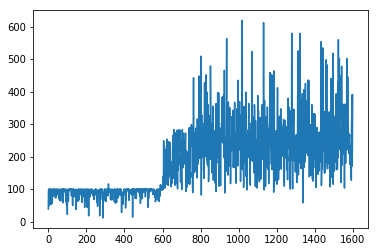

Time elapsed:49102.09735798836
| Reward: 278 | Episode: 1600 


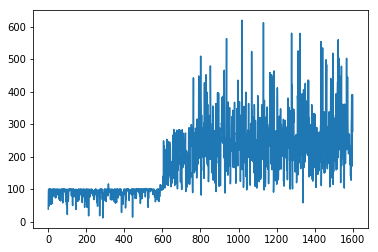

Time elapsed:49137.31015968323
| Reward: 248 | Episode: 1601 


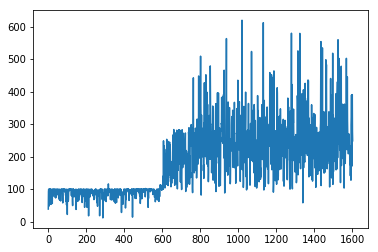

Time elapsed:49173.023344516754
| Reward: 325 | Episode: 1602 


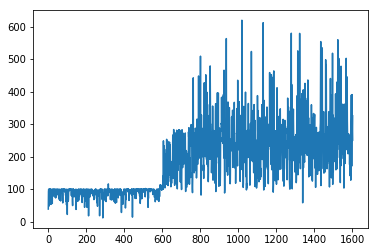

Time elapsed:49208.50722670555
| Reward: 388 | Episode: 1603 


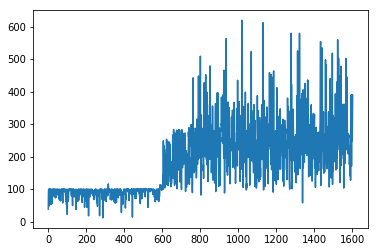

Time elapsed:49244.28719496727
| Reward: 215 | Episode: 1604 


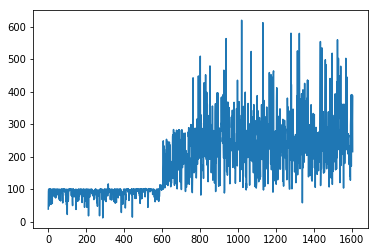

Time elapsed:49279.81618618965
| Reward: 140 | Episode: 1605 


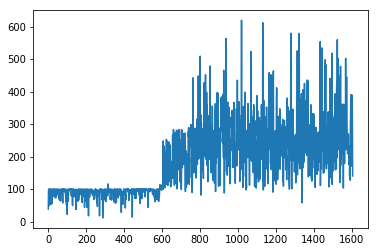

Time elapsed:49315.642765283585
| Reward: 277 | Episode: 1606 


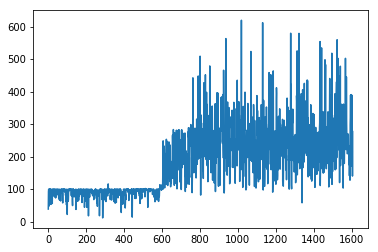

Time elapsed:49351.30353522301
| Reward: 178 | Episode: 1607 


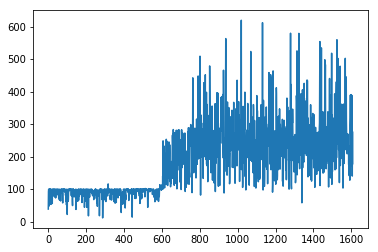

Time elapsed:49385.8428132534
| Reward: 175 | Episode: 1608 


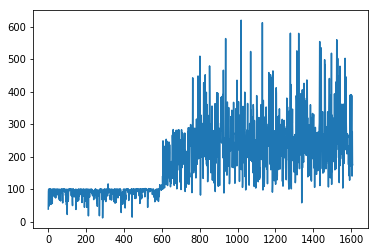

Time elapsed:49420.07354211807
| Reward: 177 | Episode: 1609 


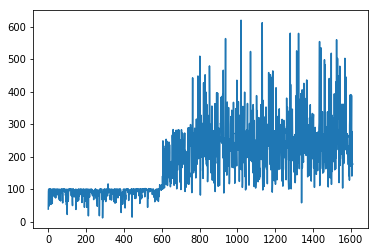

Time elapsed:49455.5031580925
| Reward: 278 | Episode: 1610 


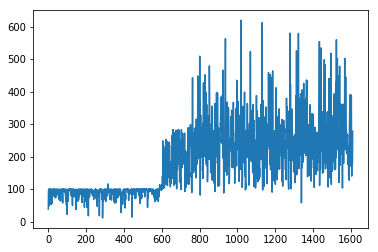

Time elapsed:49491.01694726944
| Reward: 293 | Episode: 1611 


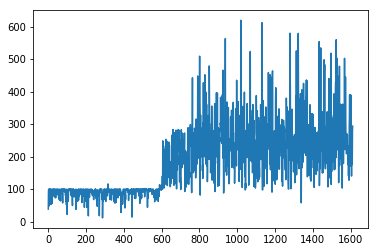

Time elapsed:49525.17783045769
| Reward: 267 | Episode: 1612 


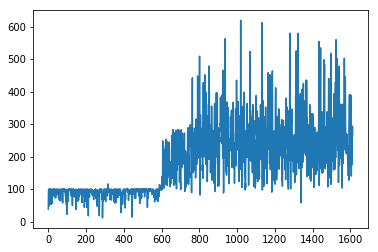

Time elapsed:49560.53590297699
| Reward: 226 | Episode: 1613 


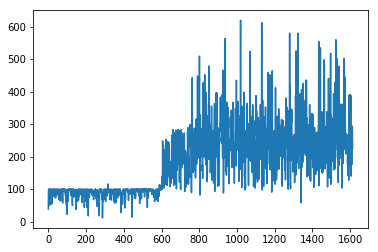

Time elapsed:49595.632496356964
| Reward: 236 | Episode: 1614 


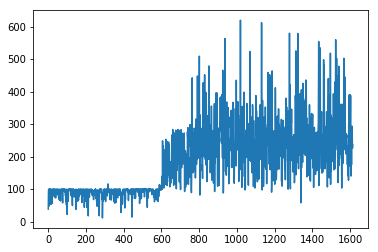

Time elapsed:49630.22079229355
| Reward: 204 | Episode: 1615 


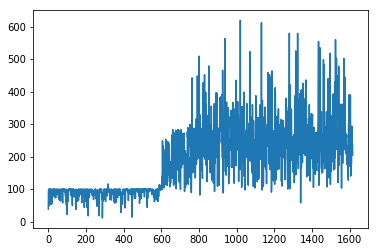

Time elapsed:49665.16373133659
| Reward: 458 | Episode: 1616 


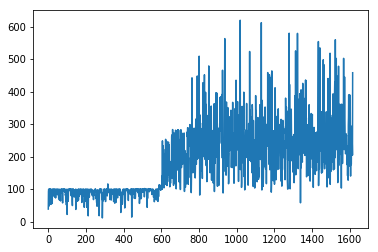

Time elapsed:49700.28196954727
| Reward: 294 | Episode: 1617 


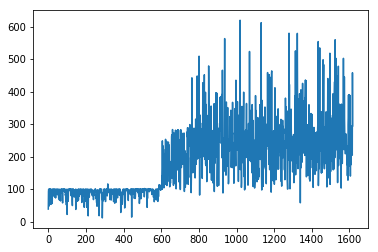

Time elapsed:49734.886632442474
| Reward: 153 | Episode: 1618 


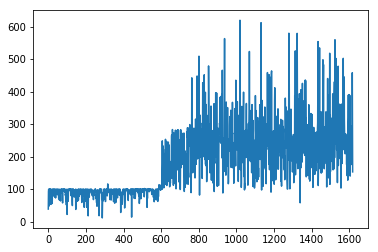

Time elapsed:49770.712184906006
| Reward: 132 | Episode: 1619 


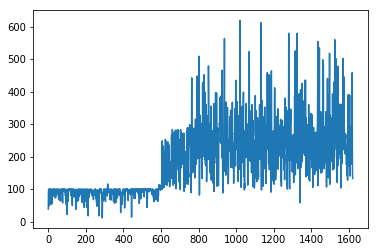

Time elapsed:49806.64008021355
| Reward: 307 | Episode: 1620 


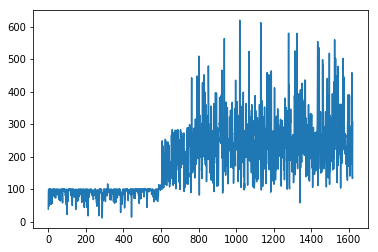

Time elapsed:49842.45064020157
| Reward: 322 | Episode: 1621 


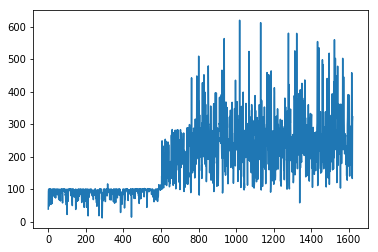

Time elapsed:49878.301933050156
| Reward: 267 | Episode: 1622 


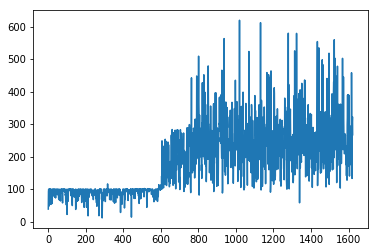

Time elapsed:49914.55298829079
| Reward: 265 | Episode: 1623 


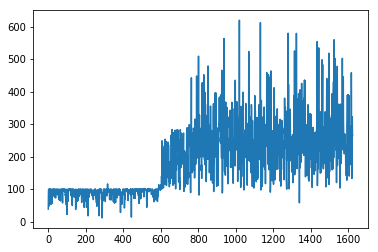

Time elapsed:49950.11680006981
| Reward: 200 | Episode: 1624 


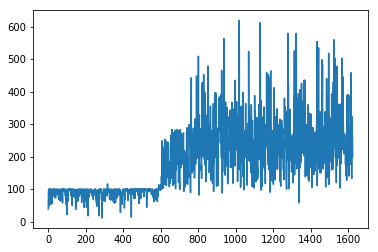

Time elapsed:49985.68943786621
| Reward: 169 | Episode: 1625 


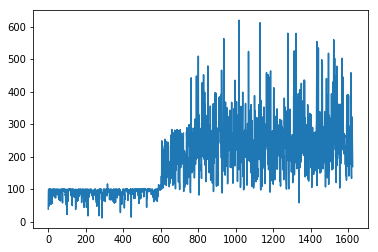

Time elapsed:50021.549282073975
| Reward: 140 | Episode: 1626 


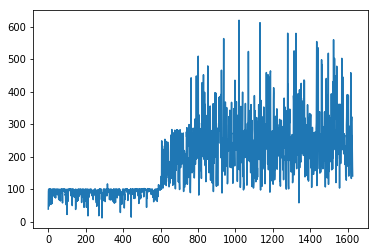

Time elapsed:50057.165620565414
| Reward: 172 | Episode: 1627 


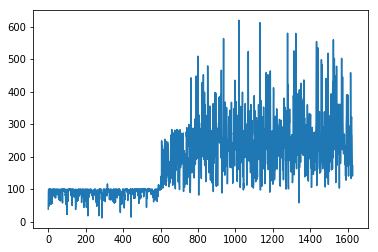

Time elapsed:50092.723551273346
| Reward: 268 | Episode: 1628 


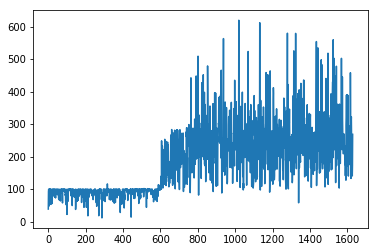

Time elapsed:50128.24740719795
| Reward: 183 | Episode: 1629 


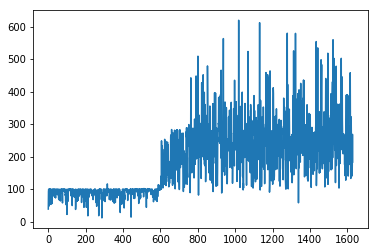

Time elapsed:50163.90532207489
| Reward: 202 | Episode: 1630 


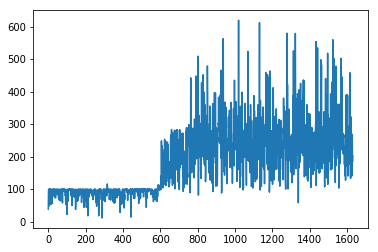

Time elapsed:50197.79324507713
| Reward: 316 | Episode: 1631 


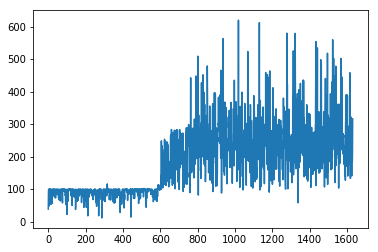

Time elapsed:50233.19849395752
| Reward: 248 | Episode: 1632 


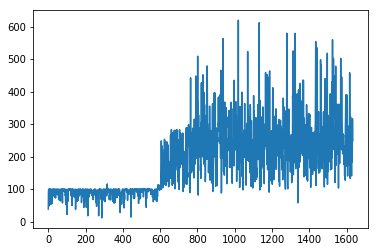

Time elapsed:50268.593527793884
| Reward: 224 | Episode: 1633 


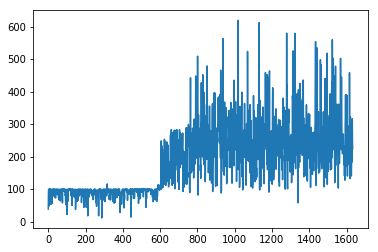

Time elapsed:50303.0963845253
| Reward: 314 | Episode: 1634 


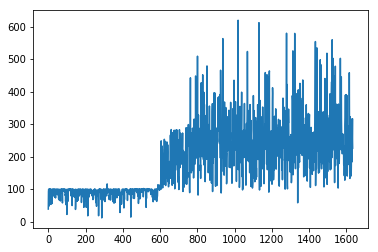

Time elapsed:50338.09644269943
| Reward: 234 | Episode: 1635 


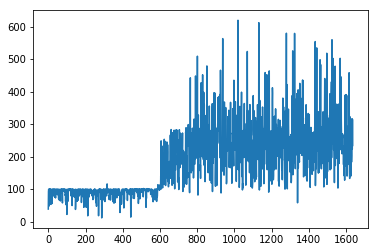

Time elapsed:50372.66518807411
| Reward: 263 | Episode: 1636 


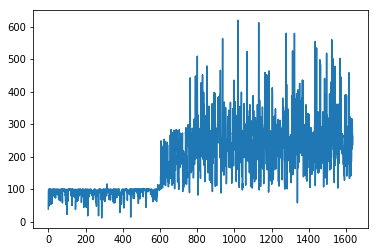

Time elapsed:50407.98697447777
| Reward: 191 | Episode: 1637 


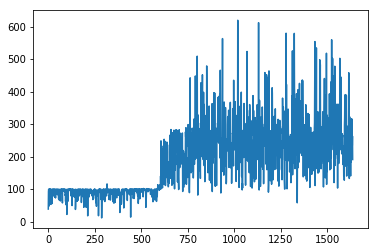

Time elapsed:50443.02637529373
| Reward: 108 | Episode: 1638 


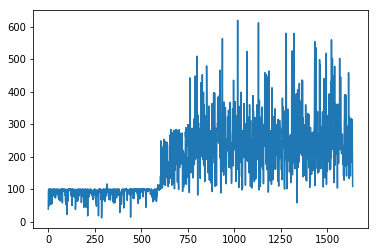

Time elapsed:50477.957085609436
| Reward: 156 | Episode: 1639 


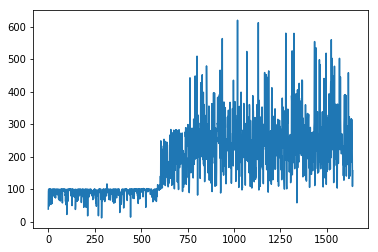

Time elapsed:50513.13274550438
| Reward: 386 | Episode: 1640 


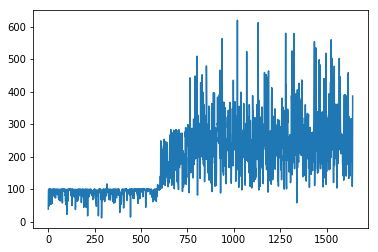

Time elapsed:50549.04348945618
| Reward: 212 | Episode: 1641 


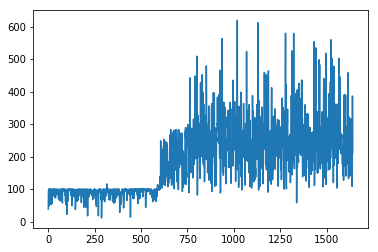

Time elapsed:50584.68526649475
| Reward: 308 | Episode: 1642 


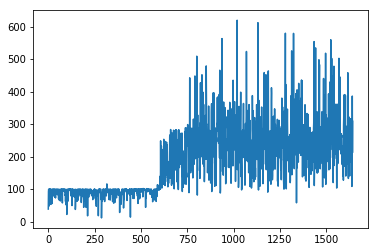

Time elapsed:50620.507652282715
| Reward: 301 | Episode: 1643 


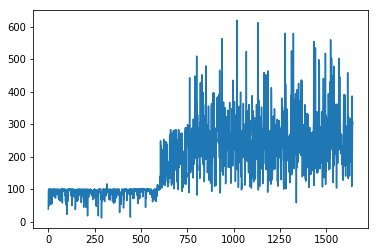

Time elapsed:50656.3072783947
| Reward: 159 | Episode: 1644 


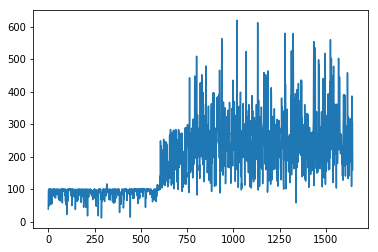

Time elapsed:50691.97389292717
| Reward: 174 | Episode: 1645 


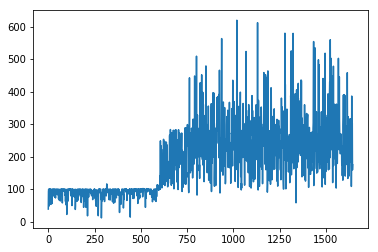

Time elapsed:50727.1758916378
| Reward: 263 | Episode: 1646 


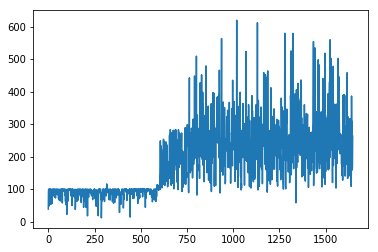

Time elapsed:50763.071654081345
| Reward: 190 | Episode: 1647 


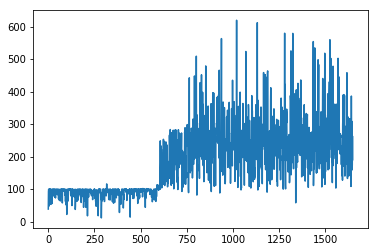

Time elapsed:50798.610600948334
| Reward: 263 | Episode: 1648 


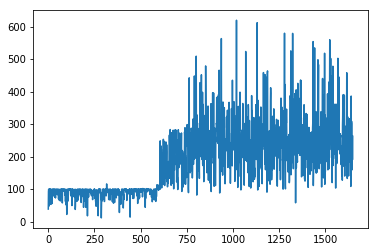

Time elapsed:50834.14435172081
| Reward: 269 | Episode: 1649 


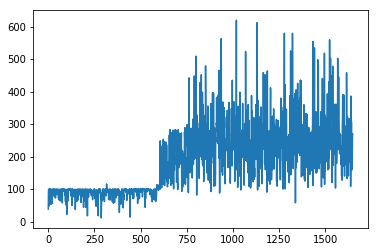

Time elapsed:50870.08118581772
| Reward: 346 | Episode: 1650 


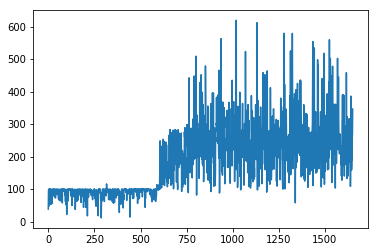

Time elapsed:50905.24027633667
| Reward: 192 | Episode: 1651 


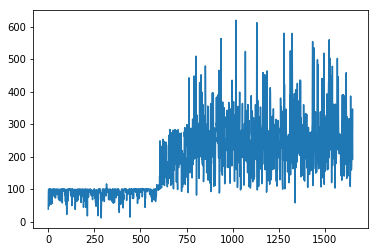

Time elapsed:50940.35072469711
| Reward: 308 | Episode: 1652 


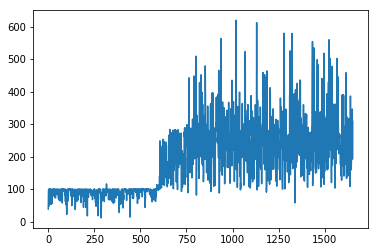

Time elapsed:50975.31320619583
| Reward: 483 | Episode: 1653 


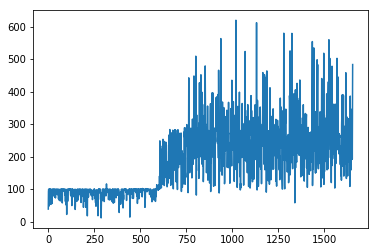

Time elapsed:51010.9215528965
| Reward: 273 | Episode: 1654 


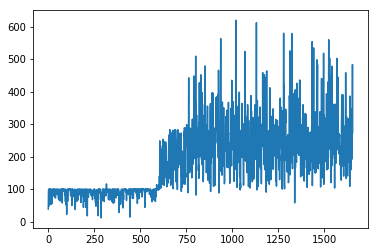

Time elapsed:51045.74536752701
| Reward: 258 | Episode: 1655 


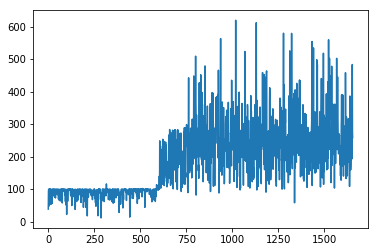

Time elapsed:51080.92162895203
| Reward: 275 | Episode: 1656 


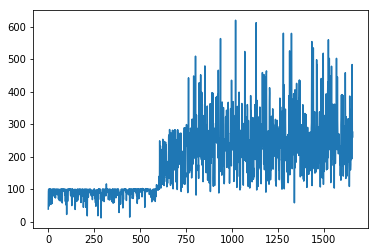

Time elapsed:51116.16135430336
| Reward: 279 | Episode: 1657 


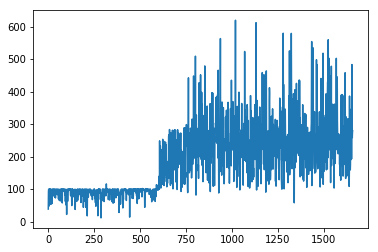

Time elapsed:51150.605830192566
| Reward: 285 | Episode: 1658 


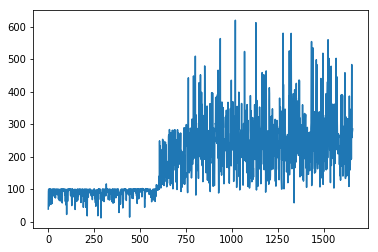

Time elapsed:51185.10175871849
| Reward: 205 | Episode: 1659 


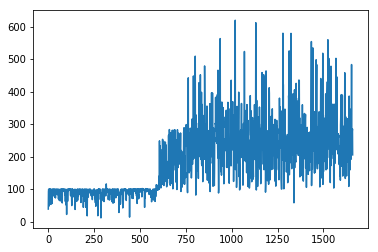

Time elapsed:51219.70655345917
| Reward: 212 | Episode: 1660 


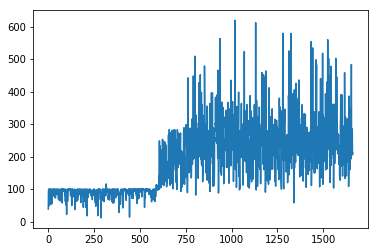

Time elapsed:51254.39160680771
| Reward: 301 | Episode: 1661 


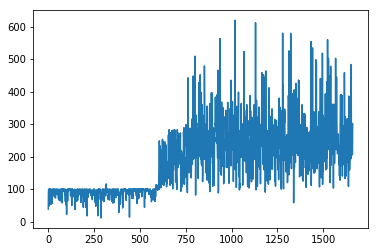

Time elapsed:51288.667712688446
| Reward: 341 | Episode: 1662 


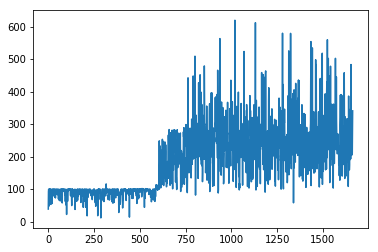

Time elapsed:51324.225605010986
| Reward: 244 | Episode: 1663 


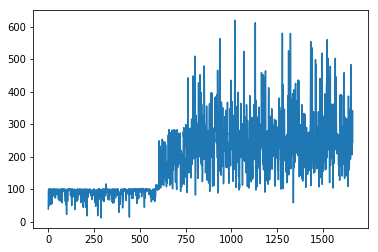

Time elapsed:51359.74507403374
| Reward: 186 | Episode: 1664 


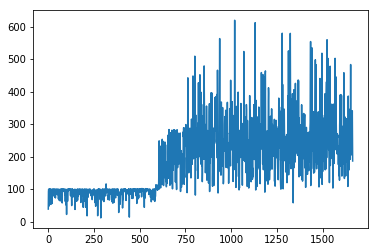

Time elapsed:51395.411182403564
| Reward: 177 | Episode: 1665 


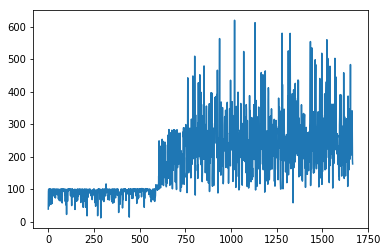

Time elapsed:51431.00254225731
| Reward: 328 | Episode: 1666 


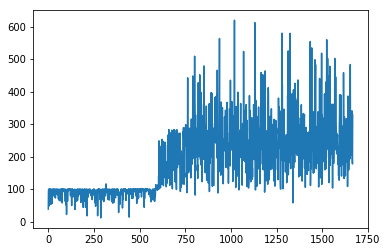

Time elapsed:51466.51097035408
| Reward: 295 | Episode: 1667 


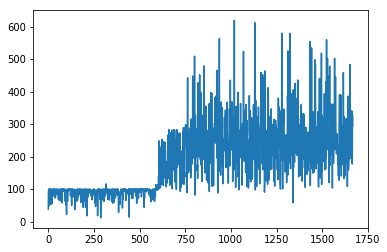

Time elapsed:51501.45101046562
| Reward: 273 | Episode: 1668 


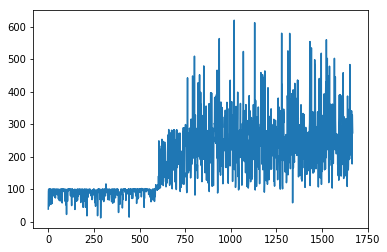

Time elapsed:51537.13407111168
| Reward: 170 | Episode: 1669 


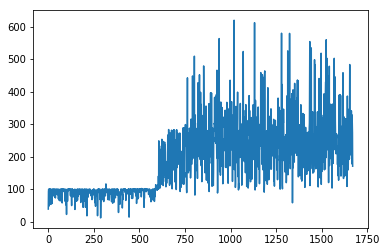

Time elapsed:51572.685032367706
| Reward: 297 | Episode: 1670 


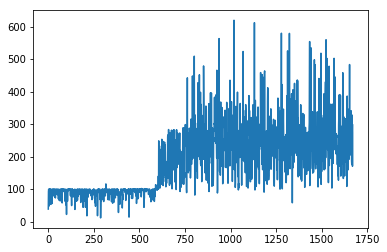

Time elapsed:51608.46046543121
| Reward: 176 | Episode: 1671 


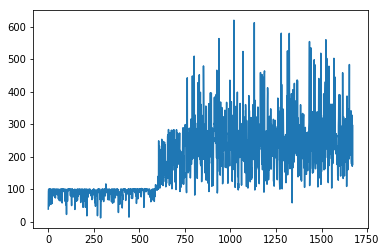

Time elapsed:51644.07456803322
| Reward: 531 | Episode: 1672 


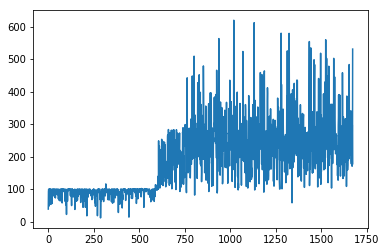

Time elapsed:51679.63479423523
| Reward: 313 | Episode: 1673 


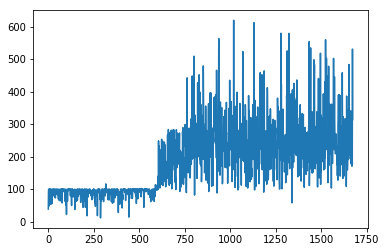

Time elapsed:51715.10258412361
| Reward: 117 | Episode: 1674 


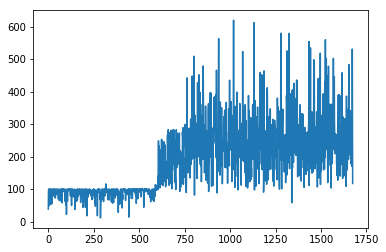

Time elapsed:51749.911232709885
| Reward: 153 | Episode: 1675 


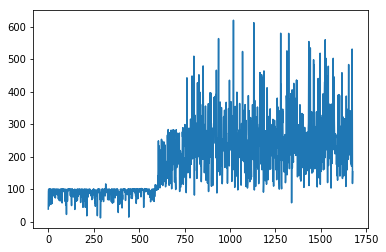

Time elapsed:51785.229096889496
| Reward: 140 | Episode: 1676 


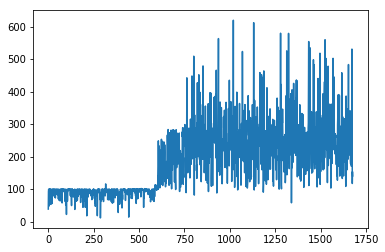

Time elapsed:51819.99662923813
| Reward: 281 | Episode: 1677 


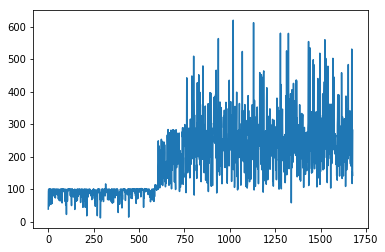

Time elapsed:51855.501391649246
| Reward: 233 | Episode: 1678 


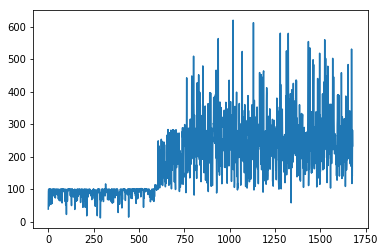

Time elapsed:51890.746849536896
| Reward: 248 | Episode: 1679 


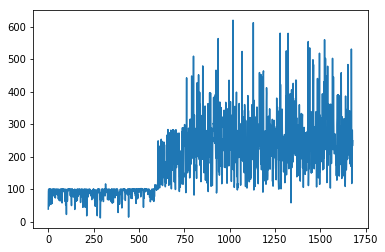

Time elapsed:51925.436331272125
| Reward: 293 | Episode: 1680 


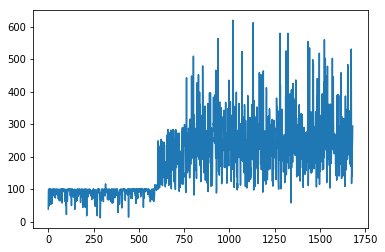

Time elapsed:51960.82919383049
| Reward: 149 | Episode: 1681 


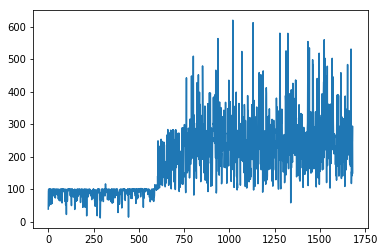

Time elapsed:51995.763327121735
| Reward: 180 | Episode: 1682 


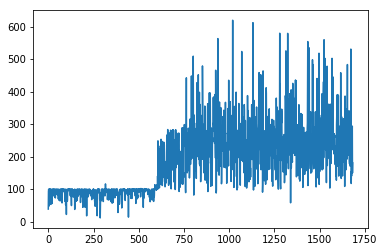

Time elapsed:52030.470960617065
| Reward: 520 | Episode: 1683 


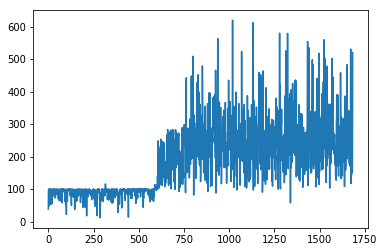

Time elapsed:52065.17966008186
| Reward: 208 | Episode: 1684 


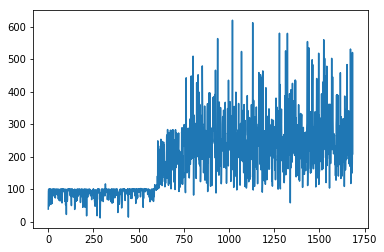

Time elapsed:52100.898178339005
| Reward: 272 | Episode: 1685 


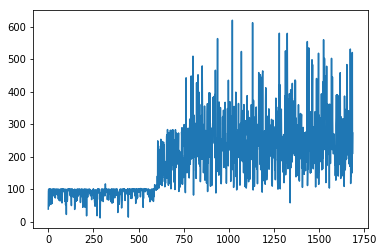

Time elapsed:52136.61162400246
| Reward: 440 | Episode: 1686 


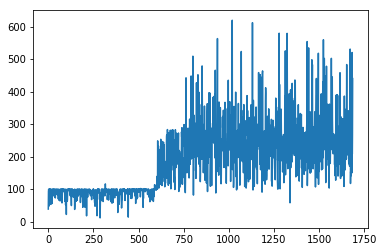

Time elapsed:52171.99624705315
| Reward: 153 | Episode: 1687 


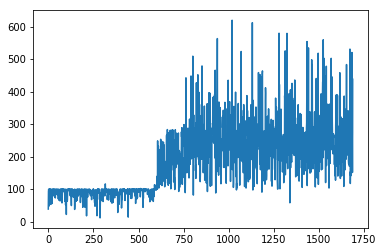

Time elapsed:52207.87294244766
| Reward: 266 | Episode: 1688 


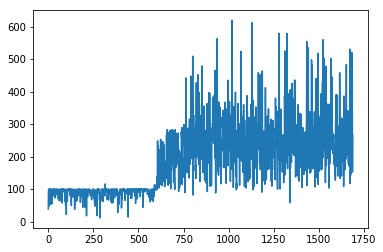

Time elapsed:52242.78682303429
| Reward: 244 | Episode: 1689 


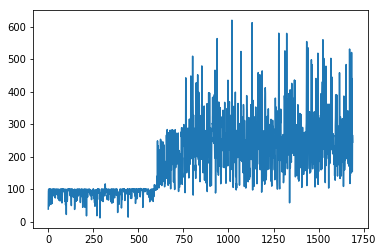

Time elapsed:52277.8309636116
| Reward: 310 | Episode: 1690 


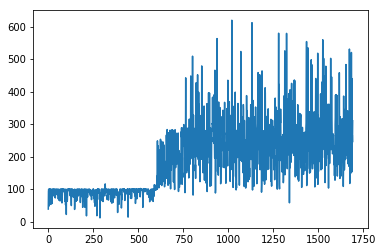

Time elapsed:52313.21928477287
| Reward: 276 | Episode: 1691 


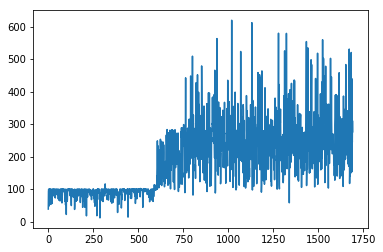

Time elapsed:52348.718160390854
| Reward: 294 | Episode: 1692 


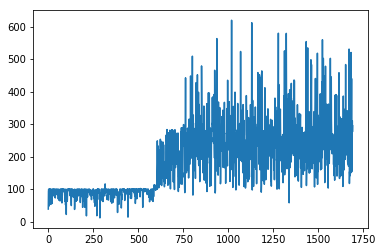

Time elapsed:52384.169516563416
| Reward: 301 | Episode: 1693 


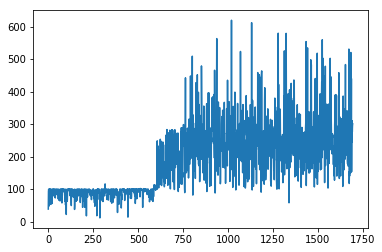

Time elapsed:52418.90365099907
| Reward: 237 | Episode: 1694 


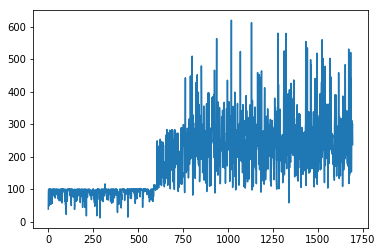

Time elapsed:52454.5712583065
| Reward: 252 | Episode: 1695 


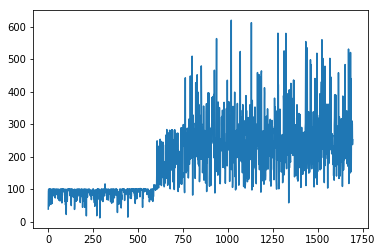

Time elapsed:52489.97950839996
| Reward: 254 | Episode: 1696 


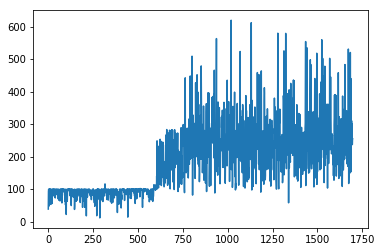

Time elapsed:52525.20433115959
| Reward: 287 | Episode: 1697 


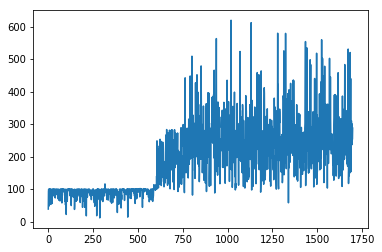

Time elapsed:52560.66728043556
| Reward: 385 | Episode: 1698 


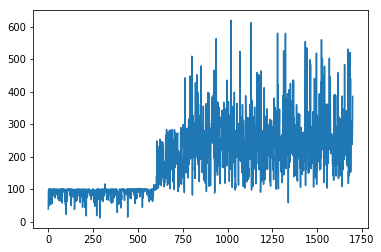

Time elapsed:52596.11142420769
| Reward: 329 | Episode: 1699 


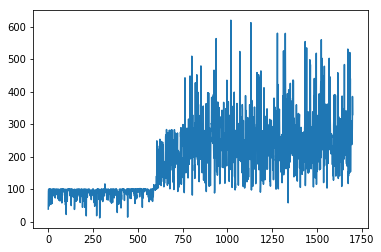

Time elapsed:52631.612129211426
| Reward: 362 | Episode: 1700 


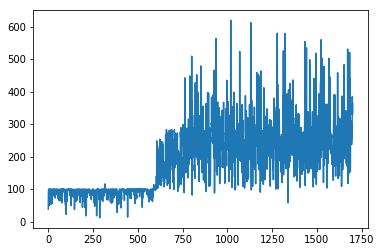

Time elapsed:52667.13522911072
| Reward: 365 | Episode: 1701 


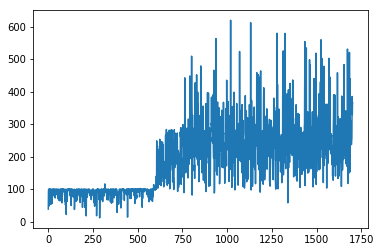

Time elapsed:52701.973200798035
| Reward: 389 | Episode: 1702 


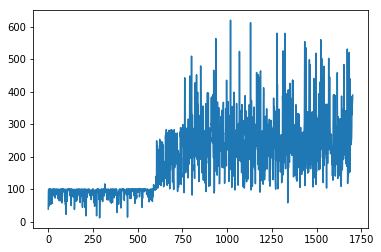

Time elapsed:52736.32958126068
| Reward: 249 | Episode: 1703 


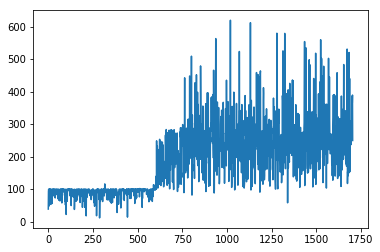

Time elapsed:52770.68456745148
| Reward: 174 | Episode: 1704 


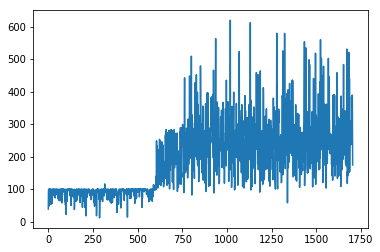

Time elapsed:52805.34791183472
| Reward: 139 | Episode: 1705 


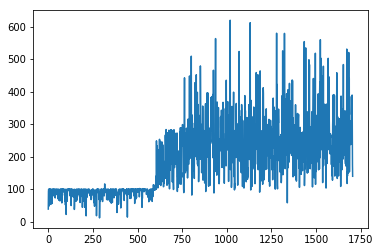

Time elapsed:52839.35634303093
| Reward: 125 | Episode: 1706 


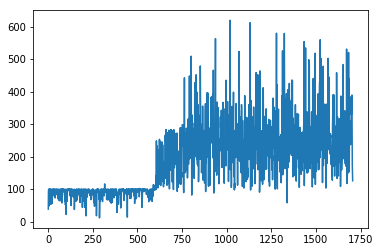

Time elapsed:52873.69747161865
| Reward: 277 | Episode: 1707 


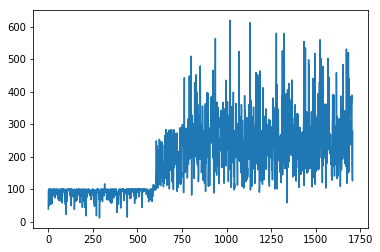

Time elapsed:52909.67705130577
| Reward: 233 | Episode: 1708 


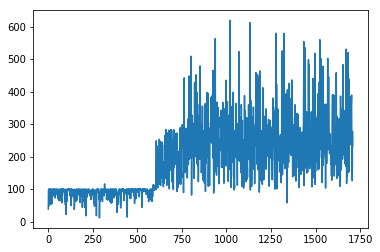

Time elapsed:52945.42178297043
| Reward: 204 | Episode: 1709 


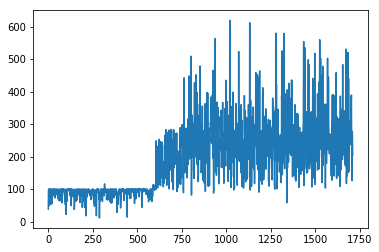

Time elapsed:52981.07442998886
| Reward: 205 | Episode: 1710 


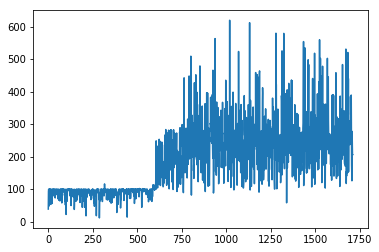

Time elapsed:53016.85873746872
| Reward: 192 | Episode: 1711 


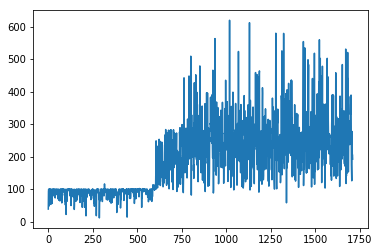

Time elapsed:53052.527433395386
| Reward: 164 | Episode: 1712 


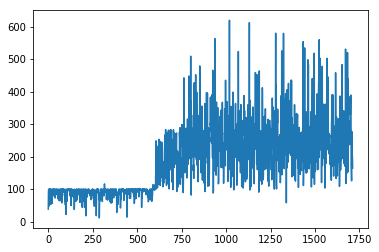

Time elapsed:53088.28093147278
| Reward: 192 | Episode: 1713 


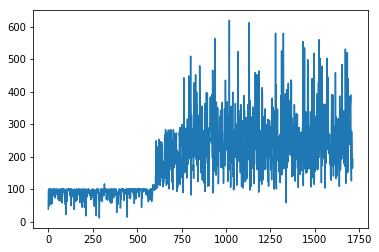

Time elapsed:53123.982375621796
| Reward: 201 | Episode: 1714 


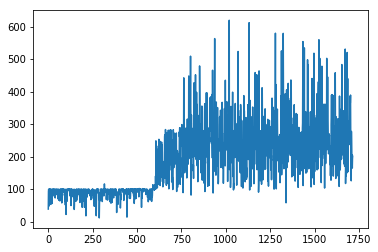

Time elapsed:53160.01071000099
| Reward: 234 | Episode: 1715 


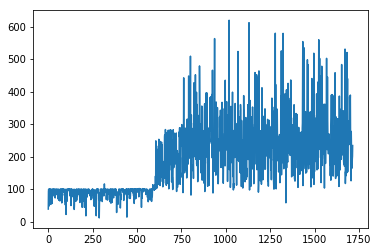

Time elapsed:53195.52915239334
| Reward: 185 | Episode: 1716 


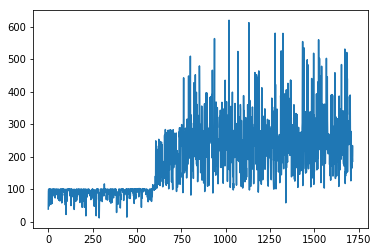

Time elapsed:53231.02803826332
| Reward: 240 | Episode: 1717 


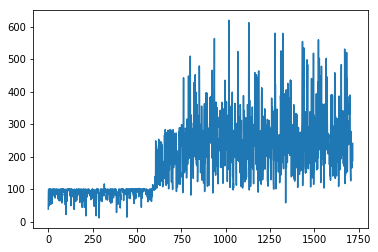

Time elapsed:53266.85367870331
| Reward: 202 | Episode: 1718 


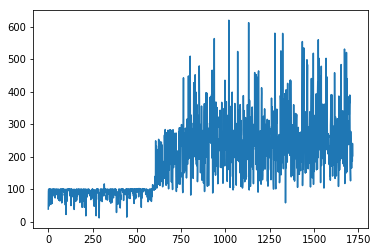

Time elapsed:53302.482650995255
| Reward: 282 | Episode: 1719 


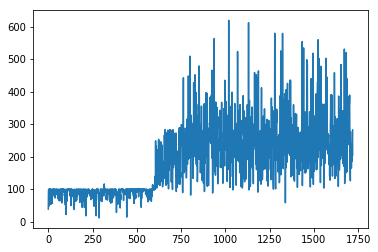

Time elapsed:53338.09342837334
| Reward: 275 | Episode: 1720 


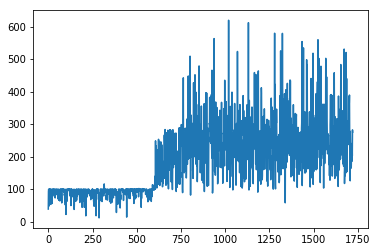

Time elapsed:53373.658735752106
| Reward: 253 | Episode: 1721 


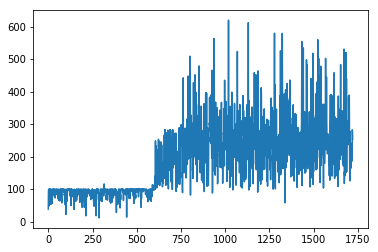

Time elapsed:53409.57170629501
| Reward: 258 | Episode: 1722 


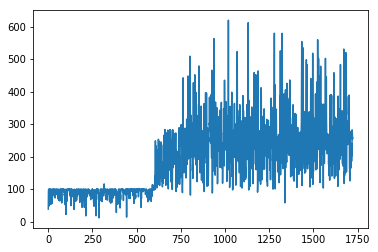

Time elapsed:53445.02696299553
| Reward: 281 | Episode: 1723 


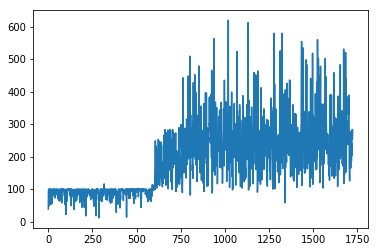

Time elapsed:53480.439807891846
| Reward: 240 | Episode: 1724 


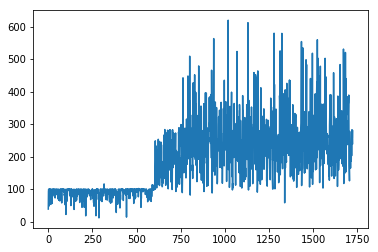

Time elapsed:53515.503433704376
| Reward: 264 | Episode: 1725 


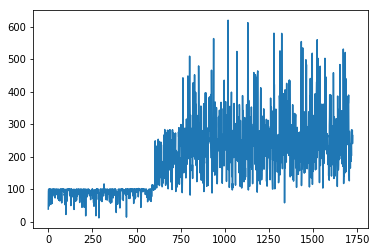

Time elapsed:53551.035066604614
| Reward: 238 | Episode: 1726 


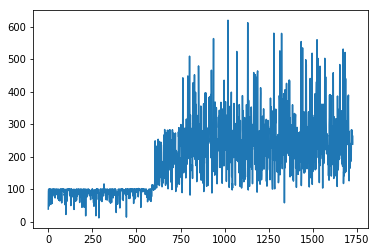

Time elapsed:53586.18467402458
| Reward: 198 | Episode: 1727 


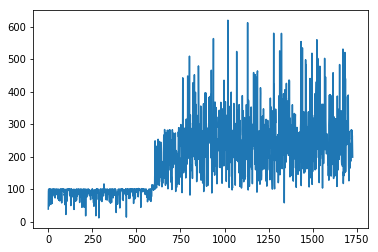

Time elapsed:53621.97985649109
| Reward: 258 | Episode: 1728 


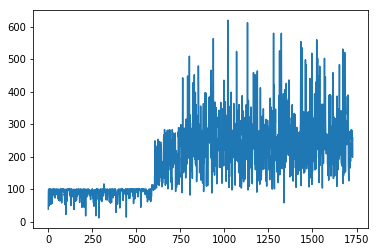

Time elapsed:53657.04706072807
| Reward: 269 | Episode: 1729 


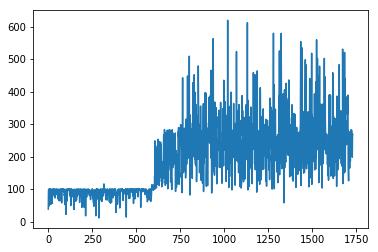

Time elapsed:53691.82848548889
| Reward: 253 | Episode: 1730 


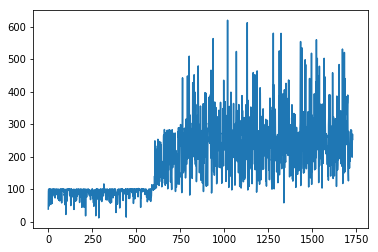

Time elapsed:53726.84594631195
| Reward: 216 | Episode: 1731 


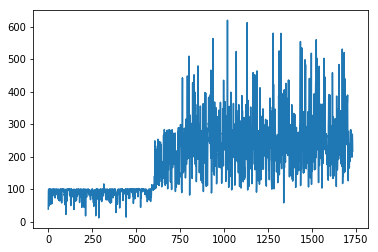

Time elapsed:53761.777079582214
| Reward: 164 | Episode: 1732 


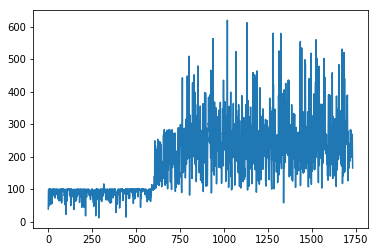

Time elapsed:53796.14501810074
| Reward: 222 | Episode: 1733 


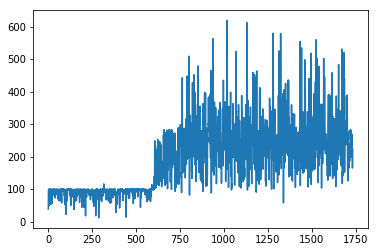

Time elapsed:53830.862788915634
| Reward: 265 | Episode: 1734 


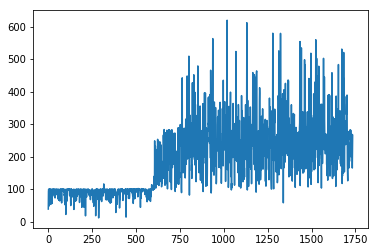

Time elapsed:53865.88120961189
| Reward: 103 | Episode: 1735 


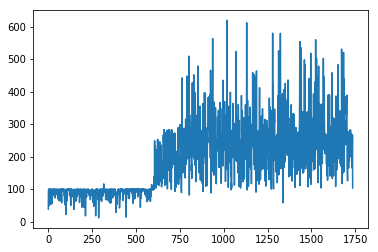

Time elapsed:53900.703939676285
| Reward: 212 | Episode: 1736 


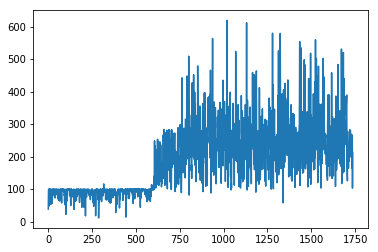

Time elapsed:53935.71664810181
| Reward: 289 | Episode: 1737 


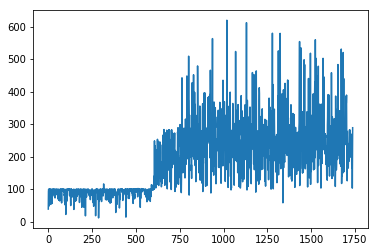

Time elapsed:53970.68764638901
| Reward: 288 | Episode: 1738 


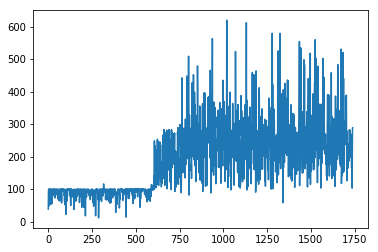

Time elapsed:54005.85211634636
| Reward: 327 | Episode: 1739 


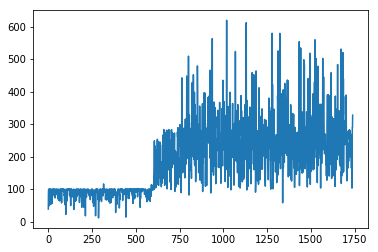

Time elapsed:54041.07989001274
| Reward: 406 | Episode: 1740 


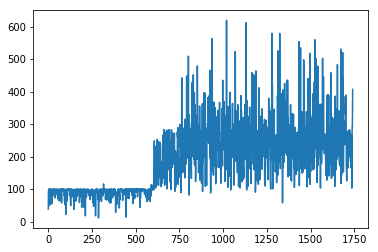

Time elapsed:54076.05367040634
| Reward: 337 | Episode: 1741 


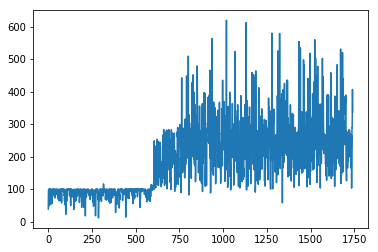

Time elapsed:54111.691214084625
| Reward: 482 | Episode: 1742 


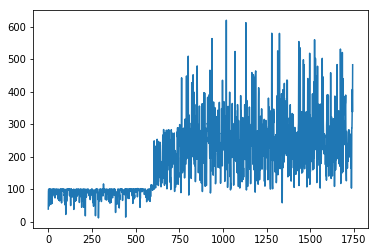

Time elapsed:54147.07226085663
| Reward: 177 | Episode: 1743 


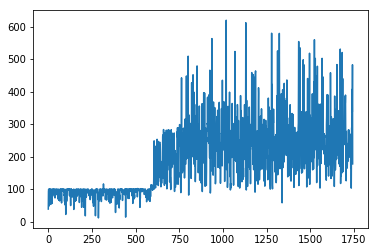

Time elapsed:54182.68035984039
| Reward: 220 | Episode: 1744 


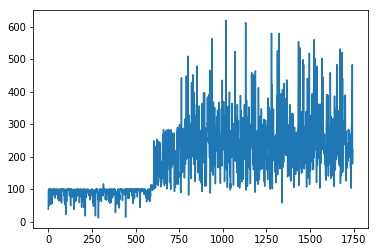

Time elapsed:54218.24515962601
| Reward: 222 | Episode: 1745 


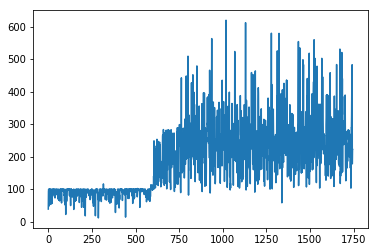

Time elapsed:54253.91298890114
| Reward: 269 | Episode: 1746 


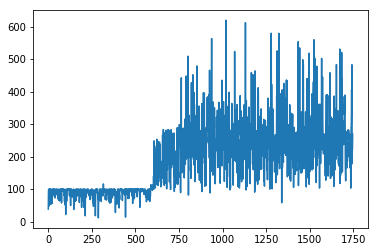

Time elapsed:54289.14189481735
| Reward: 189 | Episode: 1747 


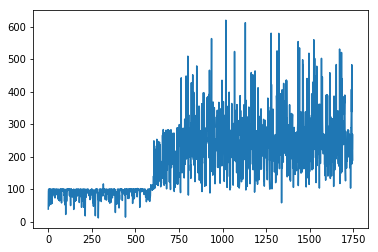

Time elapsed:54324.48181915283
| Reward: 239 | Episode: 1748 


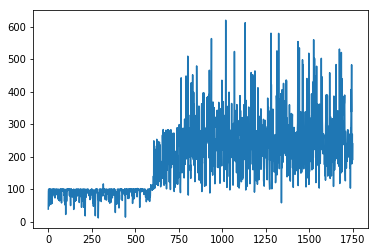

Time elapsed:54359.75137209892
| Reward: 164 | Episode: 1749 


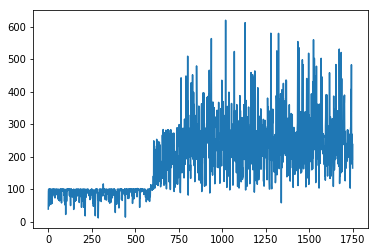

Time elapsed:54394.8687415123
| Reward: 360 | Episode: 1750 


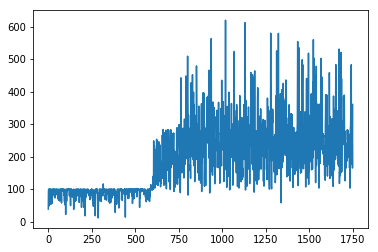

Time elapsed:54429.82806444168
| Reward: 538 | Episode: 1751 


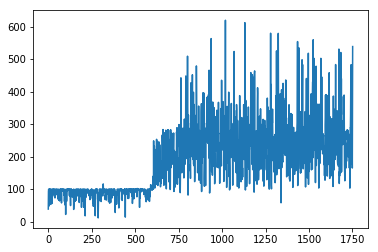

Time elapsed:54465.118220329285
| Reward: 169 | Episode: 1752 


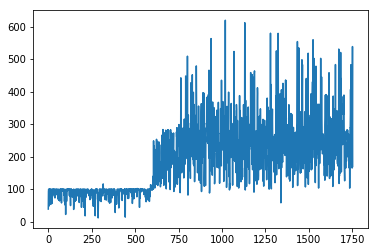

Time elapsed:54500.28453350067
| Reward: 107 | Episode: 1753 


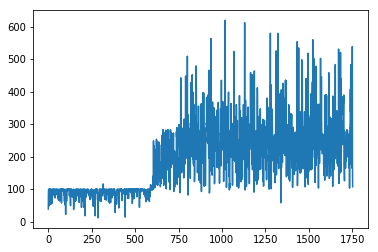

Time elapsed:54535.37706232071
| Reward: 149 | Episode: 1754 


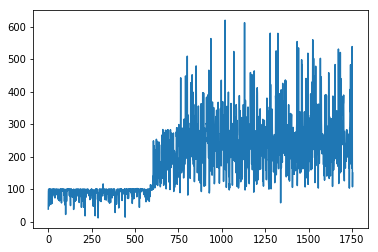

Time elapsed:54569.871661663055
| Reward: 220 | Episode: 1755 


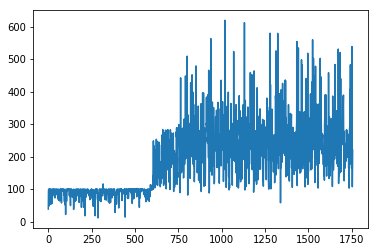

Time elapsed:54604.60363435745
| Reward: 285 | Episode: 1756 


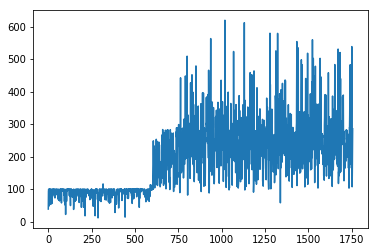

Time elapsed:54640.1328561306
| Reward: 191 | Episode: 1757 


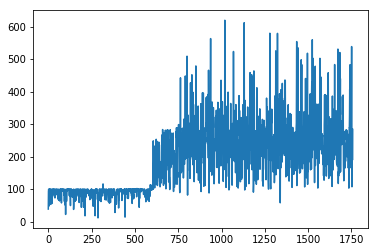

Time elapsed:54674.61371803284
| Reward: 213 | Episode: 1758 


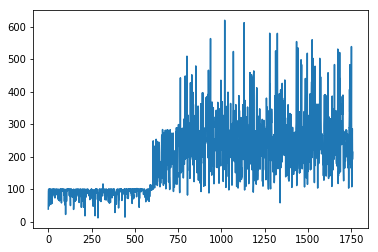

Time elapsed:54709.84708929062
| Reward: 368 | Episode: 1759 


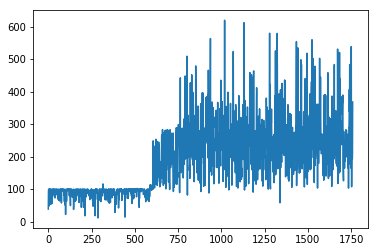

Time elapsed:54744.75126361847
| Reward: 246 | Episode: 1760 


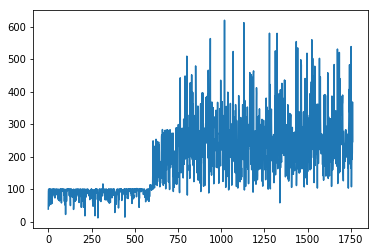

Time elapsed:54779.77913284302
| Reward: 137 | Episode: 1761 


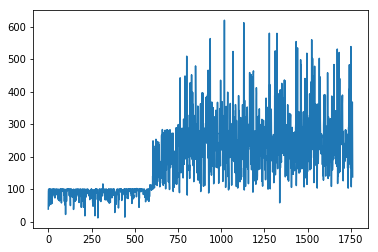

Time elapsed:54814.74912285805
| Reward: 88 | Episode: 1762 


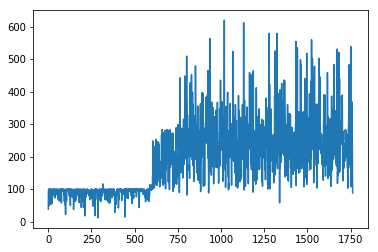

Time elapsed:54849.8195374012
| Reward: 199 | Episode: 1763 


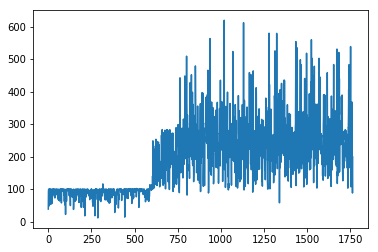

Time elapsed:54885.01912021637
| Reward: 213 | Episode: 1764 


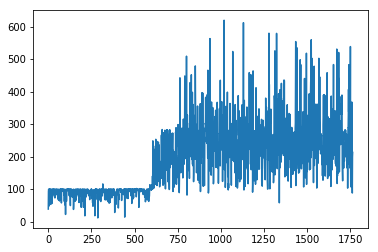

Time elapsed:54920.7336602211
| Reward: 164 | Episode: 1765 


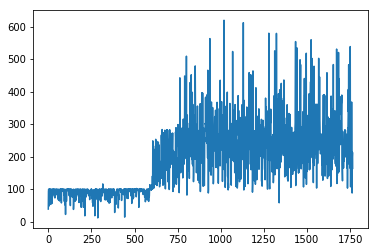

Time elapsed:54956.534219026566
| Reward: 267 | Episode: 1766 


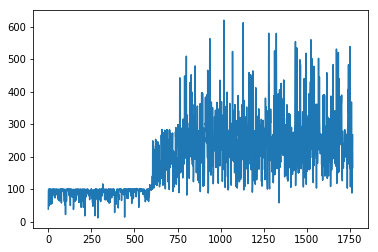

Time elapsed:54991.73725938797
| Reward: 369 | Episode: 1767 


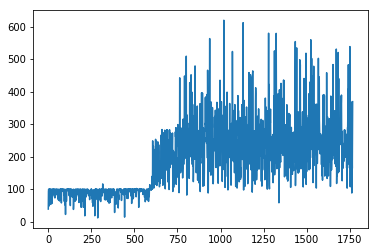

Time elapsed:55027.15502119064
| Reward: 249 | Episode: 1768 


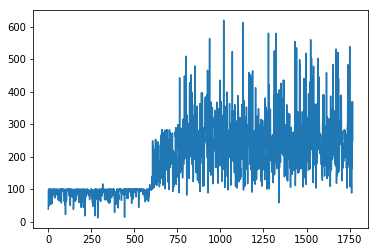

Time elapsed:55062.86639523506
| Reward: 186 | Episode: 1769 


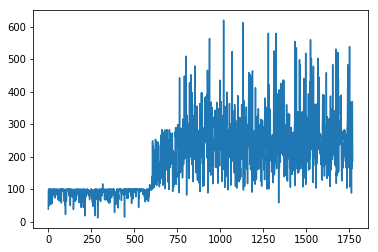

Time elapsed:55098.25686740875
| Reward: 171 | Episode: 1770 


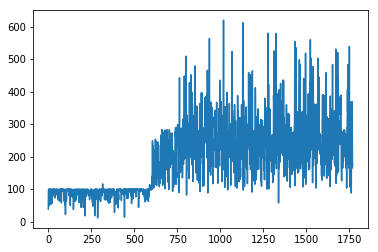

Time elapsed:55133.63532733917
| Reward: 198 | Episode: 1771 


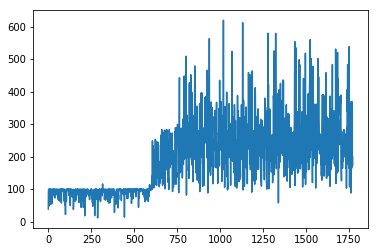

Time elapsed:55168.97710800171
| Reward: 214 | Episode: 1772 


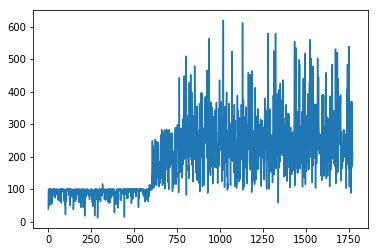

Time elapsed:55204.43887877464
| Reward: 289 | Episode: 1773 


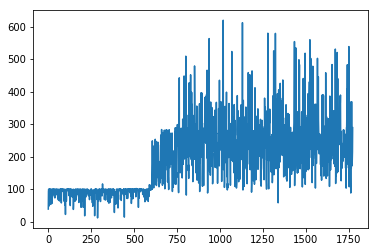

Time elapsed:55239.21436095238
| Reward: 256 | Episode: 1774 


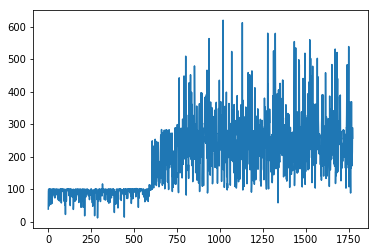

Time elapsed:55274.52479124069
| Reward: 292 | Episode: 1775 


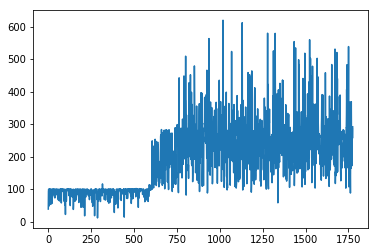

Time elapsed:55310.0608458519
| Reward: 251 | Episode: 1776 


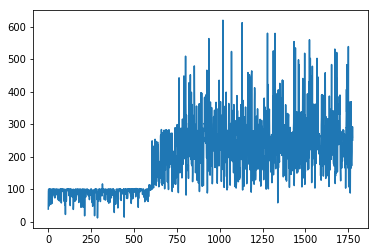

Time elapsed:55345.31809473038
| Reward: 339 | Episode: 1777 


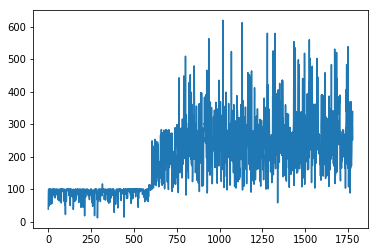

Time elapsed:55379.85659170151
| Reward: 243 | Episode: 1778 


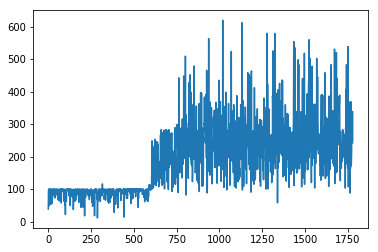

Time elapsed:55414.64971113205
| Reward: 137 | Episode: 1779 


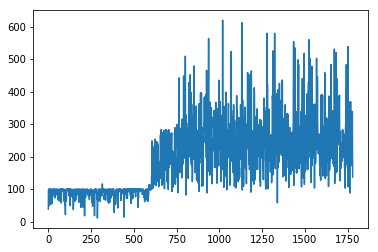

Time elapsed:55450.175542593
| Reward: 108 | Episode: 1780 


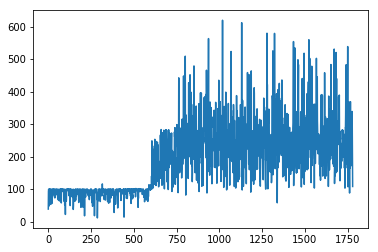

Time elapsed:55484.81585907936
| Reward: 148 | Episode: 1781 


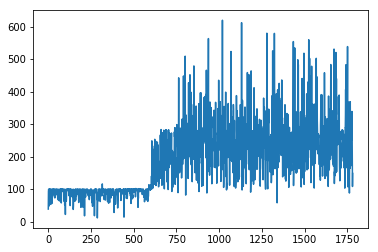

Time elapsed:55519.94770884514
| Reward: 559 | Episode: 1782 


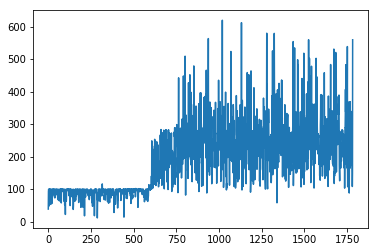

Time elapsed:55555.517075777054
| Reward: 436 | Episode: 1783 


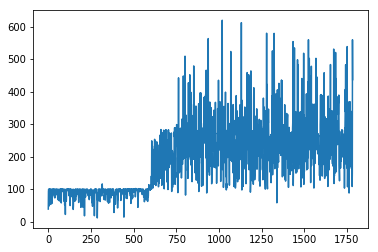

Time elapsed:55589.94799494743
| Reward: 224 | Episode: 1784 


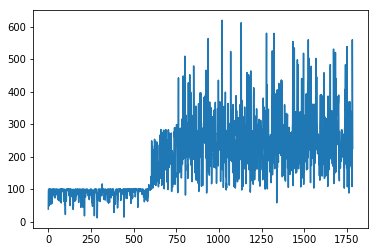

Time elapsed:55625.26290726662
| Reward: 184 | Episode: 1785 


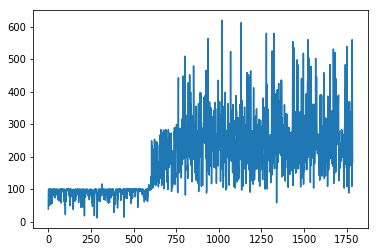

Time elapsed:55660.09135580063
| Reward: 280 | Episode: 1786 


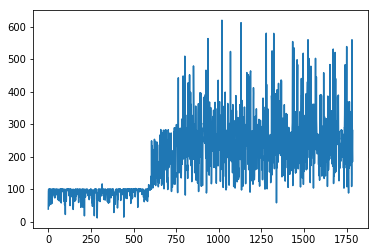

Time elapsed:55695.63247394562
| Reward: 343 | Episode: 1787 


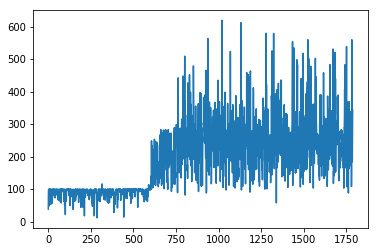

Time elapsed:55730.574776887894
| Reward: 289 | Episode: 1788 


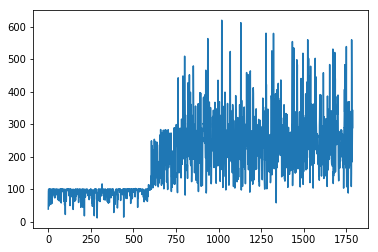

Time elapsed:55765.79784846306
| Reward: 451 | Episode: 1789 


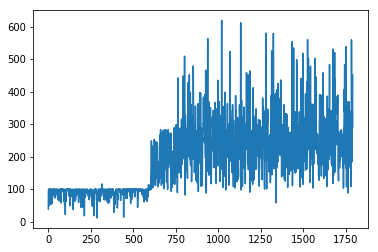

Time elapsed:55800.974217653275
| Reward: 299 | Episode: 1790 


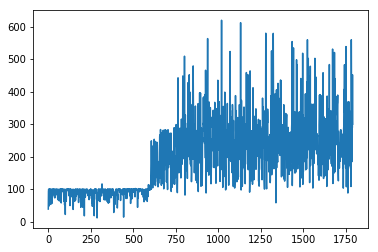

Time elapsed:55836.076677799225
| Reward: 249 | Episode: 1791 


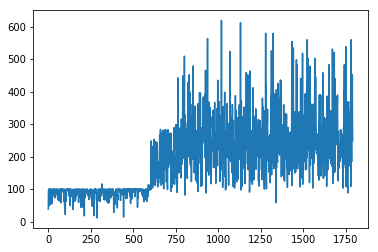

Time elapsed:55871.25893139839
| Reward: 276 | Episode: 1792 


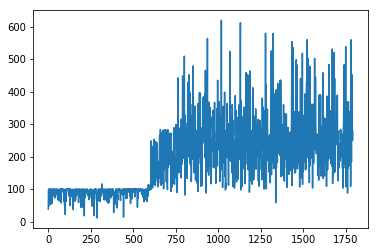

Time elapsed:55906.77471899986
| Reward: 220 | Episode: 1793 


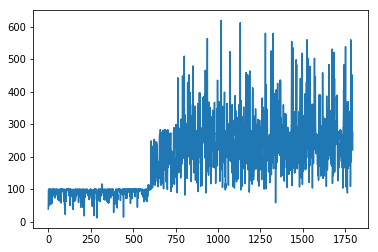

Time elapsed:55941.65496587753
| Reward: 308 | Episode: 1794 


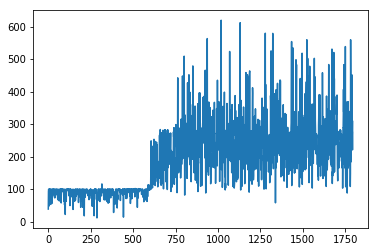

Time elapsed:55977.22955989838
| Reward: 268 | Episode: 1795 


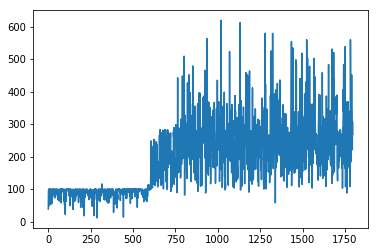

Time elapsed:56012.5396463871
| Reward: 216 | Episode: 1796 


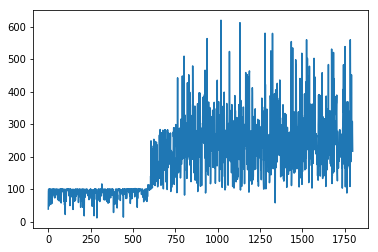

Time elapsed:56047.851516485214
| Reward: 158 | Episode: 1797 


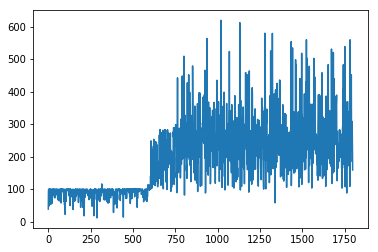

Time elapsed:56082.17776250839
| Reward: 200 | Episode: 1798 


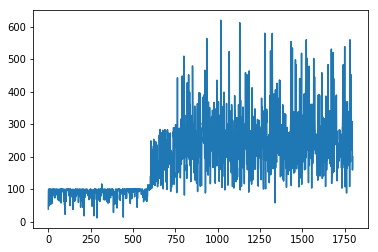

Time elapsed:56117.84356355667


In [ ]:
if __name__ == '__main__':

    with tf.Session() as sess:

        #env = gym.make('Pendulum-v0')
        #env = gym.make('MountainCarContinuous-v0')
        env = LASEnv('127.0.0.1', 19997)
        
        LASAgent = LASAgent_Actor_Critic(sess, env)

        #LASAgent.train()
        
        # Learning records
        episod_reward_memory = deque(maxlen = 10000)
        
        # Train parameters
        max_episodes = 50000
        max_episode_len = 1000
        render_env = False
        reward = 0
        done = False
        start_time = time.time()
        for i in range(max_episodes):
            observation = env.reset()   
            ep_reward = 0    
            for j in range(max_episode_len):
    
                if render_env == True:
                    env.render()
    
                # Added exploration noise
                action = LASAgent.perceive_and_act(observation,reward,done)
    
                observation, reward, done, info = env.step(action[0])
                ep_reward += reward
                if done or j == (max_episode_len-1):
                    print('| Reward: {:d} | Episode: {:d} '.format(int(ep_reward),i))
                    episod_reward_memory.append(ep_reward)
                    plot_cumulative_reward(episod_reward_memory)
                    break
                #time.sleep(0.5)
            print("Time elapsed:{}".format(time.time()-start_time))
        
        #env.destroy()